In [7]:
import numpy as np
import pandas as pd
import scipy as sp

import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.preprocessing import QuantileTransformer
import gstatsim as gs
import gstools as gstools
import skgstat as skg
from skgstat import models

import random
import time
import math
import os

from PIL import Image, ImageFilter

In [8]:
import geomc

In [3]:
import colormaps as colormaps

In [4]:
import matplotlib

In [5]:
import verde as vd

In [6]:
import matplotlib.ticker as mt

In [8]:
%load_ext autoreload
%autoreload 2

In [9]:
#load xx, yy, cond_data_mask, mc_region_mask, rows, cols
#df = pd.read_csv('./compiled_Denman_QC_38_1_shallow.csv')
df = pd.read_csv('./compiled_Denman_QC_55_shallow.csv')
df=df.rename(columns={"bed": "bed_notpreprocessed"})
df=df.rename(columns={"bedQCrf": "bed"})

x_uniq = np.unique(df.X)
y_uniq = np.unique(df.Y)

xmin = np.min(x_uniq)
xmax = np.max(x_uniq)
ymin = np.min(y_uniq)
ymax = np.max(y_uniq)

cols = len(x_uniq)
rows = len(y_uniq)

resolution = 1000

xx, yy = np.meshgrid(x_uniq, y_uniq)
print(xx.shape)

cond_bed = df.bed.values.reshape((rows,cols))
cond_data_mask = ~np.isnan(cond_bed)
mc_region_mask = df['mask'].values.reshape(xx.shape)

(200, 300)


In [10]:
xx

array([[2301000., 2302000., 2303000., ..., 2598000., 2599000., 2600000.],
       [2301000., 2302000., 2303000., ..., 2598000., 2599000., 2600000.],
       [2301000., 2302000., 2303000., ..., 2598000., 2599000., 2600000.],
       ...,
       [2301000., 2302000., 2303000., ..., 2598000., 2599000., 2600000.],
       [2301000., 2302000., 2303000., ..., 2598000., 2599000., 2600000.],
       [2301000., 2302000., 2303000., ..., 2598000., 2599000., 2600000.]])

In [11]:
yy

array([[-499000., -499000., -499000., ..., -499000., -499000., -499000.],
       [-498000., -498000., -498000., ..., -498000., -498000., -498000.],
       [-497000., -497000., -497000., ..., -497000., -497000., -497000.],
       ...,
       [-302000., -302000., -302000., ..., -302000., -302000., -302000.],
       [-301000., -301000., -301000., ..., -301000., -301000., -301000.],
       [-300000., -300000., -300000., ..., -300000., -300000., -300000.]])

In [12]:
(2300000,-300000) (2600000,-500000)

<>:1: SyntaxWarning: 'tuple' object is not callable; perhaps you missed a comma?
<>:1: SyntaxWarning: 'tuple' object is not callable; perhaps you missed a comma?
/scratch/local/1108455/ipykernel_1100136/4226543577.py:1: SyntaxWarning: 'tuple' object is not callable; perhaps you missed a comma?
  (2300000,-300000) (2600000,-500000)


TypeError: 'tuple' object is not callable

1.32549273167603 1.3202704 0.18121015647151228 0.20660445


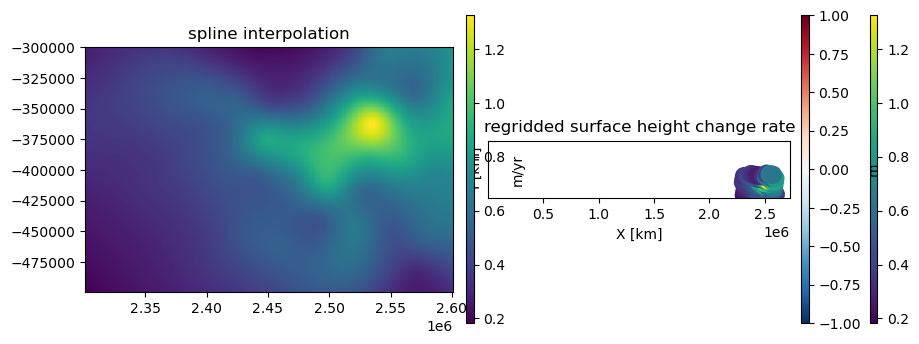

In [14]:
#load surf, velx, vely, dhdt, smb
smb, fig1 = geomc.load_smb('./Data/SMB_RACMO2.3p2_yearly_ANT27_1979_2016.nc',xx,yy,interp_method='spline')
dhdt, fig2 = geomc.load_dhdt('./Data/ANT_G1920_GroundedIceHeight_v01.nc',xx,yy,interp_method='linear')
surf = df.surface.values.reshape((rows,cols))
velx = np.loadtxt('Data/velx_MEaSUREs_linear_denman.txt')
vely = np.loadtxt('Data/vely_MEaSUREs_linear_denman.txt')

In [15]:
#load bm bed and bm mc res
df_bm = pd.read_csv('./Data/AIS_bedmachine_1000m.csv')
df_bm = df_bm[(df_bm['x']>=xmin) & (df_bm['x']<=xmax) & (df_bm['y']>=ymin) & (df_bm['y']<=ymax)].copy()
df_bm = df_bm.reset_index()
df_bm.head()

,index,x,y,mask,bed,surface,thickness,source,error,Unnamed: 8
0,2016400,2301000.0,-499000.0,2,385.10,2146.7,1761.6,5,200.0,NaN
1,2016401,2302000.0,-499000.0,2,406.40,2145.3,1738.9,5,180.0,NaN
2,2016402,2303000.0,-499000.0,2,428.31,2143.4,1715.1,5,160.0,NaN
3,2016403,2304000.0,-499000.0,2,448.38,2138.8,1690.5,5,140.0,NaN
4,2016404,2305000.0,-499000.0,2,468.74,2132.3,1663.5,5,120.0,NaN


In [16]:
mc_res_bm = geomc.calc_mass_conservation(df_bm.bed.values.reshape(rows,cols), surf, velx, vely, dhdt, smb)

### Variogram of the Gaussian model

In [24]:
model = gstools.Gaussian(dim=2, var = 1,
                    len_scale = [5/np.sqrt(3),5/np.sqrt(3)],
                    angles = 0*np.pi/180,
                    nugget = 0)
#srf = gstools.SRF(model)
#field = srf.structured([X, Y]).T*scale + _mean

In [25]:
model.variogram(r=5)

0.9052197751578451

In [47]:
model = gstools.Gaussian(dim=2, var = 1,
                    len_scale = [50/np.sqrt(3),50/np.sqrt(3)],
                    angles = 0*np.pi/180,
                    nugget = 0)
#srf = gstools.SRF(model)
#field = srf.structured([X, Y]).T*scale + _mean

In [48]:
model.variogram(r=60)

0.9663896110840665

In [76]:
model.variogram(r=1)

0.9510612412759072

In [28]:
10/3

3.3333333333333335

In [43]:
model = gstools.Exponential(dim=2, var = 1,
                    len_scale = [10/np.sqrt(3),10/np.sqrt(3)],
                    angles = 0*np.pi/180,
                    nugget = 0)
#srf = gstools.SRF(model)
#field = srf.structured([X, Y]).T*scale + _mean

In [40]:
model = gstools.Exponential(dim=2, var = 1,
                    len_scale = [10/3,10/3],
                    angles = 0*np.pi/180,
                    nugget = 0)
#srf = gstools.SRF(model)
#field = srf.structured([X, Y]).T*scale + _mean

In [45]:
model.variogram(r=15)

0.9255833975890966

In [32]:
model = gstools.Exponential(dim=2, var = 1,
                    len_scale = [50/np.sqrt(3),50/np.sqrt(3)],
                    angles = 0*np.pi/180,
                    nugget = 0)
#srf = gstools.SRF(model)
#field = srf.structured([X, Y]).T*scale + _mean

In [38]:
model.variogram(r=85)

0.9473709153988203

In [34]:
model.variogram()

TypeError: _init_subclass.<locals>.variogram() missing 1 required positional argument: 'r'

### Data

In [157]:
# number of bed excluded by random field method
43879 - 43730 - 10

139

In [156]:
# number of data excluded at the 3km edge
43730 - 43635

95

In [ ]:
# number of data excluded by manual selection
10

In [162]:
10+139+95

244

In [172]:
60000 - np.sum(df_up.bed.isna()) - 8982

7383

In [173]:
244 / 7383

0.033048896112691316

In [93]:
138 / 7383

0.018691588785046728

In [91]:
# number of radar data grid cells in high velocity region
4470

4470

In [92]:
138/4470

0.03087248322147651

In [12]:
df_up = pd.read_csv('./Data/compiled_Aurora_noQC_iceshelve_included_3.csv')
df_up = df_up[(df_up['X']>2300000) & (df_up['X']<=2600000) & (df_up['Y']>-500000) & (df_up['Y']<=-300000)].copy()

In [13]:
df_up.head()

,X,Y,Sum,Count,bed,bedmachine_mask,surface
2016400,2301000.0,-499000.0,0.0,0.0,NaN,2,2146.7
2016401,2302000.0,-499000.0,0.0,0.0,NaN,2,2145.3
2016402,2303000.0,-499000.0,0.0,0.0,NaN,2,2143.4
2016403,2304000.0,-499000.0,0.0,0.0,NaN,2,2138.8
2016404,2305000.0,-499000.0,0.0,0.0,NaN,2,2132.3


In [14]:
#### get smb location

In [15]:
import xarray as xr
from pyproj import CRS, Transformer

In [16]:
ds = xr.load_dataset('./Data/SMB_RACMO2.3p2_yearly_ANT27_1979_2016.nc')

crs_rotated = CRS('-m 57.295779506 +proj=ob_tran +o_proj=latlon +o_lat_p=-180.0 +lon_0=10.0')
polar = CRS.from_epsg(3031)
transformer = Transformer.from_crs(crs_rotated, polar)
lonlon, latlat = np.meshgrid(ds.rlon.values, ds.rlat.values)
xx2, yy2 = transformer.transform(lonlon, latlat)

msk = (xx2 > xx.min()) & (xx2 < xx.max()) & (yy2 > yy.min()) & (yy2 < yy.max())
ix = xx2[msk]
iy = yy2[msk]
iz = ds.isel(time=-2)['smb'].values.squeeze()[msk]
# assume unit is water equivalent mm / yr, correct units to m/yr
iz = iz/920

In [17]:
#### get dhdt location

In [18]:
ds2 = xr.open_dataset('./Data/ANT_G1920_GroundedIceHeight_v01.nc')
ds2 = ds2.sel(x=(ds2.x > xx.min()) & (ds2.x < xx.max()), y=(ds2.y > yy.min()) & (ds2.y < yy.max()))

ref = ds2.sel(time=slice('2014-05-01', '2014-06-01'))
later = ds2.sel(time=slice('2016-05-01', '2016-06-01'))

dhdt_raw = (later['height_change'].values-ref['height_change'].values)/2

v_max = np.nanmax(dhdt_raw)
v_min = np.nanmin(dhdt_raw)

xxht, yyht = np.meshgrid(ds2.x.values, ds2.y.values)

In [19]:
### load antarctic coastline

In [20]:
import geopandas as gpd

https://nsidc.org/data/nsidc-0730/versions/1

In [21]:
gl = gpd.read_file('./Data/modis2014groundingline/moa2014_grounding_line_v01.shp')
glx,gly = gl.geometry[0].exterior.xy

In [22]:
import matplotlib.patches as patches

In [23]:
N = 128
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(121/256, 1, N)
vals1[:, 1] = np.linspace(130/256, 1, N)
vals1[:, 2] = np.linspace(52/256, 1, N)

vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(1,212/256, N)
vals2[:, 1] = np.linspace(1,103/256, N)
vals2[:, 2] = np.linspace(1,128/256, N)

cmp_armyrose = ListedColormap(np.vstack([vals1,vals2]))

In [24]:
#d2fbd4,#a5dbc2,#7bbcb0,#559c9e,#3a7c89,#235d72,#123f5a

In [25]:
N = 128
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(215/256, 18/256, N)
vals1[:, 1] = np.linspace(256/256, 63/256, N)
vals1[:, 2] = np.linspace(220/256, 90/256, N)

cmp_mint = ListedColormap(vals1)

In [26]:
SMALL_SIZE = 8
MEDIUM_SIZE = 8.5
LARGE_SIZE = 9

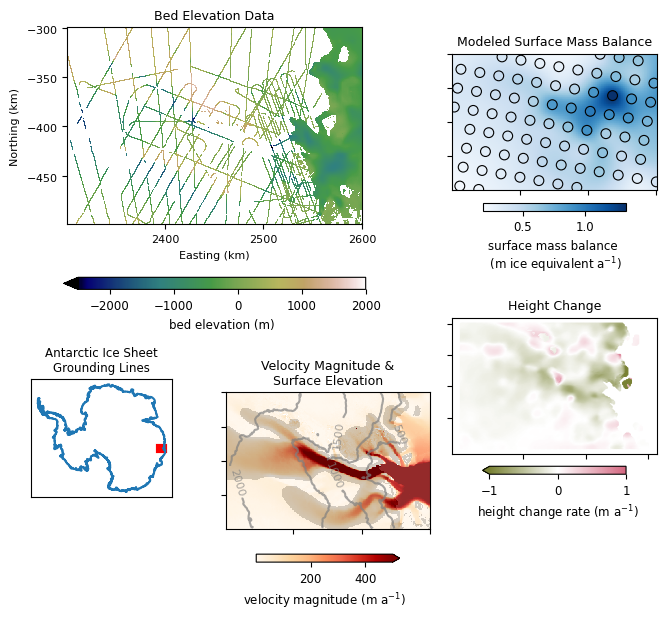

In [27]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 160*mm))

gs = fig.add_gridspec(7,3,width_ratios=[3,3,3],height_ratios=[1,1,1,1,1,1,1])
ax1 = fig.add_subplot(gs[0:4, 0:2],anchor='N')
ax2 = fig.add_subplot(gs[4:6, 0],anchor='N')
ax3 = fig.add_subplot(gs[4:7, 1],anchor='N')
#ax4 = fig.add_subplot(gs[0:3, 2],anchor='N')
ax5 = fig.add_subplot(gs[0:3, 2],anchor='N')
ax6 = fig.add_subplot(gs[3:6, 2],anchor='N')

#############################ax1###################################

f_topo = ax1.pcolormesh(xx/1000, yy/1000, df_up.bed.values.reshape(xx.shape),vmax=2000,vmin=-2500,cmap='gist_earth')
cb_topo = plt.colorbar(f_topo,ax=ax1,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.18,shrink=0.7,extend='min')
cb_topo.set_label(label='bed elevation (m)', size=MEDIUM_SIZE)
cb_topo.ax.tick_params(labelsize=MEDIUM_SIZE)
ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
ax1.set_title('Bed Elevation Data',fontsize=LARGE_SIZE)
ax1.set_xticks([2400,2500,2600])
ax1.set_xlabel('Easting (km)',fontsize=SMALL_SIZE)
ax1.set_yticks([-300,-350,-400,-450])
ax1.set_ylabel('Northing (km)',fontsize=SMALL_SIZE)
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.axis('scaled')

#############################ax2###################################

# # need to set legend manually
# f_type = ax2.pcolormesh(xxd,yyd,bm_mask_d,cmap=my_cmap,alpha=0.7)
# legend_elements = [Line2D([0], [0], color=colors[0], lw=4, label='ocean'),
#                    Line2D([0], [0], color=colors[1], lw=4, label='ice-free ocean'),
#                    Line2D([0], [0], color=(123/256,50/256,81/256), lw=4, label='fast-flowing & \n grounded ice'),
#                    Line2D([0], [0], color=colors[3], lw=4, label='grounded ice'),
#                    Line2D([0], [0], color=colors[4], lw=4, label='floating ice')]
# ax4.legend(handles=legend_elements, bbox_to_anchor=(0.0, 0.4), loc='lower left', borderaxespad=0., ncols=1, handlelength =1)
# ax2.pcolormesh(xxd,yyd,mc_mask_d,alpha=0.7)
# ax2.set_title('Types of Region')
# ax2.set_xticks([])
# ax2.set_yticks([])
# #ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax2.axis('scaled')

maxd_x = 2600000
mind_x = 2300000
mind_y = -500000.0
maxd_y = -300000.0

ax2.plot(glx,gly)
rect = patches.Rectangle((mind_x, mind_y), maxd_x-mind_x, maxd_y-mind_y, linewidth=3, edgecolor='r', facecolor='r')
ax2.add_patch(rect)
ax2.set_title('Antarctic Ice Sheet\nGrounding Lines', size=MEDIUM_SIZE)
ax2.set_xticks([])
ax2.set_yticks([])
ax2.axis('scaled')

#############################ax3###################################

velmag = np.sqrt(df.vel_x**2+df.vel_y**2).values.reshape(xx.shape)
f_velmag = ax3.pcolormesh(xx/1000,yy/1000,velmag,cmap='OrRd',vmax=500)
cb_velmag = plt.colorbar(f_velmag,ax=ax3,pad = 0.06, extend='max',aspect=18,orientation='horizontal',location='bottom',shrink=0.7)
cb_velmag.set_label(label='velocity magnitude (m a$^{-1}$)', size=MEDIUM_SIZE)
cb_velmag.ax.tick_params(labelsize=MEDIUM_SIZE)
ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask,alpha=0.17,cmap='binary',vmax=1)

surf = df.surface.values.reshape(xx.shape)
CS = ax3.contour(xx/1000,yy/1000,surf,colors='gray',
                 alpha=0.7,origin='upper',levels=[0,500,1000,1500,2000,2500])
ax3.clabel(CS, inline=True, fontsize=SMALL_SIZE,
          levels=[0,500,1000,1500,2000,2500])

ax3.set_title('Velocity Magnitude &\nSurface Elevation',fontsize=LARGE_SIZE)
ax3.set_xticks([2400,2500,2600])
ax3.set_xticklabels([])
ax3.set_yticks([-300,-350,-400,-450])
ax3.set_yticklabels([])
ax3.axis('scaled')

#############################ax5###################################

vmax = max(np.max(smb), np.max(iz))
vmin = min(np.min(smb), np.min(iz))
f_smb = ax5.pcolormesh(xx/1000, yy/1000, smb, vmin=vmin, vmax=vmax,cmap='Blues')
ax5.scatter(ix/1000, iy/1000, c=iz, s=50, vmin=vmin, vmax=vmax,linewidth=0.8,edgecolor='black',cmap='Blues')
ax5.axis('scaled')
ax5.set_title('Modeled Surface Mass Balance',fontsize=LARGE_SIZE)
ax5.set_xticks([2400,2500,2600])
ax5.set_xticklabels([])
ax5.set_yticks([-300,-350,-400,-450])
ax5.set_yticklabels([])
cb_smb = plt.colorbar(f_smb, ax=ax5, pad=0.06, aspect=18, orientation='horizontal',location='bottom',shrink=0.7)
cb_smb.set_label(label='surface mass balance \n (m ice equivalent a$^{-1}$)', size=MEDIUM_SIZE)
cb_smb.ax.tick_params(labelsize=MEDIUM_SIZE)
#############################ax6###################################

f_dhdt = ax6.scatter(xxht.flatten()/1000, yyht.flatten()/1000, c=dhdt_raw, s=1, vmin=-1, vmax=1, cmap=cmp_armyrose)
ax6.set_title('Height Change',fontsize=LARGE_SIZE)
ax6.set_xticks([2400,2500,2600])
ax6.set_xticklabels([])
ax6.set_yticks([-300,-350,-400,-450])
ax6.set_yticklabels([])
ax6.axis('scaled')
cb_dhdt = plt.colorbar(f_dhdt, ax=ax6, pad=0.06, aspect=18, orientation='horizontal',location='bottom',shrink=0.7,extend='min')
cb_dhdt.set_label(label='height change rate (m a$^{-1}$)', size=MEDIUM_SIZE)
cb_dhdt.ax.tick_params(labelsize=MEDIUM_SIZE)

# ax2.set_anchor('N')
# ax1.set_anchor('N')
# ax3.set_anchor('N')
# ax4.set_anchor('N')
# ax5.set_anchor('N')
# ax6.set_anchor('N')

#ax4.axis('off')

plt.tight_layout(w_pad=1.2,h_pad=1)

plt.savefig('data_denman.png',bbox_inches='tight',dpi=600)

### Effect of different data interpolation

In [68]:
sgs_bed = np.loadtxt('./51_crf/sgs_bed_51_crf.txt')
bm_bed = df_bm.bed.values.reshape(xx.shape)
loaded_bed_temp = np.loadtxt("./51_sgs/bed_cache_51_sgs_9_20.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
mcmc_bed = loaded_bed_temp[-1,:,:]

In [69]:
mc_bm1 = geomc.calc_mass_conservation(bm_bed, surf, velx, vely, dhdt, smb)
mc_sgs1 = geomc.calc_mass_conservation(sgs_bed, surf, velx, vely, dhdt, smb)
mc_mcmc1 = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely, dhdt, smb)

In [71]:
SMALL_SIZE=8.5
MEDIUM_SIZE=9
LARGE_SIZE=10

[]

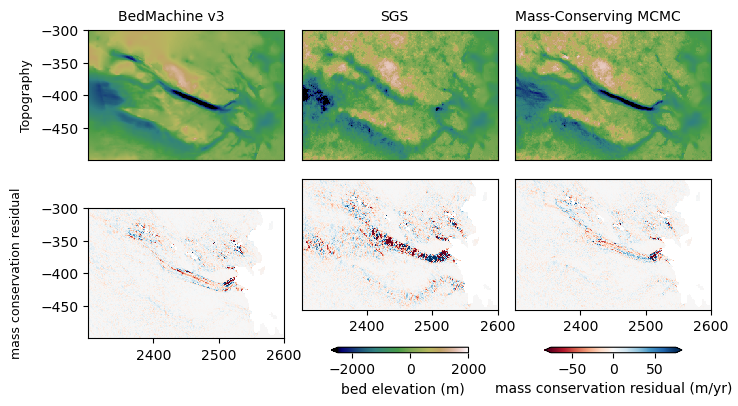

In [72]:
#############################layout###################################
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 100*mm))

gs = fig.add_gridspec(2,3,width_ratios=[1,1,1],height_ratios=[1,1.5])
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax4 = fig.add_subplot(gs[1, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax6 = fig.add_subplot(gs[1, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')
ax8 = fig.add_subplot(gs[1, 2],anchor='N')

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx/1000, yy/1000, bm_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
plt.colorbar(f_bm,ax=ax6,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
ax3.annotate('BedMachine v3', (0.15, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax3.annotate('Topography', (-0.35, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
ax3.set_xticks([])
ax3.axis('scaled')

#############################ax4###################################

f_mcbm = ax4.pcolormesh(xx/1000,yy/1000,mc_bm1,cmap='RdBu',vmax=75,vmin=-75)
plt.colorbar(f_mcbm,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
ax4.annotate('mass conservation residual', (-0.4,0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
ax4.axis('scaled')

#############################ax5###################################

f_sgs = ax5.pcolormesh(xx/1000, yy/1000, sgs_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
ax5.annotate('SGS', (0.4, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax5.set_xticks([])
ax5.set_yticks([])
ax5.axis('scaled')

#############################ax6###################################

f_mcsgs = ax6.pcolormesh(xx/1000,yy/1000,mc_sgs1,cmap='RdBu',vmax=75,vmin=-75)
ax6.set_yticks([])
ax6.axis('scaled')

#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx/1000, yy/1000, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
ax7.annotate('Mass-Conserving MCMC', (0, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax7.set_yticks([])
ax7.set_xticks([])
ax7.axis('scaled')

#############################ax8###################################
f_mcmcmc = ax8.pcolormesh(xx/1000,yy/1000,mc_mcmc1,cmap='RdBu',vmax=75,vmin=-75)
ax8.set_yticks([])
ax8.axis('scaled')
plt.tight_layout(pad=0,h_pad=0.0)
plt.plot()

1.32549273167603 1.3202704 0.18121015647151228 0.20660445


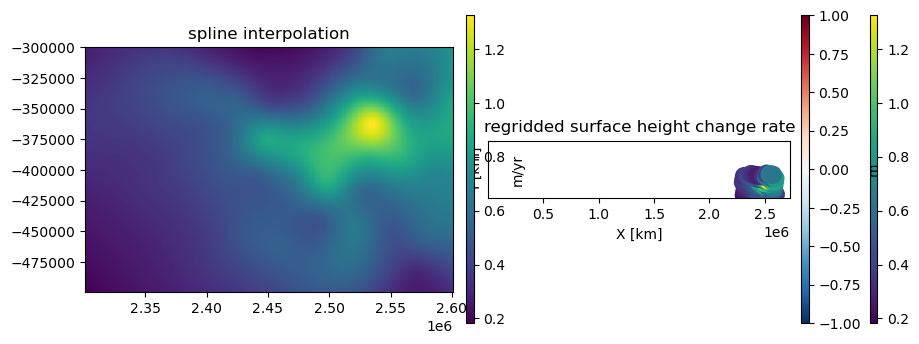

In [99]:
#load surf, velx, vely, dhdt, smb
smb_spline, fig1 = geomc.load_smb('./Data/SMB_RACMO2.3p2_yearly_ANT27_1979_2016.nc',xx,yy,interp_method='spline')
dhdt_linear, fig2 = geomc.load_dhdt('./Data/ANT_G1920_GroundedIceHeight_v01.nc',xx,yy,interp_method='linear')
surf = df.surface.values.reshape((rows,cols))
velx_l = np.loadtxt('./Data/velx_MEaSUREs_linear_denman.txt')
vely_l = np.loadtxt('./Data/vely_MEaSUREs_linear_denman.txt')

In [103]:
mc_bm2 = geomc.calc_mass_conservation(bm_bed, surf, velx_l, vely_l, dhdt_linear, smb_spline)
mc_sgs2 = geomc.calc_mass_conservation(sgs_bed, surf, velx, vely_l, dhdt_linear, smb_spline)
mc_mcmc2 = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely_l, dhdt_linear, smb_spline)

[]

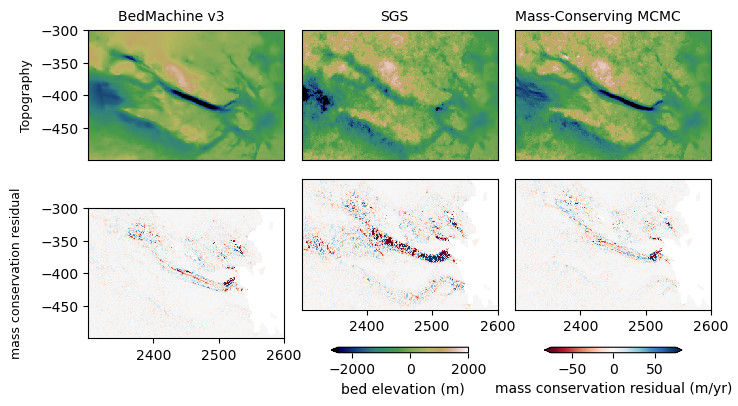

In [105]:
#############################layout###################################
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 100*mm))

gs = fig.add_gridspec(2,3,width_ratios=[1,1,1],height_ratios=[1,1.5])
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax4 = fig.add_subplot(gs[1, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax6 = fig.add_subplot(gs[1, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')
ax8 = fig.add_subplot(gs[1, 2],anchor='N')

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx/1000, yy/1000, bm_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
plt.colorbar(f_bm,ax=ax6,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
ax3.annotate('BedMachine v3', (0.15, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax3.annotate('Topography', (-0.35, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
ax3.set_xticks([])
ax3.axis('scaled')

#############################ax4###################################

f_mcbm = ax4.pcolormesh(xx/1000,yy/1000,mc_bm2,cmap='RdBu',vmax=75,vmin=-75)
plt.colorbar(f_mcbm,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
ax4.annotate('mass conservation residual', (-0.4,0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
ax4.axis('scaled')

#############################ax5###################################

f_sgs = ax5.pcolormesh(xx/1000, yy/1000, sgs_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
ax5.annotate('SGS', (0.4, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax5.set_xticks([])
ax5.set_yticks([])
ax5.axis('scaled')

#############################ax6###################################

f_mcsgs = ax6.pcolormesh(xx/1000,yy/1000,mc_sgs2,cmap='RdBu',vmax=75,vmin=-75)
ax6.set_yticks([])
ax6.axis('scaled')

#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx/1000, yy/1000, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
ax7.annotate('Mass-Conserving MCMC', (0, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax7.set_yticks([])
ax7.set_xticks([])
ax7.axis('scaled')

#############################ax8###################################
f_mcmcmc = ax8.pcolormesh(xx/1000,yy/1000,mc_mcmc2,cmap='RdBu',vmax=75,vmin=-75)
ax8.set_yticks([])
ax8.axis('scaled')
plt.tight_layout(pad=0,h_pad=0.0)
plt.plot()

### test sgs bed generation

In [22]:
df_bed = df.copy()
df_bed = df_bed[df_bed["bed"].isnull() == False]
data = df_bed['bed'].values.reshape(-1,1)
coords = df_bed[['X','Y']].values
roughness_region_mask = (df_bed['bedmachine_mask'].values)==2
#nst_trans, Nbed_radar, varios, fig = geomc.fit_variogram(data, coords, roughness_region_mask, maxlag=70000, n_lags=70)

In [23]:
n_lags=70
samples=0.6
maxlag=100000
subsample=100000

range, sill, and nugget for gaussian variogram is  [55770.61380990066, 2.234333835851682, 0]
for exponential variogram is  [91749.50367789599, 2.4311964450900296, 0]
for spherical variogram is  [61598.74622827673, 2.2325143899037827, 0]


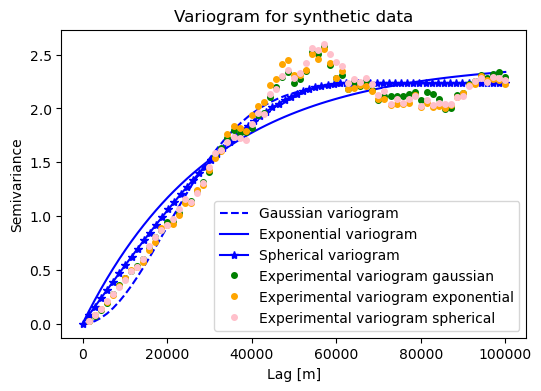

In [24]:
nst_trans = QuantileTransformer(n_quantiles=500, output_distribution="normal",random_state=0,subsample=subsample).fit(data)
transformed_data = nst_trans.transform(data)

coords = coords[roughness_region_mask==1]
values = transformed_data[roughness_region_mask==1].flatten()

test1 = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                maxlag=maxlag, normalize=False, model='gaussian',samples=samples,estimator='dowd')
test2 = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, model='exponential',samples=samples,estimator='dowd')
test3 = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, model='spherical',samples=samples,estimator='dowd')

tp1 = test1.parameters
tp2 = test2.parameters
tp3 = test3.parameters

print('range, sill, and nugget for gaussian variogram is ', tp1)
print('for exponential variogram is ', tp2)
print('for spherical variogram is ', tp3)

# extract experimental variogram values
xdata1 = test1.bins
ydata1 = test1.experimental
xdata2 = test2.bins
ydata2 = test2.experimental
xdata3 = test3.bins
ydata3 = test3.experimental

# evaluate models
xi = np.linspace(0, xdata2[-1], n_lags) 
y_gauss = [models.gaussian(h, tp1[0], tp1[1], tp1[2]) for h in xi]
y_exp = [models.exponential(h, tp2[0], tp2[1], tp2[2]) for h in xi]
y_sph = [models.spherical(h, tp3[0], tp3[1], tp3[2]) for h in xi]

# plot variogram model
fig = plt.figure(figsize=(6,4))
plt.plot(xi, y_gauss,'b--', label='Gaussian variogram')
plt.plot(xi, y_exp,'b-', label='Exponential variogram')
plt.plot(xi, y_sph,'b*-', label='Spherical variogram')
plt.plot(xdata1, ydata1,'o', markersize=4, color='green', label='Experimental variogram gaussian')
plt.plot(xdata2, ydata2,'o', markersize=4, color='orange', label='Experimental variogram exponential')
plt.plot(xdata3, ydata3,'o', markersize=4, color='pink', label='Experimental variogram spherical')
plt.title('Variogram for synthetic data')
plt.xlabel('Lag [m]'); plt.ylabel('Semivariance')  
plt.legend(loc='lower right')

In [25]:
42104.34320617898, 1.3134342741758054, 0

(42104.34320617898, 1.3134342741758054, 0)

In [26]:
# vario1_radar = [azimuth, nugget, major_range, minor_range, sill, vtype]
vario1_radar = [0, 0, tp3[0], tp3[0], tp3[1], 'Spherical']

In [407]:
vario1_radar

[0, 0, 42104.34320617898, 42104.34320617898, 1.3134342741758054, 'Spherical']

In [387]:
df_bed['Nbed_radar'] = transformed_data.flatten()

In [388]:
k = 48
rad = 50000

Pred_grid_xy = gs.Gridding.prediction_grid(xmin, xmax, ymin, ymax, resolution)
x = np.reshape(Pred_grid_xy[:,0], (rows*cols, 1))
y = np.flip(np.reshape(Pred_grid_xy[:,1], (rows*cols, 1))) # need to flip y otherwise the coordinate does not match
Pred_grid_xy = np.concatenate((x,y),axis=1)

sim = gs.Interpolation.okrige_sgs(Pred_grid_xy, df_bed, 'X', 'Y', 'Nbed_radar', k, vario1_radar, rad)

# convert the first SGS matrix to a dataframe
x = np.reshape(Pred_grid_xy[:,0], (rows*cols, 1))
y = np.reshape(Pred_grid_xy[:,1], (rows*cols, 1))
xy_grid = np.concatenate((x,y,sim.flatten().reshape(-1,1)),axis=1)
psimdf = pd.DataFrame(data = xy_grid,columns=['X','Y','Z'],index=df.index)

sgs_bed = nst_trans.inverse_transform(np.array(psimdf['Z']).reshape(-1,1)).reshape(rows,cols)
np.savetxt('sgs_bed_38_test1.txt',sgs_bed)

100%|██████████| 60000/60000 [06:54<00:00, 144.64it/s]


### test why residual reduction figure not align fine-scale and large-scale chain

In [162]:
trend = np.loadtxt("./53_crf/trend_53_crf.txt")

range, sill, and nugget for gaussian variogram is  [8747.82213648729, 0.93502632768227, 0]
for exponential variogram is  [12602.23714856957, 0.9916331248472058, 0]
for spherical variogram is  [9808.277488252119, 0.9424218362017011, 0]


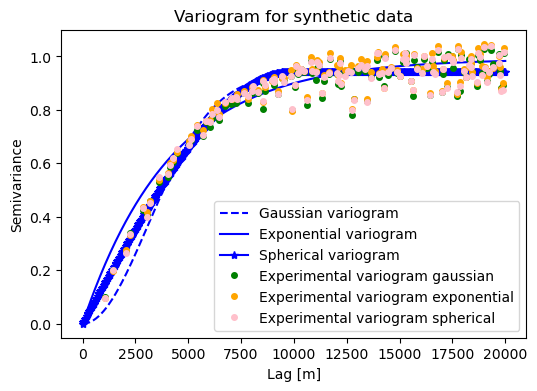

In [166]:
df_bed = df.copy()
df_bed['residual']=df_bed['bed'].values-trend.flatten()
df_bed = df_bed[df_bed["residual"].isnull() == False]
data = df_bed['residual'].values.reshape(-1,1)
coords = df_bed[['X','Y']].values
roughness_region_mask = (df_bed['bedmachine_mask'].values)==2

loaded_bed_temp = np.loadtxt("./53_crf/bed_cache_53_crf_42forsample.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
data_for_trans = (loaded_bed_temp[0,:,:] - trend).reshape(-1,1)

nst_trans, Nbed_detrend, varios, fig = geomc.fit_variogram(data, coords, roughness_region_mask, 
                                                           maxlag=20000, n_lags=500, samples=0.9,
                                                          data_for_trans=data_for_trans)

In [199]:
loaded_bed_temp = np.loadtxt("./53_crf/bed_cache_53_crf_43forsample.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)

In [202]:
# Pred_grid_xy = gs.Gridding.prediction_grid(xmin, xmax, ymin, ymax, resolution)
# x = np.reshape(Pred_grid_xy[:,0], (rows*cols, 1))
# y = np.flip(np.reshape(Pred_grid_xy[:,1], (rows*cols, 1))) # need to flip y otherwise the coordinate does not match
# Pred_grid_xy = np.concatenate((x,y),axis=1)

res_bed = loaded_bed_temp[4] - trend
norm_res_bed = nst_trans.transform(res_bed.reshape(-1,1)).reshape(rows,cols)
# x = np.reshape(Pred_grid_xy[:,0], (rows*cols, 1))
# y = np.reshape(Pred_grid_xy[:,1], (rows*cols, 1))
# xy_grid = np.concatenate((x,y,norm_res_bed.flatten().reshape(-1,1)),axis=1)
# psimdf = pd.DataFrame(data = xy_grid,columns=['X','Y','Z'],index=df.index)

In [203]:
#bed2 = nst_trans.inverse_transform(np.array(psimdf['Z']).reshape(-1,1)).reshape(rows,cols) + trend
bed2 = nst_trans.inverse_transform(norm_res_bed.reshape(-1,1)).reshape(rows,cols) + trend

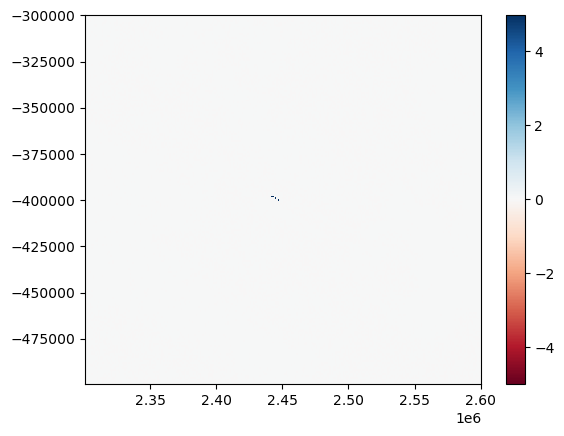

In [204]:
plt.pcolormesh(xx,yy,bed2-loaded_bed_temp[4,:,:],cmap='RdBu',vmax=5,vmin=-5)
plt.colorbar()

In [213]:
int(20000/4000)

5

In [216]:
np.linspace(0, 20000-1, num=int(20000/4000))

array([    0.  ,  4999.75,  9999.5 , 14999.25, 19999.  ])

In [218]:
choice = np.round(np.linspace(0, 20000-4000, num=int(20000/4000))).astype(int)
choice

array([    0,  4000,  8000, 12000, 16000])

In [172]:
#load all sampled bed
n_iter_list =  [20000] * 2
sigma_mc_list = [3] * 2
file_postfix_list = ['_53_crf_'+str(i)+'forsample' for i in range(42,44)]
choice_param_list = [4000] * 2

nsil = np.floor(np.divide(n_iter_list, choice_param_list)).astype(int)
loaded_bed_sample = np.zeros((np.sum(nsil), rows, cols))
for i in range(len(nsil)):
    file_postfix = file_postfix_list[i]
    loaded_bed_temp = np.loadtxt("./53_crf/bed_cache"+file_postfix+".txt")
    loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
    loaded_bed_sample[int(np.sum(nsil[:i])):int(np.sum(nsil[:i+1])),:,:] = loaded_bed_temp

In [173]:
num_sgs_chains = loaded_bed_sample.shape[0]
num_sgs_chains

10

### Topography comparison Between Different Methods

In [132]:
#load xx, yy, cond_data_mask, mc_region_mask, rows, cols
df_noqc = pd.read_csv('./Data/compiled_Aurora_noQC_iceshelve_included_3.csv')
df_noqc  = df_noqc[(df_noqc['X']>2300000) & (df_noqc['X']<=2600000) & (df_noqc['Y']>-500000) & (df_noqc['Y']<=-300000)].copy()

In [133]:
df_noqc.head()

,X,Y,Sum,Count,bed,bedmachine_mask,surface
2016400,2301000.0,-499000.0,0.0,0.0,NaN,2,2146.7
2016401,2302000.0,-499000.0,0.0,0.0,NaN,2,2145.3
2016402,2303000.0,-499000.0,0.0,0.0,NaN,2,2143.4
2016403,2304000.0,-499000.0,0.0,0.0,NaN,2,2138.8
2016404,2305000.0,-499000.0,0.0,0.0,NaN,2,2132.3


In [134]:
import matplotlib
#top = matplotlib.colormaps['Blues'].resampled(128)
#bottom = matplotlib.colormaps['Browns'].resampled(128)

N = 256
vals = np.ones((N, 4))
vals[:, 0] = np.linspace(15/256, 250/256, N)
vals[:, 1] = np.linspace(15/256, 250/255, N)
vals[:, 2] = np.linspace(112/256, 248/255, N)

vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(250/256, 120/256, N)
vals2[:, 1] = np.linspace(250/255, 40/256, N)
vals2[:, 2] = np.linspace(248/255, 30/256, N)

newcolors = np.vstack((vals,
                       vals2))
newcmp = ListedColormap(newcolors, name='topo')

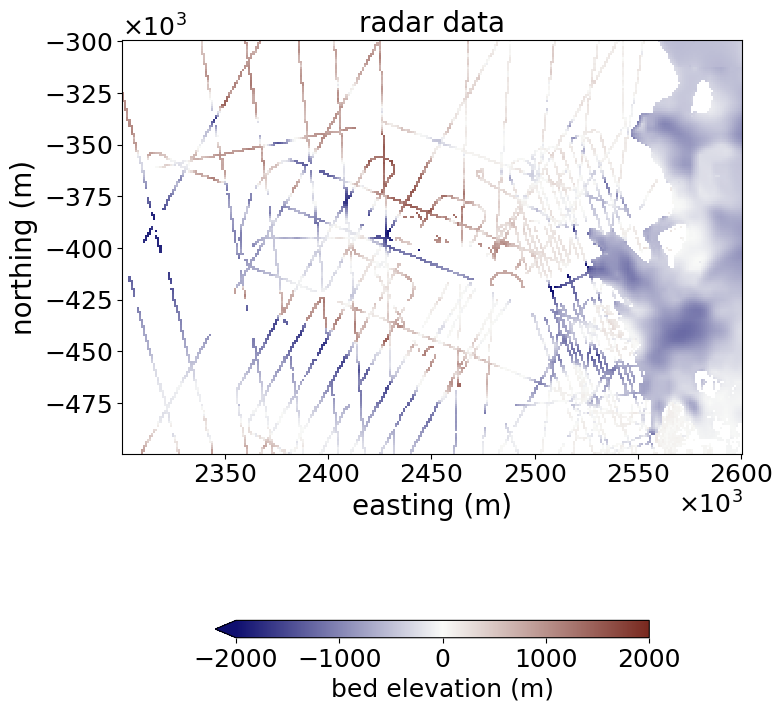

In [135]:
fig,ax = plt.subplots(figsize=(8,10))

f_radar = ax.pcolormesh(xx, yy, df_noqc.bed.values.reshape(xx.shape),vmax=2000,vmin=-2000,cmap=newcmp)
cbar = plt.colorbar(f_radar,ax=ax,aspect=25,orientation='horizontal',
             location='bottom',pad=0.12,shrink=0.7,extend='min')
cbar.set_label(label='bed elevation (m)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
ax.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
ax.ticklabel_format(style="sci", axis="y", scilimits=(3,3))
ax.yaxis.offsetText.set_fontsize(18)
ax.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
ax.ticklabel_format(style="sci", axis="x", scilimits=(3,3))
ax.xaxis.offsetText.set_fontsize(18)
ax.tick_params(axis='both', labelsize=18)
ax.set_title('radar data',fontsize=20)
ax.set_xlabel('easting (m)',fontsize=20)
ax.set_ylabel('northing (m)',fontsize=20)
ax.axis('scaled')

plt.show()

In [136]:
radar_data = df_noqc.bed.values.reshape(xx.shape)
bedmachine_mask = df_noqc.bedmachine_mask.values.reshape(xx.shape)
radar_data = np.where(bedmachine_mask == 2, radar_data, np.nan)
floating_ice = np.where(bedmachine_mask == 3, 1, np.nan)

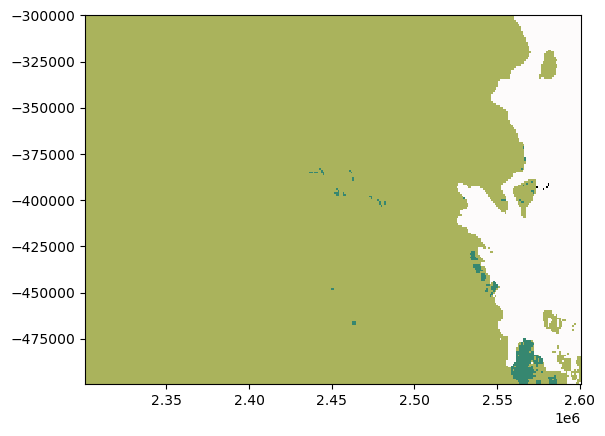

In [137]:
plt.pcolormesh(xx, yy, bedmachine_mask,cmap='gist_earth')

In [12]:
# sgs1 = np.loadtxt('sgs_bed_denman_noqc_vis1.txt')
# sgs2 = np.loadtxt('sgs_bed_denman_noqc_vis2.txt')
# sgs3 = np.loadtxt('sgs_bed_denman_noqc_vis3.txt')

In [17]:
sgs1 = np.loadtxt('56_crf/sgs_bed_56_crf.txt')
sgs2 = np.loadtxt('57_crf/sgs_bed_57_crf.txt')
sgs3 = np.loadtxt('58_crf/sgs_bed_58_crf.txt')
sgs4 = np.loadtxt('59_crf/sgs_bed_59_crf.txt')

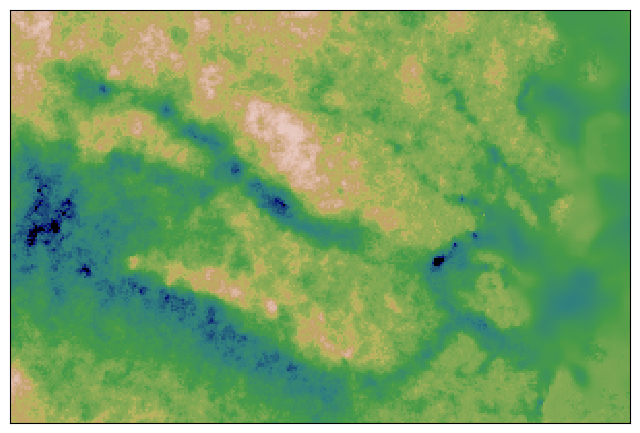

In [20]:
fig,ax = plt.subplots(figsize=(8,6))

ax.pcolormesh(xx/1000, yy/1000, sgs1,vmax=2000,vmin=-2500,cmap='gist_earth')
ax.set_xticks([])
ax.set_yticks([])
ax.axis('scaled')

plt.savefig('./figures/toposgs1.png', bbox_inches='tight',dpi=300)

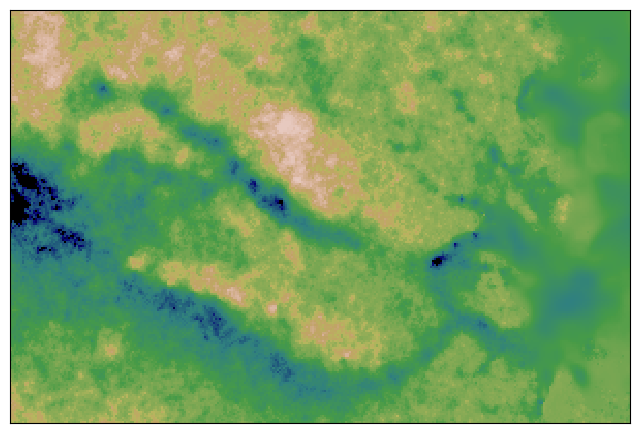

In [21]:
fig,ax = plt.subplots(figsize=(8,6))

ax.pcolormesh(xx/1000, yy/1000, sgs2,vmax=2000,vmin=-2500,cmap='gist_earth')
ax.set_xticks([])
ax.set_yticks([])
ax.axis('scaled')

plt.savefig('./figures/toposgs2.png', bbox_inches='tight',dpi=300)

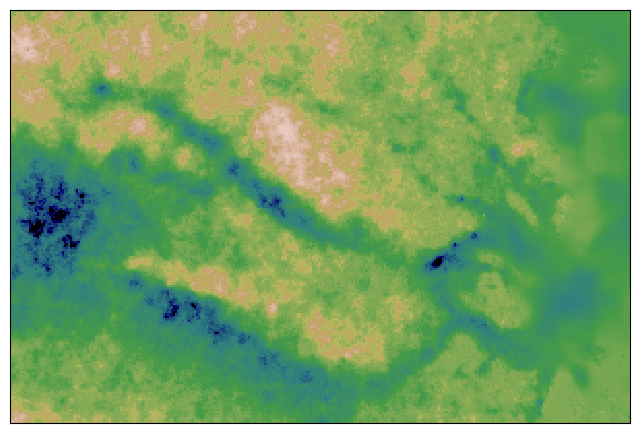

In [22]:
fig,ax = plt.subplots(figsize=(8,6))

ax.pcolormesh(xx/1000, yy/1000, sgs3,vmax=2000,vmin=-2500,cmap='gist_earth')
ax.set_xticks([])
ax.set_yticks([])
ax.axis('scaled')

plt.savefig('./figures/toposgs3.png', bbox_inches='tight',dpi=300)

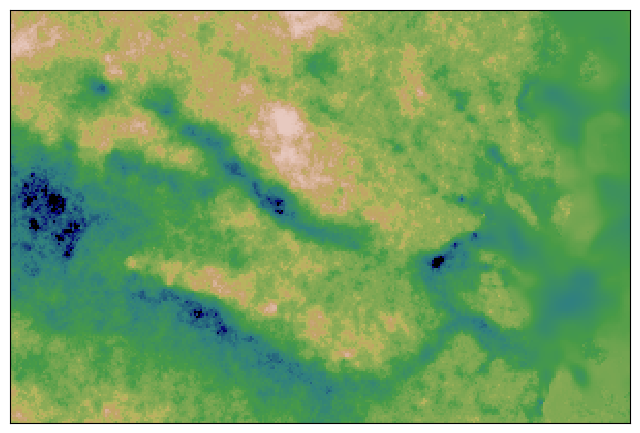

In [23]:
fig,ax = plt.subplots(figsize=(8,6))

ax.pcolormesh(xx/1000, yy/1000, sgs4,vmax=2000,vmin=-2500,cmap='gist_earth')
ax.set_xticks([])
ax.set_yticks([])
ax.axis('scaled')

plt.savefig('./figures/toposgs4.png', bbox_inches='tight',dpi=300)

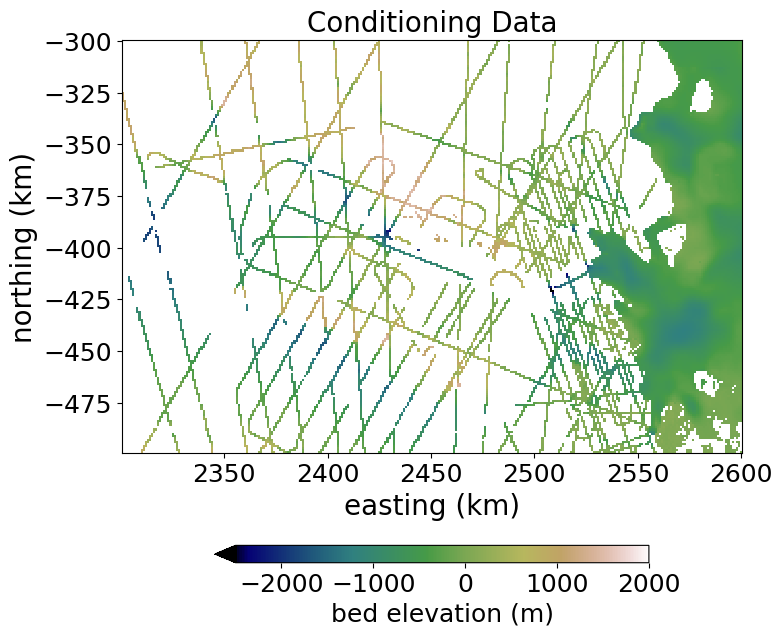

In [140]:
fig,ax = plt.subplots(figsize=(8,8))

f_radar = ax.pcolormesh(xx/1000, yy/1000, df_noqc.bed.values.reshape(xx.shape),vmax=2000,vmin=-2500,cmap='gist_earth')
#ax.pcolormesh(xx/1000, yy/1000, floating_ice,cmap='Blues',vmax=5,vmin=0)
cbar = plt.colorbar(f_radar,ax=ax,aspect=25,orientation='horizontal',
             location='bottom',pad=0.12,shrink=0.7,extend='min')
cbar.set_label(label='bed elevation (m)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
#ax.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax.ticklabel_format(style="sci", axis="y", scilimits=(3,3))
ax.yaxis.offsetText.set_fontsize(18)
#ax.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax.ticklabel_format(style="sci", axis="x", scilimits=(3,3))
ax.xaxis.offsetText.set_fontsize(18)
ax.tick_params(axis='both', labelsize=18)
ax.set_title('Conditioning Data',fontsize=20)
ax.set_xlabel('easting (km)',fontsize=20)
ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/WAIS_radardata', bbox_inches='tight',dpi=300)

range, sill, and nugget for gaussian variogram is  [36508.95644233551, 1.35135338501686, 0]
for exponential variogram is  [61122.1134290364, 1.4329399045893685, 0]
for spherical variogram is  [42456.295382991586, 1.3776826389871857, 0]


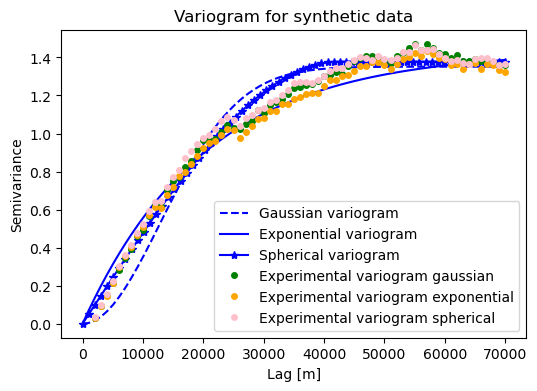

In [141]:
df_bed = df_noqc.copy()
df_bed = df_bed[df_bed["bed"].isnull() == False]
data = df_bed['bed'].values.reshape(-1,1)
coords = df_bed[['X','Y']].values
roughness_region_mask = (df_bed['bedmachine_mask'].values)==2

nst_trans, Nbed_radar, varios, fig = geomc.fit_variogram(data, coords, roughness_region_mask, maxlag=70000, n_lags=70)

In [142]:
# vario1_radar = [azimuth, nugget, major_range, minor_range, sill, vtype]
tp3 = varios[2]
vario1_radar = [0, 0, tp3[0], tp3[0], tp3[1], 'Spherical']

In [143]:
df_bed['Nbed_radar'] = Nbed_radar.flatten()

In [40]:
##sgs_generation
k = 48
rad = 50000
resolution = 1000

Pred_grid_xy = gs.Gridding.prediction_grid(xmin, xmax, ymin, ymax, resolution)
x = np.reshape(Pred_grid_xy[:,0], (rows*cols, 1))
y = np.flip(np.reshape(Pred_grid_xy[:,1], (rows*cols, 1))) # need to flip y otherwise the coordinate does not match
Pred_grid_xy = np.concatenate((x,y),axis=1)

sim = gs.Interpolation.okrige_sgs(Pred_grid_xy, df_bed, 'X', 'Y', 'Nbed_radar', k, vario1_radar, rad)

# convert the first SGS matrix to a dataframe
x = np.reshape(Pred_grid_xy[:,0], (rows*cols, 1))
y = np.reshape(Pred_grid_xy[:,1], (rows*cols, 1))
xy_grid = np.concatenate((x,y,sim.flatten().reshape(-1,1)),axis=1)
psimdf = pd.DataFrame(data = xy_grid,columns=['X','Y','Z'],index=df.index)

sgs_bed = nst_trans.inverse_transform(np.array(psimdf['Z']).reshape(-1,1)).reshape(rows,cols)
np.savetxt('sgs_bed_denman_noqc_vis3.txt',sgs_bed)

100%|██████████| 60000/60000 [06:59<00:00, 142.97it/s]


In [18]:
Pred_grid_xy = gs.Gridding.prediction_grid(xmin, xmax, ymin, ymax, resolution)
x = np.reshape(Pred_grid_xy[:,0], (rows*cols, 1))
y = np.flip(np.reshape(Pred_grid_xy[:,1], (rows*cols, 1))) # need to flip y otherwise the coordinate does not match
Pred_grid_xy = np.concatenate((x,y),axis=1)

est_OK, var_OK = gs.Interpolation.okrige(Pred_grid_xy, df_bed, 'X', 'Y', 'Nbed_radar', k, vario1_radar, rad) # estimation and variance

# reverse normal score transformation
var_OK[var_OK < 0] = 0; # make sure variances are non-negative
std_OK = np.sqrt(var_OK) # convert to standard deviation (this should be done before back transforming!!!)
# reshape
est = est_OK.reshape(-1,1)
std = std_OK.reshape(-1,1)

# back transformation
pred_trans = nst_trans.inverse_transform(est)
std_trans = nst_trans.inverse_transform(std)
std_trans = std_trans - np.min(std_trans)

np.savetxt('krig_est_bed_denman_noqc_vis1.txt',pred_trans.reshape(rows,cols))
np.savetxt('krig_std_bed_denman_noqc_vis1.txt',std_trans.reshape(rows,cols))

100%|██████████| 60000/60000 [06:21<00:00, 157.23it/s]


In [144]:
sgs_bed = np.loadtxt('sgs_bed_denman_noqc_vis1.txt')
krig_est = np.loadtxt('krig_est_bed_denman_noqc_vis1.txt')
bm_bed = df_bm.bed.values.reshape(xx.shape)

In [112]:
sgs_bed = np.loadtxt('sgs_bed_50_crf.txt')
bm_bed = df_bm.bed.values.reshape(xx.shape)

In [ ]:
loaded_bed_temp = np.loadtxt("./bed_cache_50_sgs_0_20.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
mcmc_bed = loaded_bed_temp[-1,:,:]

In [ ]:
maxlag = 70000             # maximum range distance
n_lags = 70                # num of bins

In [ ]:
subsample=100000

In [ ]:
#bedmachine_mask = ((df_noqc['bedmachine_mask'].values)==2).reshape(xx.shape)
bedmachine_mask = ((df['bedmachine_mask'].values)==2).reshape(xx.shape)

In [26]:
# datacoord = df_noqc[df_noqc['bed'].isnull()==False][['X','Y']].values
# dataval = df_noqc[df_noqc['bed'].isnull()==False][['bed']].values
datacoord = df[df['bed'].isnull()==False][['X','Y']].values
dataval = df[df['bed'].isnull()==False][['bed']].values

In [27]:
#df_bed = df_noqc.copy()
df_bed = df.copy()
df_bed = df_bed[(df_bed["bed"].isnull() == False)]
data = df_bed['bed'].values.reshape(-1,1)
nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal",random_state=0,subsample=subsample).fit(data)

In [28]:
vr_max = np.nanmax(df_bed['bed'].values)
vr_min = np.nanmin(df_bed['bed'].values)
vr_max, vr_min

(1641.58, -2873.665714285714)

In [29]:
exclude_out_dist1 = ~((bm_bed > vr_max)|(bm_bed < vr_min))

exclude_out_dist2 = ~((mcmc_bed > vr_max)|(mcmc_bed < vr_min))

exclude_out_dist = exclude_out_dist1 & exclude_out_dist2

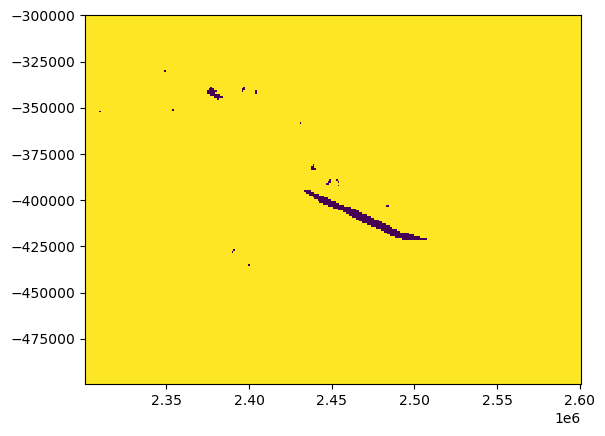

In [30]:
plt.pcolormesh(xx,yy,exclude_out_dist)

In [31]:
#df_bed = df_noqc.copy()
df_bed = df.copy()
df_bed['exclude_out_dist'] = exclude_out_dist.flatten()
df_bed = df_bed[(df_bed["bed"].isnull() == False)&(df_bed.bedmachine_mask==2)&(df_bed.exclude_out_dist==1)]
data = df_bed['bed'].values.reshape(-1,1)
coords = df_bed[['X','Y']].values
values = nst_trans_test.transform(data).T[0]
V2_radar = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
               maxlag=maxlag, normalize=False, model='spherical')
print(V2_radar.parameters)

[46216.26702826453, 1.389053065727898, 0]


In [33]:
data = bm_bed[(bedmachine_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
# df_bed_variogram = df_noqc.copy()
df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((bedmachine_mask==1)&(exclude_out_dist==1)).flatten(),:]

values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_bm = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, 
                      normalize=False, model='spherical',samples=0.3)
print(V2_bm.parameters)

[58153.28150128321, 1.5221923210110933, 0]


In [31]:
data = krig_est[(bedmachine_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
#df_bed_variogram = df_noqc.copy()
df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((bedmachine_mask==1)&(exclude_out_dist==1)).flatten(),:]
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_krig = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                       model='spherical',samples=0.3)
print(V2_krig.parameters)

[55163.85702877349, 1.3756236238367423, 0]


In [34]:
data = sgs_bed[(bedmachine_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
#df_bed_variogram = df_noqc.copy()
df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((bedmachine_mask==1)&(exclude_out_dist==1)).flatten(),:]
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_sgs = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                       model='spherical',samples=0.3)
print(V2_sgs.parameters)

[50870.49780718299, 1.4687532944898198, 0]


In [35]:
data = mcmc_bed[(bedmachine_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
#df_bed_variogram = df_noqc.copy()
df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((bedmachine_mask==1)&(exclude_out_dist==1)).flatten(),:]
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_mcmc = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                       model='spherical',samples=0.3)
print(V2_mcmc.parameters)

[55460.553870967684, 1.6964940919726932, 0]


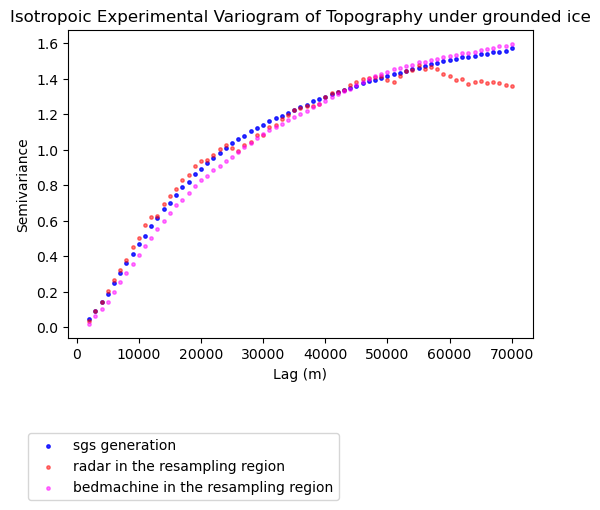

In [38]:
# extract variogram values
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
# xdatakrig = V2_krig.bins
# ydatakrig = V2_krig.experimental
xdatamcmc = V2_mcmc.bins
ydatamcmc = V2_mcmc.experimental

plt.figure(figsize=(6,4))
plt.scatter(xdatasgs, ydatasgs, s=6, c='blue',alpha=0.8,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in the resampling region')
plt.scatter(xdatabm, ydatabm, s=6, c='magenta',alpha=0.5, label='bedmachine in the resampling region')
# plt.scatter(xdatakrig, ydatakrig, s=6, c='green',alpha=0.5, label='kriging')

plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(bbox_to_anchor=(-.1,-.55), loc='lower left')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

In [119]:
SMALL_SIZE = 10
MEDIUM_SIZE = 12
LARGE_SIZE = 14

In [ ]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 210*mm))

gs = fig.add_gridspec(3,2,width_ratios=[1,1],height_ratios=[1.1,1,1.5])
#ax1 = fig.add_subplot(gs[0, 0],anchor='N')
#ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax4 = fig.add_subplot(gs[0, 1],anchor='N')
ax5 = fig.add_subplot(gs[1, 0],anchor='N')
ax6 = fig.add_subplot(gs[1, 1],anchor='N')
ax7 = fig.add_subplot(gs[2, 0],anchor='N')
ax8 = fig.add_subplot(gs[2, 1],anchor='N')

# #############################ax1###################################

# f_krig = ax1.pcolormesh(xx, yy, krig_est,vmax=2000,vmin=-2500,cmap='gist_earth')
# plt.colorbar(f_krig,ax=ax7,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
# #ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
# #ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax1.set_title('Kriging')
# #ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax1.set_xticks([])
# #ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
# ax1.axis('scaled')

# #############################ax2###################################

# mc_res_krig = geomc.calc_mass_conservation(krig_est, surf, velx, vely, dhdt, smb)
# f_mckrig = ax2.pcolormesh(xx,yy,mc_res_krig,cmap='RdBu',vmax=75,vmin=-75)
# plt.colorbar(f_mckrig,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
# #ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax2.set_title('Mass Conservation Residual')
# ax2.set_xticks([])
# ax2.set_yticks([])
# #ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax2.axis('scaled')

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx, yy, bm_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
plt.colorbar(f_bm,ax=ax7,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax3.set_title('BedMachine v3')
ax3.annotate('BedMachine v3', (-0.23, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = LARGE_SIZE)
ax3.annotate('Topography', (0.33, 1.07), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = MEDIUM_SIZE)
#ax3.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax3.set_xticks([])
#ax3.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax3.axis('scaled')

#############################ax4###################################

mc_bm = geomc.calc_mass_conservation(bm_bed, surf, velx, vely, dhdt, smb)
f_mcbm = ax4.pcolormesh(xx,yy,mc_bm,cmap='RdBu',vmax=75,vmin=-75)
plt.colorbar(f_mcbm,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
#ax4.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax4.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax4.set_title('Types of Region')
ax4.set_xticks([])
ax4.set_yticks([])
#ax4.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax4.annotate('Mass Conservation Residual', (0.1, 1.07), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = MEDIUM_SIZE)
ax4.axis('scaled')

#############################ax5###################################

f_sgs = ax5.pcolormesh(xx, yy, sgs_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
#plt.colorbar(f_bm,ax=ax4,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
ax5.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
ax5.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax5.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax5.set_title('SGS')
ax5.annotate('SGS', (-0.23, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = LARGE_SIZE)
#ax5.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax5.set_xticks([])
#ax5.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax5.axis('scaled')

#############################ax6###################################

mc_sgs = geomc.calc_mass_conservation(sgs_bed, surf, velx, vely, dhdt, smb)
f_mcsgs = ax6.pcolormesh(xx,yy,mc_sgs,cmap='RdBu',vmax=75,vmin=-75)
#ax6.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax6.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax6.set_title('Types of Region')
ax6.set_xticks([])
ax6.set_yticks([])
#ax6.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax6.axis('scaled')

#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx, yy, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
ax7.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
ax7.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax7.set_title('MCMC+SGS')
ax7.annotate('Mass-Conserving MCMC', (-0.23, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = LARGE_SIZE)
#ax7.set_xlabel('easting (m)',fontsize=12)
#ax7.set_xticks([])
#ax7.set_ylabel('northing (m)',fontsize=12)
ax7.axis('scaled')

#############################ax8###################################

mc_res_mcmc = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely, dhdt, smb)
f_mcmcmc = ax8.pcolormesh(xx,yy,mc_res_mcmc,cmap='RdBu',vmax=75,vmin=-75)
ax8.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax2.set_title('Types of Region')
#ax8.set_xticks([])
ax8.set_yticks([])
#ax8.set_ylabel('northing (m)',fontsize=12)
#ax8.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax8.axis('scaled')


#ax1.set_anchor('N')
#ax2.set_anchor('N')
ax3.set_anchor('S')
ax4.set_anchor('S')
ax5.set_anchor('N')
ax6.set_anchor('N')
ax7.set_anchor('N')
ax8.set_anchor('N')

plt.tight_layout(pad=0.9,h_pad=0.0)

plt.savefig('topoComparison.png')

In [20]:
sgs_bed = np.loadtxt('./59_crf/sgs_bed_59_crf.txt')
bm_bed = df_bm.bed.values.reshape(xx.shape)
loaded_bed_temp = np.loadtxt("./59_sgs/bed_cache_59_sgs_3_20.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
mcmc_bed = loaded_bed_temp[-1,:,:]

In [102]:
SMALL_SIZE = 10
MEDIUM_SIZE = 12
LARGE_SIZE = 12

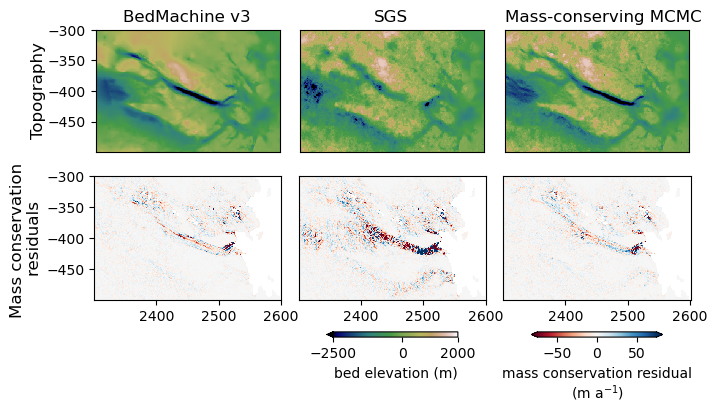

In [105]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 100*mm))

gs = fig.add_gridspec(2,3,width_ratios=[1,1,1],height_ratios=[1,1.5])
#ax1 = fig.add_subplot(gs[0, 0],anchor='N')
#ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax4 = fig.add_subplot(gs[1, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax6 = fig.add_subplot(gs[1, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')
ax8 = fig.add_subplot(gs[1, 2],anchor='N')

# #############################ax1###################################

# f_krig = ax1.pcolormesh(xx, yy, krig_est,vmax=2000,vmin=-2500,cmap='gist_earth')
# plt.colorbar(f_krig,ax=ax7,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
# #ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
# #ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax1.set_title('Kriging')
# #ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax1.set_xticks([])
# #ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
# ax1.axis('scaled')

# #############################ax2###################################

# mc_res_krig = geomc.calc_mass_conservation(krig_est, surf, velx, vely, dhdt, smb)
# f_mckrig = ax2.pcolormesh(xx,yy,mc_res_krig,cmap='RdBu',vmax=75,vmin=-75)
# plt.colorbar(f_mckrig,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
# #ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax2.set_title('Mass Conservation Residual')
# ax2.set_xticks([])
# ax2.set_yticks([])
# #ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax2.axis('scaled')

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx/1000, yy/1000, bm_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
plt.colorbar(f_bm,ax=ax6,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',
             pad=0.12,shrink=0.7,extend='min',ticks=[-2500, 0, 2000])
#ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax3.set_title('BedMachine v3')
ax3.annotate('BedMachine v3', (0.15, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax3.annotate('Topography', (-0.35, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
#ax3.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax3.set_xticks([])
#ax3.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax3.axis('scaled')

#############################ax4###################################

mc_bm = geomc.calc_mass_conservation(bm_bed, surf, velx, vely, dhdt, smb)
f_mcbm = ax4.pcolormesh(xx/1000,yy/1000,mc_bm,cmap='RdBu',vmax=75,vmin=-75)
plt.colorbar(f_mcbm,ax=ax8,label='mass conservation residual\n(m a$^{-1}$)',aspect=25,
             orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
#ax4.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax4.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax4.set_title('Types of Region')
#ax4.set_xticks([])
#ax4.set_yticks([])
#ax4.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax4.annotate('Mass conservation \n        residuals', (-0.45,0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
ax4.axis('scaled')

#############################ax5###################################

f_sgs = ax5.pcolormesh(xx/1000, yy/1000, sgs_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
#plt.colorbar(f_bm,ax=ax4,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
#ax5.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax5.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax5.set_title('SGS')
ax5.annotate('SGS', (0.4, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax5.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax5.set_xticks([])
ax5.set_yticks([])
#ax5.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax5.axis('scaled')

#############################ax6###################################

mc_sgs = geomc.calc_mass_conservation(sgs_bed, surf, velx, vely, dhdt, smb)
f_mcsgs = ax6.pcolormesh(xx/1000,yy/1000,mc_sgs,cmap='RdBu',vmax=75,vmin=-75)
#ax6.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax6.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax6.set_title('Types of Region')
#ax6.set_xticks([])
ax6.set_yticks([])
#ax6.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax6.axis('scaled')

#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx/1000, yy/1000, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
#ax7.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax7.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax7.set_title('MCMC+SGS')
ax7.annotate('Mass-conserving MCMC', (0, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax7.set_yticks([])
#ax7.set_xlabel('easting (m)',fontsize=12)
ax7.set_xticks([])
#ax7.set_ylabel('northing (m)',fontsize=12)
ax7.axis('scaled')

#############################ax8###################################

mc_res_mcmc = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely, dhdt, smb)
f_mcmcmc = ax8.pcolormesh(xx/1000,yy/1000,mc_res_mcmc,cmap='RdBu',vmax=75,vmin=-75)
#ax8.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax2.set_title('Types of Region')
#ax8.set_xticks([])
ax8.set_yticks([])
#ax8.set_ylabel('northing (m)',fontsize=12)
#ax8.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax8.axis('scaled')


#ax1.set_anchor('N')
#ax2.set_anchor('N')
ax3.set_anchor('N')
ax4.set_anchor('N')
ax5.set_anchor('N')
ax6.set_anchor('N')
ax7.set_anchor('N')
ax8.set_anchor('N')

plt.tight_layout(pad=0,h_pad=0.0)

plt.savefig('topoComparison.png',bbox_inches='tight',dpi=300)

In [21]:
SMALL_SIZE = 22
MEDIUM_SIZE = 24
LARGE_SIZE = 24

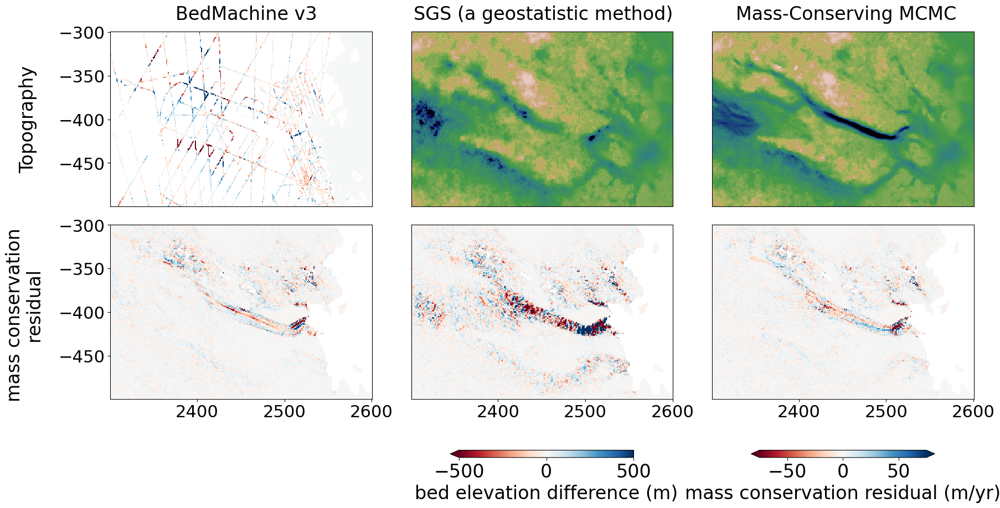

In [23]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm*2.5, 100*mm*2.3))

gs = fig.add_gridspec(2,3,width_ratios=[1,1,1],height_ratios=[1,1.5])
#ax1 = fig.add_subplot(gs[0, 0],anchor='N')
#ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax4 = fig.add_subplot(gs[1, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax6 = fig.add_subplot(gs[1, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')
ax8 = fig.add_subplot(gs[1, 2],anchor='N')

# #############################ax1###################################

# f_krig = ax1.pcolormesh(xx, yy, krig_est,vmax=2000,vmin=-2500,cmap='gist_earth')
# plt.colorbar(f_krig,ax=ax7,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
# #ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
# #ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax1.set_title('Kriging')
# #ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax1.set_xticks([])
# #ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
# ax1.axis('scaled')

# #############################ax2###################################

# mc_res_krig = geomc.calc_mass_conservation(krig_est, surf, velx, vely, dhdt, smb)
# f_mckrig = ax2.pcolormesh(xx,yy,mc_res_krig,cmap='RdBu',vmax=75,vmin=-75)
# plt.colorbar(f_mckrig,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
# #ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax2.set_title('Mass Conservation Residual')
# ax2.set_xticks([])
# ax2.set_yticks([])
# #ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax2.axis('scaled')

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx/1000, yy/1000, bm_bed - df.bed.values.reshape(xx.shape),vmax=500,vmin=-500,cmap='RdBu')
cbar1 = plt.colorbar(f_bm,ax=ax6,aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
cbar1.set_label(label='bed elevation difference (m)', size=MEDIUM_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE)
#ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax3.set_title('BedMachine v3')
ax3.annotate('BedMachine v3', (0.25, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax3.annotate('Topography', (-0.35, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
#ax3.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax3.set_xticks([])
#ax3.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax3.axis('scaled')
ax3.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax3.xaxis.set_tick_params(labelsize=SMALL_SIZE)


#############################ax4###################################

mc_bm = geomc.calc_mass_conservation(bm_bed, surf, velx, vely, dhdt, smb)
f_mcbm = ax4.pcolormesh(xx/1000,yy/1000,mc_bm,cmap='RdBu',vmax=75,vmin=-75)
cbar2 = plt.colorbar(f_mcbm,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
cbar2.set_label(label='mass conservation residual (m/yr)', size=MEDIUM_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE)
#ax4.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax4.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax4.set_title('Types of Region')
#ax4.set_xticks([])
#ax4.set_yticks([])
#ax4.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax4.annotate('mass conservation \n          residual', (-0.4,0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
ax4.axis('scaled')
ax4.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax4.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax5###################################

f_sgs = ax5.pcolormesh(xx/1000, yy/1000, sgs_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
#plt.colorbar(f_bm,ax=ax4,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
#ax5.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax5.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax5.set_title('SGS')
ax5.annotate('SGS (a geostatistic method)', (0.01, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax5.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax5.set_xticks([])
ax5.set_yticks([])
#ax5.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax5.axis('scaled')
ax5.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax5.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax6###################################

mc_sgs = geomc.calc_mass_conservation(sgs_bed, surf, velx, vely, dhdt, smb)
f_mcsgs = ax6.pcolormesh(xx/1000,yy/1000,mc_sgs,cmap='RdBu',vmax=75,vmin=-75)
#ax6.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax6.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax6.set_title('Types of Region')
#ax6.set_xticks([])
ax6.set_yticks([])
#ax6.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax6.axis('scaled')
ax6.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax6.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx/1000, yy/1000, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
#ax7.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax7.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax7.set_title('MCMC+SGS')
ax7.annotate('Mass-Conserving MCMC', (0.09, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax7.set_yticks([])
#ax7.set_xlabel('easting (m)',fontsize=12)
ax7.set_xticks([])
#ax7.set_ylabel('northing (m)',fontsize=12)
ax7.axis('scaled')
ax7.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax7.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax8###################################

mc_res_mcmc = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely, dhdt, smb)
f_mcmcmc = ax8.pcolormesh(xx/1000,yy/1000,mc_res_mcmc,cmap='RdBu',vmax=75,vmin=-75)
#ax8.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax2.set_title('Types of Region')
#ax8.set_xticks([])
ax8.set_yticks([])
#ax8.set_ylabel('northing (m)',fontsize=12)
#ax8.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax8.axis('scaled')
ax8.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax8.xaxis.set_tick_params(labelsize=SMALL_SIZE)


#ax1.set_anchor('N')
#ax2.set_anchor('N')
ax3.set_anchor('N')
ax4.set_anchor('N')
ax5.set_anchor('N')
ax6.set_anchor('N')
ax7.set_anchor('N')
ax8.set_anchor('N')

plt.tight_layout(pad=0,h_pad=0.0)

plt.savefig('topoComparison_test.png',bbox_inches='tight',dpi=300)

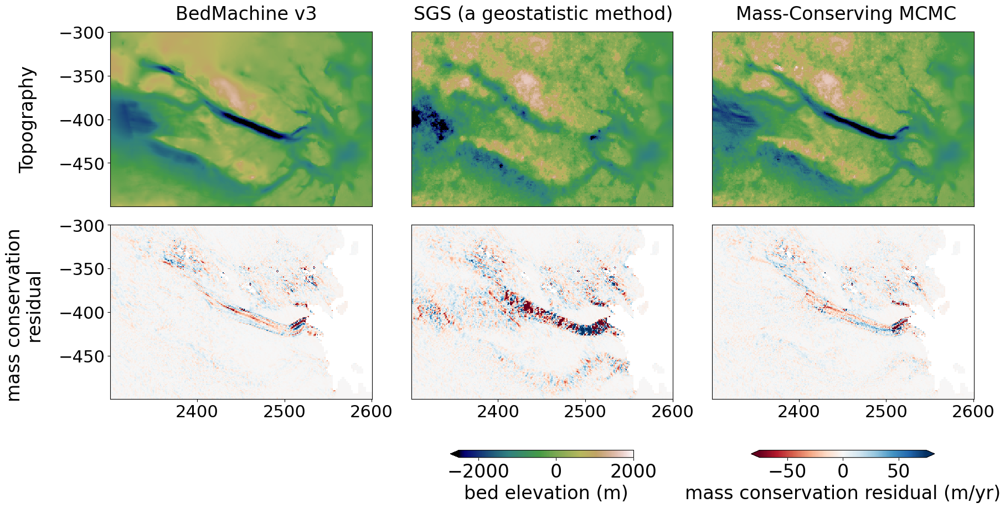

In [140]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm*2.5, 100*mm*2.3))

gs = fig.add_gridspec(2,3,width_ratios=[1,1,1],height_ratios=[1,1.5])
#ax1 = fig.add_subplot(gs[0, 0],anchor='N')
#ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax4 = fig.add_subplot(gs[1, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax6 = fig.add_subplot(gs[1, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')
ax8 = fig.add_subplot(gs[1, 2],anchor='N')

[]

# #############################ax1###################################

# f_krig = ax1.pcolormesh(xx, yy, krig_est,vmax=2000,vmin=-2500,cmap='gist_earth')
# plt.colorbar(f_krig,ax=ax7,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
# #ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
# #ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax1.set_title('Kriging')
# #ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax1.set_xticks([])
# #ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
# ax1.axis('scaled')

# #############################ax2###################################

# mc_res_krig = geomc.calc_mass_conservation(krig_est, surf, velx, vely, dhdt, smb)
# f_mckrig = ax2.pcolormesh(xx,yy,mc_res_krig,cmap='RdBu',vmax=75,vmin=-75)
# plt.colorbar(f_mckrig,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
# #ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax2.set_title('Mass Conservation Residual')
# ax2.set_xticks([])
# ax2.set_yticks([])
# #ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax2.axis('scaled')

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx/1000, yy/1000, bm_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
cbar1 = plt.colorbar(f_bm,ax=ax6,aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
cbar1.set_label(label='bed elevation (m)', size=MEDIUM_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE)
#ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax3.set_title('BedMachine v3')
ax3.annotate('BedMachine v3', (0.25, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax3.annotate('Topography', (-0.35, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
#ax3.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax3.set_xticks([])
#ax3.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax3.axis('scaled')
ax3.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax3.xaxis.set_tick_params(labelsize=SMALL_SIZE)


#############################ax4###################################

mc_bm = geomc.calc_mass_conservation(bm_bed, surf, velx, vely, dhdt, smb)
f_mcbm = ax4.pcolormesh(xx/1000,yy/1000,mc_bm,cmap='RdBu',vmax=75,vmin=-75)
cbar2 = plt.colorbar(f_mcbm,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
cbar2.set_label(label='mass conservation residual (m/yr)', size=MEDIUM_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE)
#ax4.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax4.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax4.set_title('Types of Region')
#ax4.set_xticks([])
#ax4.set_yticks([])
#ax4.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax4.annotate('mass conservation \n          residual', (-0.4,0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
ax4.axis('scaled')
ax4.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax4.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax5###################################

f_sgs = ax5.pcolormesh(xx/1000, yy/1000, sgs_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
#plt.colorbar(f_bm,ax=ax4,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
#ax5.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax5.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax5.set_title('SGS')
ax5.annotate('SGS (a geostatistic method)', (0.01, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax5.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax5.set_xticks([])
ax5.set_yticks([])
#ax5.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax5.axis('scaled')
ax5.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax5.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax6###################################

mc_sgs = geomc.calc_mass_conservation(sgs_bed, surf, velx, vely, dhdt, smb)
f_mcsgs = ax6.pcolormesh(xx/1000,yy/1000,mc_sgs,cmap='RdBu',vmax=75,vmin=-75)
#ax6.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax6.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax6.set_title('Types of Region')
#ax6.set_xticks([])
ax6.set_yticks([])
#ax6.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax6.axis('scaled')
ax6.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax6.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx/1000, yy/1000, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
#ax7.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax7.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax7.set_title('MCMC+SGS')
ax7.annotate('Mass-Conserving MCMC', (0.09, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax7.set_yticks([])
#ax7.set_xlabel('easting (m)',fontsize=12)
ax7.set_xticks([])
#ax7.set_ylabel('northing (m)',fontsize=12)
ax7.axis('scaled')
ax7.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax7.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax8###################################

mc_res_mcmc = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely, dhdt, smb)
f_mcmcmc = ax8.pcolormesh(xx/1000,yy/1000,mc_res_mcmc,cmap='RdBu',vmax=75,vmin=-75)
#ax8.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax2.set_title('Types of Region')
#ax8.set_xticks([])
ax8.set_yticks([])
#ax8.set_ylabel('northing (m)',fontsize=12)
#ax8.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax8.axis('scaled')
ax8.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax8.xaxis.set_tick_params(labelsize=SMALL_SIZE)


#ax1.set_anchor('N')
#ax2.set_anchor('N')
ax3.set_anchor('N')
ax4.set_anchor('N')
ax5.set_anchor('N')
ax6.set_anchor('N')
ax7.set_anchor('N')
ax8.set_anchor('N')

plt.tight_layout(pad=0,h_pad=0.0)

plt.savefig('topoComparison.png',bbox_inches='tight',dpi=300)

In [133]:
zoom_in = (-350, -400, 2350, 2450)
zoom_in = (100, 150, 50, 150)

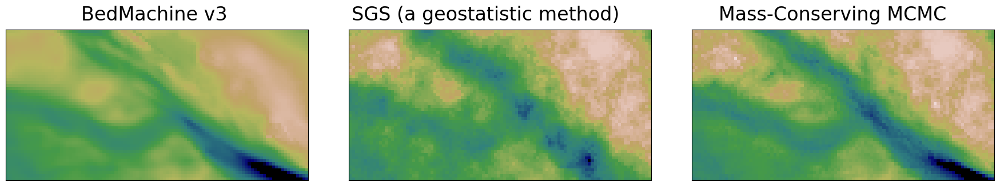

In [172]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm*2.5, 100*mm*2.3))

gs = fig.add_gridspec(2,3,width_ratios=[1,1,1],height_ratios=[1,1.5])
#ax1 = fig.add_subplot(gs[0, 0],anchor='N')
#ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')

# #############################ax1###################################

# f_krig = ax1.pcolormesh(xx, yy, krig_est,vmax=2000,vmin=-2500,cmap='gist_earth')
# plt.colorbar(f_krig,ax=ax7,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
# #ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
# #ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax1.set_title('Kriging')
# #ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax1.set_xticks([])
# #ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
# ax1.axis('scaled')

# #############################ax2###################################

# mc_res_krig = geomc.calc_mass_conservation(krig_est, surf, velx, vely, dhdt, smb)
# f_mckrig = ax2.pcolormesh(xx,yy,mc_res_krig,cmap='RdBu',vmax=75,vmin=-75)
# plt.colorbar(f_mckrig,ax=ax8,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
# #ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# #ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
# ax2.set_title('Mass Conservation Residual')
# ax2.set_xticks([])
# ax2.set_yticks([])
# #ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
# ax2.axis('scaled')

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, yy[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, bm_bed[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]],vmax=2000,vmin=-2500,cmap='gist_earth')
cbar1 = plt.colorbar(f_bm,ax=ax6,aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
cbar1.set_label(label='bed elevation (m)', size=MEDIUM_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE)
#ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax3.set_title('BedMachine v3')
ax3.annotate('BedMachine v3', (0.25, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax3.annotate('Topography', (-0.35, 0.5), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
#ax3.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax3.set_xticks([])
ax3.set_yticks([])
#ax3.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax3.axis('scaled')
ax3.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax3.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#############################ax5###################################

f_sgs = ax5.pcolormesh(xx[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, yy[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, sgs_bed[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]],vmax=2000,vmin=-2500,cmap='gist_earth')
#plt.colorbar(f_bm,ax=ax4,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
#ax5.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax5.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax5.set_title('SGS')
ax5.annotate('SGS (a geostatistic method)', (0.01, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax5.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax5.set_xticks([])
ax5.set_yticks([])
#ax5.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax5.axis('scaled')
ax5.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax5.xaxis.set_tick_params(labelsize=SMALL_SIZE)


#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, yy[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, mcmc_bed[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]],vmax=2000,vmin=-2500,cmap='gist_earth')
#ax7.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax7.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax7.set_title('MCMC+SGS')
ax7.annotate('Mass-Conserving MCMC', (0.09, 1.1), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
ax7.set_yticks([])
#ax7.set_xlabel('easting (m)',fontsize=12)
ax7.set_xticks([])
#ax7.set_ylabel('northing (m)',fontsize=12)
ax7.axis('scaled')
ax7.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax7.xaxis.set_tick_params(labelsize=SMALL_SIZE)

#ax1.set_anchor('N')
#ax2.set_anchor('N')
ax3.set_anchor('N')
ax4.set_anchor('N')
ax5.set_anchor('N')
ax6.set_anchor('N')
ax7.set_anchor('N')
ax8.set_anchor('N')

plt.tight_layout(pad=0,h_pad=0.0)

plt.savefig('topoComparison_zoomin.png',bbox_inches='tight',dpi=300)

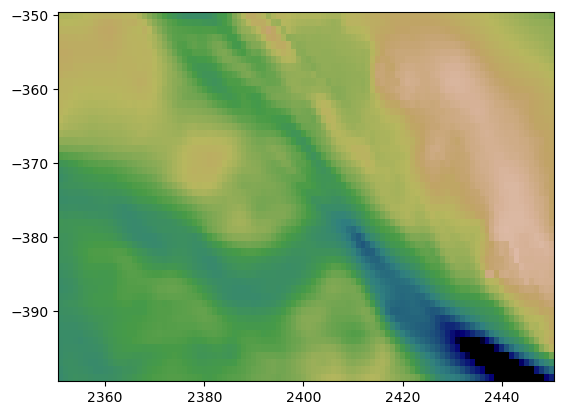

In [137]:
plt.pcolormesh(xx[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, yy[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]]/1000, bm_bed[zoom_in[0]:zoom_in[1],zoom_in[2]:zoom_in[3]],vmax=2000,vmin=-2500,cmap='gist_earth')

NameError: name 'mc_region_mask_edge' is not defined

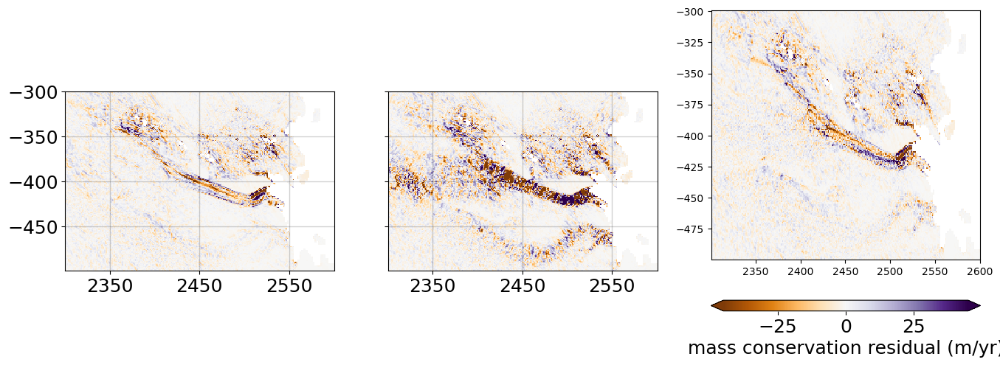

In [26]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
fig = plt.figure(figsize=(16,6))

gs = fig.add_gridspec(1,3,width_ratios=[1,1,1])
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')

y_ticks = [-500,-450,-400,-350,-300]
x_ticks = [2350,2450,2550]


#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
mc_bm = geomc.calc_mass_conservation(bm_bed, surf, velx, vely, dhdt, smb)
f_mcbm = ax3.pcolormesh(xx/1000,yy/1000,mc_bm,cmap='PuOr',vmax=45,vmin=-45)
ax3.grid(True, which='both', color="black", lw=1, alpha=0.18)
cbar = plt.colorbar(f_mcbm,ax=ax7,aspect=25,orientation='horizontal',
                    location='bottom',pad=0.12,shrink=1,extend='both')
cbar.set_label(label='mass conservation residual (m/yr)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
#ax3.set_title('BedMachine v3',fontsize=18)
ax3.set_xticks(x_ticks)
ax3.set_yticks(y_ticks)
ax3.yaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax3.yaxis.set_tick_params(labelsize=18)
ax3.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax3.xaxis.set_tick_params(labelsize=18)
ax3.axis('scaled')


#############################ax5###################################

mc_sgs = geomc.calc_mass_conservation(sgs_bed, surf, velx, vely, dhdt, smb)
f_mcsgs = ax5.pcolormesh(xx/1000,yy/1000,mc_sgs,cmap='PuOr',vmax=45,vmin=-45)
ax5.grid(True, which='both', color="black", lw=1, alpha=0.18)
#ax5.set_title('Sequential Gaussian Simulation', fontsize=18)
ax5.set_xticks(x_ticks)
ax5.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax5.xaxis.set_tick_params(labelsize=18)
ax5.set_yticks(y_ticks)
ax5.set_yticklabels([])
ax5.axis('scaled')


#############################ax7###################################

mc_mcmc = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely, dhdt, smb)
#f_mcmc = ax7.pcolormesh(xx/1000, yy/1000, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth',zorder=1)
f_mcmcmc = ax7.pcolormesh(xx/1000,yy/1000,mc_mcmc,cmap='PuOr',vmax=45,vmin=-45)
ax7.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
ax7.grid(True, which='both', color="black", lw=1, alpha=0.18)
#ax7.set_title('Mass-Conserving MCMC',fontsize=18)
ax7.set_xticks(x_ticks)
ax7.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax7.xaxis.set_tick_params(labelsize=18)
ax7.set_yticks(y_ticks)
ax7.set_yticklabels([])
ax7.axis('scaled')

ax3.set_anchor('N')
ax5.set_anchor('N')
ax7.set_anchor('N')

plt.tight_layout(pad=2,h_pad=0.0)

plt.savefig('topoComparison.png')

In [157]:
geomc.loss_mc(mc_bm, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)

3664671.392865846

In [158]:
geomc.loss_mc(mc_sgs, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)

26878306.964842197

In [159]:
geomc.loss_mc(mc_mcmc, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)

3124868.4746508775

In [ ]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
fig = plt.figure(figsize=(16,6))

gs = fig.add_gridspec(1,3,width_ratios=[1,1,1])
ax3 = fig.add_subplot(gs[0, 0],anchor='N')
ax5 = fig.add_subplot(gs[0, 1],anchor='N')
ax7 = fig.add_subplot(gs[0, 2],anchor='N')

y_ticks = [-500,-450,-400,-350,-300]
x_ticks = [2350,2450,2550]


#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_bm = ax3.pcolormesh(xx/1000, yy/1000, bm_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
ax3.grid(True, which='both', color="black", lw=1, alpha=0.18)
cbar = plt.colorbar(f_bm,ax=ax7,aspect=25,orientation='horizontal',
                    location='bottom',pad=0.12,shrink=1,extend='min')
cbar.set_label(label='bed elevation (m)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
# ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
# ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax3.set_title('BedMachine v3',fontsize=18)
#ax3.annotate('BedMachine v3', (0, 0), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax3.annotate('Topography', (0, 0), xycoords = 'axes fraction', rotation = 90, va = 'center', fontsize = MEDIUM_SIZE)
#ax3.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax3.set_xticks(x_ticks)
ax3.set_yticks(y_ticks)
ax3.yaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax3.yaxis.set_tick_params(labelsize=18)
ax3.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax3.xaxis.set_tick_params(labelsize=18)
#ax3.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax3.axis('scaled')


#############################ax5###################################

f_sgs = ax5.pcolormesh(xx/1000, yy/1000, sgs_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
ax5.grid(True, which='both', color="black", lw=1, alpha=0.18)
#plt.colorbar(f_bm,ax=ax4,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
#ax5.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax5.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax5.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax5.set_title('Sequential Gaussian Simulation', fontsize=18)
#ax5.annotate('SGS', (0, 0), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax5.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax5.set_xticks(x_ticks)
ax5.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax5.xaxis.set_tick_params(labelsize=18)
ax5.set_yticks(y_ticks)
ax5.set_yticklabels([])
#ax5.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax5.axis('scaled')


#############################ax7###################################

f_mcmc = ax7.pcolormesh(xx/1000, yy/1000, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth',zorder=1)
ax7.grid(True, which='both', color="black", lw=1, alpha=0.18)
#ax7.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax7.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax7.set_title('Mass-Conserving MCMC',fontsize=18)
#ax7.annotate('Mass-Conserving MCMC', (0, 0), xycoords = 'axes fraction', rotation = 0, va = 'center', fontsize = LARGE_SIZE)
#ax7.set_xlabel('easting (m)',fontsize=12)
ax7.set_xticks(x_ticks)
ax7.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
ax7.xaxis.set_tick_params(labelsize=18)
ax7.set_yticks(y_ticks)
ax7.set_yticklabels([])
#ax7.set_ylabel('northing (m)',fontsize=12)
ax7.axis('scaled')

ax3.set_anchor('N')
ax5.set_anchor('N')
ax7.set_anchor('N')

plt.tight_layout(pad=2,h_pad=0.0)

plt.savefig('topoComparison.png')

### one mcmc topo

In [93]:
vel_mag = np.sqrt(df.vel_x**2 + df.vel_y**2).values.reshape(xx.shape)

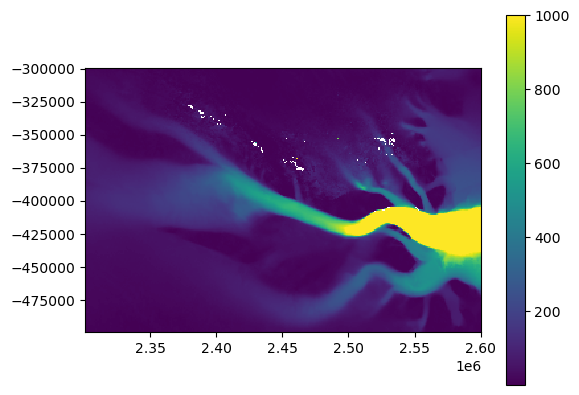

In [95]:
plt.pcolormesh(xx,yy,vel_mag,vmax=1000)
plt.axis('scaled')
plt.colorbar()

In [46]:
sgs_bed = np.loadtxt('./57_crf/sgs_bed_57_crf.txt')
bm_bed = df_bm.bed.values.reshape(xx.shape)
loaded_bed_temp = np.loadtxt("./57_sgs/bed_cache_57_sgs_3_20.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
mcmc_bed = loaded_bed_temp[-1,:,:]

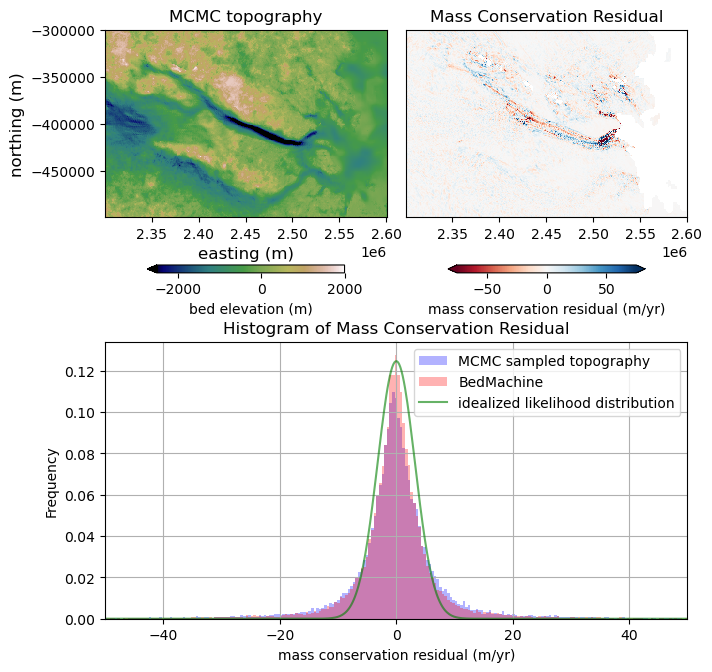

In [53]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 170*mm))

gs = fig.add_gridspec(2,2,width_ratios=[1,1],height_ratios=[1,1])
ax1 = fig.add_subplot(gs[0, 0],anchor='N')
ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[1, :],anchor='N')

#############################ax1###################################

f_mcmc = ax1.pcolormesh(xx, yy, mcmc_bed,vmax=2000,vmin=-2500,cmap='gist_earth')
plt.colorbar(f_mcmc,ax=ax1,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='min')
#ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax1.set_title('MCMC topography')
ax1.set_xlabel('easting (m)',fontsize=12)
#ax1.set_xticks([])
ax1.set_ylabel('northing (m)',fontsize=12)
ax1.axis('scaled')

#############################ax8###################################

mc_res_mcmc = geomc.calc_mass_conservation(mcmc_bed, surf, velx, vely, dhdt, smb)
f_mcmcmc = ax2.pcolormesh(xx,yy,mc_res_mcmc,cmap='RdBu',vmax=75,vmin=-75)
plt.colorbar(f_mcmcmc,ax=ax2,label='mass conservation residual (m/yr)',aspect=25,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
#ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax2.set_title('Mass Conservation Residual')
#ax2.set_xticks([])
ax2.set_yticks([])
#ax2.set_ylabel('northing (m)',fontsize=12)
#ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax2.axis('scaled')

#############################ax3###################################


sigma3 = 3.2
xl3=np.linspace(-100, 100, num=1000)
gaussian_model=1/(sigma3*np.sqrt(2*np.pi))*np.exp(-0.5*np.square(xl3/sigma3))

bm_mask = df_bm['source'].values.reshape(xx.shape) == 2

mc_res_bm_sr2 = mc_res_bm[bm_mask==1]
mc_res_bm_sr2_f = mc_res_bm_sr2.flatten()
mc_res_bm_sr2_f = mc_res_bm_sr2_f[~np.isnan(mc_res_bm_sr2_f)]
mc_res_sr2 = mc_res_mcmc[mc_region_mask==1]
mc_res_sr2_f = mc_res_sr2.flatten()
mc_res_sr2_f = mc_res_sr2_f[~np.isnan(mc_res_sr2_f)]
bins=np.histogram(np.hstack((mc_res_sr2_f,mc_res_bm_sr2_f)), bins=1000)[1] #get the bin edges

plt.hist(mc_res_sr2_f, bins=bins, facecolor='blue', alpha=0.3,density=True,label='MCMC sampled topography')
plt.hist(mc_res_bm_sr2_f, bins=bins, facecolor='red', alpha=0.3,density=True,label='BedMachine')
plt.plot(xl3, gaussian_model, color='Green',alpha=0.6,label='idealized likelihood distribution')
plt.xlim([-50,50]);
plt.legend()
plt.xlabel('mass conservation residual (m/yr)');
plt.ylabel('Frequency');
plt.title('Histogram of Mass Conservation Residual')
plt.grid(True)

ax1.set_anchor('N')
ax2.set_anchor('N')
ax3.set_anchor('N')

plt.tight_layout(pad=0.6,h_pad=0.0)

plt.savefig('oneTopoSample.png')

### preprocessing

In [28]:
xmin_set = 2300000
xmax_set = 2600000
ymin_set = -500000
ymax_set = -300000
df_before = pd.read_csv('Data/compiled_Aurora_noQC_iceshelve_included_3.csv')
df_before = df_before[(df_before['X']>xmin_set) & (df_before['X']<=xmax_set) & (df_before['Y']>ymin_set) & (df_before['Y']<=ymax_set)].copy()

In [29]:
n_iter_list_avg =  [1000] * 4
file_postfix_list_avg = ['_55_prep_'+str(i)+'foravg' for i in range(13,17)]
choice_param_list_avg = [1] * 4

In [ ]:
# load file
nsil = np.floor(np.divide(n_iter_list_avg, choice_param_list_avg)).astype(int)
loaded_bed_avg = np.zeros((np.sum(nsil), rows, cols))
for i in range(len(nsil)):
    file_postfix = file_postfix_list_avg[i]
    loaded_bed_temp = np.loadtxt("./55_prep/bed_cache"+file_postfix+".txt")
    loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
    loaded_bed_avg[int(np.sum(nsil[:i])):int(np.sum(nsil[:i+1])),:,:] = loaded_bed_temp

In [ ]:
avg_bed = np.mean(loaded_bed_avg, axis=0)

In [ ]:
rfradardiff = avg_bed - df_before.bed.values.reshape(xx.shape)

In [ ]:
N = 128
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(1/256, 1, N)
vals1[:, 1] = np.linspace(133/256, 1, N)
vals1[:, 2] = np.linspace(113/256, 1, N)

vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(1,166/256, N)
vals2[:, 1] = np.linspace(1,97/256, N)
vals2[:, 2] = np.linspace(1,26/256, N)

cmp_gnbr = ListedColormap(np.vstack([vals1,vals2]))

In [ ]:
N = 128
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(58/256, 1, N)
vals1[:, 1] = np.linspace(40/256, 1, N)
vals1[:, 2] = np.linspace(191/256, 1, N)

vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(1,191/256, N)
vals2[:, 1] = np.linspace(1,38/256, N)
vals2[:, 2] = np.linspace(1,163/256, N)

cmp_pipr = ListedColormap(np.vstack([vals1,vals2]))

In [ ]:
np.nanmax(rfradardiff),np.nanmin(rfradardiff)

In [ ]:
np.nanmax(avg_bed),np.nanmin(avg_bed)

In [ ]:
SMALL_SIZE = 8.5
MEDIUM_SIZE = 9.5

In [ ]:
df_exclude = pd.read_csv('./excluded_Denman_QC_55_shallow.csv')
ex = df_exclude.X.values/1000
ey = df_exclude.Y.values/1000
res = 1000/1000
bx = ex - res/2
by = ey - res/2

In [ ]:
from matplotlib.patches import Rectangle

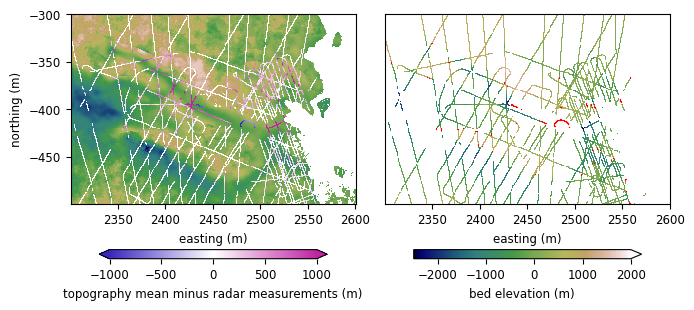

In [89]:
#############################layout###################################

mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 82*mm))

gs = fig.add_gridspec(1,2,width_ratios=[1,1])
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])

#############################ax1###################################

f_bed = ax1.pcolormesh(xx/1000,yy/1000,avg_bed,cmap='gist_earth',vmin=-2500,vmax=2000)
f_diff = ax1.pcolormesh(xx/1000, yy/1000,rfradardiff,vmin=-1000, vmax=1000,cmap=cmp_pipr)

cbar1 = plt.colorbar(f_bed,ax=ax2,aspect=25,orientation='horizontal',
             location='bottom',pad=0.16,shrink=0.8,extend='max')
cbar1.set_label(label='bed elevation (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
cbar2 = plt.colorbar(f_diff,ax=ax1,aspect=25,orientation='horizontal',
             location='bottom',pad=0.16,shrink=0.8,extend='both')
cbar2.set_label(label='topography mean minus radar measurements (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)

#ax1.set_title('ensemble mean',size=MEDIUM_SIZE)
ax1.set_yticks([-300,-350,-400,-450])
ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.axis('scaled')

#############################ax2###################################
radar = np.where((df_bm['mask'].values.reshape(xx.shape)==2),df_before.bed.values.reshape(xx.shape),np.nan)
f_bed = ax2.pcolormesh(xx/1000,yy/1000,radar,cmap='gist_earth',vmin=-2500,vmax=2000)

boxes = [matplotlib.patches.Rectangle((x, y), res, res,fill=None) for x, y in zip(bx,by)]
pc = matplotlib.collections.PatchCollection(boxes, facecolor='red', edgecolor='red',lw=0.1)
ax2.add_collection(pc)

#ax2.set_title('excluded radar measurements',fontsize=MEDIUM_SIZE)

ax2.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.set_yticks([])
ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax2.axis('scaled')

plt.tight_layout(h_pad=0.1)

plt.savefig('preprocessResults.png',bbox_inches='tight',dpi=300)

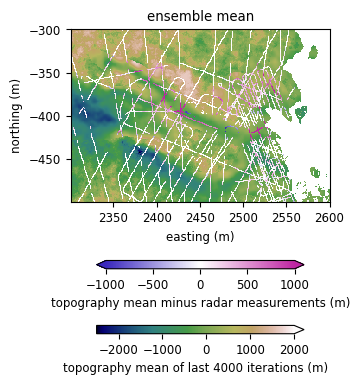

In [62]:
mm = 1/25.4
fig = plt.figure(figsize=(85*mm, 120*mm))
ax = fig.add_subplot(111)
f_bed = ax.pcolormesh(xx/1000,yy/1000,avg_bed,cmap='gist_earth',vmin=-2500,vmax=2000)
f_diff = ax.pcolormesh(xx/1000, yy/1000,rfradardiff,vmin=-1000, vmax=1000,cmap=cmp_pipr)

# boxes = [matplotlib.patches.Rectangle((x, y), res, res, fill=False) for x, y in zip(bx,by)]
# pc = matplotlib.collections.PatchCollection(boxes, facecolor=None, edgecolor='orange',lw=0.07)
# ax.add_collection(pc)

cbar1 = plt.colorbar(f_bed,ax=ax,aspect=25,orientation='horizontal',
             location='bottom',pad=0.06,shrink=0.8,extend='max')
cbar1.set_label(label='topography mean of last 4000 iterations (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
cbar2 = plt.colorbar(f_diff,ax=ax,aspect=25,orientation='horizontal',
             location='bottom',pad=0.16,shrink=0.8,extend='both')
cbar2.set_label(label='topography mean minus radar measurements (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
ax.set_title('preprocess chain results',size=MEDIUM_SIZE)
ax.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
#ax.set_xticks([])
ax.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax.axis('scaled')
plt.savefig('preprocessResults.png',bbox_inches='tight',dpi=300)

### finding autocorrelation of a chain

In [8]:
##load actual_xy

NameError: name 'actual_xy' is not defined

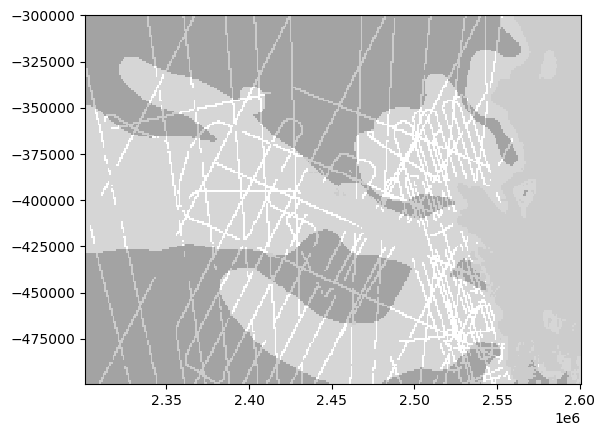

In [9]:
plt.pcolormesh(xx,yy,cond_data_mask,cmap='grey',alpha=0.2)
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.scatter(actual_xy[:,0],actual_xy[:,1],s=5,c=color)
plt.axis('scaled')

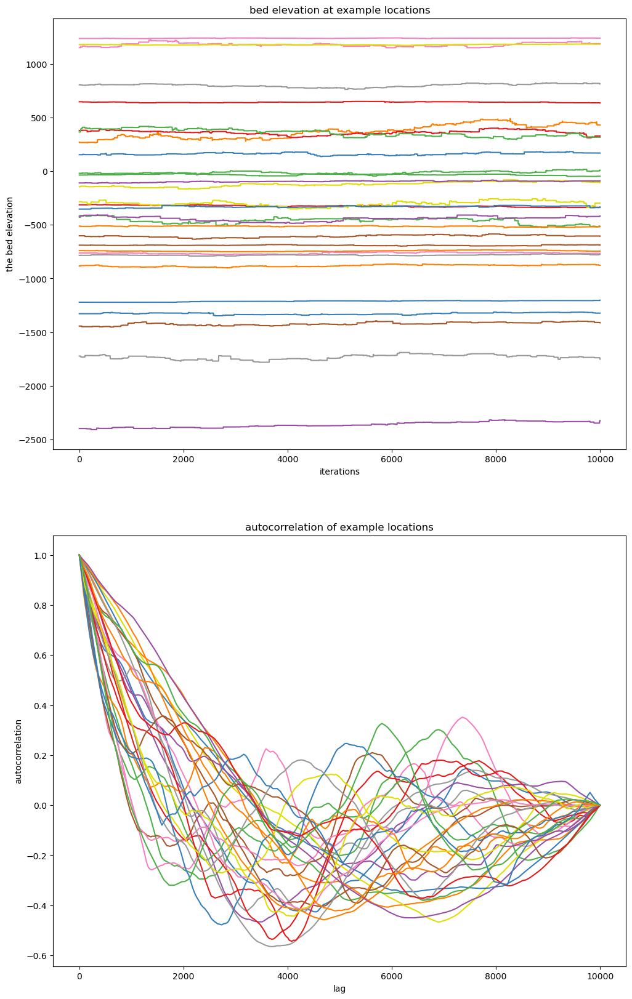

In [10]:
example_values = np.zeros((10000,30))
example_values[:5000,:]=np.loadtxt('./example_values_38_3_41forautocorr.txt')
example_values[5000:,:]=np.loadtxt('./example_values_38_3_42forautocorr.txt')
example_values.shape
fig = geomc.plot_autocorr(example_values.T)

### Method Overview

In [1]:
loaded_bed_pp = np.zeros((4000, rows, cols))
loaded_bed_temp = np.loadtxt("./55_prep/bed_cache_55_prep_13foravg.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
loaded_bed_pp[:1000] = loaded_bed_temp
loaded_bed_temp = np.loadtxt("./55_prep/bed_cache_55_prep_14foravg.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
loaded_bed_pp[1000:2000] = loaded_bed_temp
loaded_bed_temp = np.loadtxt("./55_prep/bed_cache_55_prep_15foravg.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
loaded_bed_pp[2000:3000] = loaded_bed_temp
loaded_bed_temp = np.loadtxt("./55_prep/bed_cache_55_prep_16foravg.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
loaded_bed_pp[3000:4000] = loaded_bed_temp

NameError: name 'np' is not defined

In [32]:
topo_preprocess_mean = np.mean(loaded_bed_temp[:],axis=0)

In [33]:
topo_preprocess_one = loaded_bed_temp[-1,:,:]

In [13]:
loaded_bed_temp = np.loadtxt("./57_sgs/bed_cache_57_sgs_0_20.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
sgs_bed = loaded_bed_temp[-1,:,:]

In [14]:
loaded_bed_temp = np.loadtxt("./57_crf/bed_cache_57_crf_40.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
crf_bed = loaded_bed_temp[-1,:,:]

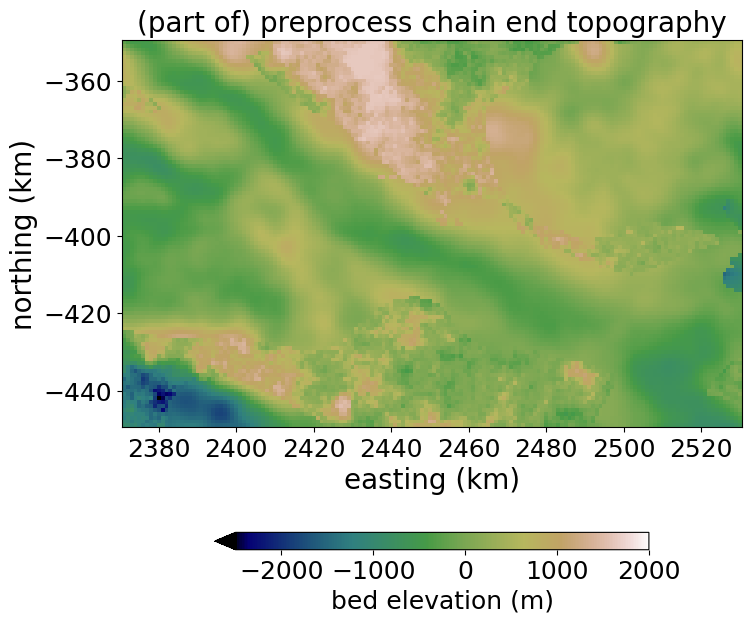

In [41]:
fig,ax = plt.subplots(figsize=(8,8))

f_radar = ax.pcolormesh(xx[50:150,70:230]/1000, yy[50:150,70:230]/1000, topo_preprocess_one[50:150,70:230],vmax=2000,vmin=-2500,cmap='gist_earth')
cbar = plt.colorbar(f_radar,ax=ax,aspect=25,orientation='horizontal',
             location='bottom',pad=0.12,shrink=0.7,extend='min')
cbar.set_label(label='bed elevation (m)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
ax.yaxis.offsetText.set_fontsize(18)
ax.xaxis.offsetText.set_fontsize(18)
ax.tick_params(axis='both', labelsize=18)
ax.set_title('(part of) preprocess chain end topography',fontsize=20)
ax.set_xlabel('easting (km)',fontsize=20)
ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_preprocess_one.png', bbox_inches='tight',dpi=300)

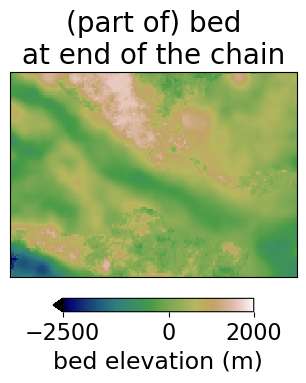

In [104]:
fig,ax = plt.subplots(figsize=(3.7,3.7))

f_radar = ax.pcolormesh(xx[50:150,80:220]/1000, yy[50:150,80:220]/1000, topo_preprocess_one[50:150,80:220],vmax=2000,vmin=-2500,cmap='gist_earth')
cbar = plt.colorbar(f_radar,ax=ax,aspect=15,orientation='horizontal',
             location='bottom',pad=0.02,shrink=0.7,extend='min',ticks=[-2500,0,2000])
cbar.set_label(label='bed elevation (m)', size=17)
cbar.ax.tick_params(axis='both',labelsize=16)
#ax.yaxis.offsetText.set_fontsize(18)
#ax.xaxis.offsetText.set_fontsize(18)
#ax.tick_params(axis='both', labelsize=18)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title('(part of) bed\nat end of the chain',fontsize=20)
#ax.set_xlabel('easting (km)',fontsize=20)
#ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_preprocess_one.png', bbox_inches='tight',dpi=300)

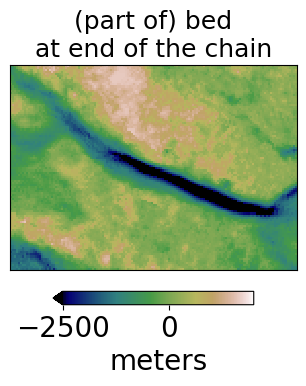

In [15]:
fig,ax = plt.subplots(figsize=(3.7,3.7))

f_radar = ax.pcolormesh(xx[50:150,80:220]/1000, yy[50:150,80:220]/1000, crf_bed[50:150,80:220],vmax=2000,vmin=-2500,cmap='gist_earth')
cbar = plt.colorbar(f_radar,ax=ax,aspect=15,orientation='horizontal',
             location='bottom',pad=0.02,shrink=0.7,extend='min')
cbar.set_label(label='meters', size=20)
cbar.ax.tick_params(axis='both',labelsize=20)
#ax.yaxis.offsetText.set_fontsize(18)
#ax.xaxis.offsetText.set_fontsize(18)
#ax.tick_params(axis='both', labelsize=18)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title('(part of) bed\nat end of the chain',fontsize=18)
#ax.set_xlabel('easting (km)',fontsize=20)
#ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_msc_one.png', bbox_inches='tight',dpi=300)

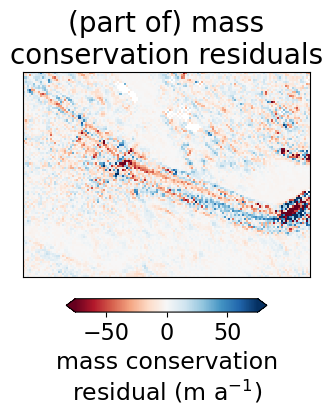

In [36]:
fig,ax = plt.subplots(figsize=(3.7,3.7))
mc_res_ms = geomc.calc_mass_conservation(crf_bed, surf, velx, vely, dhdt, smb)
f_mcres = ax.pcolormesh(xx[50:150,80:220]/1000, yy[50:150,80:220]/1000, mc_res_ms[50:150,80:220], cmap='RdBu',vmax=75,vmin=-75)
cbar = plt.colorbar(f_mcres,ax=ax,aspect=15,orientation='horizontal',
             location='bottom',pad=0.02,shrink=0.7,extend='both')
cbar.set_label(label='mass conservation\nresidual (m a$^{-1}$)', size=17)
cbar.ax.tick_params(axis='both',labelsize=16)
ax.set_xticks([])
ax.set_yticks([])
#ax.yaxis.offsetText.set_fontsize(18)
#ax.xaxis.offsetText.set_fontsize(18)
#ax.tick_params(axis='both', labelsize=18)
ax.set_title('(part of) mass\nconservation residuals',fontsize=20)
#ax.set_xlabel('easting (km)',fontsize=20)
#ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_msc_mcres.png', bbox_inches='tight',dpi=300)

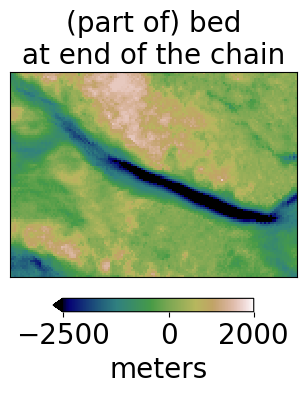

In [16]:
fig,ax = plt.subplots(figsize=(3.7,3.7))

f_radar = ax.pcolormesh(xx[50:150,80:220]/1000, yy[50:150,80:220]/1000, sgs_bed[50:150,80:220],vmax=2000,vmin=-2500,cmap='gist_earth')
cbar = plt.colorbar(f_radar,ax=ax,aspect=15,orientation='horizontal',
             location='bottom',pad=0.02,shrink=0.7,extend='min',ticks=[-2500,0,2000])
cbar.set_label(label='meters', size=20)
cbar.ax.tick_params(axis='both',labelsize=20)
#ax.yaxis.offsetText.set_fontsize(18)
#ax.xaxis.offsetText.set_fontsize(18)
#ax.tick_params(axis='both', labelsize=18)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title('(part of) bed\nat end of the chain',fontsize=20)
#ax.set_xlabel('easting (km)',fontsize=20)
#ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_fsc_one.png', bbox_inches='tight',dpi=300)

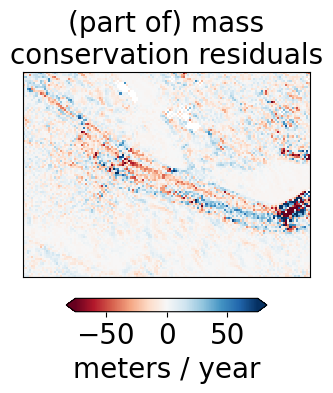

In [162]:
fig,ax = plt.subplots(figsize=(3.7,3.7))
mc_res_ms = geomc.calc_mass_conservation(crf_bed, surf, velx, vely, dhdt, smb)
f_mcres = ax.pcolormesh(xx[50:150,80:220]/1000, yy[50:150,80:220]/1000, mc_res_ms[50:150,80:220], cmap='RdBu',vmax=75,vmin=-75)
cbar = plt.colorbar(f_mcres,ax=ax,aspect=15,orientation='horizontal',
             location='bottom',pad=0.02,shrink=0.7,extend='both')
cbar.set_label(label='meters / year', size=20)
cbar.ax.tick_params(axis='both',labelsize=20)
ax.set_xticks([])
ax.set_yticks([])
#ax.yaxis.offsetText.set_fontsize(18)
#ax.xaxis.offsetText.set_fontsize(18)
#ax.tick_params(axis='both', labelsize=18)
ax.set_title('(part of) mass\nconservation residuals',fontsize=20)
#ax.set_xlabel('easting (km)',fontsize=20)
#ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_msc_mcres.png', bbox_inches='tight',dpi=300)

In [37]:
df_np = pd.read_csv('./Data/compiled_Aurora_noQC_iceshelve_included_3.csv')
df_np = df_np[(df_np['X']>2300000) & (df_np['X']<=2600000) & (df_np['Y']>-500000) & (df_np['Y']<=-300000)].copy()

In [38]:
np.nanstd(topo_preprocess_one - df_np.bed.values.reshape(xx.shape)) * 2.5

465.89957837687575

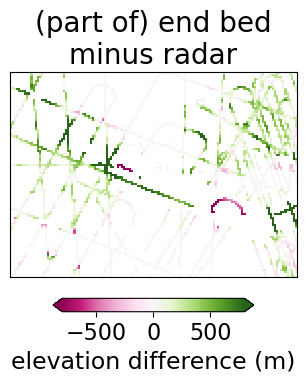

In [40]:
fig,ax = plt.subplots(figsize=(3.7,3.7))
f_mcres = ax.pcolormesh(xx[50:150,80:220]/1000, yy[50:150,80:220]/1000,(topo_preprocess_one - df_up.bed.values.reshape(xx.shape))[50:150,80:220], cmap='PiYG',vmax=800,vmin=-800)
cbar = plt.colorbar(f_mcres,ax=ax,aspect=15,orientation='horizontal',
             location='bottom',pad=0.02,shrink=0.7,extend='both')
cbar.set_label('elevation difference (m)', size=17)
cbar.ax.tick_params(axis='both',labelsize=16)
ax.set_xticks([])
ax.set_yticks([])
#ax.yaxis.offsetText.set_fontsize(18)
#ax.xaxis.offsetText.set_fontsize(18)
#ax.tick_params(axis='both', labelsize=18)
ax.set_title('(part of) end bed\nminus radar',fontsize=20)
#ax.set_xlabel('easting (km)',fontsize=20)
#ax.set_ylabel('northing (km)',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_preprocess_diff.png', bbox_inches='tight',dpi=300)

In [44]:
loaded_bed_temp = np.loadtxt("./51_crf/bed_cache_51_crf_42forsample.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)

In [46]:
topo_wrf_one = loaded_bed_temp[-1,:,:]

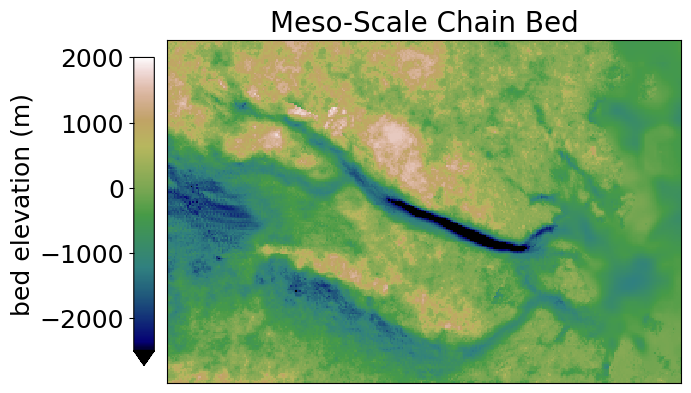

In [48]:
fig,ax = plt.subplots(figsize=(8,8))

f_radar = ax.pcolormesh(xx/1000, yy/1000, topo_wrf_one,vmax=2000,vmin=-2500,cmap='gist_earth')
cbar = plt.colorbar(f_radar,ax=ax,aspect=15,orientation='vertical',
             location='left',pad=0.02,shrink=0.5,extend='min')
cbar.set_label(label='bed elevation (m)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title('Meso-Scale Chain Bed',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_ms_bed.png', bbox_inches='tight',dpi=300)

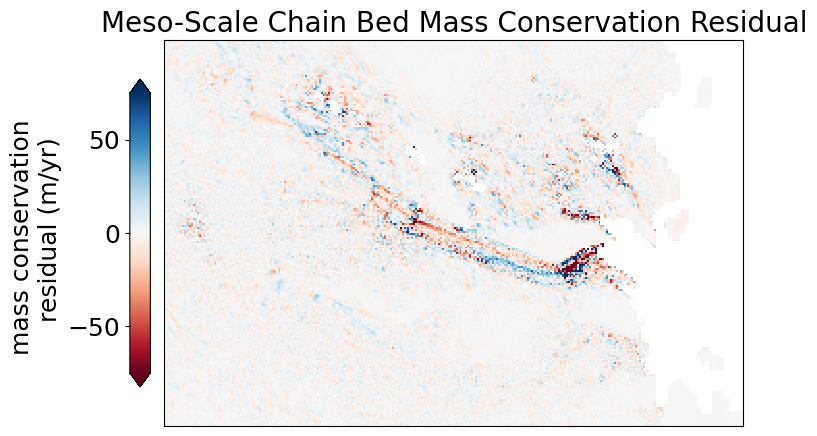

In [50]:
fig,ax = plt.subplots(figsize=(9,8))
mc_res_ms = geomc.calc_mass_conservation(topo_wrf_one, surf, velx, vely, dhdt, smb)
f_mcres = ax.pcolormesh(xx/1000, yy/1000, mc_res_ms, cmap='RdBu',vmax=75,vmin=-75)
cbar = plt.colorbar(f_mcres,ax=ax,aspect=15,orientation='vertical',
             location='left',pad=0.02,shrink=0.5,extend='both')
cbar.set_label(label='mass conservation \n residual (m/yr)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title('Meso-Scale Chain Bed Mass Conservation Residual',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_ms_mcres.png', bbox_inches='tight',dpi=300)

In [52]:
loaded_bed_temp = np.loadtxt("./51_sgs/bed_cache_51_sgs_8_20.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)

In [53]:
topo_sgs_one = loaded_bed_temp[-1,:,:]

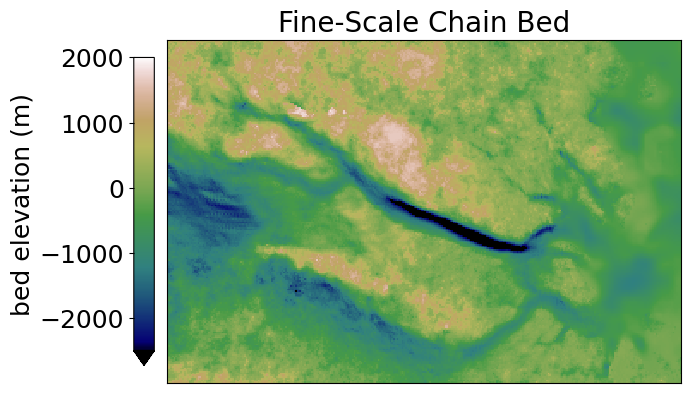

In [54]:
fig,ax = plt.subplots(figsize=(8,8))

f_radar = ax.pcolormesh(xx/1000, yy/1000, topo_sgs_one,vmax=2000,vmin=-2500,cmap='gist_earth')
cbar = plt.colorbar(f_radar,ax=ax,aspect=15,orientation='vertical',
             location='left',pad=0.02,shrink=0.5,extend='min')
cbar.set_label(label='bed elevation (m)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title('Fine-Scale Chain Bed',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_fs_bed.png', bbox_inches='tight',dpi=300)

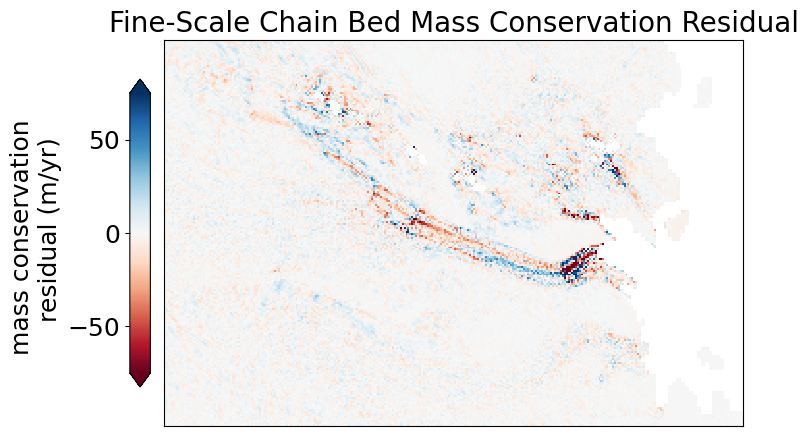

In [55]:
fig,ax = plt.subplots(figsize=(9,8))
mc_res_fs = geomc.calc_mass_conservation(topo_sgs_one, surf, velx, vely, dhdt, smb)
f_mcres = ax.pcolormesh(xx/1000, yy/1000, mc_res_fs, cmap='RdBu',vmax=75,vmin=-75)
cbar = plt.colorbar(f_mcres,ax=ax,aspect=15,orientation='vertical',
             location='left',pad=0.02,shrink=0.5,extend='both')
cbar.set_label(label='mass conservation \n residual (m/yr)', size='18')
cbar.ax.tick_params(axis='both',labelsize=18)
ax.set_xticks([])
ax.set_yticks([])
ax.set_title('Fine-Scale Chain Bed Mass Conservation Residual',fontsize=20)
ax.axis('scaled')

plt.savefig('./figures/topo_fs_mcres.png', bbox_inches='tight',dpi=300)

### plot regular analysis over one chain

In [12]:
n_iter_list_1 =  [5000] * 40
file_postfix_list_1 = ['_56_crf_'+str(i) for i in range(1,41)]
choice_param_list_1 = [1000] * 40

mc_loss_1 = np.zeros(np.sum(n_iter_list_1))
step_1 = np.zeros(np.sum(n_iter_list_1))
blocks_1 = np.zeros((np.sum(n_iter_list_1),4))
for i in range(len(n_iter_list_1)):
    file_postfix = file_postfix_list_1[i]
    mc_loss_1[int(np.sum(n_iter_list_1[:i])):int(np.sum(n_iter_list_1[:i+1]))] = np.loadtxt("./loss_mc_cache"+file_postfix+".txt")
    step_1[int(np.sum(n_iter_list_1[:i])):int(np.sum(n_iter_list_1[:i+1]))] = np.loadtxt("./step_cache"+file_postfix+".txt")
    blocks_1[int(np.sum(n_iter_list_1[:i])):int(np.sum(n_iter_list_1[:i+1]))] = np.loadtxt("./blocks_cache"+file_postfix+".txt")
    
# load file
nsil = np.floor(np.divide(n_iter_list_1, choice_param_list_1)).astype(int)
loaded_bed_1 = np.zeros((np.sum(nsil), rows, cols))
resampled_times_1 = np.zeros((len(n_iter_list_1), rows, cols))
for i in range(len(nsil)):
    file_postfix = file_postfix_list_1[i]
    loaded_bed_temp = np.loadtxt("./bed_cache"+file_postfix+".txt")
    loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
    loaded_bed_1[int(np.sum(nsil[:i])):int(np.sum(nsil[:i+1])),:,:] = loaded_bed_temp
    resampled_times_1[i,:,:] = np.loadtxt("./resampled_times"+file_postfix+".txt").reshape(rows, cols)
    
mse_loss_1 = np.zeros(np.sum(nsil))
for i in range(loaded_bed_1.shape[0]):
    mc_res_now = geomc.calc_mass_conservation(loaded_bed_1[i], surf, velx, vely, dhdt, smb)
    mse_loss_1[i] = geomc.loss_mc(mc_res_now, 'sumabs', inside_high_vel_region = False)

In [13]:
loss_mc_bm = geomc.loss_mc(mc_res_bm, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)

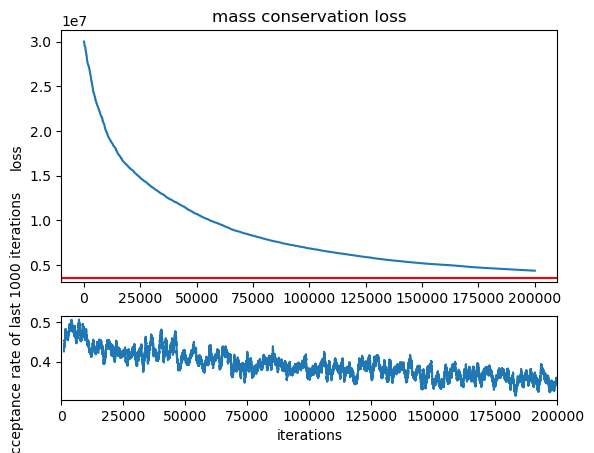

In [14]:
fig = geomc.plot_loss(np.array([mc_loss_1]), np.array([step_1]), loss_mc_bm, has_dataloss = False)

In [54]:
n_iter_list_1 =  [20000] * 2
file_postfix_list_1 = ['_56_crf_'+str(i)+'forsample' for i in range(42,44)]

mc_loss_1 = np.zeros(np.sum(n_iter_list_1))
for i in range(len(n_iter_list_1)):
    file_postfix = file_postfix_list_1[i]
    mc_loss_1[int(np.sum(n_iter_list_1[:i])):int(np.sum(n_iter_list_1[:i+1]))] = np.loadtxt("./56_crf/loss_mc_cache"+file_postfix+".txt")

In [55]:
#load all sampled bed
n_iter_list =  [20000] * 2
sigma_mc_list = [3] * 2
file_postfix_list = ['_56_crf_'+str(i)+'forsample' for i in range(42,44)]
choice_param_list = [4000] * 2

nsil = np.floor(np.divide(n_iter_list, choice_param_list)).astype(int)
loaded_bed_sample = np.zeros((np.sum(nsil), rows, cols))
for i in range(len(nsil)):
    file_postfix = file_postfix_list[i]
    loaded_bed_temp = np.loadtxt("./56_crf/bed_cache"+file_postfix+".txt")
    loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
    loaded_bed_sample[int(np.sum(nsil[:i])):int(np.sum(nsil[:i+1])),:,:] = loaded_bed_temp

In [56]:
loaded_bed_res = np.zeros(loaded_bed_sample.shape[0])
for i in range(loaded_bed_sample.shape[0]):
    bed_res = geomc.calc_mass_conservation(loaded_bed_sample[i], surf, velx, vely, dhdt, smb)
    bed_res = geomc.loss_mc(bed_res, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)
    loaded_bed_res[i] = bed_res

[]

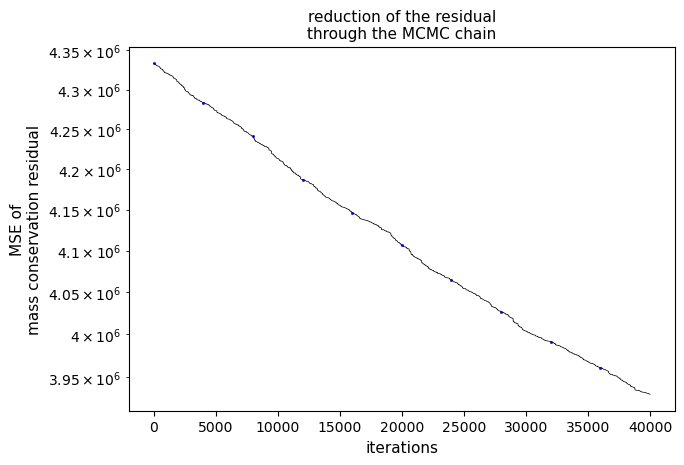

In [59]:
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 120*mm))

#begin_sampling = 5000 * 40

plt.yscale('log')
# for i in range(crf_mc_loss_all.shape[0]):
#     plt.plot(crf_mc_loss_all[i],color='black',label='CRF',lw=0.5)
#     for j in range(sgs_mc_loss_all.shape[1]):
#         plt.plot(range(5000*40+4000+j*4000,5000*40+4000+j*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[i,j,:],lw=0.5,color='blue')
#         plt.scatter(5000*40+4000+j*4000+sgs_mc_loss_all.shape[2],sgs_mc_loss_all[i,j,-1],color='blue',s=1.5,alpha=0.8)
        
plt.plot(mc_loss_1,color='black',label='CRF',lw=0.5)
for i in range(0,10):
    plt.scatter(i*4000,loaded_bed_res[i],color='blue',s=1.5,alpha=0.8)

#plt.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='bedmachine mass conservation loss',alpha=0.7,lw=0.5)
plt.ylabel('MSE of\nmass conservation residual',size=11)
plt.xlabel('iterations',size=11)
plt.title('reduction of the residual\nthrough the MCMC chain',size=11)
#plt.legend()
plt.plot()
#plt.savefig('residualReduction_tozoom.png',bbox_inches='tight',dpi=600)

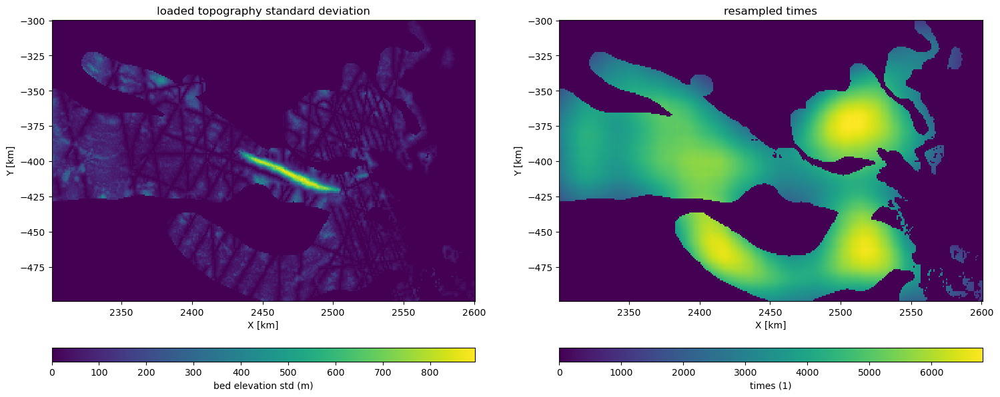

In [15]:
fig = geomc.plot_sample(loaded_bed_1, resampled_times_1, xx, yy)

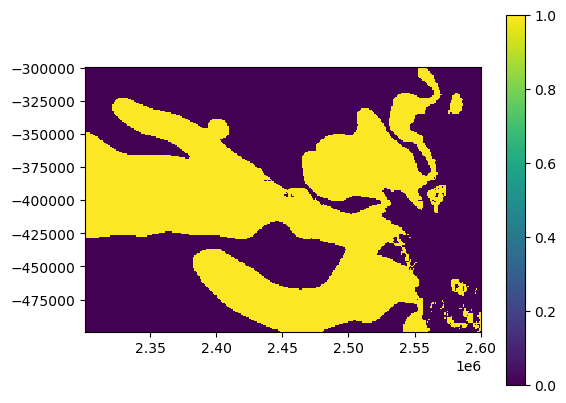

In [16]:
plt.pcolormesh(xx,yy,np.sum(resampled_times_1,axis=0),vmax=1)
plt.axis('scaled')
plt.colorbar()

(2300500.0, 2600500.0, -499500.0, -299500.0)

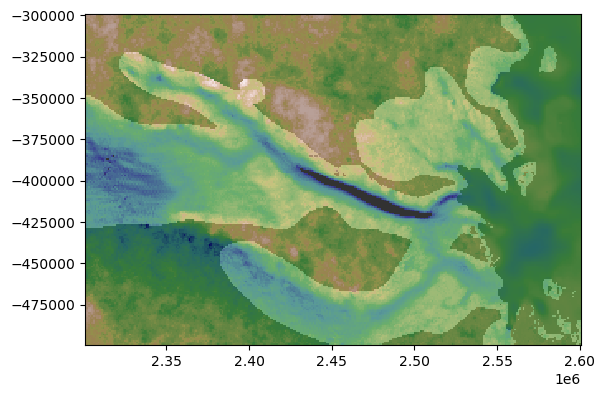

In [17]:
plt.pcolormesh(xx,yy,loaded_bed_1[-1],vmax=2000,vmin=-2500,cmap='gist_earth')
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

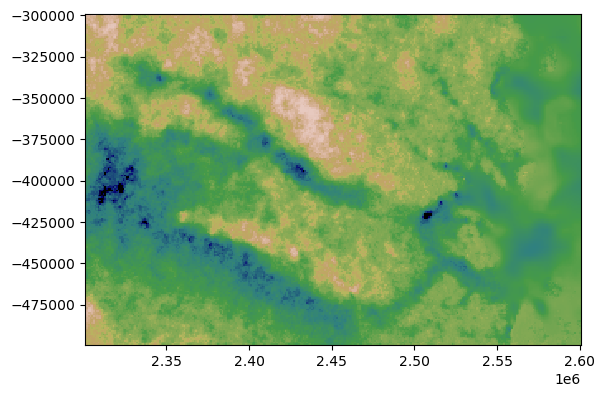

In [20]:
plt.pcolormesh(xx,yy,loaded_bed_1[0],vmax=2000,vmin=-2500,cmap='gist_earth')
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

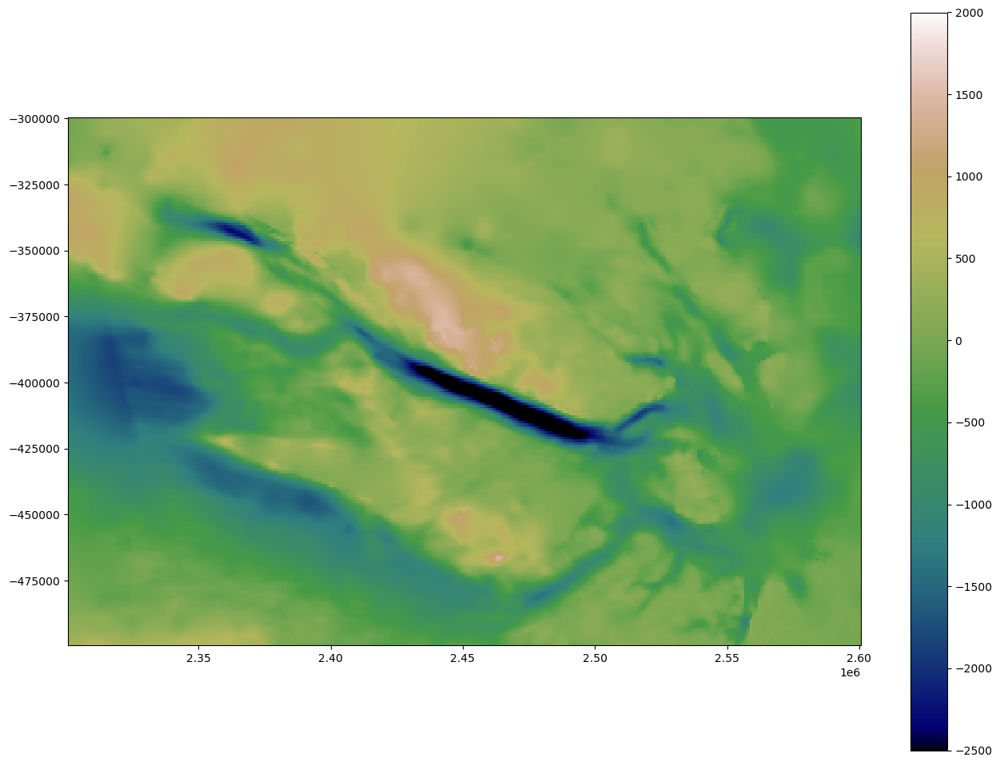

In [19]:
plt.figure(figsize=(16,12))
plt.pcolormesh(xx,yy,df_bm.bed.values.reshape(xx.shape),vmax=2000,vmin=-2500,cmap='gist_earth')
plt.colorbar()
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

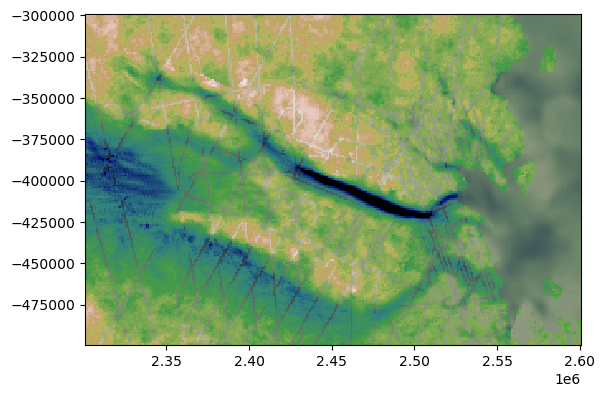

In [21]:
plt.pcolormesh(xx,yy,loaded_bed_1[-1],vmax=2000,vmin=-2500,cmap='gist_earth')
plt.pcolormesh(xx,yy,df.bed.values.reshape(xx.shape),vmax=2000,vmin=-2500,cmap='grey',alpha=0.7)
plt.axis('scaled')

In [30]:
loss_data_bm = geomc.loss_data(df_bm.bed.values.reshape(xx.shape), cond_bed, cond_data_mask, 
                              'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)
loss_data_final = geomc.loss_data(loaded_bed_1[-1], cond_bed, cond_data_mask, 
                              'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)
loss_data_bm, loss_data_final

(166603609.1695629, 2252.5935230199248)

In [31]:
mc_res = geomc.calc_mass_conservation(loaded_bed_1[-1], surf, velx, vely, dhdt, smb)
loss_mc_chain_in = geomc.loss_mc(mc_res, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)
loss_mc_chain_all = geomc.loss_mc(mc_res, 'sumsq', inside_high_vel_region = False)
loss_mc_bm_in = geomc.loss_mc(mc_res_bm, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)
loss_mc_bm_all = geomc.loss_mc(mc_res_bm, 'sumsq', inside_high_vel_region = False)

print('for the mc region sumsq mc res loss, the end topo is', loss_mc_chain_in,'the bm is', loss_mc_bm_in)
print('for the global sumsq mc res loss, the end topo is', loss_mc_chain_all,'the bm is', loss_mc_bm_all)

for the mc region sumsq mc res loss, the end topo is 4391227.2325071385 the bm is 3669701.4794974984
for the global sumsq mc res loss, the end topo is 5076589.513718731 the bm is 4293710.7919969605


(2300500.0, 2600500.0, -499500.0, -299500.0)

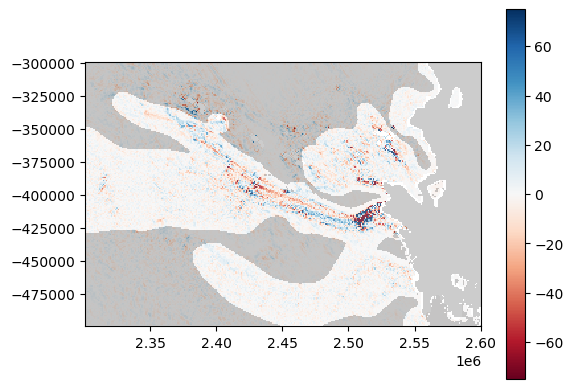

In [32]:
plt.pcolormesh(xx,yy,mc_res,vmax=75,vmin=-75,cmap='RdBu')
plt.colorbar()
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

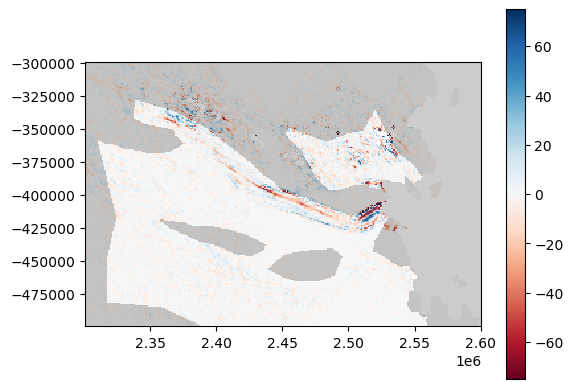

In [33]:
plt.pcolormesh(xx,yy,mc_res_bm,vmax=75,vmin=-75,cmap='RdBu')
plt.colorbar()
plt.pcolormesh(xx,yy,df_bm['source'].values.reshape(xx.shape)==2,cmap='grey',alpha=0.2)
plt.axis('scaled')

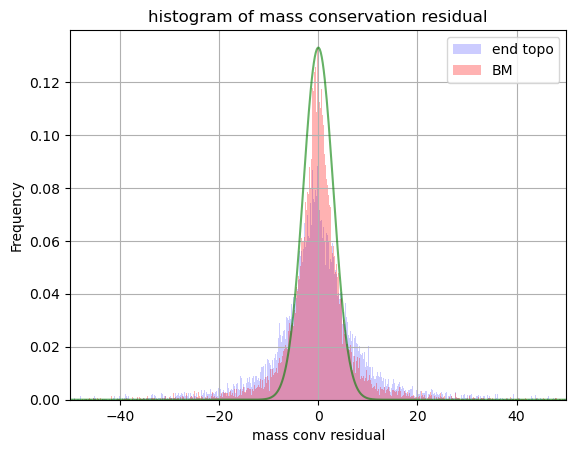

In [34]:

sigma3 = 3
sigma4 = 3.8
xl3=np.linspace(-100, 100, num=1000)
gaussian_model=1/(sigma3*np.sqrt(2*np.pi))*np.exp(-0.5*np.square(xl3/sigma3))
laplacian_model=1/(2*sigma4)*np.exp(-1*np.abs(xl3)/sigma4)

bm_mask = df_bm['source'].values.reshape(xx.shape) == 2

mc_res_bm_sr2 = mc_res_bm[bm_mask==1]
mc_res_bm_sr2_f = mc_res_bm_sr2.flatten()
mc_res_bm_sr2_f = mc_res_bm_sr2_f[~np.isnan(mc_res_bm_sr2_f)]
mc_res_sr2 = mc_res[mc_region_mask==1]
mc_res_sr2_f = mc_res_sr2.flatten()
mc_res_sr2_f = mc_res_sr2_f[~np.isnan(mc_res_sr2_f)]
bins=np.histogram(np.hstack((mc_res_sr2_f,mc_res_bm_sr2_f)), bins=5000)[1] #get the bin edges

plt.hist(mc_res_sr2_f, bins=bins, facecolor='blue', alpha=0.2,density=True,label='end topo')
plt.hist(mc_res_bm_sr2_f, bins=bins, facecolor='red', alpha=0.3,density=True,label='BM')
plt.plot(xl3, gaussian_model, color='Green',alpha=0.6)
#plt.plot(xl3, laplacian_model, color='Orange',alpha=0.6)
plt.xlim([-50,50]);
#plt.ylim([0,0.04])
plt.legend()
plt.xlabel('mass conv residual');
plt.ylabel('Frequency');
plt.title('histogram of mass conservation residual')
plt.grid(True)
plt.show()

(2300500.0, 2600500.0, -499500.0, -299500.0)

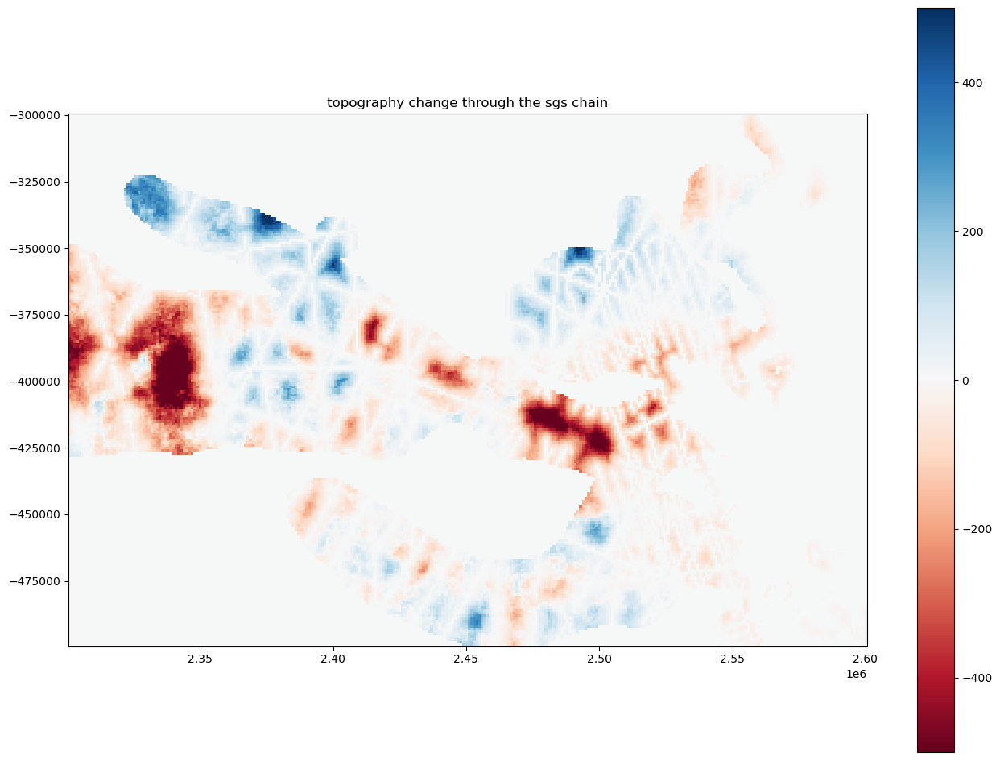

In [45]:
plt.figure(figsize=(16,12))
plt.pcolormesh(xx,yy,loaded_bed_1[4]-loaded_bed_1[0],cmap='RdBu',vmax=500,vmin=-500)
plt.title('topography change through the sgs chain')
plt.colorbar()
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

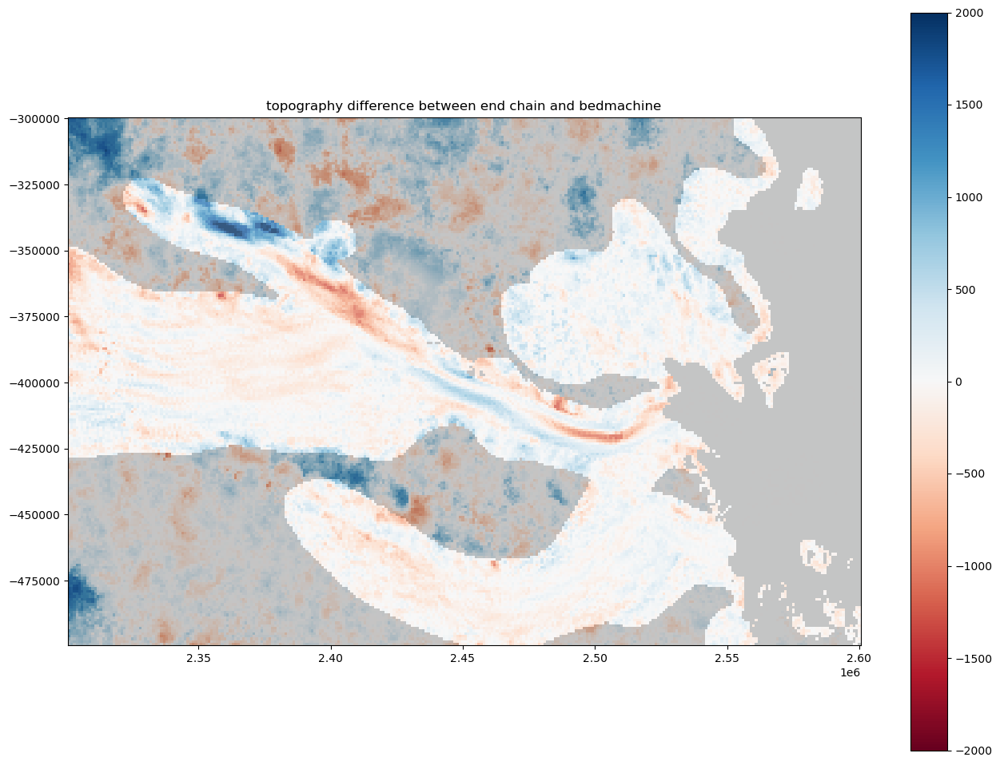

In [46]:
plt.figure(figsize=(16,12))
plt.title('topography difference between end chain and bedmachine')
plt.pcolormesh(xx,yy,loaded_bed_1[-1]-df_bm.bed.values.reshape(xx.shape),cmap='RdBu',vmax=2000,vmin=-2000)
plt.colorbar()
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

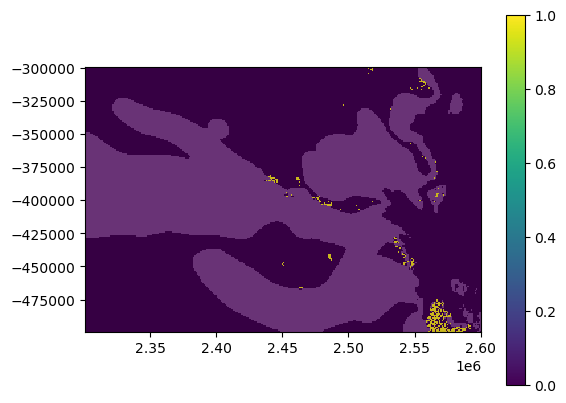

In [47]:
plt.pcolormesh(xx,yy,(surf-loaded_bed_1[0,:,:])<=0,cmap='viridis')
plt.colorbar()
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

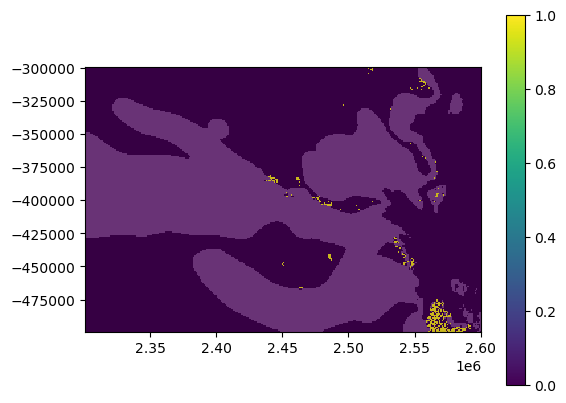

In [48]:
plt.pcolormesh(xx,yy,(surf-loaded_bed_1[-1,:,:])<=0,cmap='viridis')
plt.colorbar()
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.axis('scaled')

### Visualization for multiple chains

In [11]:
# for i in range(40):
#     os.rename('./38_crf/loss_mc_cache_38_3_'+str(i+1)+'.txt','./38_crf/loss_mc_cache_38_crf_'+str(i+1)+'.txt')

In [14]:
#load multiple crf chains
chain_info_all = []
file_index_all = ['56_sgs','57_sgs','58_sgs','59_sgs']
folder_name_all = ['56_sgs','57_sgs','58_sgs','59_sgs']
num_sgs_chain = 10
num_sgs_files = 20
num_crf_chain = 4

for k in range(num_crf_chain):
    file_index = file_index_all[k]
    chain_info = []
    
    for j in range(num_sgs_chain):
        n_iter_list =  [10000] * num_sgs_files
        file_postfix_list = ['_'+file_index+'_'+str(j)+'_'+str(i) for i in range(1,num_sgs_files+1)]
        choice_param_list = [500] * num_sgs_files
        nsil = np.floor(np.divide(n_iter_list, choice_param_list)).astype(int)

        chain_info.append([n_iter_list,file_postfix_list,choice_param_list,nsil])
        
    chain_info_all.append(chain_info)

In [15]:
last_beds_all = np.zeros((num_crf_chain,num_sgs_chain,rows,cols))
first_beds_all = np.zeros((num_crf_chain,num_sgs_chain,rows,cols))

for k in range(num_crf_chain):
    chain_info = chain_info_all[k]
    folder_name = folder_name_all[k]
    
    for j in range(len(chain_info)):
        nsil = chain_info[j][3]
        file_postfix_list = chain_info[j][1]

        file_postfix_last = file_postfix_list[-1]
        loaded_bed_temp = np.loadtxt("./"+folder_name+"/bed_cache"+file_postfix_last+".txt")
        loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int),rows,cols)
        last_beds_all[k,j,:,:] = loaded_bed_temp[-1]
        
        file_postfix_first = file_postfix_list[0]
        loaded_bed_temp = np.loadtxt("./"+folder_name+"/bed_cache"+file_postfix_first+".txt")
        loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int),rows,cols)
        first_beds_all[k,j,:,:] = loaded_bed_temp[0]

In [16]:
resampled_times_all = np.zeros((num_crf_chain,num_sgs_chain,rows,cols))
for i in range(len(chain_info_all)):
    chain_info_temp = chain_info_all[i]
    folder_name = folder_name_all[i]
    
    for j in range(len(chain_info_temp)):
        n_iter_list =  chain_info_temp[j][0]
        file_postfix_list = chain_info_temp[j][1]
        choice_param_list = chain_info_temp[j][2]
        nsil = chain_info_temp[j][3]
    
        resampled_times_temp = np.zeros((rows,cols))
    
        for k in range(len(n_iter_list)):
            file_postfix = file_postfix_list[k]
            resampled_times_temp += np.loadtxt("./"+folder_name+"/resampled_times"+file_postfix+".txt")
        
        resampled_times_all[i,j,:,:] = resampled_times_temp

In [17]:
#load multiple chains
chain_info = []
file_index = '56_sgs'
folder_name = '56_sgs'
num_chains = 10
begin_num = 0
for j in range(num_chains):
    
    
    num_files = 20
    n_iter_list =  [10000] * num_files
    file_postfix_list = ['_'+file_index+'_'+str(j+begin_num)+'_'+str(i) for i in range(1,num_files+1)]
    choice_param_list = [500] * num_files
    nsil = np.floor(np.divide(n_iter_list, choice_param_list)).astype(int)
    
    chain_info.append([n_iter_list,file_postfix_list,choice_param_list,nsil])

In [18]:
mc_loss = np.zeros((num_chains,np.sum(n_iter_list)))
step = np.zeros((num_chains,np.sum(n_iter_list)))
blocks = np.zeros((num_chains,np.sum(n_iter_list),4))
# loaded_bed = np.zeros((num_chains,np.sum(nsil),rows,cols))
resampled_times = np.zeros((num_chains,len(n_iter_list),rows,cols))
    
for j in range(len(chain_info)):
    n_iter_list =  chain_info[j][0]
    file_postfix_list = chain_info[j][1]
    choice_param_list = chain_info[j][2]
    nsil = chain_info[j][3]
    
    for i in range(len(n_iter_list)):
        file_postfix = file_postfix_list[i]
        mc_loss[j,int(np.sum(n_iter_list[:i])):int(np.sum(n_iter_list[:i+1]))] = np.loadtxt("./"+folder_name+"/loss_mc_cache"+file_postfix+".txt")
        #step[j,int(np.sum(n_iter_list[:i])):int(np.sum(n_iter_list[:i+1]))] = np.loadtxt("./"+folder_name+"/step_cache"+file_postfix+".txt")
        #blocks[j,int(np.sum(n_iter_list[:i])):int(np.sum(n_iter_list[:i+1]))] = np.loadtxt("./"+folder_name+"/blocks_cache"+file_postfix+".txt")
        #resampled_times[j,i,:,:] = np.loadtxt("./"+folder_name+"/resampled_times"+file_postfix+".txt")
        #print(j,i)
        
    # for i in range(len(nsil)):
    #     file_postfix = file_postfix_list[i]
    #     loaded_bed_temp = np.loadtxt("./bed_cache"+file_postfix+".txt")
    #     loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int),rows,cols)
    #     loaded_bed[j,int(np.sum(nsil[:i])):int(np.sum(nsil[:i+1])),:,:] = loaded_bed_temp
    #     resampled_times[j,i,:,:] = np.loadtxt("./resampled_times"+file_postfix+".txt").reshape(rows, cols)

In [19]:
for j in range(len(chain_info)):
    n_iter_list =  chain_info[j][0]
    file_postfix_list = chain_info[j][1]
    choice_param_list = chain_info[j][2]
    nsil = chain_info[j][3]
    
    for i in range(len(n_iter_list)):
        file_postfix = file_postfix_list[i]
        resampled_times[j,i,:,:] = np.loadtxt("./"+folder_name+"/resampled_times"+file_postfix+".txt")

In [20]:
# num_chains = 10
# last_beds = np.zeros((num_chains,rows,cols))
# first_beds = np.zeros((num_chains,rows,cols))
# for j in range(len(chain_info)):
#     nsil = chain_info[j][3]
#     file_postfix_list = chain_info[j][1]
    
#     file_postfix_first = file_postfix_list[0]
#     loaded_bed_temp = np.loadtxt("./"+folder_name+"/bed_cache"+file_postfix_first+".txt")
#     loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int),rows,cols)
#     first_beds[j,:,:] = loaded_bed_temp[0]
    
#     file_postfix_last = file_postfix_list[-1]
#     loaded_bed_temp = np.loadtxt("./"+folder_name+"/bed_cache"+file_postfix_last+".txt")
#     loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int),rows,cols)
#     last_beds[j,:,:] = loaded_bed_temp[-1]

In [21]:
# last_beds = np.zeros((1,rows,cols))
# loaded_bed_temp = np.loadtxt("./bed_cache_39_sgs_0_20fortest.txt")
# loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int),rows,cols)
# last_beds[0,:,:] = loaded_bed_temp[-1]

In [22]:
# folder_name_crf = "51_crf"
# file_index_crf = '51_crf'
# n_iter_list_crf = [5000] * 40
# n_iter_list_crf.extend([4000]*1)
# n_iter_list_crf.extend([20000]*2)
# file_postfix_list_crf = ['_'+file_index_crf+'_'+str(i) for i in range(1,41)]
# file_postfix_list_crf.extend(['_'+file_index_crf+'_41'+'foravg'])
# file_postfix_list_crf.extend(['_'+file_index_crf+'_'+str(i)+'forsample' for i in range(42,44)])

# mc_loss_crf = np.zeros(np.sum(n_iter_list_crf))

# for i in range(len(n_iter_list_crf)):
#     file_postfix = file_postfix_list_crf[i]
#     mc_loss_crf[int(np.sum(n_iter_list_crf[:i])):int(np.sum(n_iter_list_crf[:i+1]))] = np.loadtxt("./"+folder_name_crf+"/loss_mc_cache"+file_postfix+".txt")

In [20]:
crf_mc_loss_all = np.zeros((num_crf_chain, 200000+4000+40000))
sgs_mc_loss_all = np.zeros((num_crf_chain, num_sgs_chain, 200000))
file_index_all = ['56_crf','57_crf','58_crf','59_crf']
folder_name_all = ['56_crf','57_crf','58_crf','59_crf']
folder_name_sgs_all = ['56_sgs','57_sgs','58_sgs','59_sgs']

for i in range(len(chain_info_all)):
    folder_name_crf = folder_name_all[i]
    file_index_crf = file_index_all[i]
    n_iter_list_crf = [5000] * 40
    n_iter_list_crf.extend([4000]*1)
    n_iter_list_crf.extend([20000]*2)
    file_postfix_list_crf = ['_'+file_index_crf+'_'+str(i) for i in range(1,41)]
    file_postfix_list_crf.extend(['_'+file_index_crf+'_41'+'foravg'])
    file_postfix_list_crf.extend(['_'+file_index_crf+'_'+str(i)+'forsample' for i in range(42,44)])

    for j in range(len(n_iter_list_crf)):
        file_postfix = file_postfix_list_crf[j]
        crf_mc_loss_all[i, int(np.sum(n_iter_list_crf[:j])):int(np.sum(n_iter_list_crf[:j+1]))] = np.loadtxt("./"+folder_name_crf+"/loss_mc_cache"+file_postfix+".txt")
        
    for j in range(num_sgs_chain):
        folder_name_sgs = folder_name_sgs_all[i]
        file_postfix = chain_info_all[i][j][1]
        n_iter_list_sgs = chain_info_all[i][j][0]
        for k in range(len(file_postfix)):
            sgs_mc_loss_all[i,j,int(np.sum(n_iter_list_sgs[:k])):int(np.sum(n_iter_list_sgs[:k+1]))] = np.loadtxt("./"+folder_name_sgs+"/loss_mc_cache"+file_postfix[k]+".txt")

In [21]:
mc_loss_bm = geomc.loss_mc(mc_res_bm, 'sumsq', inside_high_vel_region = True, high_vel_mask = mc_region_mask)

In [22]:
mc_loss_bm

3669701.4794974984

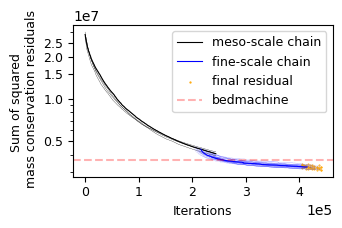

In [23]:
mm = 1/25.4
fig = plt.figure(figsize=(85*mm, 50*mm))
axes = plt.axes()

begin_sampling = 5000 * 40

for i in range(crf_mc_loss_all.shape[0]):
    axes.plot(crf_mc_loss_all[i],color='black',lw=0.2)
    for j in range(sgs_mc_loss_all.shape[1]):
        axes.plot(range(5000*40+4000+j*4000,5000*40+4000+j*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[i,j,:],lw=0.05,color='blue')
        axes.scatter(5000*40+4000+j*4000+sgs_mc_loss_all.shape[2],sgs_mc_loss_all[i,j,-1],color='orange',s=0.8,marker='.',alpha=1,zorder=2)
        
axes.plot(crf_mc_loss_all[3],color='black',label='meso-scale chain',lw=0.8)
axes.plot(range(5000*40+4000+3*4000,5000*40+4000+3*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[3,3,:],lw=0.8,color='blue',label='fine-scale chain')
axes.scatter(5000*40+4000+3*4000+sgs_mc_loss_all.shape[2],sgs_mc_loss_all[3,3,-1],color='orange',s=1.5,marker='.',alpha=1,zorder=2,label='final residual')

axes.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='bedmachine',alpha=0.3)

axes.set_yscale('log')
axes.set_yticks([5*10**6,10**7,1.5*10**7,2.0*10**7,2.5*10**7])
axes.yaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
axes.yaxis.set_tick_params(labelsize=9)
axes.set_ylabel('Sum of squared \n mass conservation residuals',size=9)

#axes.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
axes.ticklabel_format(axis='x', style='sci', scilimits=(0,0), useOffset=False, useMathText=False)
axes.xaxis.set_tick_params(labelsize=9)
axes.set_xlabel('Iterations',size=9)

#plt.ylabel('MSE of\nmass conservation residual',size=11)
#plt.xlabel('iterations',size=11)
#axes.set_title('reduction of the residual\nthrough the MCMC chain',size=10)
axes.legend(fontsize=9,loc='upper right')

plt.savefig('residualReduction.png',bbox_inches='tight',dpi=600)

In [70]:
crf_mc_loss_all[0,40*5000+4000]

4333178.986818447

In [71]:
sgs_mc_loss_all[0,0,0]

4333178.986818448

In [72]:
sgs_mc_loss_all.shape

(4, 10, 200000)

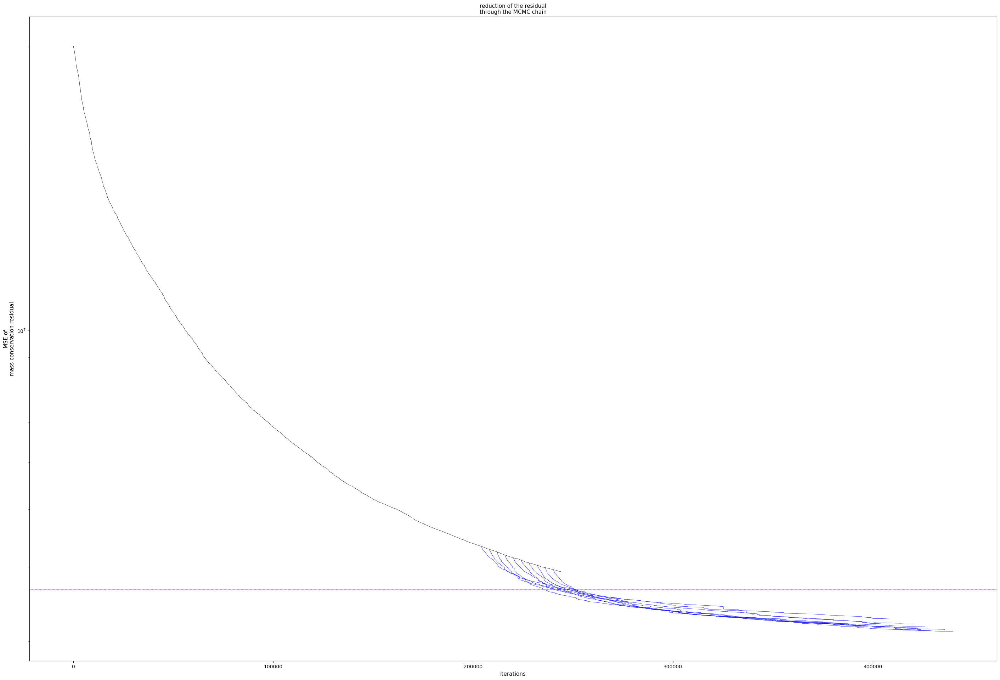

In [73]:
mm = 1/25.4
fig = plt.figure(figsize=(179*5*mm, 120*5*mm))

begin_sampling = 5000 * 40

plt.yscale('log')
plt.plot(crf_mc_loss_all[0],color='black',label='CRF',lw=0.5)
for j in range(sgs_mc_loss_all.shape[1]):
    plt.plot(range(5000*40+4000+j*4000,5000*40+4000+j*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[0,j,:],lw=0.5,color='blue')
# for j in range(5,10,1):
#     plt.plot(range(5000*40+24000+(j-5)*5000,5000*40+24000+(j-5)*5000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[0,j,:],lw=0.5,color='blue')
#     #plt.scatter(5000*40+4000+j*4000+sgs_mc_loss_all.shape[2],sgs_mc_loss_all[0,j,-1],color='blue',s=1.5,alpha=0.8)
# for i in range(crf_mc_loss_all.shape[0]):
#     axes.plot(crf_mc_loss_all[i],color='black',lw=0.2)
#     for j in range(sgs_mc_loss_all.shape[1]):
#         axes.plot(range(5000*40+4000+j*4000,5000*40+4000+j*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[i,j,:],lw=0.05,color='blue')
#         axes.scatter(5000*40+4000+j*4000+sgs_mc_loss_all.shape[2],sgs_mc_loss_all[i,j,-1],color='orange',s=0.8,marker='.',alpha=1,zorder=2)

plt.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='bedmachine mass conservation loss',alpha=0.7,lw=0.5)
plt.ylabel('MSE of\nmass conservation residual',size=11)
plt.xlabel('iterations',size=11)
plt.title('reduction of the residual\nthrough the MCMC chain',size=11)
#plt.legend()

plt.savefig('residualReduction_tozoom.png',bbox_inches='tight',dpi=600)

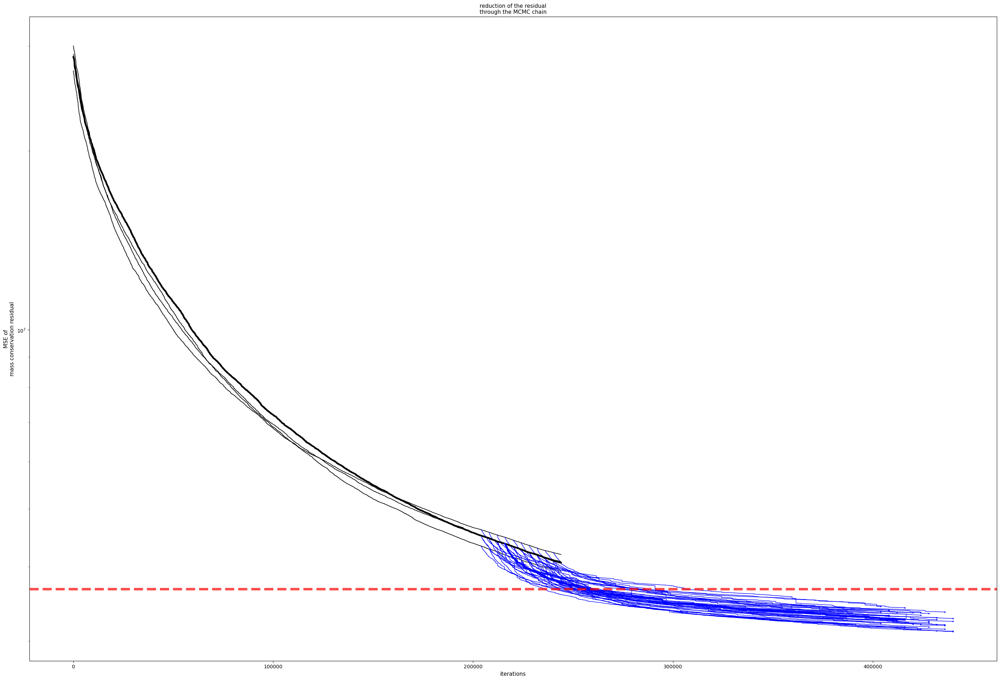

In [87]:
mm = 1/25.4
fig = plt.figure(figsize=(179*5*mm, 120*5*mm))

begin_sampling = 5000 * 40

plt.yscale('log')
for i in range(crf_mc_loss_all.shape[0]):
    plt.plot(crf_mc_loss_all[i],color='black',label='CRF',lw=1.2)
    for j in range(sgs_mc_loss_all.shape[1]):
        plt.plot(range(5000*40+4000+j*4000,5000*40+4000+j*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[i,j,:],lw=1,color='blue')
        plt.scatter(5000*40+4000+j*4000+sgs_mc_loss_all.shape[2],sgs_mc_loss_all[i,j,-1],color='blue',s=3,alpha=1)
        
plt.plot(crf_mc_loss_all[3],color='black',label='CRF',lw=3.2)
plt.plot(range(5000*40+4000+3*4000,5000*40+4000+3*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[3,3,:],lw=3.4,color='blue',zorder=2)

plt.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='bedmachine mass conservation loss',alpha=0.7,lw=5)
plt.ylabel('MSE of\nmass conservation residual',size=11)
plt.xlabel('iterations',size=11)
plt.title('reduction of the residual\nthrough the MCMC chain',size=11)
#plt.legend()

plt.savefig('residualReduction_tozoom.png',bbox_inches='tight',dpi=600)

In [222]:
color = ['#377eb8', '#ff7f00', '#4daf4a',
          '#f781bf', '#a65628', '#984ea3',
          '#999999', '#e41a1c', '#dede00','#57bee8']

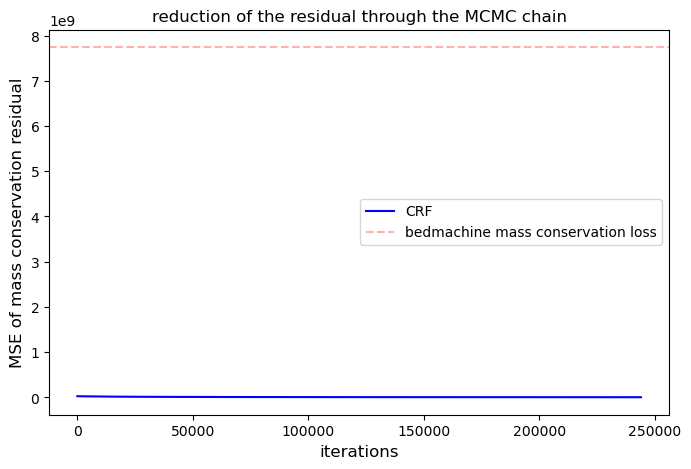

In [225]:
plt.figure(figsize=(8,5))
begin_sampling = 5000 * 40
#for i in range(mc_loss.shape[0]):
#    plt.plot(range(5000*40+i*4000,5000*40+i*4000+mc_loss.shape[1]),mc_loss[i,],color=color[i],label=str(i)+'th sgs chain')
plt.plot(mc_loss_crf,color='blue',label='CRF')
#plt.yscale('log')
plt.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='bedmachine mass conservation loss',alpha=0.3)
plt.ylabel('MSE of mass conservation residual',size=12)
plt.xlabel('iterations',size=12)
plt.title('reduction of the residual through the MCMC chain',size=12)
plt.legend()

plt.show()

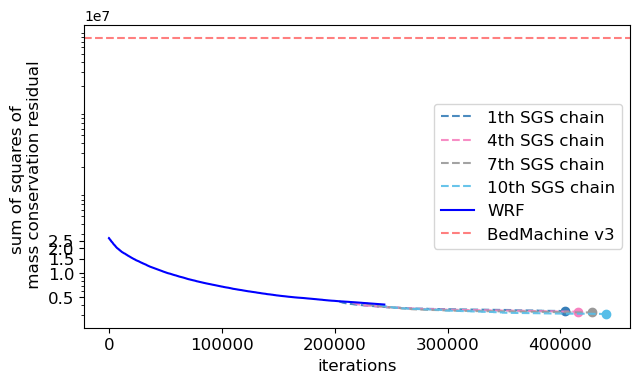

In [194]:
mm = 1/25.4
plt.figure(figsize=(179*mm, 100*mm))
axes = plt.axes()
begin_sampling = 5000 * 40 + 4000
for i in range(0,mc_loss.shape[0],3):
    axes.plot(range(begin_sampling+i*4000,begin_sampling+i*4000+mc_loss.shape[1]),mc_loss[i,],
             color=color[i],label=str(i+1)+'th SGS chain', alpha=0.9, linestyle='--')
    axes.scatter(begin_sampling+i*4000+mc_loss.shape[1], mc_loss[i,-1], color=color[i])
axes.plot(mc_loss_crf,color='blue',label='WRF')
axes.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='BedMachine v3',alpha=0.5)
axes.set_yscale('log')
axes.set_yticks([5*10**6,10**7,1.5*10**7,2.0*10**7,2.5*10**7])
axes.yaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
axes.yaxis.set_tick_params(labelsize=12)
axes.set_ylabel('sum of squares of \n mass conservation residual',size=12)
axes.set_xlabel('iterations',size=12)
axes.xaxis.set_tick_params(labelsize=12)
#plt.title('reduction of the residual',size=12)
axes.legend(fontsize=12)
#plt.show()
plt.savefig('residualReduction.png', bbox_inches = 'tight')

In [ ]:
mm = 1/25.4
plt.figure(figsize=(85*mm, 100*mm))
axes = plt.axes()
begin_sampling = 5000 * 40 + 4000
for i in range(0,mc_loss.shape[0],3):
    axes.plot(range(begin_sampling+i*4000,begin_sampling+i*4000+mc_loss.shape[1]),mc_loss[i,],
             color=color[i],label=str(i+1)+'th SGS chain', alpha=0.9, linestyle='--')
    axes.scatter(begin_sampling+i*4000+mc_loss.shape[1], mc_loss[i,-1], color=color[i])
axes.plot(mc_loss_crf,color='blue',label='WRF')
axes.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='BedMachine v3',alpha=0.5)
axes.set_yscale('log')
axes.set_yticks([5*10**6,10**7,1.5*10**7,2.0*10**7,2.5*10**7])
axes.yaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
axes.yaxis.set_tick_params(labelsize=12)
axes.set_ylabel('sum of squares of \n mass conservation residual',size=12)
axes.set_xlabel('iterations',size=12)
axes.xaxis.set_tick_params(labelsize=12)
#plt.title('reduction of the residual',size=12)
axes.legend(fontsize=12)
#plt.show()
plt.savefig('residualReduction.png', bbox_inches = 'tight')

In [195]:
SMALL_SIZE = 18

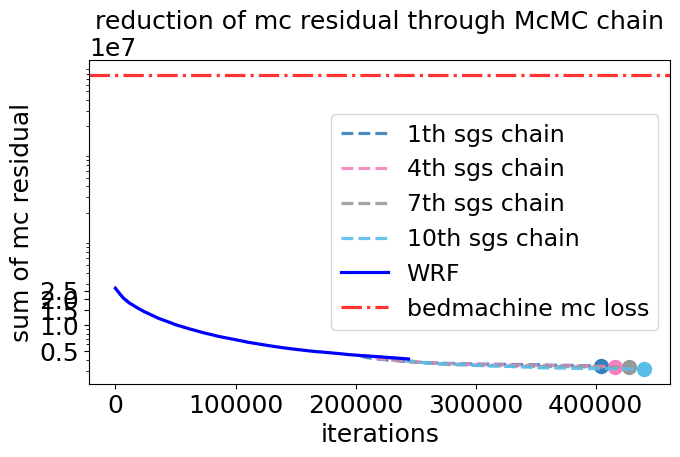

In [196]:
mm = 1/25.4
plt.figure(figsize=(7.5,4.2))
axes = plt.axes()
begin_sampling = 5000 * 40 + 4000
for i in range(0,mc_loss.shape[0],3):
    axes.plot(range(begin_sampling+i*4000,begin_sampling+i*4000+mc_loss.shape[1]),mc_loss[i,],
             color=color[i],label=str(i+1)+'th sgs chain', alpha=0.9, linestyle='--',linewidth=2.3)
    axes.scatter(begin_sampling+i*4000+mc_loss.shape[1], mc_loss[i,-1], color=color[i],s=100)
axes.plot(mc_loss_crf,color='blue',label='WRF',linewidth=2.3)
axes.axhline(y = mc_loss_bm, color = 'r', linestyle = '-.', label='bedmachine mc loss',alpha=0.8,linewidth=2.3)

axes.set_yscale('log')
axes.set_yticks([5*10**6,10**7,1.5*10**7,2.0*10**7,2.5*10**7]) 
axes.yaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
axes.yaxis.set_tick_params(labelsize=18)
axes.set_ylabel('sum of mc residual',size=18)
axes.yaxis.offsetText.set_fontsize(18)
axes.xaxis.set_tick_params(labelsize=18)
axes.set_xlabel('iterations',size=18)

axes.set_title('reduction of mc residual through McMC chain',fontsize=18)

plt.legend(fontsize=17,markerscale=5)

plt.savefig('residualReduction.png')

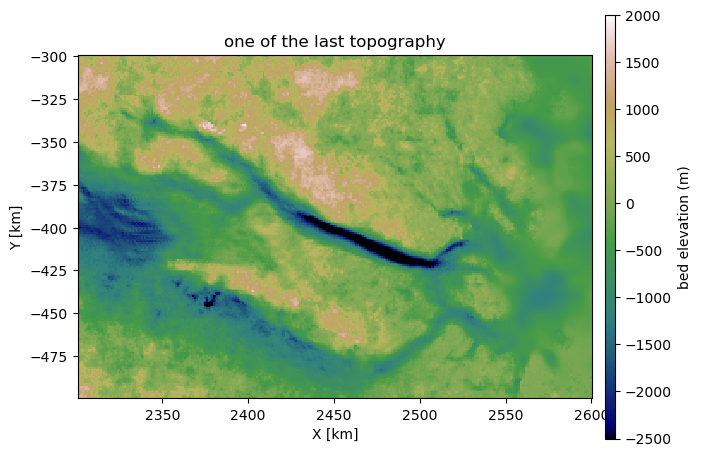

In [190]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, last_beds_all[2,0,:,:],cmap='gist_earth',vmax=2000,vmin=-2500)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('one of the last topography')
plt.axis('scaled')
plt.show()

In [71]:
SMALL_SIZE = 18
MEDIUM_SIZE = 20

In [27]:
print(np.min(df_bm.bed.values))

-3788.1


In [25]:
for i in range(4):
    for j in range(10):
        print(np.min(last_beds_all[i,j,:,:]))

-3950.2224749726815
-3951.4654349064203
-3939.4148605633327
-3960.110814437051
-3960.110814437051
-3960.110814437051
-3955.539657041684
-3962.634218088436
-3955.221349831139
-3930.909413173149
-3991.7706339808424
-4005.144248246748
-3977.655428949268
-3976.4228681778472
-4004.92533937501
-4004.92533937501
-4000.077816829916
-4004.92533937501
-4004.92533937501
-4020.2565175927134
-3903.04923751733
-3890.4158445067524
-3884.303263421708
-3929.604690685229
-3925.3005668182886
-3925.3005668182886
-3931.382879416772
-3945.288908834238
-3963.7893312384504
-3972.299358934726
-3941.5010441578247
-3947.3176548263705
-3993.5086179228347
-3977.9221532985257
-4002.3800761652933
-4002.3800761652933
-3998.179258454341
-4019.995656271943
-4030.6469380520048
-4020.390868593618


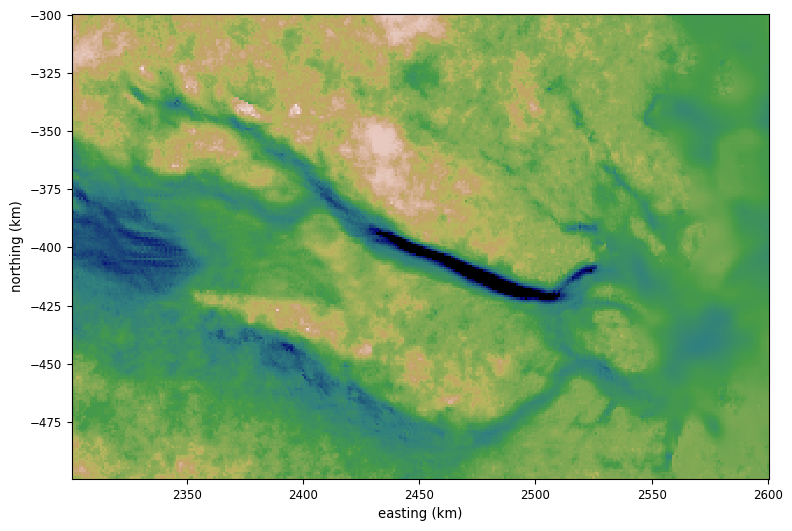

In [156]:
fig,ax = plt.subplots(figsize=(9,7))

ax.pcolormesh(xx/1000, yy/1000, last_beds_all[3,9,:,:],vmax=2000,vmin=-2500,cmap='gist_earth')
ax.yaxis.offsetText.set_fontsize(SMALL_SIZE)
ax.xaxis.offsetText.set_fontsize(SMALL_SIZE)
ax.tick_params(axis='both', labelsize=SMALL_SIZE)
ax.set_xlabel('easting (km)',fontsize=MEDIUM_SIZE)
ax.set_ylabel('northing (km)',fontsize=MEDIUM_SIZE)
ax.axis('scaled')

plt.savefig('./figures/FlashFreeze_mcmcbed3.png', bbox_inches='tight',dpi=600)

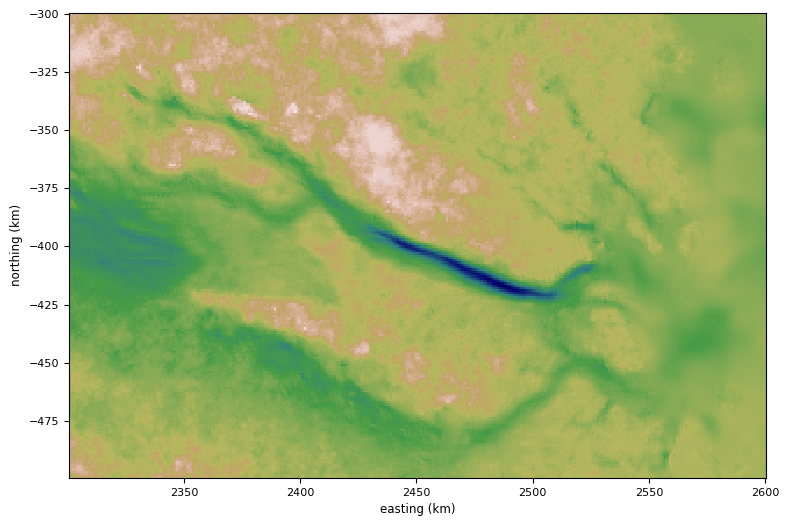

In [130]:
fig,ax = plt.subplots(figsize=(9,7))

ax.pcolormesh(xx/1000, yy/1000, last_beds_all[3,9,:,:],vmax=2000,vmin=-4000,cmap='gist_earth')
ax.yaxis.offsetText.set_fontsize(SMALL_SIZE)
ax.xaxis.offsetText.set_fontsize(SMALL_SIZE)
ax.tick_params(axis='both', labelsize=SMALL_SIZE)
ax.set_xlabel('easting (km)',fontsize=MEDIUM_SIZE)
ax.set_ylabel('northing (km)',fontsize=MEDIUM_SIZE)
ax.axis('scaled')

plt.savefig('./figures/FlashFreeze_mcmcbed3.png', bbox_inches='tight',dpi=600)

Text(0.5, 1.0, 'end topography of every sgs chain')

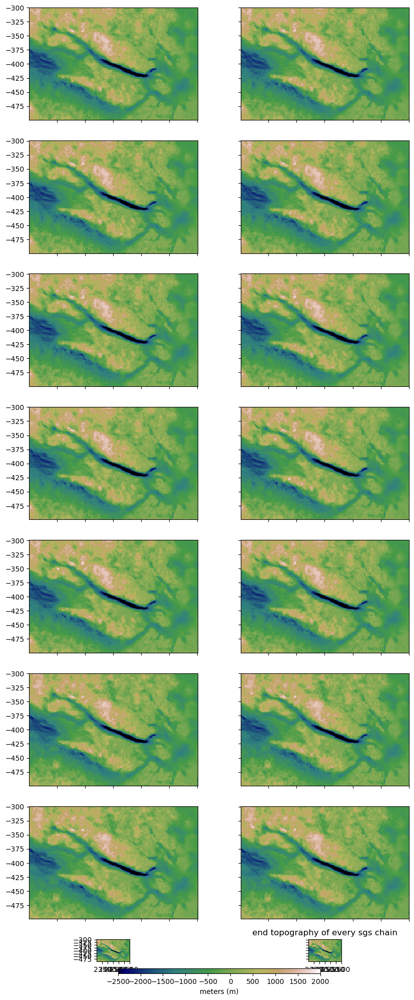

In [131]:
fig,axes = plt.subplots(8,2,sharex=True,sharey=True,height_ratios=[1,1,1,1,1,1,1,0.3],figsize=(10,25))

for i,ax in enumerate(axes.flat):
    f = ax.pcolormesh(xx/1000, yy/1000, last_beds[i,:,:],cmap='gist_earth',vmax=2000,vmin=-2500)
    ax.axis('scaled')
    if i == last_beds.shape[0]-1:
        break

plt.colorbar(f, ax=axes[7,:],pad=0.2, aspect=40, label='meters (m)', orientation='horizontal')
plt.title('end topography of every sgs chain')

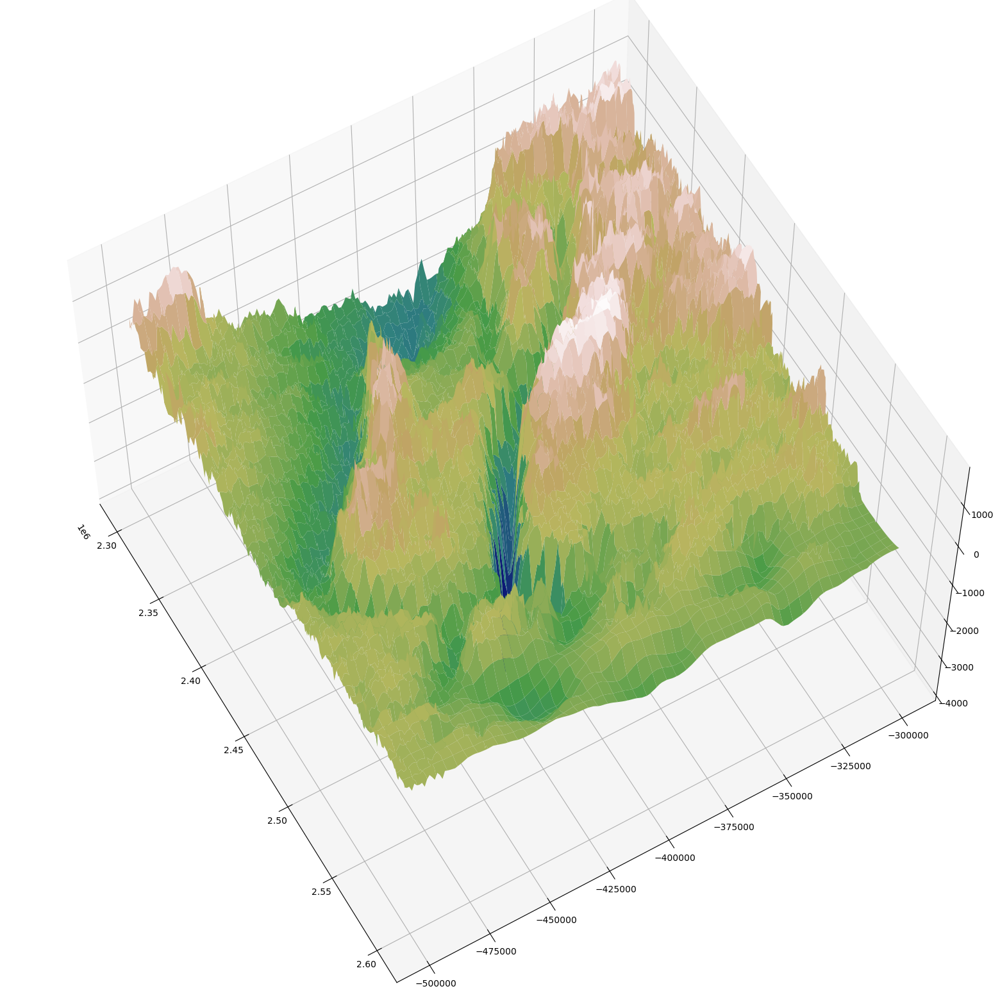

In [133]:
fig = plt.figure(figsize = (24,20))
ax = plt.axes(projection='3d')
ax.plot_surface(xx, yy, last_beds_all[0,0,:,:], cmap = 'gist_earth')
ax.view_init(azim = -30, elev = 60)
plt.savefig('./figures/WAIS_title.png')

In [ ]:
z = last_beds_all[0,0,:,:]

# Creating a regular grid
xi, yi = np.linspace(xx.min(), xx.max(), 2000), np.linspace(yy.min(), yy.max(), 3000)
xi, yi = np.meshgrid(xi, yi)

# Interpolating irregular data onto the regular grid
zi = sp.interpolate.griddata(np.array([xx.flatten(),yy.flatten()]).T, z.flatten(), (xi, yi), method='linear')

# Creating a 3D plot
fig = plt.figure(figsize = (12,10))
ax = fig.add_subplot(111, projection='3d')
ls = matplotlib.colors.LightSource(270, 45)
rgb = ls.shade(zi, cmap=matplotlib.cm.gist_earth, vert_exag=0.1, blend_mode='soft')
# Plotting the 3D surface from irregular data using grid interpolation
ax.plot_surface(xi, yi, zi, rstride=1, cstride=1, facecolors=rgb,
                       linewidth=0, antialiased=False, shade=False)

ax.view_init(azim = -30, elev = 60)

# Customizing the plot
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')
ax.set_title('3D Surface Plot from Irregular Data (Grid Interpolation)')

# Displaying the plot
plt.show()

In [ ]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('topography mean')
plt.axis('scaled')
plt.show()

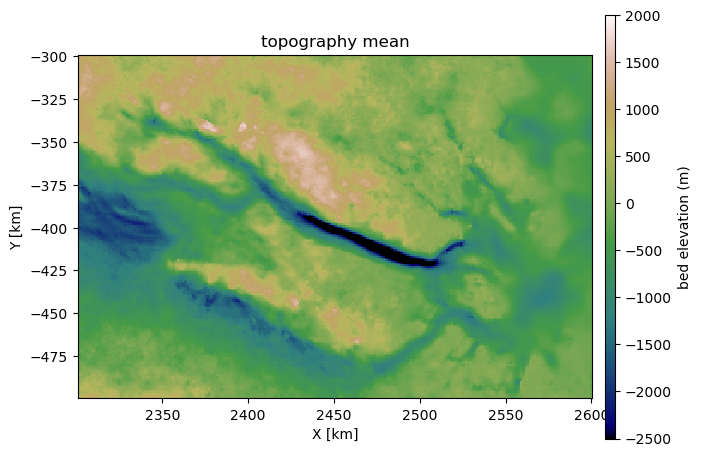

In [107]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('topography mean')
plt.axis('scaled')
plt.show()

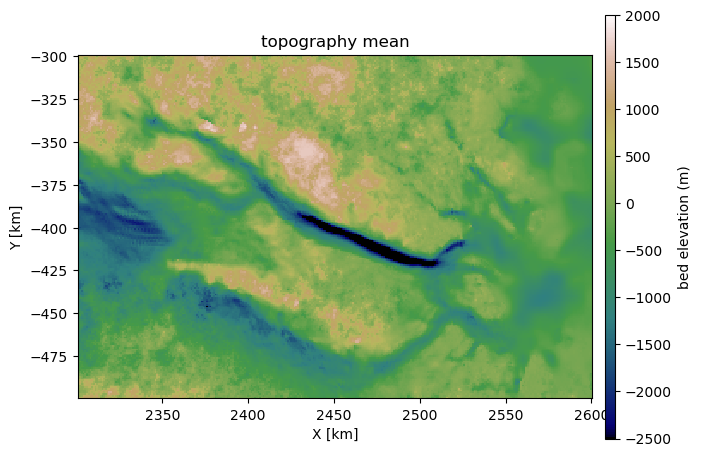

In [236]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.mean(last_beds[:,:,:],axis=(0)),cmap='gist_earth',vmax=2000,vmin=-2500)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('topography mean')
plt.axis('scaled')
plt.show()

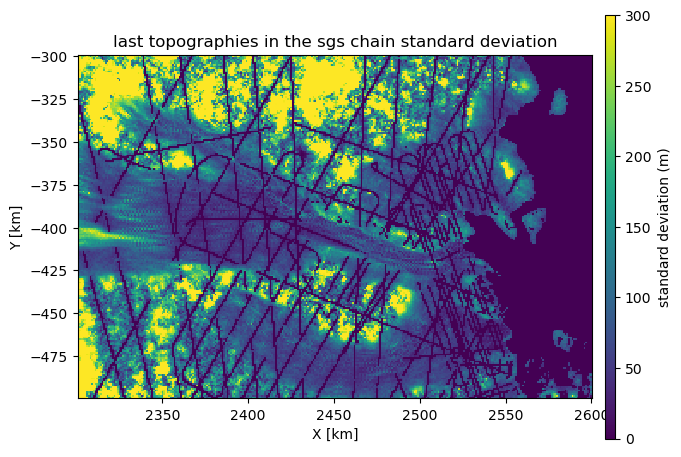

In [108]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap='viridis',vmax=300)
plt.colorbar(pad=0.02, aspect=40, label='standard deviation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('last topographies in the sgs chain standard deviation')
plt.axis('scaled')
plt.show()

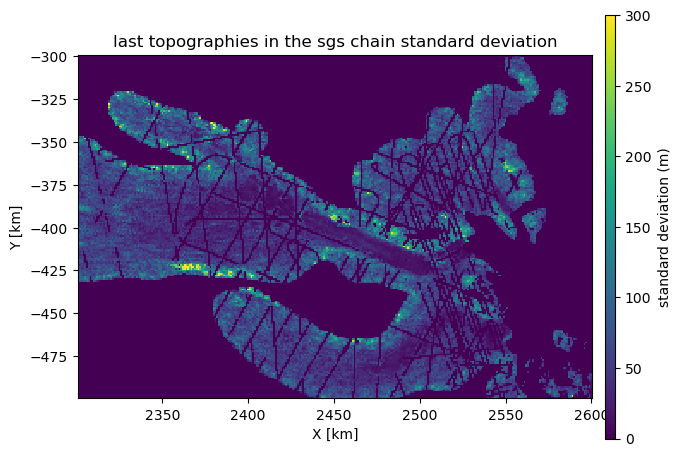

In [237]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.std(last_beds[:,:,:],axis=(0)),cmap='viridis',vmax=300)
plt.colorbar(pad=0.02, aspect=40, label='standard deviation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('last topographies in the sgs chain standard deviation')
plt.axis('scaled')
plt.show()

In [27]:
cmap = plt.get_cmap('magma')
new_cmap = matplotlib.colors.LinearSegmentedColormap.from_list('magma',cmap(np.linspace(0.3, 1, 256)))

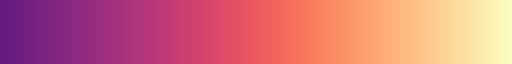

In [28]:
new_cmap

In [29]:
N = 128
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(1/256, 1, N)
vals1[:, 1] = np.linspace(133/256, 1, N)
vals1[:, 2] = np.linspace(113/256, 1, N)

vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(1,166/256, N)
vals2[:, 1] = np.linspace(1,97/256, N)
vals2[:, 2] = np.linspace(1,26/256, N)

cmp_gnbr = ListedColormap(np.vstack([vals1,vals2]))

In [30]:
SMALL_SIZE = 8.5
MEDIUM_SIZE = 9.5

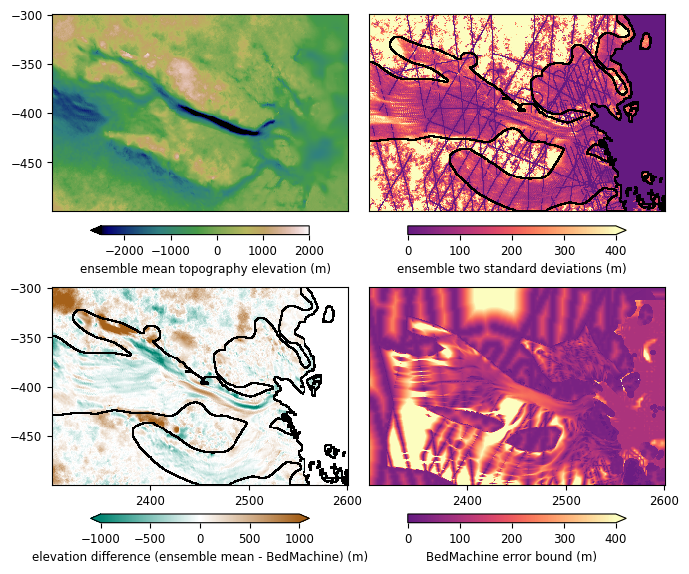

In [155]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 150*mm))

gs = fig.add_gridspec(2,2,width_ratios=[1,1],height_ratios=[1,1.07])
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])

#############################ax1###################################

f_mean = ax1.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
cbar1 = plt.colorbar(f_mean,ax=ax1,aspect=25,orientation='horizontal',
             location='bottom',pad=0.06,shrink=0.7,extend='min')
cbar1.set_label(label='ensemble mean topography elevation (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax1.set_title('Ensemble mean',size=MEDIUM_SIZE)
#ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax1.set_xticks([])
ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.set_yticks([-300,-350,-400,-450])
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
#ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax1.axis('scaled')

#xs = [2430, 2470, 2470, 2430, 2430]
#ys = [-390, -390, -430, -430, -390]
#ax1.plot(xs, ys, color="red")


#############################ax2###################################

f_std = ax2.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1))*2,cmap=new_cmap,vmax=400)
cbar2 = plt.colorbar(f_std,ax=ax2,aspect=25,orientation='horizontal',
             location='bottom',pad=0.06,shrink=0.7,extend='max')
cbar2.set_label(label='ensemble two standard deviations (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='Reds')
#ax2.set_title('Two standard deviation of the ensemble',fontsize=MEDIUM_SIZE)
ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
#ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask,cmap='grey',alpha=0.2)
ax2.set_xticks([])
ax2.set_yticks([])
#ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax2.axis('scaled')

#ax2.plot(xs, ys, color="red")

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_diff = ax3.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)) - bm_bed,cmap=cmp_gnbr,vmax=1000,vmin=-1000)
cbar3 = plt.colorbar(f_diff, ax = ax3,aspect=25,orientation='horizontal',location='bottom',
                     pad=0.11,shrink=0.7,extend='both')
cbar3.set_label(label='elevation difference (ensemble mean - BedMachine) (m)',size=SMALL_SIZE)
cbar3.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))
#ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='Reds')
#ax3.set_title('Ensemble mean minus BedMachine',fontsize=MEDIUM_SIZE)
ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
ax3.set_xticks([2400,2500,2600])
ax3.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax3.set_yticks([-300,-350,-400,-450])
ax3.yaxis.set_tick_params(labelsize=SMALL_SIZE)
#ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask,cmap='grey',alpha=0.2)
#ax3.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
#ax3.set_xticks([])
#ax3.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax3.axis('scaled')

#############################ax4###################################

f_bmerror = ax4.pcolormesh(xx/1000, yy/1000, df_bm.error.values.reshape(xx.shape),cmap=new_cmap,vmax=400,vmin=0)
cbar4 = plt.colorbar(f_bmerror, ax = ax4,aspect=25,orientation='horizontal',location='bottom',
                     pad=0.11,shrink=0.7,extend='max', label='bedmachine error')
cbar4.set_label(label='BedMachine error bound (m)',size=SMALL_SIZE)
cbar4.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax4.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax4.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax4.set_title('Topography error bound estimated by BedMachine',fontsize=MEDIUM_SIZE)
#ax4.set_xticks([])
ax4.set_yticks([])
ax4.set_xticks([2400,2500,2600])
ax4.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax4.yaxis.set_tick_params(labelsize=SMALL_SIZE)
#ax4.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax4.axis('scaled')


# ax1.set_anchor('N')
# ax2.set_anchor('N')
# ax3.set_anchor('N')
# ax4.set_anchor('N')

plt.tight_layout(w_pad=0.1,h_pad=0.1)

plt.savefig('ensembleStats.png',bbox_inches='tight',dpi=300)

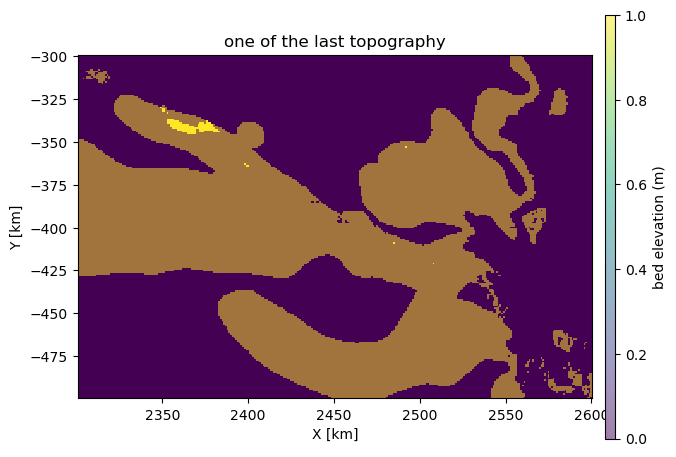

In [164]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.abs(np.mean(last_beds_all[:,:,:,:],axis=(0,1)) - bm_bed)>1200)
plt.pcolormesh(xx/1000,yy/1000,mc_region_mask,alpha=0.5)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('one of the last topography')
plt.axis('scaled')
plt.show()

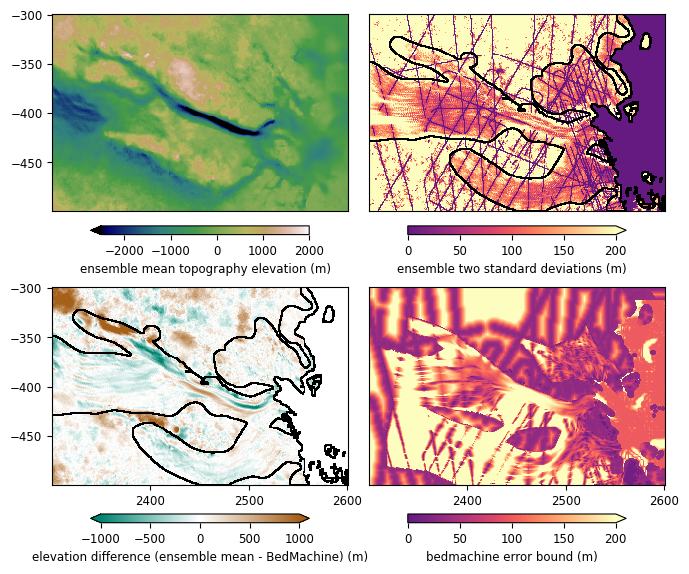

In [100]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 150*mm))

gs = fig.add_gridspec(2,2,width_ratios=[1,1],height_ratios=[1,1.07])
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax3 = fig.add_subplot(gs[1, 0])
ax4 = fig.add_subplot(gs[1, 1])

#############################ax1###################################

f_mean = ax1.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
cbar1 = plt.colorbar(f_mean,ax=ax1,aspect=25,orientation='horizontal',
             location='bottom',pad=0.06,shrink=0.7,extend='min')
cbar1.set_label(label='ensemble mean topography elevation (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax1.set_title('Ensemble mean',size=MEDIUM_SIZE)
#ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax1.set_xticks([])
ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.set_yticks([-300,-350,-400,-450])
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
#ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax1.axis('scaled')

#xs = [2430, 2470, 2470, 2430, 2430]
#ys = [-390, -390, -430, -430, -390]
#ax1.plot(xs, ys, color="red")


#############################ax2###################################

f_std = ax2.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1))*2,cmap=new_cmap,vmax=200)
cbar2 = plt.colorbar(f_std,ax=ax2,aspect=25,orientation='horizontal',
             location='bottom',pad=0.06,shrink=0.7,extend='max')
cbar2.set_label(label='ensemble two standard deviations (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax2.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax2.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='Reds')
#ax2.set_title('Two standard deviation of the ensemble',fontsize=MEDIUM_SIZE)
ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
#ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask,cmap='grey',alpha=0.2)
ax2.set_xticks([])
ax2.set_yticks([])
#ax2.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax2.axis('scaled')

#ax2.plot(xs, ys, color="red")

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_diff = ax3.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)) - bm_bed,cmap=cmp_gnbr,vmax=1000,vmin=-1000)
cbar3 = plt.colorbar(f_diff, ax = ax3,aspect=25,orientation='horizontal',location='bottom',
                     pad=0.11,shrink=0.7,extend='both')
cbar3.set_label(label='elevation difference (ensemble mean - BedMachine) (m)',size=SMALL_SIZE)
cbar3.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax3.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax3.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax3.ticklabel_format(style="sci", axis="x", scilimits=(0,2))
#ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='Reds')
#ax3.set_title('Ensemble mean minus BedMachine',fontsize=MEDIUM_SIZE)
ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
ax3.set_xticks([2400,2500,2600])
ax3.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax3.set_yticks([-300,-350,-400,-450])
ax3.yaxis.set_tick_params(labelsize=SMALL_SIZE)
#ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask,cmap='grey',alpha=0.2)
#ax3.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
#ax3.set_xticks([])
#ax3.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax3.axis('scaled')

#############################ax4###################################

f_bmerror = ax4.pcolormesh(xx/1000, yy/1000, df_bm.error.values.reshape(xx.shape),cmap=new_cmap,vmax=200,vmin=0)
cbar4 = plt.colorbar(f_bmerror, ax = ax4,aspect=25,orientation='horizontal',location='bottom',
                     pad=0.11,shrink=0.7,extend='max', label='bedmachine error')
cbar4.set_label(label='bedmachine error bound (m)',size=SMALL_SIZE)
cbar4.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
#ax4.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax4.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
#ax4.set_title('Topography error bound estimated by BedMachine',fontsize=MEDIUM_SIZE)
#ax4.set_xticks([])
ax4.set_yticks([])
ax4.set_xticks([2400,2500,2600])
ax4.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax4.yaxis.set_tick_params(labelsize=SMALL_SIZE)
#ax4.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
ax4.axis('scaled')


# ax1.set_anchor('N')
# ax2.set_anchor('N')
# ax3.set_anchor('N')
# ax4.set_anchor('N')

plt.tight_layout(w_pad=0.1,h_pad=0.1)

plt.savefig('ensembleStats.png',bbox_inches='tight',dpi=300)

In [37]:
SMALL_SIZE=19
MEDIUM_SIZE=20
LARGE_SIZE=22

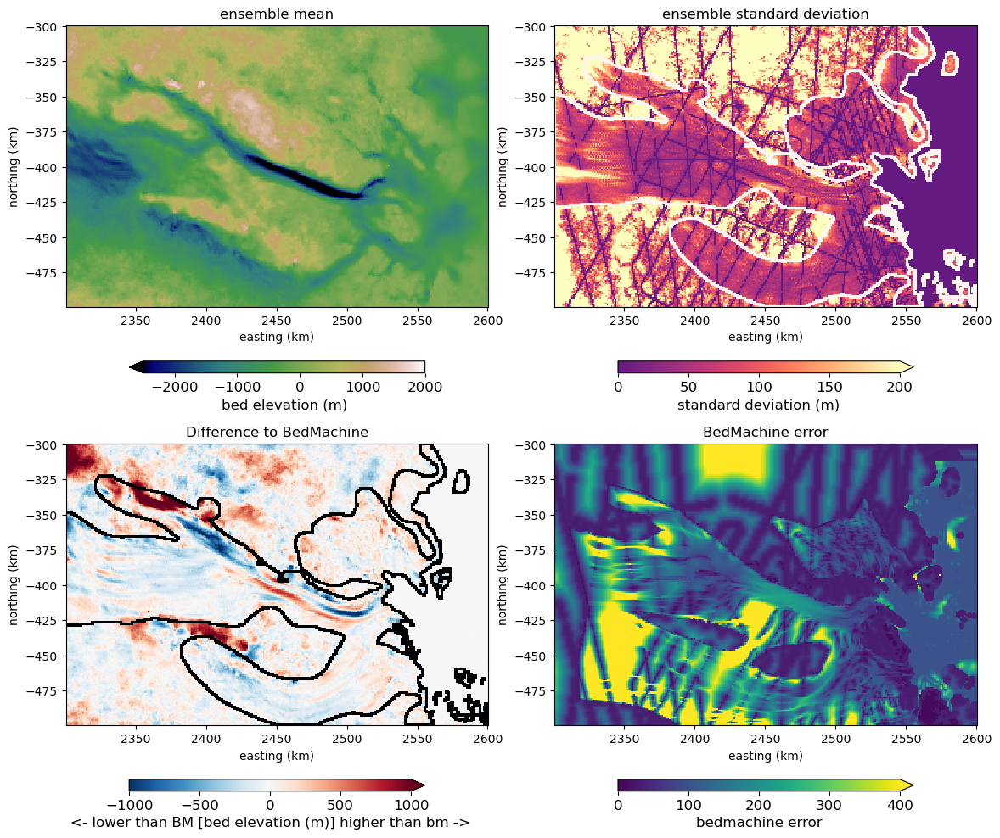

In [148]:
#############################layout###################################
fig = plt.figure(figsize=(11.6,10))

gs = fig.add_gridspec(2,2,width_ratios=[1,1],height_ratios=[1.15,1.15])
ax1 = fig.add_subplot(gs[0, 0],anchor='N')
ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[1, 0],anchor='N')
ax4 = fig.add_subplot(gs[1, 1],anchor='N')

#############################ax1###################################

f_mean = ax1.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
cbar1 = plt.colorbar(f_mean,ax=ax1,aspect=25,orientation='horizontal',
             location='bottom',pad=0.1,shrink=0.7,extend='min')
cbar1.set_label(label='bed elevation (m)',size=MEDIUM_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE)
ax1.set_title('ensemble mean',fontsize=MEDIUM_SIZE)
ax1.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
ax1.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
ax1.axis('scaled')

#xs = [2430, 2470, 2470, 2430, 2430]
#ys = [-390, -390, -430, -430, -390]
#ax1.plot(xs, ys, color="red")


#############################ax2###################################

f_std = ax2.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=200)
cbar2 = plt.colorbar(f_std,ax=ax2,aspect=25,orientation='horizontal',
             location='bottom',pad=0.1,shrink=0.7,extend='max')
cbar2.set_label(label='standard deviation (m)',size=MEDIUM_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE) 
ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='Reds')
ax2.set_title('ensemble standard deviation',fontsize=MEDIUM_SIZE)
ax2.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
ax2.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
ax2.axis('scaled')

#ax2.plot(xs, ys, color="red")

#############################ax3###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_diff = ax3.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)) - bm_bed,cmap='RdBu_r',vmax=1000,vmin=-1000)
cbar3 = plt.colorbar(f_diff, ax = ax3,aspect=25,orientation='horizontal',location='bottom',
             pad=0.12,shrink=0.7,extend='max')
cbar3.set_label(label='<- lower than BM [bed elevation (m)] higher than bm ->',size=MEDIUM_SIZE)
cbar3.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE) 
ax3.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
ax3.set_title('Difference to BedMachine',fontsize=MEDIUM_SIZE)
ax3.tick_params(axis='both', labelsize=SMALL_SIZE)
ax3.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
ax3.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax3.axis('scaled')

#############################ax4###################################

f_bmerror = ax4.pcolormesh(xx/1000, yy/1000, df_bm.error.values.reshape(xx.shape),cmap='viridis',vmax=400,vmin=0)
cbar4 = plt.colorbar(f_bmerror, ax = ax4,aspect=25,orientation='horizontal',location='bottom',
             pad=0.12,shrink=0.7,extend='max', label='bedmachine error')
cbar4.set_label(label='bedmachine error',size=MEDIUM_SIZE)
cbar4.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE) 
ax4.set_title('BedMachine error',fontsize=MEDIUM_SIZE)
ax4.tick_params(axis='both', labelsize=SMALL_SIZE)
ax4.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
ax4.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax4.axis('scaled')


ax1.set_anchor('N')
ax2.set_anchor('N')
ax3.set_anchor('N')
ax4.set_anchor('N')

plt.tight_layout(pad=0.6,h_pad=0.2)

plt.savefig('ensembleStats.png')

In [5]:
axxmin = 70
axxmax = 110
axymin = 130
axymax = 170

In [ ]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 60*mm))

gs = fig.add_gridspec(1,4,width_ratios=[1,1,1,1],height_ratios=[1])
ax1 = fig.add_subplot(gs[0, 0],anchor='N')
ax2 = fig.add_subplot(gs[0, 1],anchor='N')
ax3 = fig.add_subplot(gs[0, 2],anchor='N')
ax4 = fig.add_subplot(gs[0, 3],anchor='N')
#############################ax1###################################

f_s1 = ax1.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[0,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(f_s1,ax=ax1,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='min')
#ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax1.set_title('sample 1')
#ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
#ax1.set_xticks([])
#ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax1.axis('scaled')

#############################ax2###################################

f_s2 = ax2.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[1,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(f_s1,ax=ax1,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='min')
#ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax2.set_title('sample 2')
#ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
#ax2.set_xticks([])
#ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax2.set_yticks([])
ax2.axis('scaled')

#############################ax3###################################

f_s3 = ax3.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[2,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(f_s1,ax=ax1,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='min')
#ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax3.set_title('sample 3')
#ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
#ax3.set_xticks([])
ax3.set_yticks([])
#ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax3.axis('scaled')

#############################ax4###################################

f_s4 = ax4.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[3,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(f_s1,ax=ax1,label='bed elevation (m)',aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='min')
#ax1.yaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="y", scilimits=(0,2)) 
#ax1.xaxis.set_major_formatter(mt.ScalarFormatter(useMathText=True))
#ax1.ticklabel_format(style="sci", axis="x", scilimits=(0,2))  
ax4.set_title('sample 4')
#ax1.set_xlabel('easting (m)',fontsize=SMALL_SIZE)
#ax4.set_xticks([])
#ax1.set_ylabel('northing (m)',fontsize=SMALL_SIZE)
ax4.set_yticks([])
ax4.axis('scaled')


ax1.set_anchor('N')
ax2.set_anchor('N')
ax3.set_anchor('N')
ax4.set_anchor('N')

plt.tight_layout(pad=0.6,h_pad=0.0)

plt.savefig('topoSample.png')

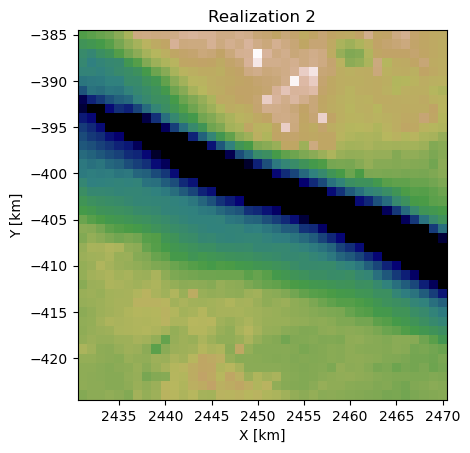

In [140]:
plt.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[0,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(pad=-0.2, aspect=40, label='resampled times')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('Realization 2')
plt.axis('scaled')
plt.show()

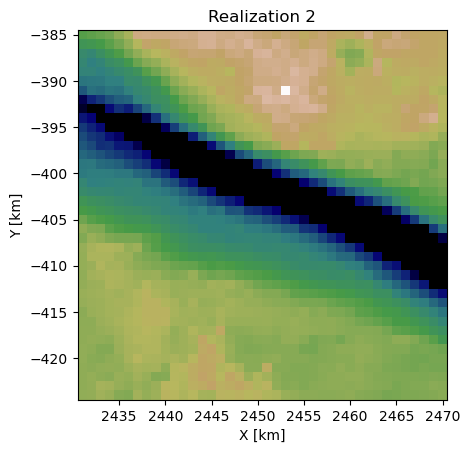

In [141]:
plt.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[1,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(pad=-0.2, aspect=40, label='resampled times')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('Realization 2')
plt.axis('scaled')
plt.show()

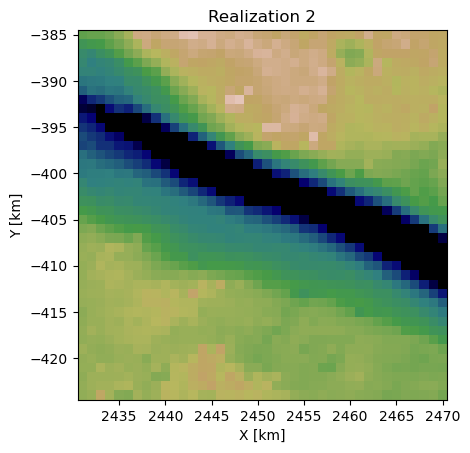

In [142]:
plt.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[2,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(pad=-0.2, aspect=40, label='resampled times')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('Realization 2')
plt.axis('scaled')
plt.show()

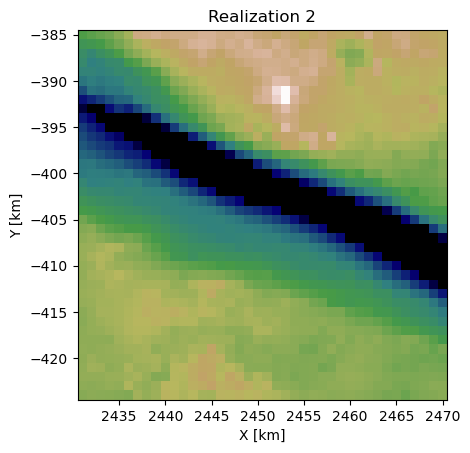

In [143]:
plt.pcolormesh(xx[axxmin:axxmax,axymin:axymax]/1000, yy[axxmin:axxmax,axymin:axymax]/1000, last_beds[3,axxmin:axxmax,axymin:axymax],cmap='gist_earth', vmax=2000, vmin=-2500)
#plt.colorbar(pad=-0.2, aspect=40, label='resampled times')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('Realization 2')
plt.axis('scaled')
plt.show()

In [80]:
np.nanmean(np.std(last_beds[:,:,:],axis=0)[mc_region_mask==1])

44.69508878857169

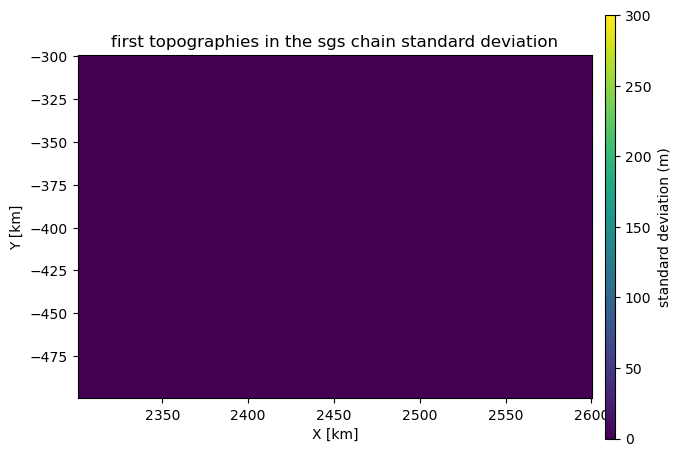

In [220]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.std(first_beds[:,:,:],axis=0),cmap='viridis', vmax=300)
plt.colorbar(pad=0.02, aspect=40, label='standard deviation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('first topographies in the sgs chain standard deviation')
plt.axis('scaled')
plt.show()

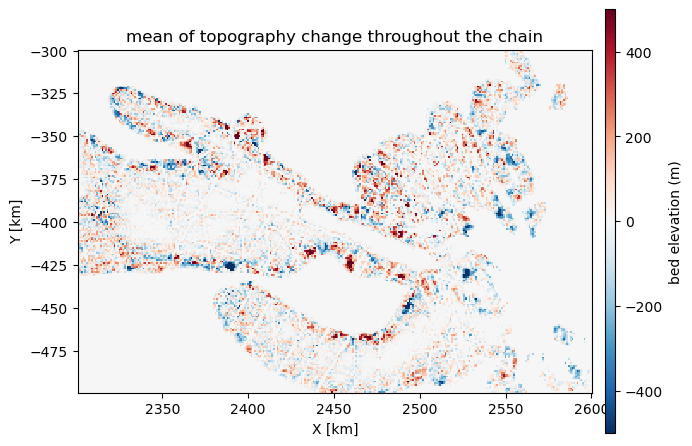

In [242]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.mean(first_beds[:,:,:],axis=0) - np.mean(last_beds[:,:,:],axis=0),cmap='RdBu_r',vmax=500,vmin=-500)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('mean of topography change throughout the chain')
plt.axis('scaled')
plt.show()

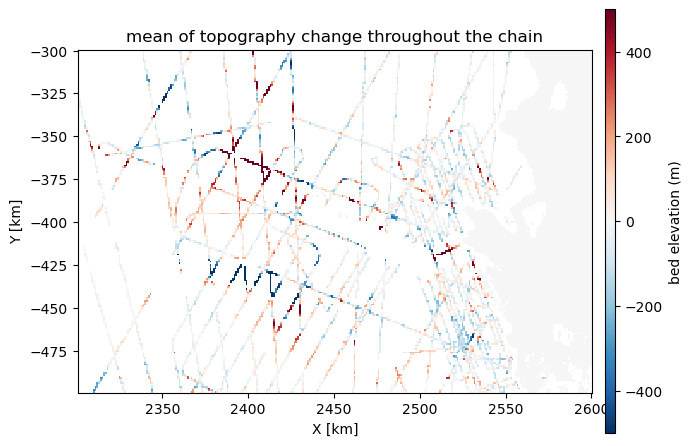

In [28]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, df_bm.bed.values.reshape(xx.shape) - df.bed.values.reshape(xx.shape),cmap='RdBu_r',vmax=500,vmin=-500)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('mean of topography change throughout the chain')
plt.axis('scaled')
plt.show()

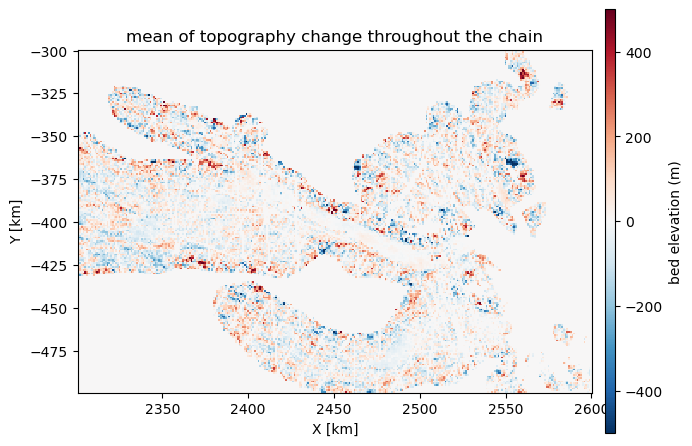

In [272]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, last_beds[0,:,:] - last_beds[1,:,:],cmap='RdBu_r',vmax=500,vmin=-500)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('mean of topography change throughout the chain')
plt.axis('scaled')
plt.show()

Text(0.5, 1.0, 'resampled times')

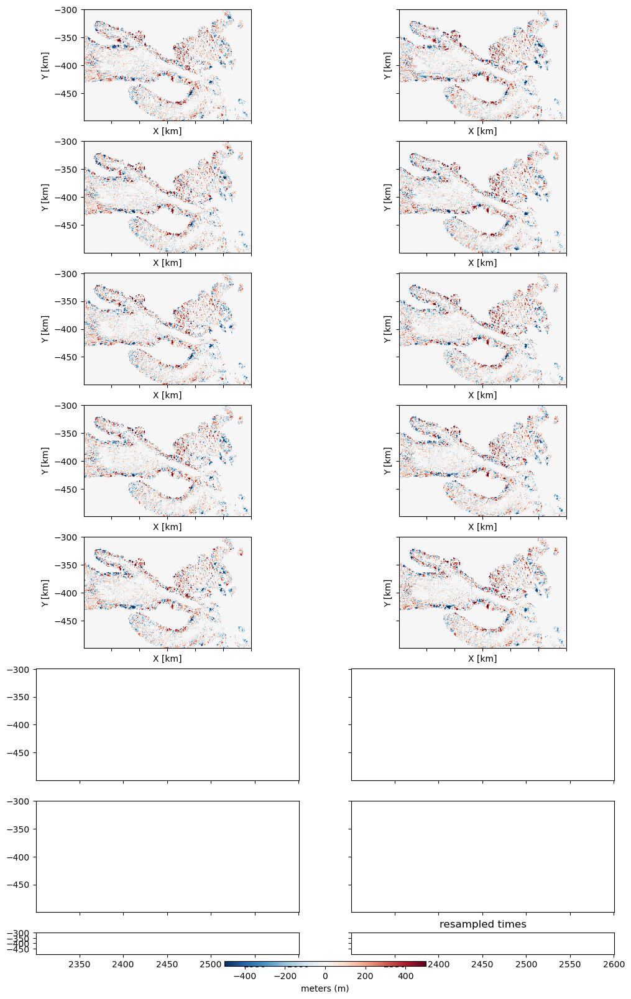

In [243]:
changes = np.zeros((num_chains,rows,cols))
for i in range(changes.shape[0]):
    changes[i,:,:] = first_beds[i,:,:] - last_beds[i,:,:]

fig,axes = plt.subplots(8,2,sharex=True,sharey=True,height_ratios=[1,1,1,1,1,1,1,0.3],figsize=(12,20))

for i,ax in enumerate(axes.flat):
    f = ax.pcolormesh(xx/1000, yy/1000, changes[i,:,:], cmap='RdBu_r',vmax=500,vmin=-500)
    ax.set(xlabel='X [km]', ylabel='Y [km]')
    ax.axis('scaled')
    if i == changes.shape[0]-1:
        break

plt.colorbar(f, ax=axes[7,:],pad=0.2, aspect=40, label='meters (m)', orientation='horizontal')
plt.title('resampled times')

In [244]:
resampled_times.shape

(10, 20, 200, 300)

In [32]:
fil = [[-1,-1,-1],
       [-1, 8,-1],
       [-1,-1,-1]]
mc_region_mask_edge = sp.ndimage.convolve(mc_region_mask, fil, mode='constant') > 0
mc_region_mask_edge = np.where(mc_region_mask_edge,1,np.nan)

(2300500.0, 2600500.0, -499500.0, -299500.0)

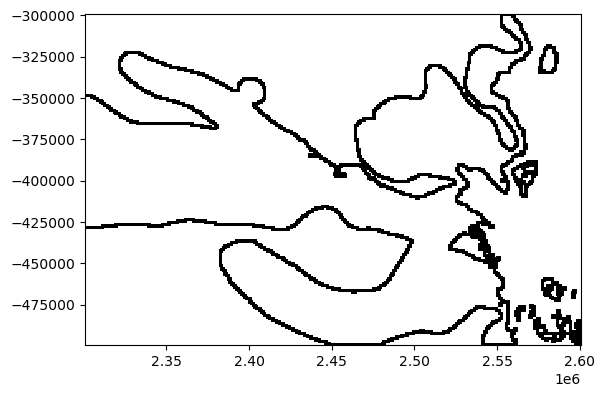

In [33]:
plt.pcolormesh(xx,yy,mc_region_mask_edge,cmap='grey')
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

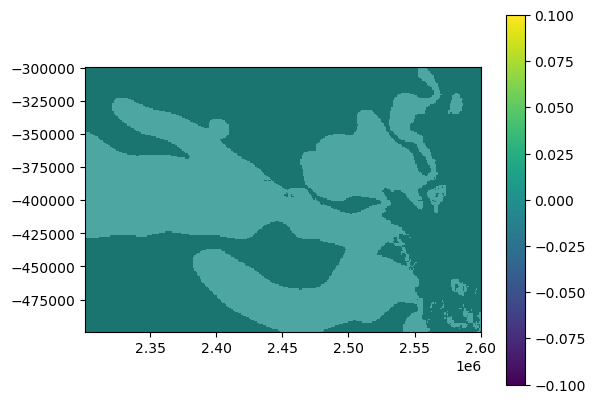

In [274]:
plt.pcolormesh(xx,yy,((surf-last_beds[0,:,:])<=0)&(mc_region_mask==1),cmap='viridis')
plt.colorbar()
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.axis('scaled')

In [ ]:
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)

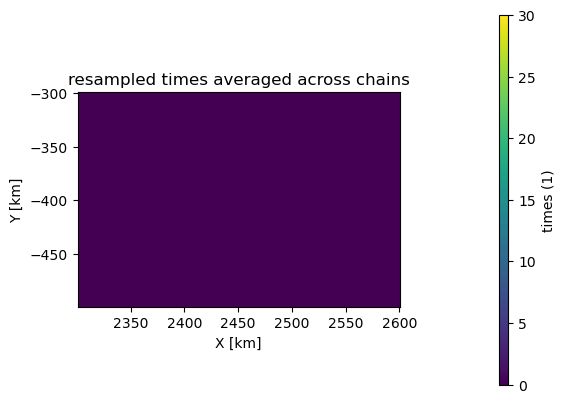

In [110]:
plt.pcolormesh(xx/1000, yy/1000, np.sum(resampled_times[:,:,:,:],axis=(0,1))/resampled_times.shape[0], cmap='viridis',vmax=30)
plt.colorbar(pad=0.2, aspect=40, label='times (1)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('resampled times averaged across chains')
plt.axis('scaled')
plt.show()

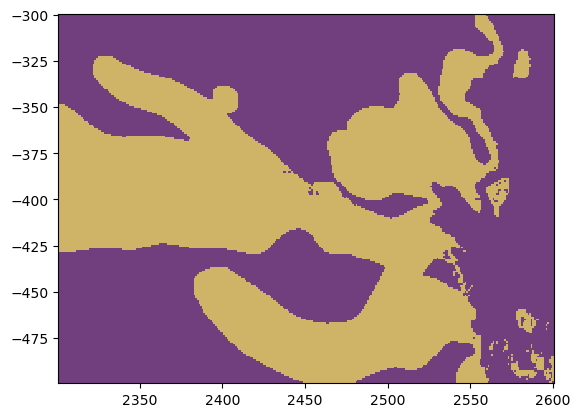

In [142]:
sum_rt = np.sum(resampled_times[7,:,:,:],axis=0)
plt.pcolormesh(xx/1000, yy/1000, sum_rt >= 1, cmap='viridis',alpha=0.5)
plt.pcolormesh(xx/1000, yy/1000, mc_region_mask, cmap='viridis',alpha=0.5)

In [75]:
resampled_times.shape

(10, 20, 200, 300)

In [111]:
int(9/10)

0

In [117]:
5/3*2*10

33.333333333333336

percentage of cells updated at least once 0.814106728538283

percentage of cells updated at least once 0.8105800464037123

percentage of cells updated at least once 0.8077958236658933

percentage of cells updated at least once 0.8097447795823666

percentage of cells updated at least once 0.8068677494199537

percentage of cells updated at least once 0.8016241299303944

percentage of cells updated at least once 0.7977262180974478

percentage of cells updated at least once 0.7966125290023202

percentage of cells updated at least once 0.7967981438515082

percentage of cells updated at least once 0.7891879350348028

percentage of cells updated at least once 0.8151740139211137

percentage of cells updated at least once 0.8208816705336427

percentage of cells updated at least once 0.8168909512761021

percentage of cells updated at least once 0.8140139211136891

percentage of cells updated at least once 0.8073317865429235

percentage of cells updated at least once 0.8068213457076566

percentag

Text(0.5, 1.0, 'resampled times')

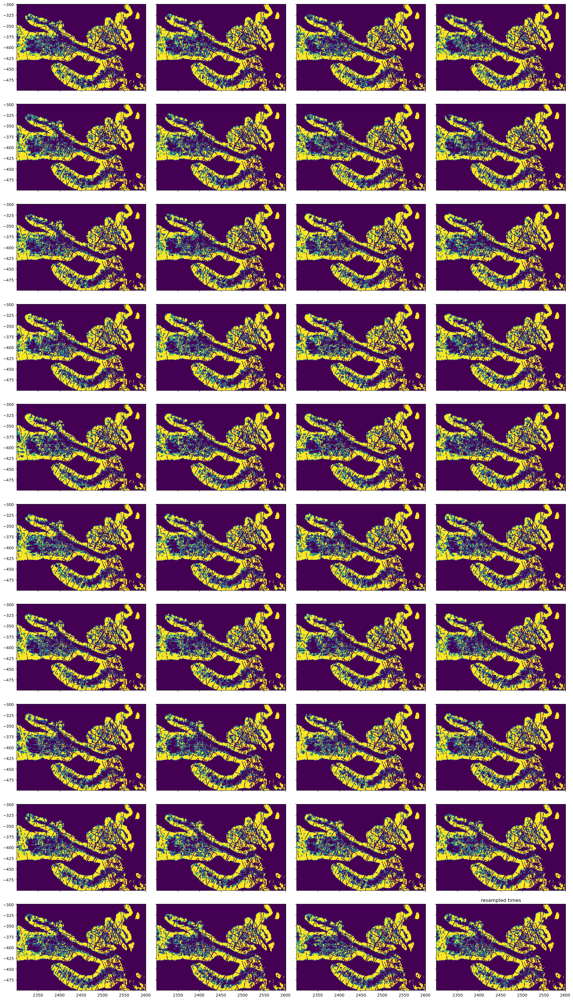

In [120]:
fig,axes = plt.subplots(10,4,sharex=True,sharey=True,figsize=(20,35))
for i,ax in enumerate(axes.flat):
    sum_rt = resampled_times_all[int(i/10),i%10,:,:]
    f = ax.pcolormesh(xx/1000, yy/1000, sum_rt, cmap='viridis',vmax=5)
    
    num_cells_resampled = np.sum((sum_rt >= 1)[mc_region_mask])
    total_num_cells = np.sum(mc_region_mask)
    data_cells = np.sum(cond_data_mask[mc_region_mask])
    print('percentage of cells updated at least once', num_cells_resampled / (total_num_cells - data_cells))
    
    ax.axis('scaled')
    print()

#plt.colorbar(f, ax=axes[7,:],pad=0.2, aspect=40, label='times (1)', orientation='horizontal')
plt.tight_layout()
plt.title('resampled times')

### Compile Ensemble to CSV & netcdf

In [157]:
realization_index = ['realization '+str(i) for i in range(0,40,1)]

In [158]:
last_beds_csv.shape

(40, 60000)

In [159]:
last_beds = last_beds_all.reshape((last_beds_all.shape[0]*last_beds_all.shape[1],last_beds_all.shape[2],last_beds_all.shape[3]))
last_beds_csv = last_beds.reshape(40, -1)
dfsave = pd.DataFrame(last_beds_csv.T, columns=realization_index)
dfsave['polar stereographic x (meters)'] = xx.flatten()
dfsave['polar stereographic y (meters)'] = yy.flatten()
dfsave['mask'] = mc_region_mask.flatten()
dfsave.to_csv('final_ensemble_2025Apr20.csv', index=False)

In [160]:
dfs = pd.read_csv('final_ensemble_2025Apr20.csv')

x_uniq = np.unique(dfs['polar stereographic x (meters)'])
y_uniq = np.unique(dfs['polar stereographic y (meters)'])

xx, yy = np.meshgrid(x_uniq, y_uniq)
print(xx.shape)

mc_region_mask = dfs['mask'].values.reshape(xx.shape)

(200, 300)


Text(0.5, 1.0, 'topography realizations')

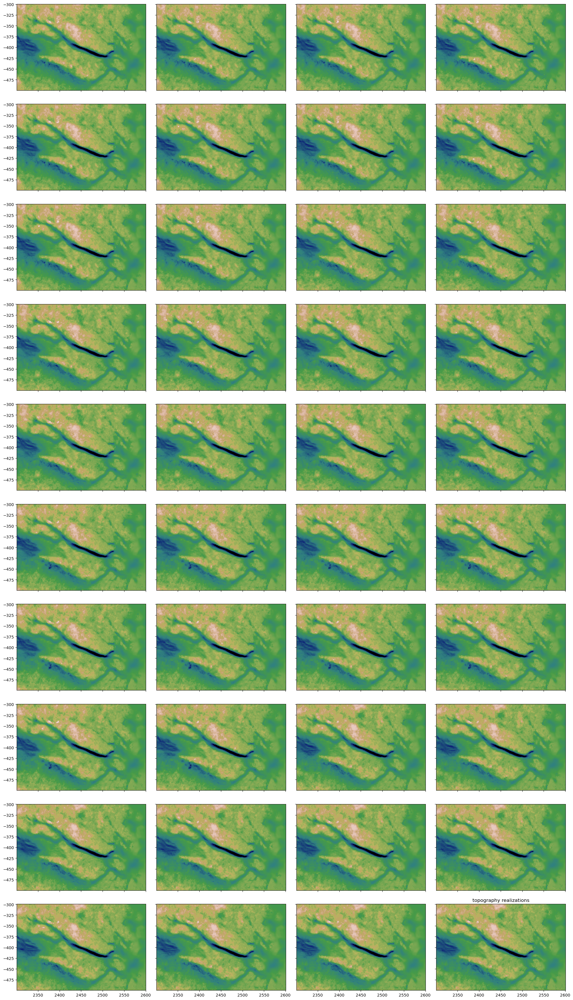

In [162]:
fig,axes = plt.subplots(10,4,sharex=True,sharey=True,figsize=(20,35))
for i,ax in enumerate(axes.flat):
    topo = dfs['realization '+str(i)].values.reshape(xx.shape)
    f = ax.pcolormesh(xx/1000, yy/1000, topo, cmap='gist_earth',vmax=2000,vmin=-2500)
    ax.axis('scaled')

plt.tight_layout()
plt.title('topography realizations')

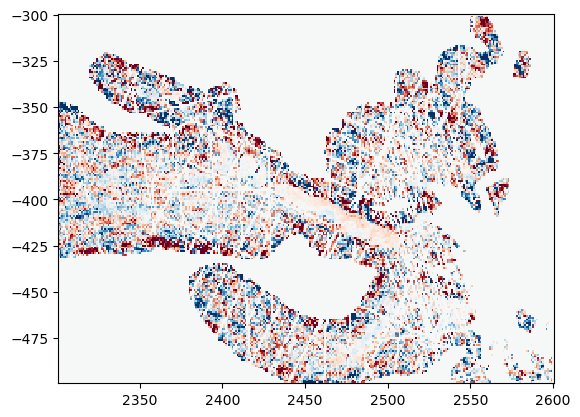

In [163]:
topo1 = dfs['realization 0'].values.reshape(xx.shape)
topo2 = dfs['realization 1'].values.reshape(xx.shape)
plt.pcolormesh(xx/1000, yy/1000, topo1-topo2, cmap='RdBu',vmax =200,vmin=-200)


In [164]:
from netCDF4 import Dataset    # Note: python is case-sensitive!
import numpy as np

In [165]:
try: nc.close()  # just to be safe, make sure dataset is not already open.
except: pass
nc = Dataset('./final_ensemble.nc',mode='w',format='NETCDF4_CLASSIC') 
print(nc)

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4_CLASSIC data model, file format HDF5):
    dimensions(sizes): 
    variables(dimensions): 
    groups: 


In [166]:
x_dim = nc.createDimension('x', 300)     # latitude axis
y_dim = nc.createDimension('y', 200)    # longitude axis
i_dim = nc.createDimension('i', 40)
for dim in nc.dimensions.items():
    print(dim)

('x', <class 'netCDF4._netCDF4.Dimension'>: name = 'x', size = 300)
('y', <class 'netCDF4._netCDF4.Dimension'>: name = 'y', size = 200)
('i', <class 'netCDF4._netCDF4.Dimension'>: name = 'i', size = 40)


In [167]:
nc.title='MCMC-sampled subglacial topography of Denman Glacier'
nc.description = "This dataset is a result of a study which uses Monte Carlo Markov Chain and geostatistics to infer subglacial topography from sparse bed elevation measurements. The dataset consists of 40 equally probable realizations of subglacial topography in the Denman region. Each of the realizations is constrained by conservation of ice mass (mass conservation), comply with bed elevation measurements from bedmap3 dataset, and has a realistic topographic roughness. The topography has 1 kilometer times 1 kilometer resolution on a regular grid in polar stereographic projection (EPSG 3412)."
nc.history = "Created " + time.ctime(time.time())
# nc.source = "netCDF4 python module tutorial"

In [172]:
ds = xr.load_dataset('./Data/SMB_RACMO2.3p2_yearly_ANT27_1979_2016.nc')

In [173]:
ds

<xarray.Dataset>
Dimensions:       (time: 38, nblock1: 40, nblock2: 400, bnds: 2, rlat: 240,
                   rlon: 262, height: 1)
Coordinates:
  * height        (height) float64 0.0
    lat           (rlat, rlon) float64 -46.75 -46.92 -47.09 ... -47.24 -47.07
    lon           (rlat, rlon) float64 -126.9 -127.1 -127.3 ... 53.03 53.23
  * rlat          (rlat) float64 -30.0 -29.75 -29.5 -29.25 ... 29.25 29.5 29.75
  * rlon          (rlon) float64 -32.75 -32.5 -32.25 -32.0 ... 32.0 32.25 32.5
  * time          (time) datetime64[ns] 1979-07-02 ... 2016-07-01T12:00:00
Dimensions without coordinates: nblock1, nblock2, bnds
Data variables:
    assigned      (time) int32 1 1 1 1 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1 1 1 1
    block1        (nblock1) int32 28 0 0 1 ... 2123789977 2123789977 2123789977
    block2        (nblock2) int32 50 0 0 0 0 10 262 0 240 ... 0 0 0 0 0 0 0 0 0
    date_bnds     (time, bnds) int32 19790668 19790696 ... 20160667 20160694
    dir           (rlat, rlon) float64 127.9 128.1 128.4 ... -51.82 -52.08
    dtg           (time) int32 1979066832 1980066712 ... 2015066832 2016066712
    hms_bnds      (time, bnds) int32 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0
    rotated_pole  float32 9.969e+36
    time_bnds     (time, bnds) datetime64[ns] 1979-07-02 ... 2016-07-02T12:00:00
    smb           (time, height, rlat, rlon) float32 -0.009532 ... -0.00516
Attributes:
    Conventions:               CF-1.4
    source:                    RACMO2
    Domain:                    ANT27
    Experiment:                ERAINx_RACMO2.4.1
    institution:               Royal Netherlands Meteorological Institute (KNMI)
    CreationDate:              Tue Dec 20 05:07:51 2016
    comment:                   asim2cdf: cpar=smb, iwmo=156, ilvt=105, ilev=5...
    title:                      Surface Mass Balance ice sheet
    nco_openmp_thread_number:  1
    NCO:                       4.3.7
    history:                   Tue Dec 20 06:30:44 2016: ncrename -v smbsum,s...

In [168]:
x_data = nc.createVariable('x', np.float32, ('x',))
x_data.units = 'meters'
x_data.long_name = 'polar_stereographic_x'
y_data = nc.createVariable('y', np.float32, ('y',))
y_data.units = 'meters'
y_data.long_name = 'polar_stereographic_y'
r_data = nc.createVariable('i', np.int32, ('i',))
r_data.units = '1'
r_data.long_name = 'the_index_of_the_realization_in_the_ensemble'

# Define a 3D variable to hold the data
b_data = nc.createVariable('bed elevation',np.float64,('i','y','x')) # note: unlimited dimension is leftmost
b_data.units = 'meters above (positive) or below (negative) mean sea level using the EIGEN-6C4 geoid'
b_data.standard_name = 'subglacial_bed_elevation'

m_data = nc.createVariable('mask', np.int32,('y','x')) # note: unlimited dimension is leftmost
m_data.units = 'true (1) / false (0)'
m_data.standard_name = 'high_velocity_region_mask'

In [169]:
last_beds.shape

(40, 200, 300)

In [170]:
x_data[:] = x_uniq
y_data[:] = y_uniq
r_data[:] = np.arange(0,40,1)
b_data[:,:,:] = last_beds
m_data[:,:] = mc_region_mask

In [171]:
nc.close()

In [150]:
import xarray as xr

In [151]:
t = xr.load_dataset('final_ensemble.nc')

In [152]:
t

<xarray.Dataset>
Dimensions:        (x: 300, y: 200, i: 40)
Coordinates:
  * x              (x) float32 2.301e+06 2.302e+06 ... 2.599e+06 2.6e+06
  * y              (y) float32 -4.99e+05 -4.98e+05 ... -3.01e+05 -3e+05
  * i              (i) int32 1 2 3 4 5 6 7 8 9 10 ... 32 33 34 35 36 37 38 39 40
Data variables:
    bed elevation  (i, y, x) float64 667.6 944.9 679.4 ... -410.2 -396.3 -377.8
    mask           (y, x) int32 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0
Attributes:
    title:        MCMC-sampled subglacial topography of Denman Glacier
    description:  This dataset is a result of a study which uses Monte Carlo ...
    history:      Created Mon Apr 21 13:34:44 2025

In [156]:
t['bed elevation'].sel(i=1)

<xarray.DataArray 'bed elevation' (y: 200, x: 300)>
array([[ 667.56376455,  944.92765121,  679.41256916, ..., -107.95260011,
         -55.09699731,  -28.896     ],
       [ 712.8875027 ,  825.09588694,  917.23086297, ...,  -41.406     ,
        -127.05145363,  -28.16459838],
       [ 998.52325159,  670.64102165,  721.44676181, ...,  -45.814     ,
        -183.59548546, -174.55618176],
       ...,
       [1285.00416466, 1295.82884682, 1315.62131242, ..., -412.9       ,
        -395.01      , -370.76      ],
       [1348.00137395, 1409.65603133, 1427.85987566, ..., -411.78      ,
        -396.47      , -375.34      ],
       [1441.95286023, 1495.32400956, 1509.60873412, ..., -410.16      ,
        -396.3       , -377.79      ]])
Coordinates:
  * x        (x) float32 2.301e+06 2.302e+06 2.303e+06 ... 2.599e+06 2.6e+06
  * y        (y) float32 -4.99e+05 -4.98e+05 -4.97e+05 ... -3.01e+05 -3e+05
    i        int32 1
Attributes:
    units:          meters above (positive) or below (negative) mean sea leve...
    standard_name:  subglacial_bed_elevation

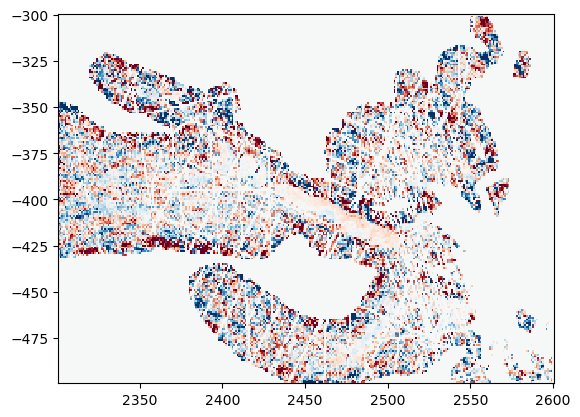

In [ ]:
topo1 = t['bed elevation'].isel(index=0).values
topo2 = t['bed elevation'].isel(index=1).values
plt.pcolormesh(xx/1000, yy/1000, topo1-topo2, cmap='RdBu',vmax =200,vmin=-200)

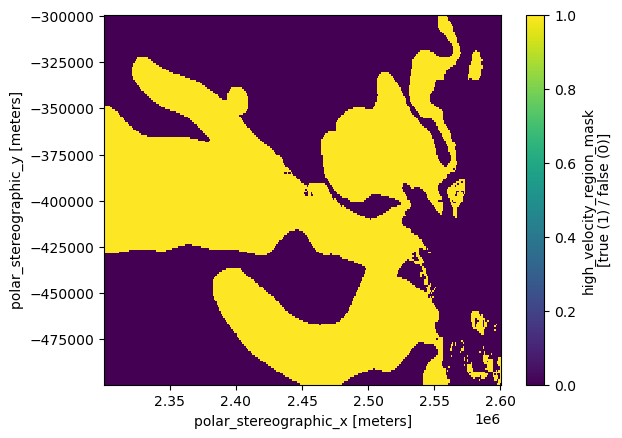

In [112]:
t['mask'].plot()

### Cross Section Plot

In [34]:
def plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, surf, bm_bed, cond_data, mc_region_mask_edge):
    
    SMALL_SIZE = 18
    MEDIUM_SIZE = 20
    
    distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
    num_pt = int(distance/1000)*2
    profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

    coords = np.array([xx.flatten(),yy.flatten()]).T
    pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T
    
    last_beds = last_beds_all.reshape((last_beds_all.shape[0]*last_beds_all.shape[1],last_beds_all.shape[2],last_beds_all.shape[3]))
    
    bed_profile_list = []
    for i in range(last_beds.shape[0]):
        bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
        bed_profile_list.append(bed_profile)
    surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
    bm_profile = sp.interpolate.griddata(coords, bm_bed.flatten(), pred_coords)
    
    #cond_data = df.bed.values.reshape(xx.shape)
    cond_data_mask = ~np.isnan(cond_data)

    profile_coords_x = profile_coords[0][0]
    profile_coords_y = profile_coords[0][1]
    radar_data_loc_x = []
    radar_data_loc_y = []
    radar_vals = []
    radar_dist_along_profile = []

    for i in range(profile_coords[0][0].shape[0]):
        x = profile_coords_x[i]
        y = profile_coords_y[i]
        x = np.round(x/1000)*1000
        y = np.round(y/1000)*1000

        x_index = np.where(xx == x)[1][0]
        y_index = np.where(yy == y)[0][0]
        if cond_data_mask[y_index,x_index]:
            radar_data_loc_x.append(x)
            radar_data_loc_y.append(y)
            radar_vals.append(cond_data[y_index,x_index])
            radar_dist_along_profile.append(profile_coords[1][i])

    unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
    radar_vals = np.array(radar_vals)[unique_index]
    radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
    radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
    radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]
    
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10,12),height_ratios=[1,1])

    f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap='magma',vmax=200)
    cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='vertical',location='right',pad=0.12,shrink=1,extend='both')
    cbar1.set_label(label='standard deviation (m)',size=MEDIUM_SIZE)
    ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
    ax1.scatter(profile_coords[0][0]/1000, profile_coords[0][1]/1000, s=0.5, c='white')
    ax1.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r')
    ax1.set_title('ensemble mean',fontsize=SMALL_SIZE)
    ax1.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
    ax1.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
    ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
    ax1.axis('scaled')

    mcmc_bed_colorlist = ['red','blue','cyan','magenta']
    for i in range(last_beds_all.shape[0]):
        color = mcmc_bed_colorlist[i]
        for j in range(last_beds_all.shape[1]):
            ax2.plot(profile_coords[1]/1000,bed_profile_list[i*last_beds_all.shape[1]+j],alpha=0.2,color=color,zorder=1)

    ax2.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.2,color='grey',zorder=1,label='McMC-sampled topography')
    ax2.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
    ax2.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
    ax2.scatter(radar_dist_along_profile/1000, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2)
    ax2.set_ylabel('bed elevation (m)',fontsize=SMALL_SIZE)
    ax2.set_xlabel('distance along profile (km)',fontsize=SMALL_SIZE)
    ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
    ax2.legend(fontsize=SMALL_SIZE,bbox_to_anchor=(1.1,0.8),loc='lower right')
    ax2.set_title('cross section',fontsize=SMALL_SIZE)

    plt.tight_layout()

    return profile_coords, [bed_profile_list, surf_profile, bm_profile], [radar_dist_along_profile, radar_vals, radar_data_loc_x, radar_data_loc_y], fig

In [35]:
def plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, surf, bm_bed, cond_data, mc_region_mask_edge, label=False):
    
    SMALL_SIZE = 11
    MEDIUM_SIZE = 12
    
    distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
    num_pt = int(distance/1000)*2
    profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

    coords = np.array([xx.flatten(),yy.flatten()]).T
    pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T
    
    last_beds = last_beds_all.reshape((last_beds_all.shape[0]*last_beds_all.shape[1],last_beds_all.shape[2],last_beds_all.shape[3]))
    
    bed_profile_list = []
    for i in range(last_beds.shape[0]):
        bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
        bed_profile_list.append(bed_profile)
    surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
    bm_profile = sp.interpolate.griddata(coords, bm_bed.flatten(), pred_coords)
    
    #cond_data = df.bed.values.reshape(xx.shape)
    cond_data_mask = ~np.isnan(cond_data)

    profile_coords_x = profile_coords[0][0]
    profile_coords_y = profile_coords[0][1]
    radar_data_loc_x = []
    radar_data_loc_y = []
    radar_vals = []
    radar_dist_along_profile = []

    for i in range(profile_coords[0][0].shape[0]):
        x = profile_coords_x[i]
        y = profile_coords_y[i]
        x = np.round(x/1000)*1000
        y = np.round(y/1000)*1000

        x_index = np.where(xx == x)[1][0]
        y_index = np.where(yy == y)[0][0]
        if cond_data_mask[y_index,x_index]:
            radar_data_loc_x.append(x)
            radar_data_loc_y.append(y)
            radar_vals.append(cond_data[y_index,x_index])
            radar_dist_along_profile.append(profile_coords[1][i])

    unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
    radar_vals = np.array(radar_vals)[unique_index]
    radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
    radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
    radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]
    
    mm = 1/25.4
    if label:
        fig = plt.figure(figsize=(179*mm, 150*mm))
        gs = fig.add_gridspec(2,2,width_ratios=[1,1],height_ratios=[1.2,1.2])
        ax1 = fig.add_subplot(gs[1, 0],anchor='N')
        ax2 = fig.add_subplot(gs[1, 1],anchor='N')
        ax3 = fig.add_subplot(gs[0, :],anchor='N')
    else:
        fig = plt.figure(figsize=(179*mm, 137*mm))
        gs = fig.add_gridspec(2,2,width_ratios=[1,1],height_ratios=[1.2,1])
        ax1 = fig.add_subplot(gs[1, 0],anchor='N')
        ax2 = fig.add_subplot(gs[1, 1],anchor='N')
        ax3 = fig.add_subplot(gs[0, :],anchor='N')

    f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=200)
    ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
    #ax1.scatter(profile_coords[0][0]/1000, profile_coords[0][1]/1000, s=0.5, c='white')
    ax1.plot((start_loc[0]/1000, end_loc[0]/1000), (start_loc[1]/1000,end_loc[1]/1000), c='white')
    ax1.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r',zorder=3)
    ax1.set_title('ensemble standard deviation',fontsize=SMALL_SIZE)
    #ax1.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
    #ax1.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
    ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
    ax1.axis('scaled')
    
    f_mean = ax2.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
    ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
    #ax2.scatter(profile_coords[0][0]/1000, profile_coords[0][1]/1000, s=0.5, c='white')
    ax2.plot((start_loc[0]/1000, end_loc[0]/1000), (start_loc[1]/1000,end_loc[1]/1000), c='white')
    ax2.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r',zorder=3)
    ax2.set_title('ensemble mean',fontsize=SMALL_SIZE)
    #ax2.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
    #ax2.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
    ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
    ax2.axis('scaled')
        
    crosssection_mean = np.mean(np.array(bed_profile_list),axis=0)
    ax3.fill_between(profile_coords[1]/1000, crosssection_mean, np.min(np.array(bed_profile_list)), color='burlywood', zorder=1)
    ax3.fill_between(profile_coords[1]/1000, surf_profile, crosssection_mean, color='lightblue')

    mcmc_bed_colorlist = ['red','blue','cyan','magenta']
    for i in range(last_beds_all.shape[0]):
        color = mcmc_bed_colorlist[i]
        for j in range(last_beds_all.shape[1]):
            ax3.plot(profile_coords[1]/1000,bed_profile_list[i*last_beds_all.shape[1]+j],alpha=0.4,lw=0.25,color='black',zorder=2)
            
    ax3.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.4,color='black',zorder=2,lw=0.25,label='McMC-sampled topography ensemble')
    ax3.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
    ax3.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
    ax3.scatter(radar_dist_along_profile/1000, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2,label='radar measurement locations')
    ax3.set_ylabel('bed elevation (m)',fontsize=SMALL_SIZE)
    ax3.set_xlabel('distance along profile (km)',fontsize=SMALL_SIZE)
    ax3.tick_params(axis='both', labelsize=SMALL_SIZE)
    #ax3.legend(fontsize=SMALL_SIZE,bbox_to_anchor=(0.02,0.02),loc='lower left')
    ax3.set_title('cross section',fontsize=SMALL_SIZE)
    
    #make label
    if label:
        cbar1 = plt.colorbar(f_std,ax=ax1,aspect=20,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
        cbar1.set_label(label='standard deviation (m)',size=SMALL_SIZE)
        cbar2 = plt.colorbar(f_mean,ax=ax2,aspect=20,orientation='horizontal',location='bottom',pad=0.12,shrink=0.7,extend='both')
        cbar2.set_label(label='bed elevation (m)',size=SMALL_SIZE)
        ax3.legend(fontsize=SMALL_SIZE,bbox_to_anchor=(0.98,0.98),loc='upper right',framealpha=1)

    plt.tight_layout(pad=0.05,h_pad=0, w_pad=0)

    return profile_coords, [bed_profile_list, surf_profile, bm_profile], [radar_dist_along_profile, radar_vals, radar_data_loc_x, radar_data_loc_y], fig

In [36]:
def plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, surf, bm_bed, cond_data, mc_region_mask_edge, label=False):
    
    SMALL_SIZE = 9
    MEDIUM_SIZE = 10
    
    distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
    num_pt = int(distance/1000)*2
    profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

    coords = np.array([xx.flatten(),yy.flatten()]).T
    pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T
    
    last_beds = last_beds_all.reshape((last_beds_all.shape[0]*last_beds_all.shape[1],last_beds_all.shape[2],last_beds_all.shape[3]))
    
    bed_profile_list = []
    for i in range(last_beds.shape[0]):
        bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
        bed_profile_list.append(bed_profile)
    surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
    bm_profile = sp.interpolate.griddata(coords, bm_bed.flatten(), pred_coords)
    
    #cond_data = df.bed.values.reshape(xx.shape)
    cond_data_mask = ~np.isnan(cond_data)

    profile_coords_x = profile_coords[0][0]
    profile_coords_y = profile_coords[0][1]
    radar_data_loc_x = []
    radar_data_loc_y = []
    radar_vals = []
    radar_dist_along_profile = []

    for i in range(profile_coords[0][0].shape[0]):
        x = profile_coords_x[i]
        y = profile_coords_y[i]
        x = np.round(x/1000)*1000
        y = np.round(y/1000)*1000

        x_index = np.where(xx == x)[1][0]
        y_index = np.where(yy == y)[0][0]
        if cond_data_mask[y_index,x_index]:
            radar_data_loc_x.append(x)
            radar_data_loc_y.append(y)
            radar_vals.append(cond_data[y_index,x_index])
            radar_dist_along_profile.append(profile_coords[1][i])

    unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
    radar_vals = np.array(radar_vals)[unique_index]
    radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
    radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
    radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]
    
    mm = 1/25.4

    fig = plt.figure(figsize=(180*mm, 55*mm))
    gs = fig.add_gridspec(1,2,width_ratios=[2,1])
    ax1 = fig.add_subplot(gs[0, 0],anchor='N')
    ax2 = fig.add_subplot(gs[0, 1],anchor='N')

    f_mean = ax2.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
    ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
    ax2.plot((start_loc[0]/1000, end_loc[0]/1000), (start_loc[1]/1000,end_loc[1]/1000), c='white')
    ax2.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r',zorder=3)
    #ax2.set_title('ensemble mean',fontsize=MEDIUM_SIZE)
    ax2.set_xticks([2400,2500,2600])
    ax2.set_xticklabels([])
    ax2.set_yticks([-300,-350,-400,-450])
    ax2.set_yticklabels([])
    #ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
    ax2.axis('scaled')
        
    crosssection_mean = np.mean(np.array(bed_profile_list),axis=0)
    ax1.fill_between(profile_coords[1]/1000, crosssection_mean, np.min(np.array(bed_profile_list)), color='burlywood', zorder=1)
    ax1.fill_between(profile_coords[1]/1000, surf_profile, crosssection_mean, color='lightblue')

    mcmc_bed_colorlist = ['red','blue','cyan','magenta']
    for i in range(last_beds_all.shape[0]):
        color = mcmc_bed_colorlist[i]
        for j in range(last_beds_all.shape[1]):
            ax1.plot(profile_coords[1]/1000,bed_profile_list[i*last_beds_all.shape[1]+j],alpha=0.5,lw=0.15,color='black',zorder=2)
            
    ax1.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.5,color='black',zorder=2,lw=0.15,label='MCMC-generated ensemble')
    ax1.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
    ax1.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
    ax1.scatter(radar_dist_along_profile/1000, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2,label='radar measurements')
    ax1.set_ylabel('Bed elevation (m)',fontsize=SMALL_SIZE)
    ax1.set_xlabel('Distance along profile (km)',fontsize=SMALL_SIZE)
    ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
    #ax1.set_title('cross section',fontsize=MEDIUM_SIZE)
    
    #make label
    if label:
        ax1.legend(fontsize=MEDIUM_SIZE,bbox_to_anchor=(0.05,0.98),loc='upper left',framealpha=0.7)
    
    plt.tight_layout(pad=0.05,h_pad=0, w_pad=0.4)

    return profile_coords, [bed_profile_list, surf_profile, bm_profile], [radar_dist_along_profile, radar_vals, radar_data_loc_x, radar_data_loc_y], fig

In [42]:
fil = [[-1,-1,-1],
       [-1, 8,-1],
       [-1,-1,-1]]
mc_region_mask_edge = sp.ndimage.convolve(mc_region_mask, fil, mode='constant') > 0
mc_region_mask_edge = np.where(mc_region_mask_edge,1,np.nan)

In [43]:
cmap = plt.get_cmap('magma')
new_cmap = matplotlib.colors.LinearSegmentedColormap.from_list('magma',cmap(np.linspace(0.3, 1, 256)))

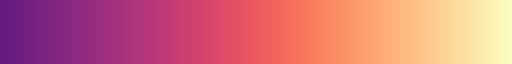

In [44]:
new_cmap

In [45]:
N = 128
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(1/256, 1, N)
vals1[:, 1] = np.linspace(133/256, 1, N)
vals1[:, 2] = np.linspace(113/256, 1, N)

vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(1,166/256, N)
vals2[:, 1] = np.linspace(1,97/256, N)
vals2[:, 2] = np.linspace(1,26/256, N)

cmp_gnbr = ListedColormap(np.vstack([vals1,vals2]))

In [46]:
SMALL_SIZE = 9
MEDIUM_SIZE = 10

In [47]:
list_start_x = [2430000, 2340000, 2510000, 2301000, 2430000]
list_start_y = [-395000, -325000, -415000, -405000, -408000]
list_end_x = [2510000, 2430000, 2530000, 2350000, 2510000]
list_end_y = [-425000, -387000, -402000, -410000, -432000]

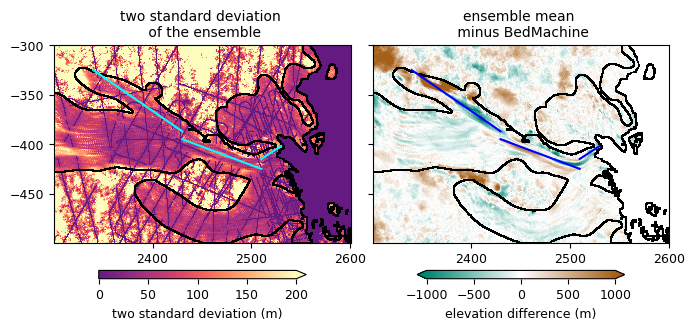

In [57]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 85*mm))

gs = fig.add_gridspec(1,2,width_ratios=[1,1])
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])

#############################ax1###################################

f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=200)
cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='max')
cbar1.set_label(label='two standard deviation (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE) 
ax1.set_title('two standard deviation \n of the ensemble',fontsize=MEDIUM_SIZE)
ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax1.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='aqua', lw=1.5)

ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.set_xticks([2400,2500,2600])
ax1.set_yticks([-300,-350,-400,-450])
ax1.axis('scaled')

#############################ax2###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_diff = ax2.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)) - bm_bed,cmap=cmp_gnbr,vmax=1000,vmin=-1000)
cbar2 = plt.colorbar(f_diff, ax = ax2,aspect=25,orientation='horizontal',location='bottom', pad=0.06,shrink=0.7,extend='both')
cbar2.set_label(label='elevation difference (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
ax2.set_title('ensemble mean \n minus BedMachine',fontsize=MEDIUM_SIZE)
ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax2.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='blue', lw=1.5)

ax2.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.set_xticks([2400,2500,2600])
ax2.set_yticks([-300,-350,-400,-450])
ax2.set_yticklabels([])
ax2.axis('scaled')

plt.tight_layout(w_pad=0.1,h_pad=0.5)
plt.savefig('crosssection_sum.png',bbox_inches='tight',dpi=300)

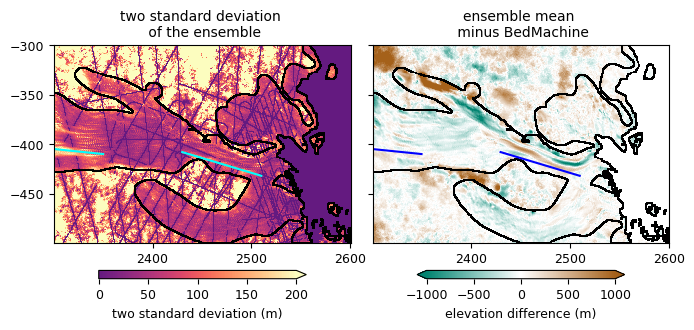

In [56]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 85*mm))

gs = fig.add_gridspec(1,2,width_ratios=[1,1])
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])

#############################ax1###################################

f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=200)
cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='max')
cbar1.set_label(label='two standard deviation (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE) 
ax1.set_title('two standard deviation \n of the ensemble',fontsize=MEDIUM_SIZE)
ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3,5,1):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax1.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='aqua', lw=1.5)

ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.set_xticks([2400,2500,2600])
ax1.set_yticks([-300,-350,-400,-450])
ax1.axis('scaled')

#############################ax2###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_diff = ax2.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)) - bm_bed,cmap=cmp_gnbr,vmax=1000,vmin=-1000)
cbar2 = plt.colorbar(f_diff, ax = ax2,aspect=25,orientation='horizontal',location='bottom', pad=0.06,shrink=0.7,extend='both')
cbar2.set_label(label='elevation difference (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
ax2.set_title('ensemble mean \n minus BedMachine',fontsize=MEDIUM_SIZE)
ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3,5,1):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax2.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='blue', lw=1.5)

ax2.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.set_xticks([2400,2500,2600])
ax2.set_yticks([-300,-350,-400,-450])
ax2.set_yticklabels([])
ax2.axis('scaled')

plt.tight_layout(w_pad=0.1,h_pad=0.5)
plt.savefig('crosssection_sum.png',bbox_inches='tight',dpi=300)

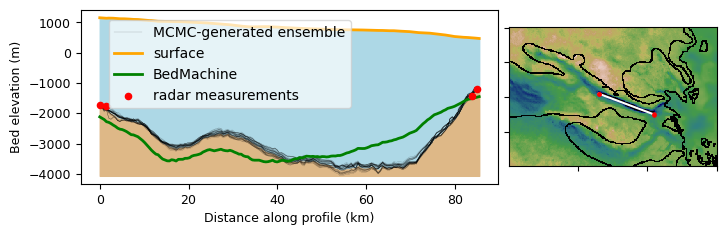

In [61]:
start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge,label=True)
fig.savefig('crosssection1.png',dpi=300,bbox_inches='tight')

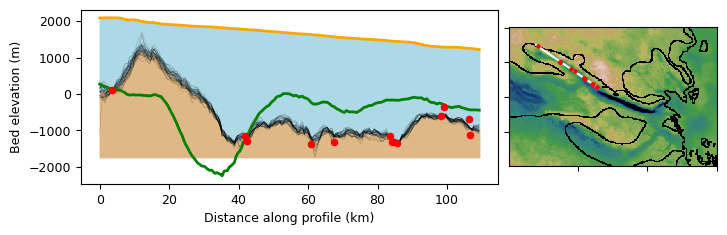

In [62]:
start_loc = (2340000,-325000)
end_loc = (2430000,-387000)
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection2.png',dpi=300,bbox_inches='tight')

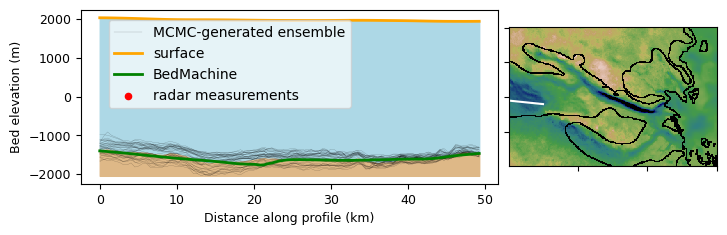

In [63]:
start_loc = [2301000,-405000]
end_loc = [2350000,-410000]
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge, label=True)
fig.savefig('crosssection3.png',dpi=300,bbox_inches='tight')

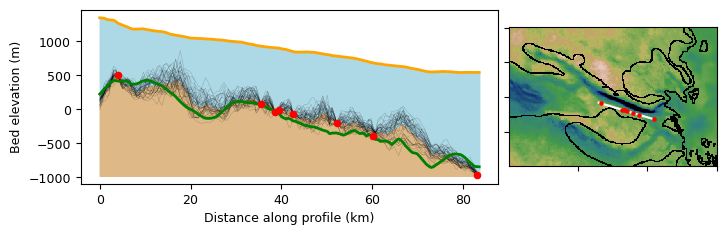

In [64]:
start_loc = [2430000,-408000]
end_loc = [2510000,-432000]
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection4.png',dpi=300,bbox_inches='tight')

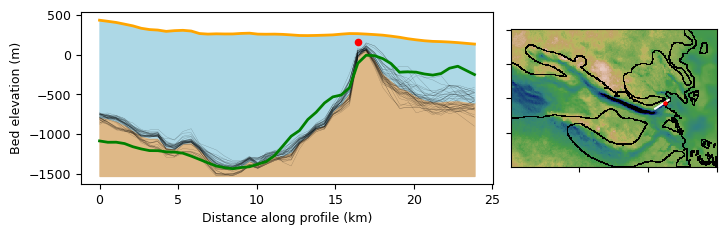

In [65]:
start_loc = [2510000,-415000]
end_loc = [2530000,-402000]
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection5.png',dpi=300,bbox_inches='tight')

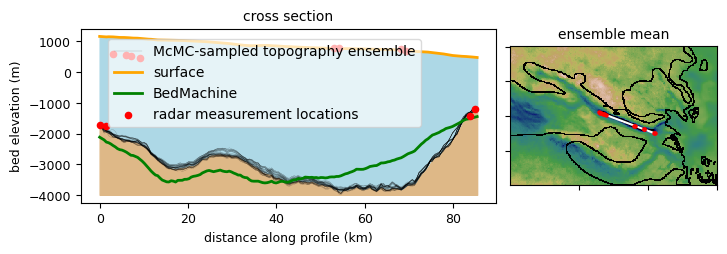

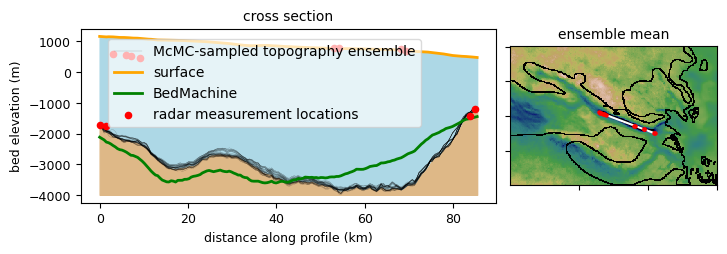

In [140]:
start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df_up.bed.values.reshape(xx.shape), mc_region_mask_edge,label=True)

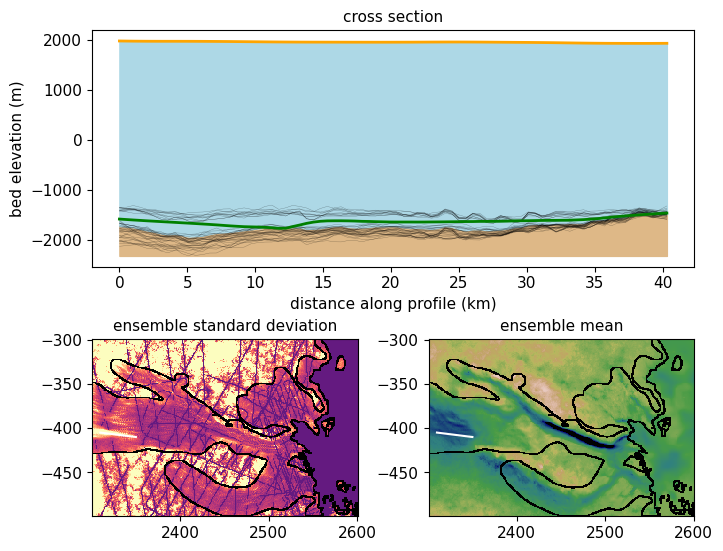

In [31]:
start_loc = [2301000,-405000]
end_loc = [2350000,-410000]
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
#fig.savefig('crosssection1.png',dpi=600,bbox_inches='tight')

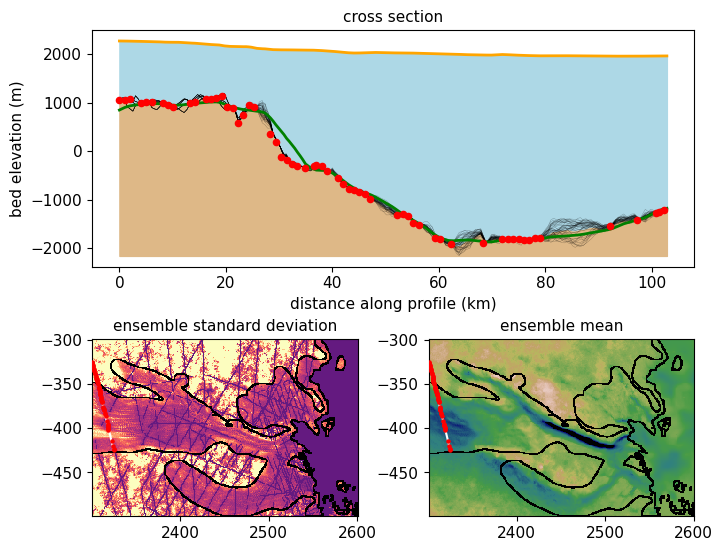

In [55]:
start_loc = [2301000,-325000]
end_loc = [2325000,-425000]
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
#fig.savefig('crosssection1.png',dpi=600,bbox_inches='tight')

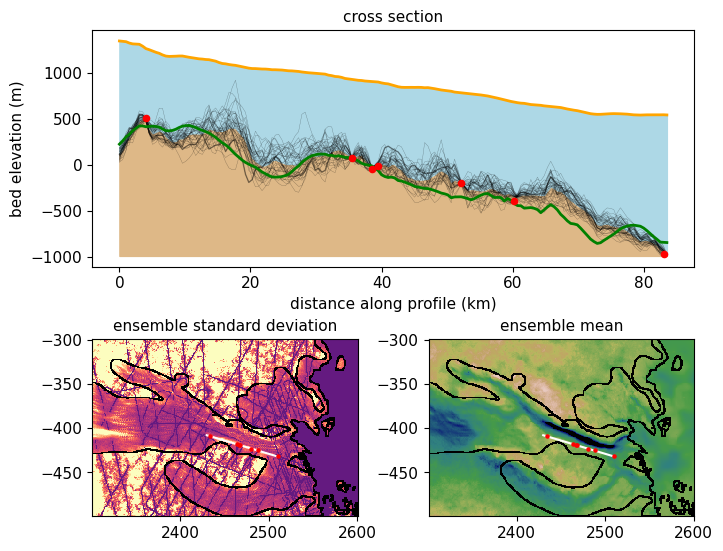

In [41]:
start_loc = [2430000,-408000]
end_loc = [2510000,-432000]
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
#fig.savefig('crosssection1.png',dpi=600,bbox_inches='tight')

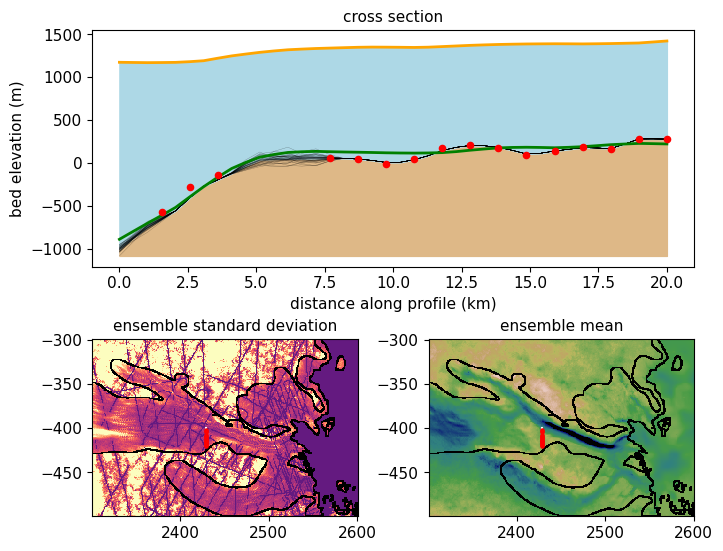

In [51]:
start_loc = [2429000,-400000]
end_loc = [2429000,-420000]
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
#fig.savefig('crosssection1.png',dpi=600,bbox_inches='tight')

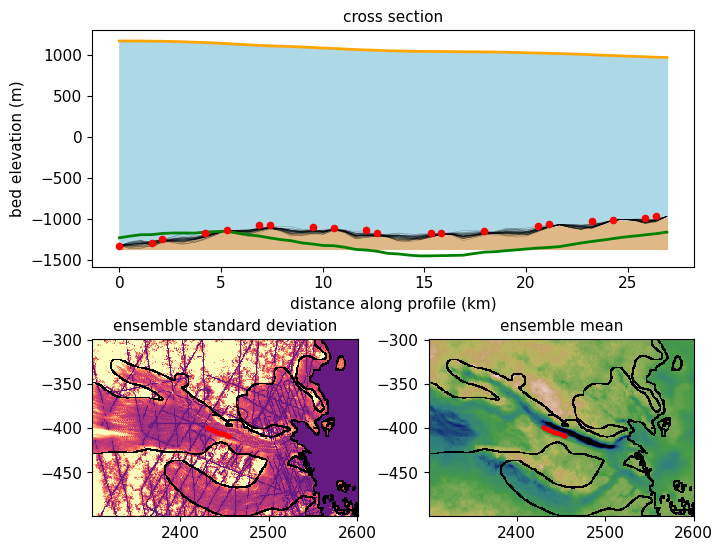

In [53]:
start_loc = [2430000,-399000]
end_loc = [2455000,-409000]
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
#fig.savefig('crosssection1.png',dpi=600,bbox_inches='tight')

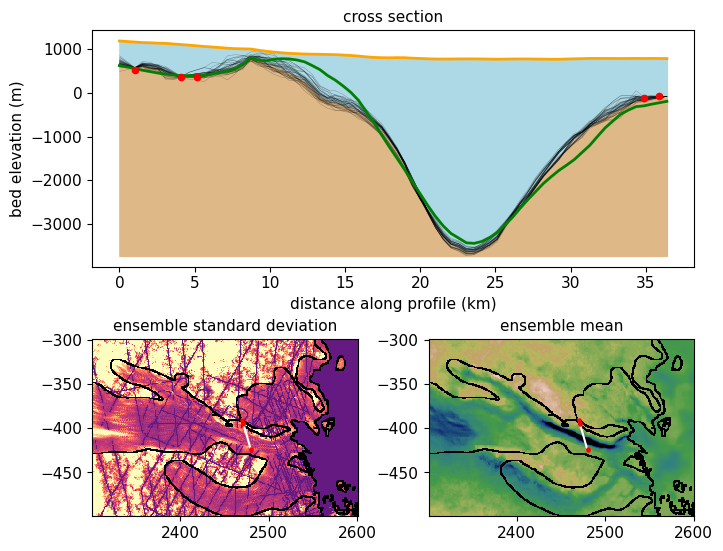

In [125]:
start_loc = [2470000,-390000]
end_loc = [2480000,-425000]
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection1.png',dpi=600,bbox_inches='tight')

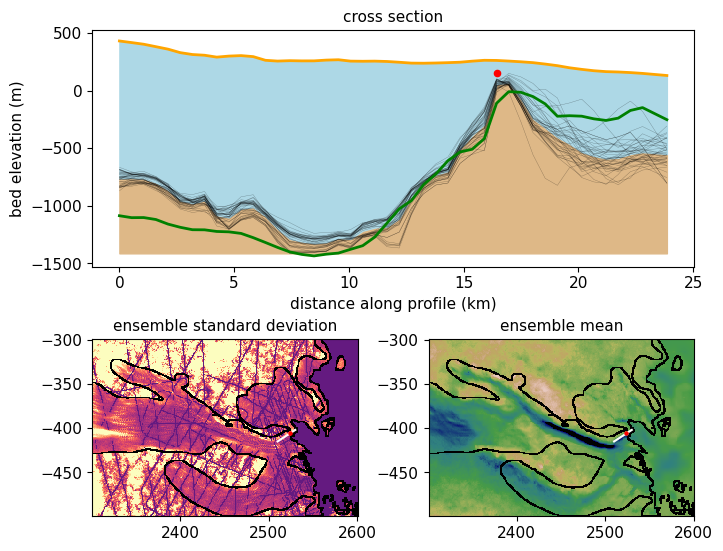

In [66]:
start_loc = [2510000,-415000]
end_loc = [2530000,-402000]
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
#fig.savefig('crosssection1.png',dpi=600,bbox_inches='tight')

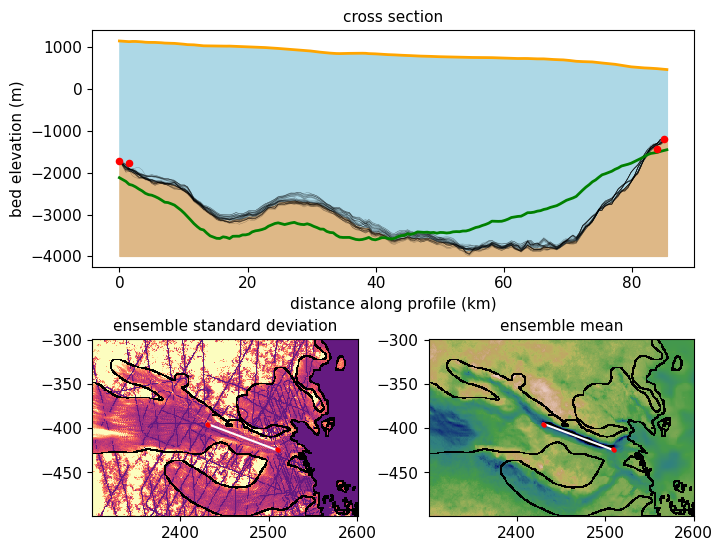

In [192]:
start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection2.png',dpi=600,bbox_inches='tight')

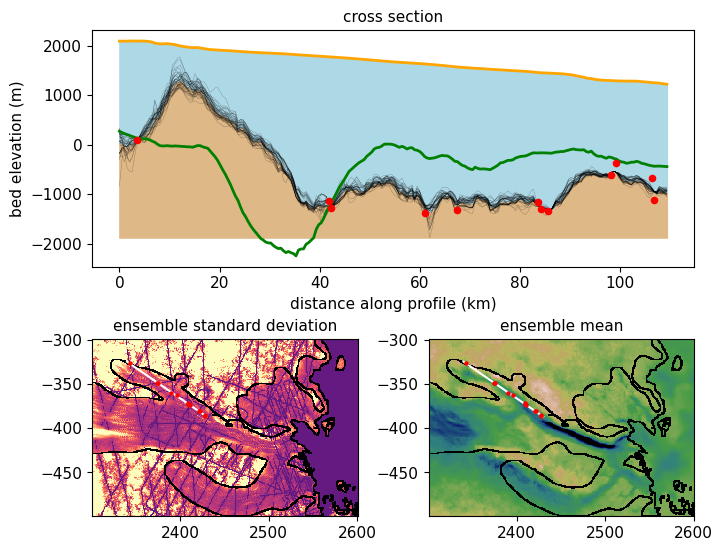

In [126]:
start_loc = (2340000,-325000)
end_loc = (2430000,-387000)
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection3.png',dpi=600,bbox_inches='tight')

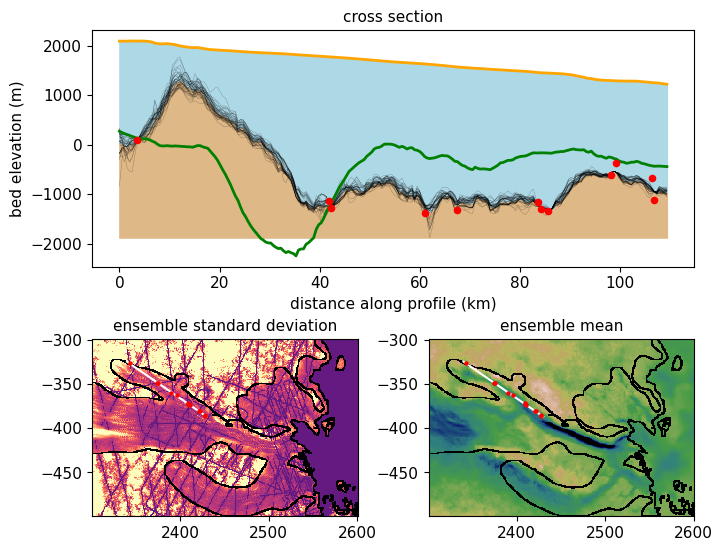

In [204]:
start_loc = (2340000,-325000)
end_loc = (2430000,-387000)
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection3.png',dpi=600,bbox_inches='tight')

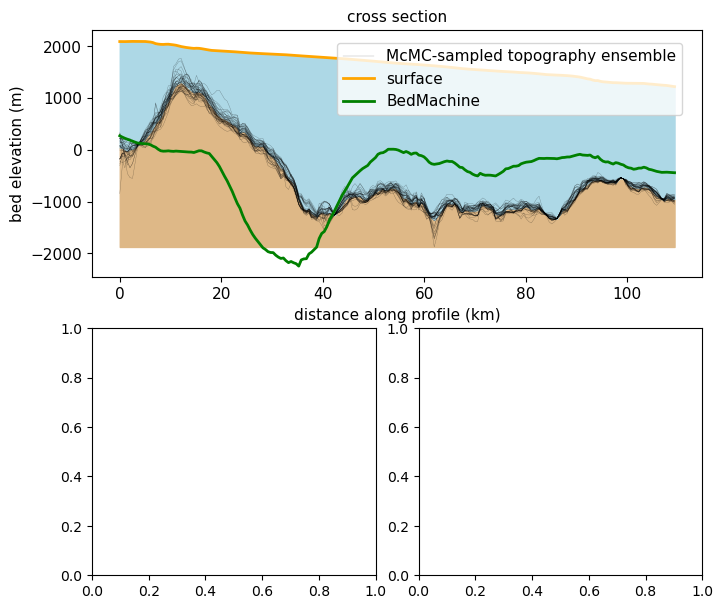

In [206]:
start_loc = (2340000,-325000)
end_loc = (2430000,-387000)

bm_bed = df_bm.bed.values.reshape(xx.shape)


SMALL_SIZE = 11
MEDIUM_SIZE = 12

distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

last_beds = last_beds_all.reshape((last_beds_all.shape[0]*last_beds_all.shape[1],last_beds_all.shape[2],last_beds_all.shape[3]))

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, bm_bed.flatten(), pred_coords)

#cond_data = df.bed.values.reshape(xx.shape)
#cond_data_mask = ~np.isnan(cond_data)

profile_coords_x = profile_coords[0][0]
profile_coords_y = profile_coords[0][1]


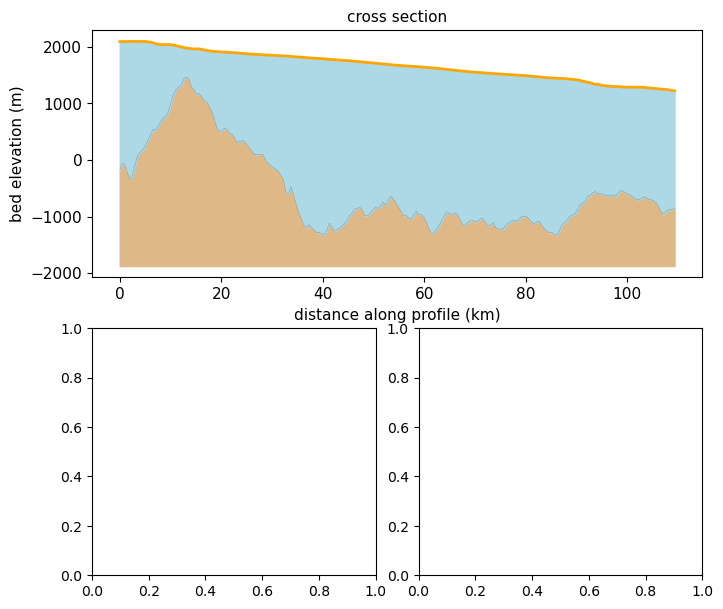

In [209]:
mm = 1/25.4

fig = plt.figure(figsize=(179*mm, 150*mm))
gs = fig.add_gridspec(2,2,width_ratios=[1,1],height_ratios=[1.2,1.2])
ax1 = fig.add_subplot(gs[1, 0],anchor='N')
ax2 = fig.add_subplot(gs[1, 1],anchor='N')
ax3 = fig.add_subplot(gs[0, :],anchor='N')

ax3.fill_between(profile_coords[1]/1000, bed_profile_list[0], np.min(np.array(bed_profile_list)), color='burlywood', zorder=1)
ax3.fill_between(profile_coords[1]/1000, surf_profile, bed_profile_list[0], color='lightblue')

# mcmc_bed_colorlist = ['red','blue','cyan','magenta']
# for i in range(last_beds_all.shape[0]):
#     color = mcmc_bed_colorlist[i]
#     for j in range(last_beds_all.shape[1]):
#         ax3.plot(profile_coords[1]/1000,bed_profile_list[i*last_beds_all.shape[1]+j],alpha=0.4,lw=0.25,color='black',zorder=2)

ax3.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.4,color='black',zorder=2,lw=0.25,label='McMC-sampled topography ensemble')
ax3.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
#ax3.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
ax3.set_ylabel('bed elevation (m)',fontsize=SMALL_SIZE)
ax3.set_xlabel('distance along profile (km)',fontsize=SMALL_SIZE)
ax3.tick_params(axis='both', labelsize=SMALL_SIZE)
ax3.set_title('cross section',fontsize=SMALL_SIZE)

#ax3.legend(fontsize=SMALL_SIZE,bbox_to_anchor=(0.98,0.98),loc='upper right')

plt.tight_layout(pad=0.05,h_pad=0, w_pad=0)
fig.savefig('flashfreeze_examplebed.png',dpi=600,bbox_inches='tight')

In [60]:
(2400000 - 2555000)/(-385000 + 430000)

-3.4444444444444446

In [62]:
(420000 - 430000) * -3.444444

34444.439999999995

In [ ]:
incond = np.where(df['mask'].values.reshape(xx.shape),df.bed.values.reshape(xx.shape),np.nan)

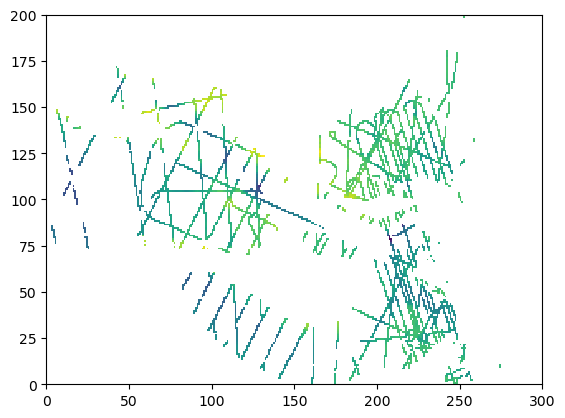

In [72]:
plt.pcolormesh(incond)

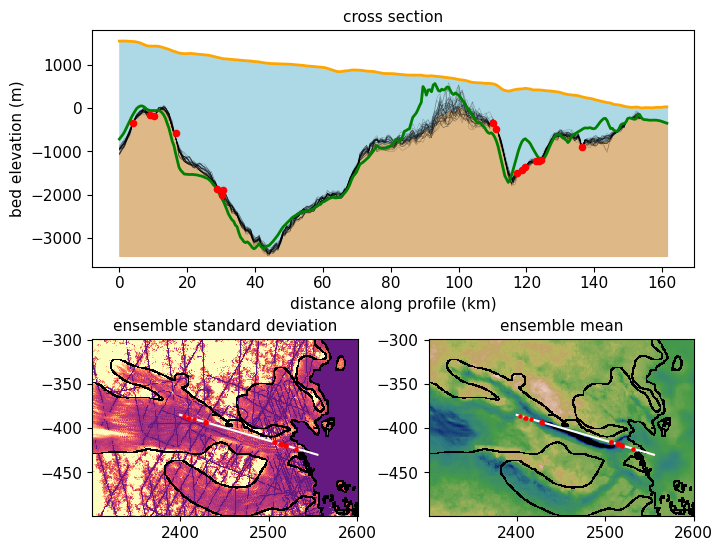

In [73]:
start_loc = (2400000,-385000)
end_loc = (2555000,-430000)
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), incond, mc_region_mask_edge,
            label = False)
fig.savefig('crosssection4.png',dpi=600,bbox_inches='tight')

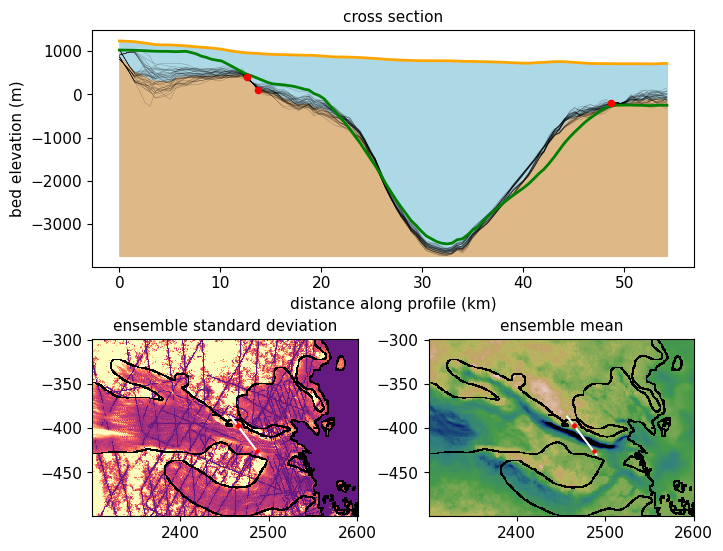

In [66]:
start_loc = (2457000,-390000)
end_loc = (2490000,-430000)
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge,
            label = False)
fig.savefig('crosssection4.png',dpi=600,bbox_inches='tight')

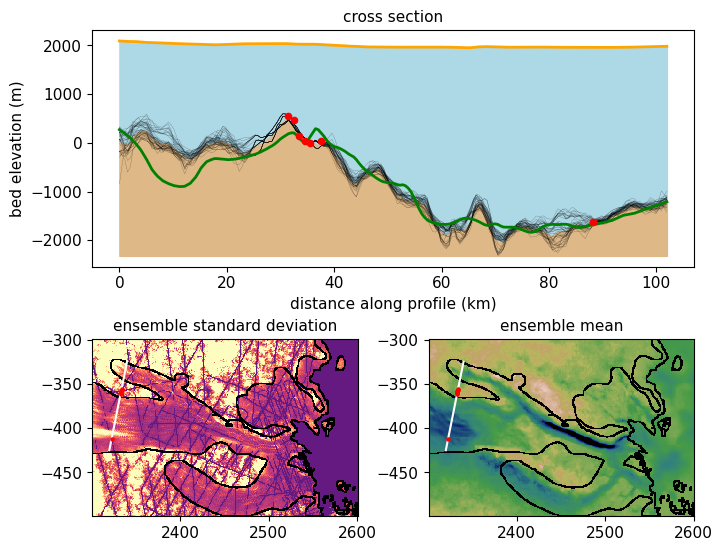

In [195]:
start_loc = (2340000,-325000)
end_loc = (2320000,-425000)
profile_coords, profile_list, radar_list, fig = plot_crosssection(start_loc, end_loc, xx, yy, last_beds_all, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection5.png',dpi=600,bbox_inches='tight')

In [143]:
start_loc = (2470000,-390000)
end_loc = (2480000,-425000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

In [144]:
start_loc = (2470000,-390000)
end_loc = (2480000,-425000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

NameError: name 'bed' is not defined

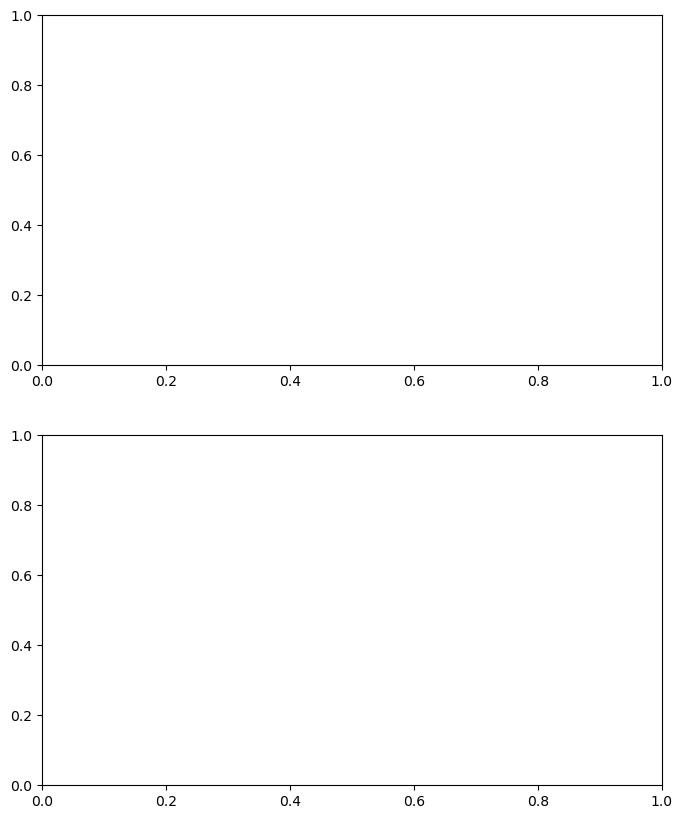

In [145]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8,10))
f_bed = ax1.pcolormesh(xx, yy, bed,cmap='gist_earth',vmax=2000,vmin=-2500)
ax1.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.3)
ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
ax1.set_xlabel('X [km]')
ax1.set_ylabel('Y [km]')
ax1.set_title('topography mean')
ax1.axis('scaled')

for i in range(last_beds.shape[0]):
    ax2.plot(profile_coords[1],bed_profile_list[i],alpha=0.3)
ax2.plot(profile_coords[1],surf_profile,color='orange',label='surface')
ax2.plot(profile_coords[1],bm_profile,color='green',label='BedMachine')
ax2.legend()
ax2.set_title('cross section')

plt.show()

In [ ]:
start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8,10))
f_bed = ax1.pcolormesh(xx, yy, bed,cmap='gist_earth',vmax=2000,vmin=-2500)
ax1.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.3)
ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
ax1.set_xlabel('X [km]')
ax1.set_ylabel('Y [km]')
ax1.set_title('topography mean')
ax1.axis('scaled')

for i in range(last_beds.shape[0]):
    ax2.plot(profile_coords[1],bed_profile_list[i],alpha=0.3)
ax2.plot(profile_coords[1],surf_profile,color='orange',label='surface')
ax2.plot(profile_coords[1],bm_profile,color='green',label='BedMachine')
ax2.legend()
ax2.set_title('cross section')

plt.show()

In [59]:
start_loc = (2400000,-385000)
end_loc = (2555000,-430000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

In [60]:
cond_data = df.bed.values.reshape(xx.shape)
bedmachine_mask = df.bedmachine_mask.values.reshape(xx.shape)
cond_data_mask = (~np.isnan(cond_data))&(bedmachine_mask==2)

profile_coords_x = profile_coords[0][0]
profile_coords_y = profile_coords[0][1]
radar_data_loc_x = []
radar_data_loc_y = []
radar_vals = []
radar_dist_along_profile = []

for i in range(profile_coords[0][0].shape[0]):
    x = profile_coords_x[i]
    y = profile_coords_y[i]
    x = np.round(x/1000)*1000
    y = np.round(y/1000)*1000

    x_index = np.where(xx == x)[1][0]
    y_index = np.where(yy == y)[0][0]
    if cond_data_mask[y_index,x_index]:
        radar_data_loc_x.append(x)
        radar_data_loc_y.append(y)
        radar_vals.append(cond_data[y_index,x_index])
        radar_dist_along_profile.append(profile_coords[1][i])
        
unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
radar_vals = np.array(radar_vals)[unique_index]
radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]

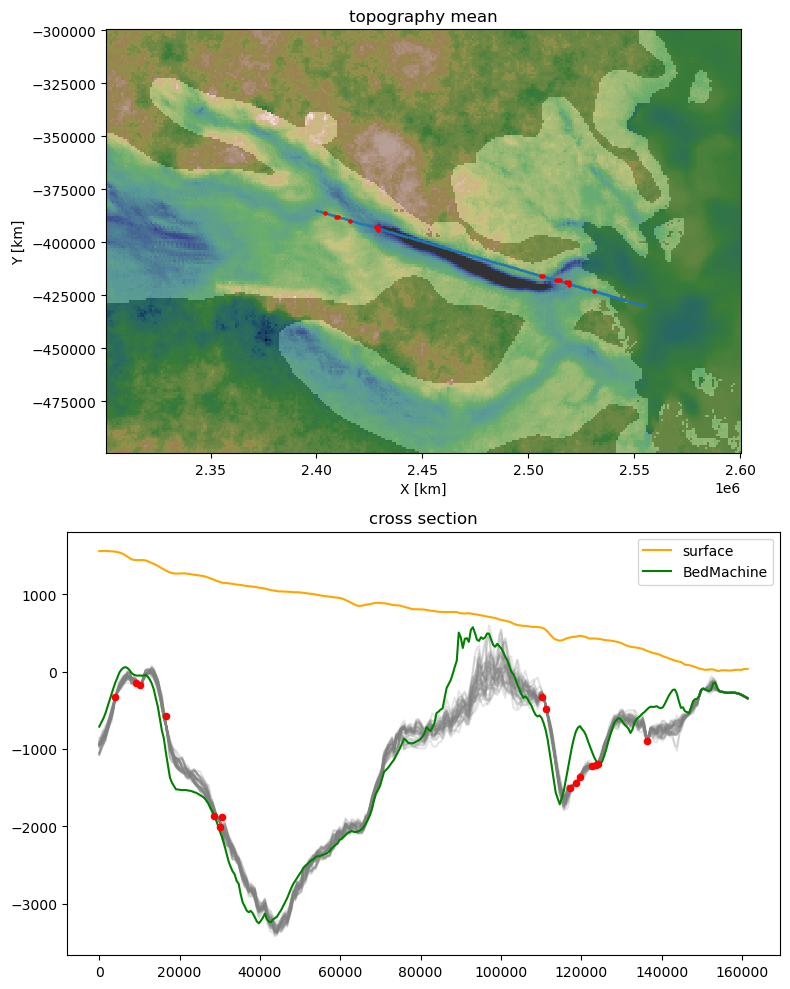

In [61]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8,10))
f_bed = ax1.pcolormesh(xx, yy, mcmc_bed,cmap='gist_earth',vmax=2000,vmin=-2500)
ax1.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.2)
ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
ax1.scatter(radar_data_loc_x, radar_data_loc_y, s=5,c='r')
#plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
ax1.set_xlabel('X [km]')
ax1.set_ylabel('Y [km]')
ax1.set_title('topography mean')
ax1.axis('scaled')

for i in range(last_beds.shape[0]):
    ax2.plot(profile_coords[1],bed_profile_list[i],alpha=0.2,color='grey',zorder=1)
ax2.plot(profile_coords[1],surf_profile,color='orange',label='surface')
ax2.plot(profile_coords[1],bm_profile,color='green',label='BedMachine')
ax2.scatter(radar_dist_along_profile, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2)
ax2.legend()
ax2.set_title('cross section')

plt.tight_layout()

plt.show()

In [62]:
cmap = plt.get_cmap('magma')
new_cmap = matplotlib.colors.LinearSegmentedColormap.from_list('magma',cmap(np.linspace(0.3, 1, 256)))

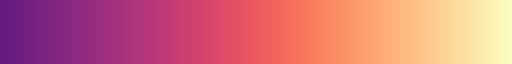

In [63]:
new_cmap

In [64]:
SMALL_SIZE = 20
MEDIUM_SIZE = 24

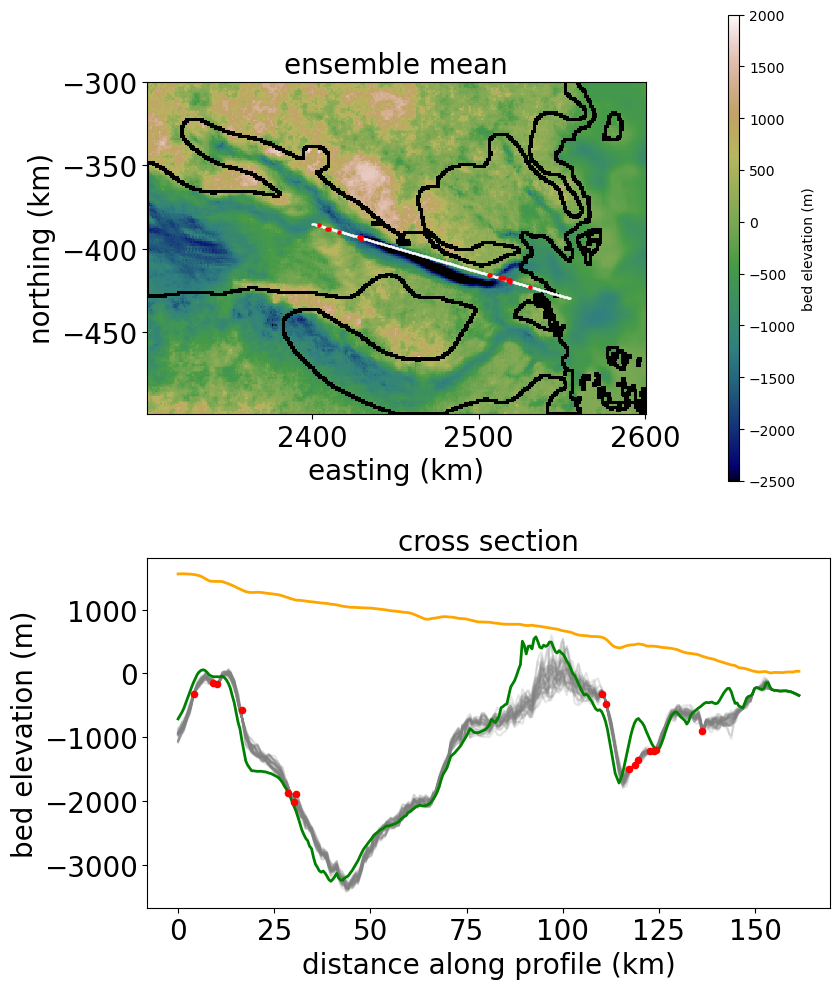

In [65]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8.5,10),height_ratios=[1,0.75])
f_bed = ax1.pcolormesh(xx/1000, yy/1000, mcmc_bed,cmap='gist_earth',vmax=2000,vmin=-2500)
# ax1.pcolormesh(xx/1000, yy/1000, mc_region_mask,cmap='grey',alpha=0.2)
# ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
# ax1.scatter(radar_data_loc_x, radar_data_loc_y, s=5,c='r')
cbar1 = plt.colorbar(f_bed,ax=ax1,pad=0.12, aspect=40, label='bed elevation (m)')
# ax1.set_xlabel('X [km]')
# ax1.set_ylabel('Y [km]')
# ax1.set_title('topography mean')
# ax1.axis('scaled')

#f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=400)
#cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='vertical',location='right',pad=0.12,shrink=1,extend='both')
#cbar1.set_label(label='standard deviation (m)',size=MEDIUM_SIZE)
#cbar1.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE) 
ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
ax1.scatter(profile_coords[0][0]/1000, profile_coords[0][1]/1000, s=0.5, c='white')
ax1.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r')
ax1.set_title('ensemble mean',fontsize=SMALL_SIZE)
ax1.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
ax1.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
ax1.axis('scaled')

for i in range(1,last_beds.shape[0]):
    ax2.plot(profile_coords[1]/1000,bed_profile_list[i],alpha=0.2,color='grey',zorder=1)
ax2.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.2,color='grey',zorder=1,label='McMC-sampled \n topography')
ax2.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
ax2.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
ax2.scatter(radar_dist_along_profile/1000, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2,label='Conditioning Data')
ax2.set_ylabel('bed elevation (m)',fontsize=SMALL_SIZE)
ax2.set_xlabel('distance along profile (km)',fontsize=SMALL_SIZE)
ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
#ax2.legend(fontsize=SMALL_SIZE,bbox_to_anchor=(2,1.8),loc='lower right')
ax2.set_title('cross section',fontsize=SMALL_SIZE)

plt.tight_layout()

plt.show()

In [66]:
start_loc = (2340000,-325000)
end_loc = (2320000,-425000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

In [67]:
cond_data = df.bed.values.reshape(xx.shape)
cond_data_mask = ~np.isnan(cond_data)

profile_coords_x = profile_coords[0][0]
profile_coords_y = profile_coords[0][1]
radar_data_loc_x = []
radar_data_loc_y = []
radar_vals = []
radar_dist_along_profile = []

for i in range(profile_coords[0][0].shape[0]):
    x = profile_coords_x[i]
    y = profile_coords_y[i]
    x = np.round(x/1000)*1000
    y = np.round(y/1000)*1000

    x_index = np.where(xx == x)[1][0]
    y_index = np.where(yy == y)[0][0]
    if cond_data_mask[y_index,x_index]:
        radar_data_loc_x.append(x)
        radar_data_loc_y.append(y)
        radar_vals.append(cond_data[y_index,x_index])
        radar_dist_along_profile.append(profile_coords[1][i])
        
unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
radar_vals = np.array(radar_vals)[unique_index]
radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]

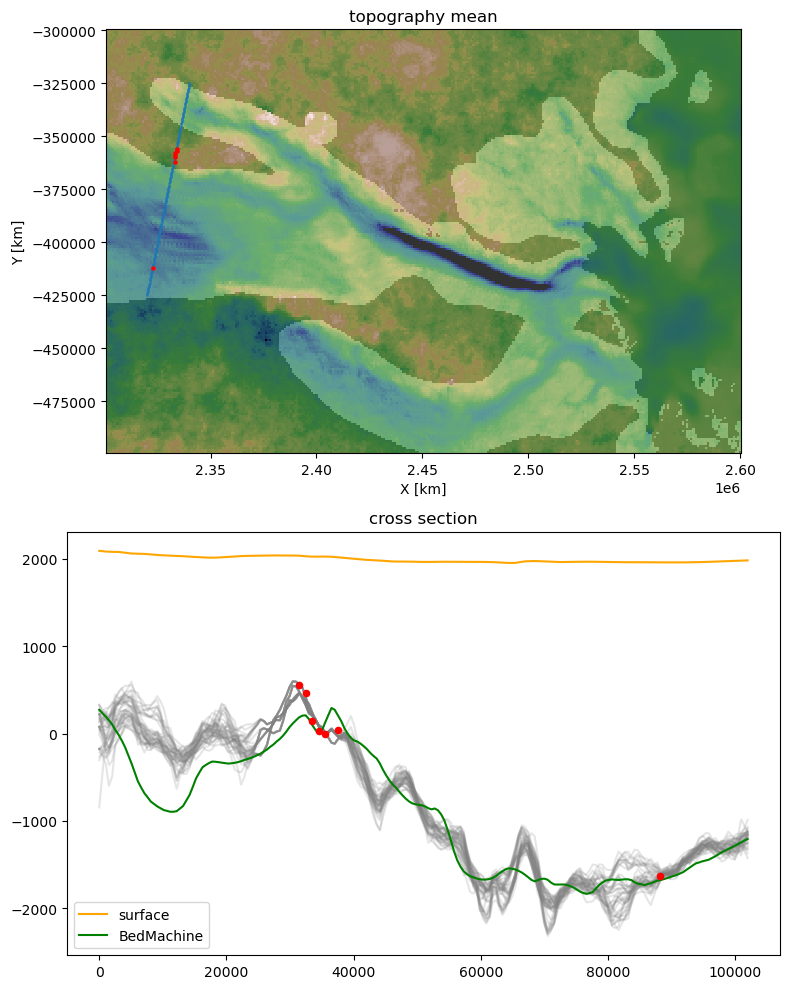

In [68]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8,10))
f_bed = ax1.pcolormesh(xx, yy, mcmc_bed,cmap='gist_earth',vmax=2000,vmin=-2500)
ax1.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.2)
ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
ax1.scatter(radar_data_loc_x, radar_data_loc_y, s=5,c='r')
#plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
ax1.set_xlabel('X [km]')
ax1.set_ylabel('Y [km]')
ax1.set_title('topography mean')
ax1.axis('scaled')

for i in range(last_beds.shape[0]):
    ax2.plot(profile_coords[1],bed_profile_list[i],alpha=0.2,color='grey',zorder=1)
ax2.plot(profile_coords[1],surf_profile,color='orange',label='surface')
ax2.plot(profile_coords[1],bm_profile,color='green',label='BedMachine')
ax2.scatter(radar_dist_along_profile, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2)
ax2.legend()
ax2.set_title('cross section')

plt.tight_layout()

plt.show()

In [69]:
start_loc = (2340000,-325000)
end_loc = (2430000,-387000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

In [70]:
cond_data = df.bed.values.reshape(xx.shape)
cond_data_mask = ~np.isnan(cond_data)

profile_coords_x = profile_coords[0][0]
profile_coords_y = profile_coords[0][1]
radar_data_loc_x = []
radar_data_loc_y = []
radar_vals = []
radar_dist_along_profile = []

for i in range(profile_coords[0][0].shape[0]):
    x = profile_coords_x[i]
    y = profile_coords_y[i]
    x = np.round(x/1000)*1000
    y = np.round(y/1000)*1000

    x_index = np.where(xx == x)[1][0]
    y_index = np.where(yy == y)[0][0]
    if cond_data_mask[y_index,x_index]:
        radar_data_loc_x.append(x)
        radar_data_loc_y.append(y)
        radar_vals.append(cond_data[y_index,x_index])
        radar_dist_along_profile.append(profile_coords[1][i])
        
unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
radar_vals = np.array(radar_vals)[unique_index]
radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]

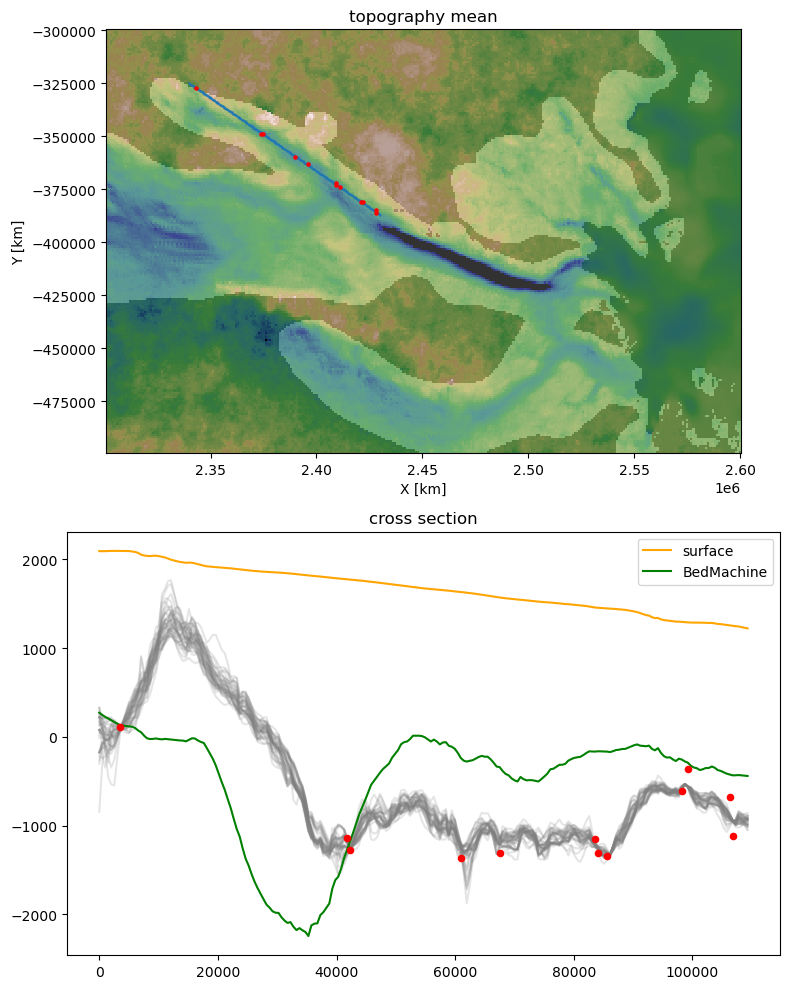

In [71]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8,10))
f_bed = ax1.pcolormesh(xx, yy, mcmc_bed,cmap='gist_earth',vmax=2000,vmin=-2500)
ax1.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.2)
ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
ax1.scatter(radar_data_loc_x, radar_data_loc_y, s=5,c='r')
#plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
ax1.set_xlabel('X [km]')
ax1.set_ylabel('Y [km]')
ax1.set_title('topography mean')
ax1.axis('scaled')

for i in range(last_beds.shape[0]):
    ax2.plot(profile_coords[1],bed_profile_list[i],alpha=0.2,color='grey',zorder=1)
ax2.plot(profile_coords[1],surf_profile,color='orange',label='surface')
ax2.plot(profile_coords[1],bm_profile,color='green',label='BedMachine')
ax2.scatter(radar_dist_along_profile, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2)
ax2.legend()
ax2.set_title('cross section')

plt.tight_layout()

plt.show()

In [78]:
cmap = plt.get_cmap('magma')
new_cmap = matplotlib.colors.LinearSegmentedColormap.from_list('magma',cmap(np.linspace(0.3, 1, 256)))

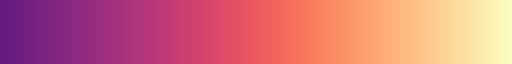

In [79]:
new_cmap

In [69]:
start_loc = (2340000,-325000)
end_loc = (2430000,-387000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

In [70]:
cond_data = df.bed.values.reshape(xx.shape)
cond_data_mask = ~np.isnan(cond_data)

profile_coords_x = profile_coords[0][0]
profile_coords_y = profile_coords[0][1]
radar_data_loc_x = []
radar_data_loc_y = []
radar_vals = []
radar_dist_along_profile = []

for i in range(profile_coords[0][0].shape[0]):
    x = profile_coords_x[i]
    y = profile_coords_y[i]
    x = np.round(x/1000)*1000
    y = np.round(y/1000)*1000

    x_index = np.where(xx == x)[1][0]
    y_index = np.where(yy == y)[0][0]
    if cond_data_mask[y_index,x_index]:
        radar_data_loc_x.append(x)
        radar_data_loc_y.append(y)
        radar_vals.append(cond_data[y_index,x_index])
        radar_dist_along_profile.append(profile_coords[1][i])
        
unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
radar_vals = np.array(radar_vals)[unique_index]
radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]

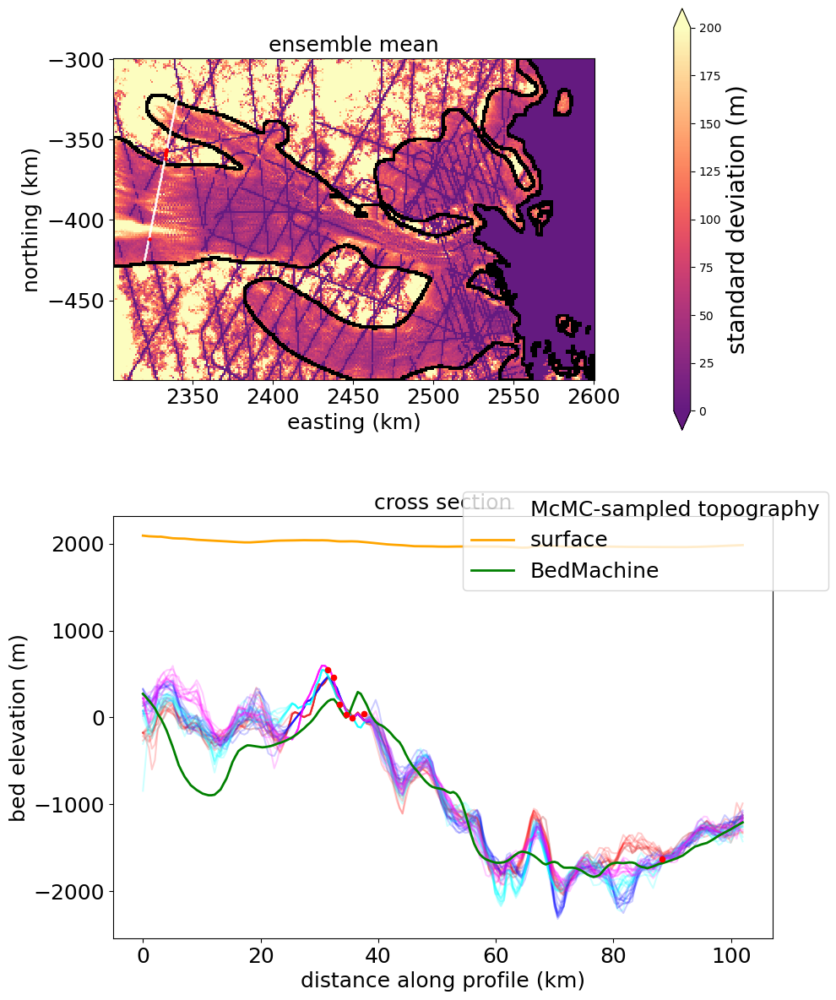

In [96]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10,12),height_ratios=[1,1])
# f_bed = ax1.pcolormesh(xx/1000, yy/1000, mcmc_bed,cmap='gist_earth',vmax=2000,vmin=-2500)
# ax1.pcolormesh(xx/1000, yy/1000, mc_region_mask,cmap='grey',alpha=0.2)
# ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
# ax1.scatter(radar_data_loc_x, radar_data_loc_y, s=5,c='r')
# cbar1 = plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
# ax1.set_xlabel('X [km]')
# ax1.set_ylabel('Y [km]')
# ax1.set_title('topography mean')
# ax1.axis('scaled')

f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=200)
cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='vertical',location='right',pad=0.12,shrink=1,extend='both')
cbar1.set_label(label='standard deviation (m)',size=MEDIUM_SIZE)
ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
ax1.scatter(profile_coords[0][0]/1000, profile_coords[0][1]/1000, s=0.5, c='white')
ax1.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r')
ax1.set_title('ensemble mean',fontsize=SMALL_SIZE)
ax1.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
ax1.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
ax1.axis('scaled')

mcmc_bed_colorlist = ['red','blue','cyan','magenta']
for i in range(last_beds_all.shape[0]):
    color = mcmc_bed_colorlist[i]
    for j in range(last_beds_all.shape[1]):
        ax2.plot(profile_coords[1]/1000,bed_profile_list[i*last_beds_all.shape[1]+j],alpha=0.2,color=color,zorder=1)

ax2.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.2,color='grey',zorder=1,label='McMC-sampled topography')
ax2.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
ax2.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
ax2.scatter(radar_dist_along_profile/1000, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2)
ax2.set_ylabel('bed elevation (m)',fontsize=SMALL_SIZE)
ax2.set_xlabel('distance along profile (km)',fontsize=SMALL_SIZE)
ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
ax2.legend(fontsize=SMALL_SIZE,bbox_to_anchor=(1.1,0.8),loc='lower right')
ax2.set_title('cross section',fontsize=SMALL_SIZE)

plt.tight_layout()

plt.show()

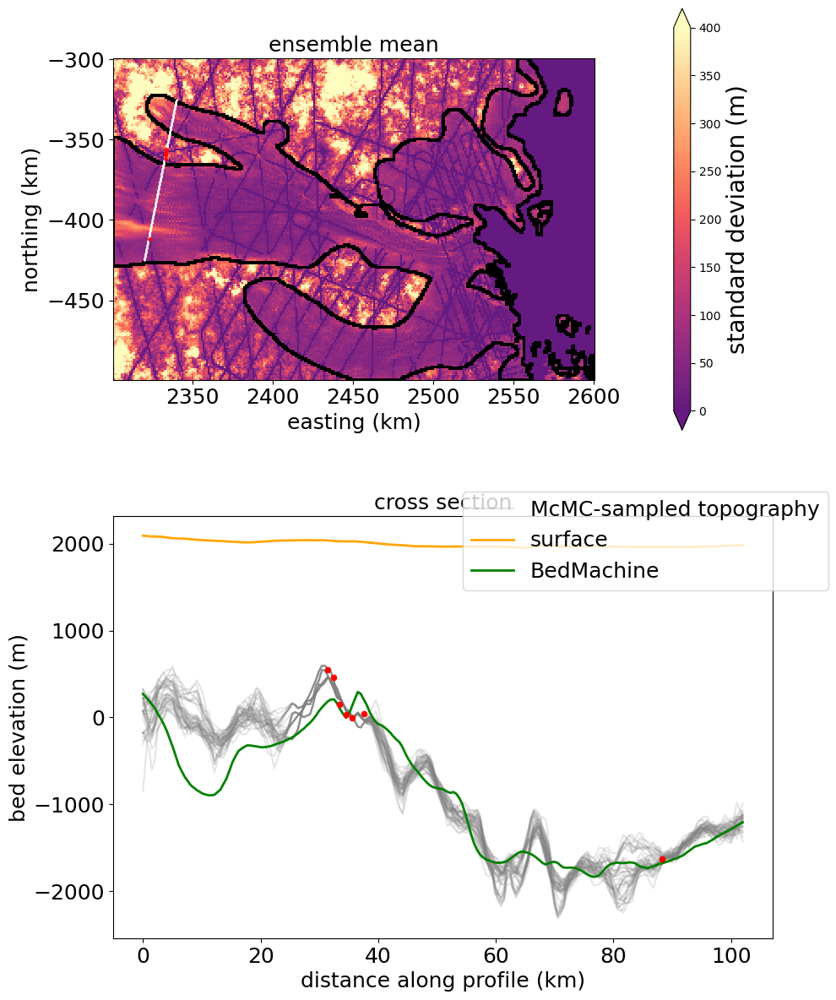

In [82]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10,12),height_ratios=[1,1])
#f_bed = ax1.pcolormesh(xx/1000, yy/1000, mcmc_bed,cmap='gist_earth',vmax=2000,vmin=-2500)
#ax1.pcolormesh(xx/1000, yy/1000, mc_region_mask,cmap='grey',alpha=0.2)
# ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
# ax1.scatter(radar_data_loc_x, radar_data_loc_y, s=5,c='r')
# #plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
# ax1.set_xlabel('X [km]')
# ax1.set_ylabel('Y [km]')
# ax1.set_title('topography mean')
# ax1.axis('scaled')

f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=400)
cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='vertical',location='right',pad=0.12,shrink=1,extend='both')
cbar1.set_label(label='standard deviation (m)',size=MEDIUM_SIZE)
#cbar1.ax.tick_params(axis='both',labelsize=MEDIUM_SIZE) 
ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
ax1.scatter(profile_coords[0][0]/1000, profile_coords[0][1]/1000, s=0.5, c='white')
ax1.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r')
ax1.set_title('ensemble mean',fontsize=SMALL_SIZE)
ax1.set_xlabel('easting (km)',fontsize=SMALL_SIZE)
ax1.set_ylabel('northing (km)',fontsize=SMALL_SIZE)
ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
ax1.axis('scaled')

for i in range(1,last_beds.shape[0]):
    ax2.plot(profile_coords[1]/1000,bed_profile_list[i],alpha=0.2,color='grey',zorder=1)
ax2.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.2,color='grey',zorder=1,label='McMC-sampled topography')
ax2.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
ax2.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
ax2.scatter(radar_dist_along_profile/1000, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2)
ax2.set_ylabel('bed elevation (m)',fontsize=SMALL_SIZE)
ax2.set_xlabel('distance along profile (km)',fontsize=SMALL_SIZE)
ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
ax2.legend(fontsize=SMALL_SIZE,bbox_to_anchor=(1.1,0.8),loc='lower right')
ax2.set_title('cross section',fontsize=SMALL_SIZE)

plt.tight_layout()

plt.show()

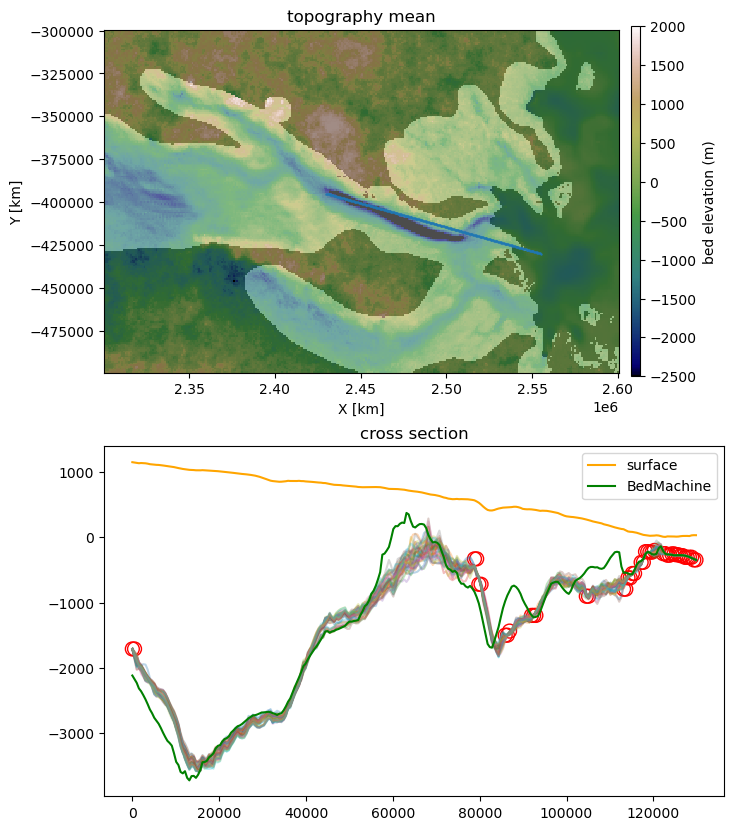

In [322]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8,10))
f_bed = ax1.pcolormesh(xx, yy, mcmc_bed,cmap='gist_earth',vmax=2000,vmin=-2500)
ax1.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.3)
ax1.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
plt.colorbar(f_bed,ax=ax1,pad=0.02, aspect=40, label='bed elevation (m)')
ax1.set_xlabel('X [km]')
ax1.set_ylabel('Y [km]')
ax1.set_title('topography mean')
ax1.axis('scaled')

for i in range(last_beds.shape[0]):
    ax2.plot(profile_coords[1],bed_profile_list[i],alpha=0.3)
ax2.plot(profile_coords[1],surf_profile,color='orange',label='surface')
ax2.plot(profile_coords[1],bm_profile,color='green',label='BedMachine')
ax2.scatter(radar_dist_along_profile, radar_vals,s=100,marker='o',facecolors='none', edgecolors='r')
ax2.legend()
ax2.set_title('cross section')

plt.show()

In [252]:
start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
num_pt = int(distance/1000)*2
profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

72


In [253]:
coords = np.array([xx.flatten(),yy.flatten()]).T
pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T

bed_profile_list = []
for i in range(last_beds.shape[0]):
    bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
    bed_profile_list.append(bed_profile)
surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
bm_profile = sp.interpolate.griddata(coords, df_bm.bed.values.flatten(), pred_coords)

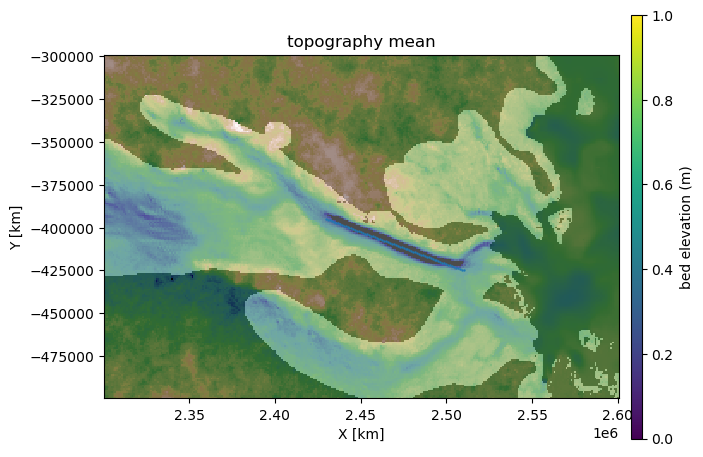

In [254]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx, yy, bed,cmap='gist_earth',vmax=2000,vmin=-2500)
plt.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.3)
plt.scatter(profile_coords[0][0], profile_coords[0][1], s=0.5)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('topography mean')
plt.axis('scaled')
plt.show()

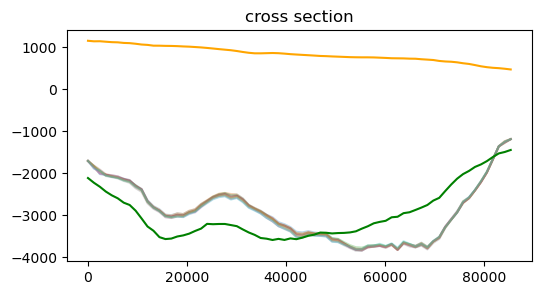

In [255]:
plt.figure(figsize=(6,3))
for i in range(last_beds.shape[0]):
    plt.plot(profile_coords[1],bed_profile_list[i],alpha=0.3)
plt.plot(profile_coords[1],surf_profile,color='orange')
plt.plot(profile_coords[1],bm_profile,color='green')
plt.title('cross section')
#plt.axis('scaled')
plt.show()

In [84]:
cross_line_x_list = []
cross_line_y_list = []
cross_line_z_list = []
bm_bed = df_bm.bed.values.reshape(xx.shape)

num_pt = 60

for nth_bed in range(last_beds.shape[0]):

    bed = last_beds[nth_bed,:,:]

    start_loc = (2470000,-390000)
    end_loc = (2480000,-425000)

    cross_line_x = np.zeros(num_pt)
    cross_line_y = np.zeros(num_pt)
    cross_line_z = np.zeros(num_pt)
    x_advance = (end_loc[0]-start_loc[0])/(num_pt-1)
    y_advance = (end_loc[1]-start_loc[1])/(num_pt-1)

    for i in range(0,num_pt,1):
        x = start_loc[0] + x_advance * i
        y = start_loc[1] + y_advance * i
        cross_line_x[i] = x
        cross_line_y[i] = y

        x_index = np.where(xx == x)[1][0]
        y_index = np.where(yy == y)[0][0]
        cross_line_z[i] = bed[y_index,x_index]
    
    cross_line_x_list.append(cross_line_x)
    cross_line_y_list.append(cross_line_y)
    cross_line_z_list.append(cross_line_z)

distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
distance_advance = (distance)/(num_pt-1)
distance_along_profile = np.zeros(num_pt)
cross_line_surf = np.zeros(num_pt)
cross_line_bmbed = np.zeros(num_pt)
for i in range(0,num_pt,1):
    x = start_loc[0] + x_advance * i
    x = np.round(x/1000)*1000
    y = start_loc[1] + y_advance * i
    y = np.round(y/1000)*1000

    x_index = np.where(xx == x)[1][0]
    y_index = np.where(yy == y)[0][0]
    distance_along_profile[i] = 0 + distance_advance * i
    cross_line_surf[i] = surf[y_index,x_index]
    cross_line_bmbed[i] = bed_bm[y_index,x_index]

In [86]:
distance

36400.54944640259

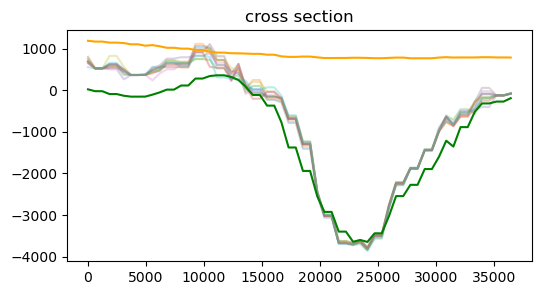

In [85]:
plt.figure(figsize=(6,3))
for i in range(last_beds.shape[0]):
    plt.plot(distance_along_profile,cross_line_z_list[i],alpha=0.3)
plt.plot(distance_along_profile,cross_line_surf,color='orange')
plt.plot(distance_along_profile,cross_line_bmbed,color='green')
plt.title('cross section')
#plt.axis('scaled')
plt.show()

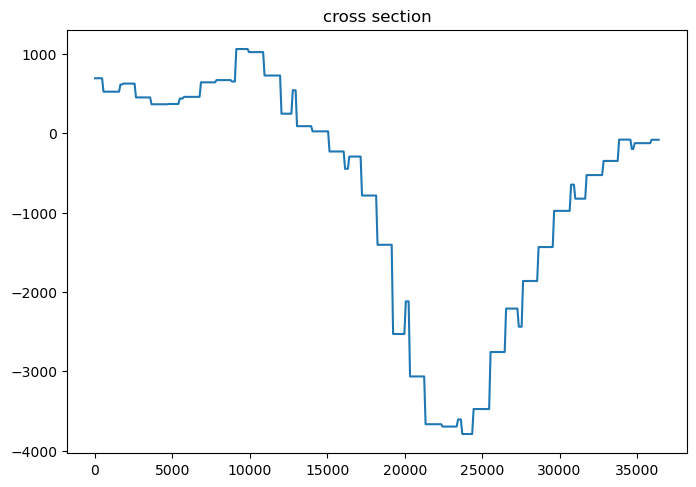

In [42]:
plt.figure(figsize=(8,5.5))
plt.plot(distance_along_profile,cross_line_z)
plt.title('cross section')
plt.show()

In [44]:
bed = last_beds[0,:,:]

start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
b = (end_loc[1]-start_loc[1]) / (end_loc[0]-start_loc[0])
c = start_loc[1] - b * start_loc[0]
num_pt = 400
cross_line_x = np.zeros(num_pt)
cross_line_y = np.zeros(num_pt)
cross_line_z = np.zeros(num_pt)
distance_along_profile = np.zeros(num_pt)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
x_advance = (end_loc[0]-start_loc[0])/(num_pt-1)
y_advance = (end_loc[1]-start_loc[1])/(num_pt-1)
distance_advance = (distance)/(num_pt-1)

for i in range(0,num_pt,1):
    x = start_loc[0] + x_advance * i
    x = np.round(x/1000)*1000
    y = start_loc[1] + y_advance * i
    y = np.round(y/1000)*1000
    cross_line_x[i] = x
    cross_line_y[i] = y
    
    x_index = np.where(xx == x)[1][0]
    y_index = np.where(yy == y)[0][0]
    cross_line_z[i] = bed[y_index,x_index]
    distance_along_profile[i] = 0 + distance_advance * i

In [45]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx, yy, last_beds_all[0,1,:,:],cmap='gist_earth',vmax=2000,vmin=-2500)
plt.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.3)
plt.scatter(cross_line_x, cross_line_y, s=0.5)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('topography mean')
plt.axis('scaled')
plt.show()

NameError: name 'last_beds_all' is not defined

<Figure size 800x550 with 0 Axes>

In [381]:
bed = last_beds_all[0,1,:,:]

start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
b = (end_loc[1]-start_loc[1]) / (end_loc[0]-start_loc[0])
c = start_loc[1] - b * start_loc[0]
num_pt = 400
cross_line_x = np.zeros(num_pt)
cross_line_y = np.zeros(num_pt)
cross_line_z = np.zeros(num_pt)
distance_along_profile = np.zeros(num_pt)
cross_line_surf = np.zeros(num_pt)
distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
x_advance = (end_loc[0]-start_loc[0])/(num_pt-1)
y_advance = (end_loc[1]-start_loc[1])/(num_pt-1)
distance_advance = (distance)/(num_pt-1)

for i in range(0,num_pt,1):
    x = start_loc[0] + x_advance * i
    x = np.round(x/1000)*1000
    y = start_loc[1] + y_advance * i
    y = np.round(y/1000)*1000
    cross_line_x[i] = x
    cross_line_y[i] = y
    
    x_index = np.where(xx == x)[1][0]
    y_index = np.where(yy == y)[0][0]
    cross_line_z[i] = bed[y_index,x_index]
    distance_along_profile[i] = 0 + distance_advance * i
    cross_line_surf[i] = surf[y_index,x_index]

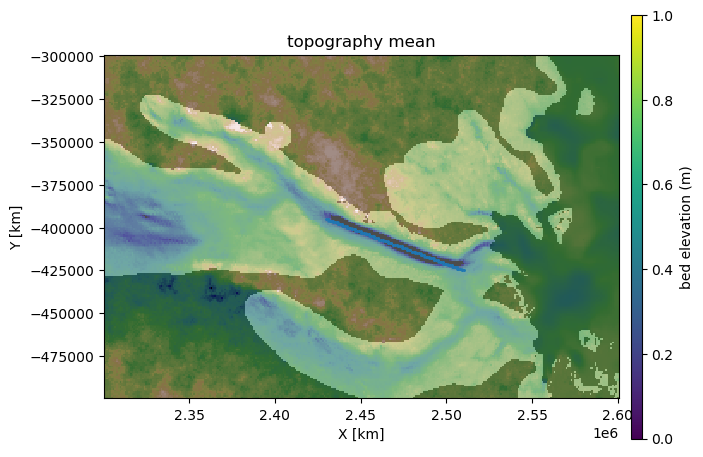

In [379]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx, yy, last_beds_all[0,1,:,:],cmap='gist_earth',vmax=2000,vmin=-2500)
plt.pcolormesh(xx, yy, mc_region_mask,cmap='grey',alpha=0.3)
plt.scatter(cross_line_x, cross_line_y, s=0.5)
plt.colorbar(pad=0.02, aspect=40, label='bed elevation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('topography mean')
plt.axis('scaled')
plt.show()

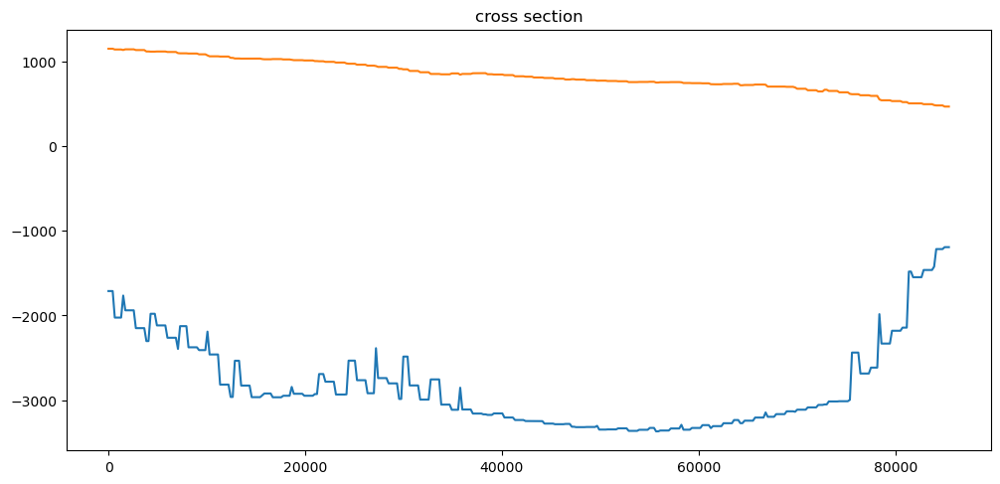

In [385]:
plt.figure(figsize=(12,5.5))
plt.plot(distance_along_profile,cross_line_z)
plt.plot(distance_along_profile,cross_line_surf)
plt.title('cross section')
#plt.axis('scaled')
plt.show()

In [292]:
line_length = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)

252833.93759541065

In [290]:
(end_loc[1]-start_loc[1])/1000

-105.0

In [291]:
(end_loc[0]-start_loc[0])/1000

230.0

In [285]:
# Generate some data...
x, y = np.mgrid[-5:5:0.1, -5:5:0.1]
z = np.sqrt(x**2 + y**2) + np.sin(x**2 + y**2)

# Coordinates of the line we'd like to sample along
line = [(-3, -1), (4, 3)]

# Convert the line to pixel/index coordinates
x_world, y_world = np.array(zip(*line))
col = z.shape[1] * (x_world - x.min()) / x.ptp()
row = z.shape[0] * (y_world - y.min()) / y.ptp()

# Interpolate the line at "num" points...
num = 1000
row, col = [np.linspace(item[0], item[1], num) for item in [row, col]]

TypeError: iteration over a 0-d array

In [289]:
np.array(zip(*line))

array(<zip object at 0x146609b3dc40>, dtype=object)

### correlation between ensemble std and other vars

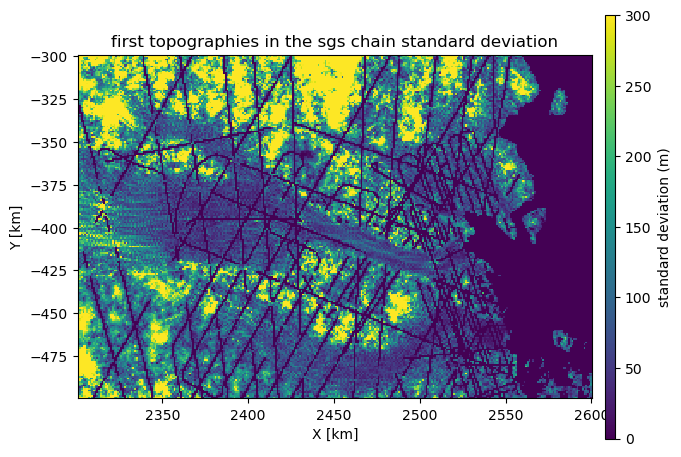

In [39]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.std(first_beds_all[:,:,:,:],axis=(0,1)),cmap='viridis',vmax=300)
plt.colorbar(pad=0.02, aspect=40, label='standard deviation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('first topographies in the sgs chain standard deviation')
plt.axis('scaled')
plt.show()

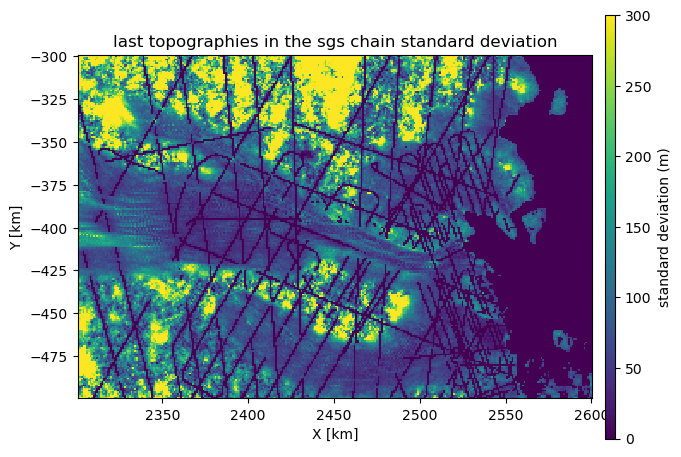

In [38]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all[:,:,:,:],axis=(0,1)),cmap='viridis',vmax=300)
plt.colorbar(pad=0.02, aspect=40, label='standard deviation (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('last topographies in the sgs chain standard deviation')
plt.axis('scaled')
plt.show()

In [41]:
std_lastbed = np.std(last_beds_all[:,:,:,:],axis=(0,1))
std_firstbed = np.std(first_beds_all[:,:,:,:],axis=(0,1))

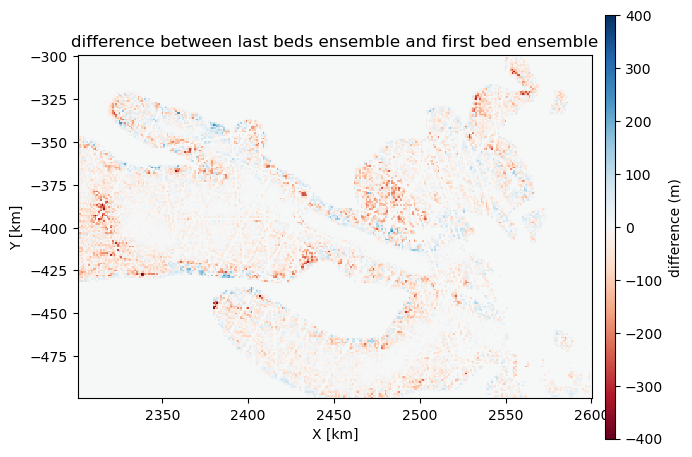

In [44]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, std_lastbed-std_firstbed, cmap='RdBu',vmax=400,vmin=-400)
plt.colorbar(pad=0.02, aspect=40, label='difference (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('difference between last beds ensemble and first bed ensemble')
plt.axis('scaled')
plt.show()

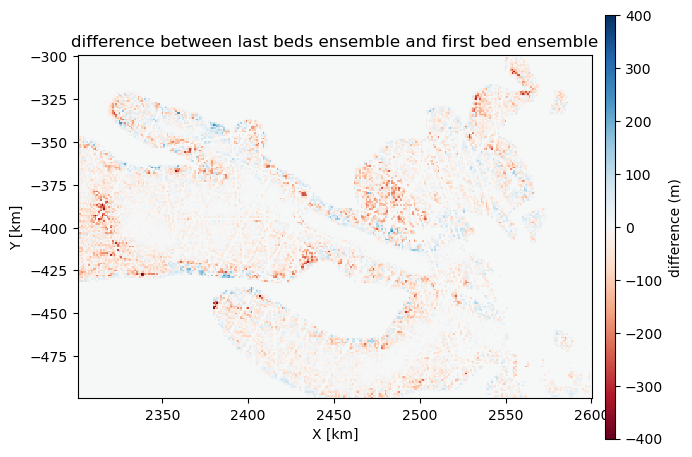

In [51]:
plt.figure(figsize=(8,5.5))
plt.pcolormesh(xx/1000, yy/1000, std_lastbed-std_firstbed, cmap='RdBu',vmax=400,vmin=-400)
plt.colorbar(pad=0.02, aspect=40, label='difference (m)')
plt.xlabel('X [km]')
plt.ylabel('Y [km]')
plt.title('difference between last beds ensemble and first bed ensemble')
plt.axis('scaled')
plt.show()

In [56]:
std_last_highvel = std_lastbed[mc_region_mask==True]
vel_highvel = np.sqrt(df.vel_x**2 + df.vel_y**2)[mc_region_mask.flatten()==True]

In [58]:
cond_bed = df.bed.values.reshape((rows,cols))
cond_data_mask = ~np.isnan(cond_bed)
dist = geomc.min_dist(np.where(cond_data_mask==0, np.nan, 1), xx, yy)

In [82]:
bm_error_highvel = df_bm.error.values[mc_region_mask.flatten()==True]

In [62]:
dist_highvel = dist[mc_region_mask==True]

In [78]:
dist

array([[ 9000.        ,  8000.        ,  7000.        , ...,
         1000.        ,  1000.        ,     0.        ],
       [ 9000.        ,  8000.        ,  7000.        , ...,
            0.        ,  1000.        ,  1000.        ],
       [ 9055.38513814,  8062.2577483 ,  7071.06781187, ...,
            0.        ,  1000.        ,  1414.21356237],
       ...,
       [23000.        , 23021.72886644, 23086.79276123, ...,
            0.        ,     0.        ,     0.        ],
       [24000.        , 24020.82429893, 24083.18915758, ...,
            0.        ,     0.        ,     0.        ],
       [25000.        , 25019.99200639, 25079.87240797, ...,
            0.        ,     0.        ,     0.        ]])

In [86]:
ensemble_mean = np.mean(last_beds_all[:,:,:,:],axis=(0,1))
lastbed_mean_highvel = ensemble_mean[mc_region_mask==True]

(-200.0, 4000.0)

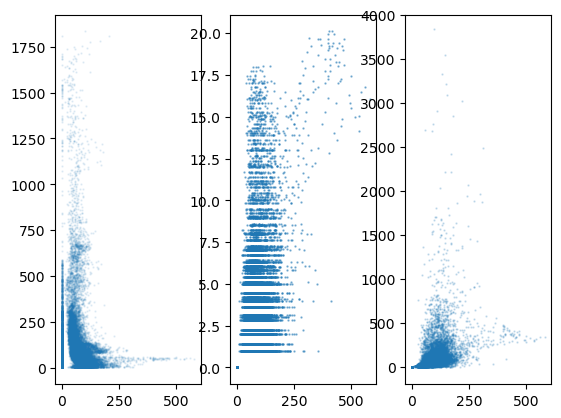

In [99]:
fig,ax = plt.subplots(nrows=1, ncols=3, sharex=False, sharey=False)
ax[0].scatter(std_last_highvel,vel_highvel,s=0.5,alpha=0.1)
ax[1].scatter(std_last_highvel,dist_highvel/1000,s=0.5,alpha=0.5)
ax[2].scatter(std_last_highvel,dist_highvel/vel_highvel,s=0.5,alpha=0.2)
ax[2].set_ylim(-200,4000)

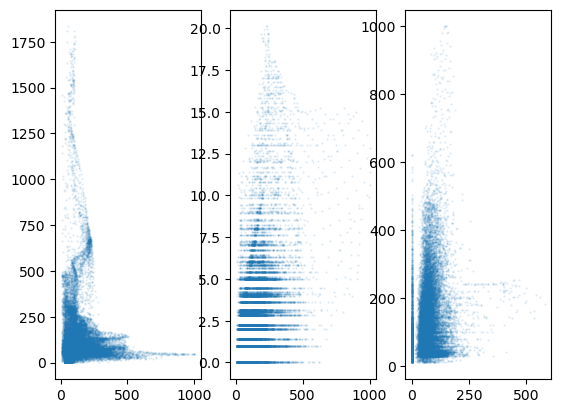

In [89]:
fig,ax = plt.subplots(nrows=1, ncols=3, sharex=False, sharey=False)
ax[0].scatter(bm_error_highvel,vel_highvel,s=0.5,alpha=0.1)
ax[1].scatter(bm_error_highvel,dist_highvel/1000,s=0.5,alpha=0.1)
ax[2].scatter(std_last_highvel,bm_error_highvel,s=0.5,alpha=0.1)

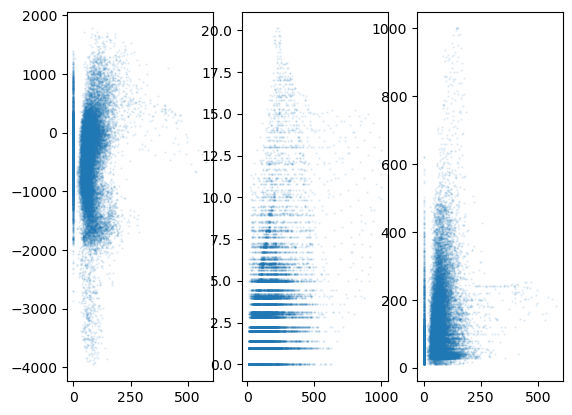

In [88]:
fig,ax = plt.subplots(nrows=1, ncols=3, sharex=False, sharey=False)
ax[0].scatter(std_last_highvel,lastbed_mean_highvel,s=0.5,alpha=0.1)
ax[1].scatter(bm_error_highvel,dist_highvel/1000,s=0.5,alpha=0.1)
ax[2].scatter(std_last_highvel,bm_error_highvel,s=0.5,alpha=0.1)

In [ ]:
# ∇ · (δH v ̄) = δ  ̇a + ∇ · Hδv

In [105]:
bm_error = df_bm.error.values.reshape(xx.shape)
vel_x = (df.vel_x**2).values.reshape(xx.shape)
vel_y = (df.vel_y**2).values.reshape(xx.shape)
surf = df.surface.values.reshape(xx.shape)

In [115]:
uHx = vel_x * bm_error
uHy = vel_y * bm_error
thick = surf - df_bm.bed.values.reshape(xx.shape)
    
dx = np.gradient(vel_x*bm_error, 1000, axis=1)
dy = np.gradient(vel_y*bm_error, 1000, axis=0)
leftterm = dx + dy

In [116]:
grad_H_x, grad_H_y = np.gradient(thick)

In [117]:
leftterm_highvel = leftterm[mc_region_mask==True]
grad_Hx_highvel = grad_H_x[mc_region_mask==True]
grad_Hy_highvel = grad_H_y[mc_region_mask==True]

(-10000.0, 10000.0)

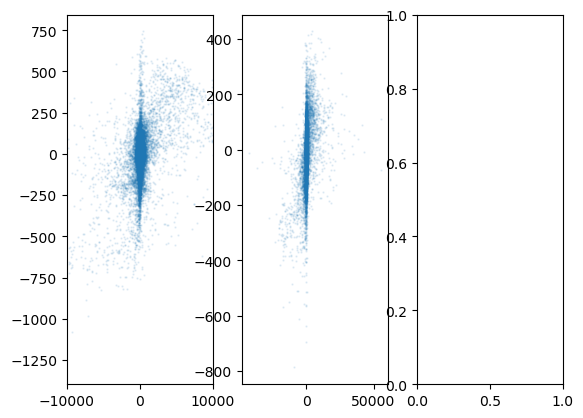

In [120]:
fig,ax = plt.subplots(nrows=1, ncols=3, sharex=False, sharey=False)
ax[0].scatter(leftterm_highvel,grad_Hx_highvel,s=0.5,alpha=0.1)
ax[1].scatter(leftterm_highvel,grad_Hy_highvel,s=0.5,alpha=0.1)
ax[0].set_xlim(-10000,10000)
#ax[2].scatter(std_last_highvel,bm_error_highvel,s=0.5,alpha=0.1)

In [59]:
scipy.stats.pearsonr(std_last_highvel, vel_highvel)

NameError: name 'scipy' is not defined

In [130]:
topo_max = np.max(last_beds_all,axis=(0,1))
topo_min = np.min(last_beds_all,axis=(0,1))

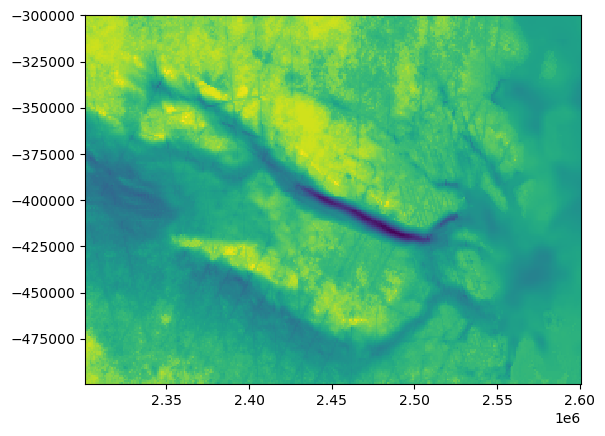

In [131]:
plt.pcolormesh(xx,yy,topo_max)

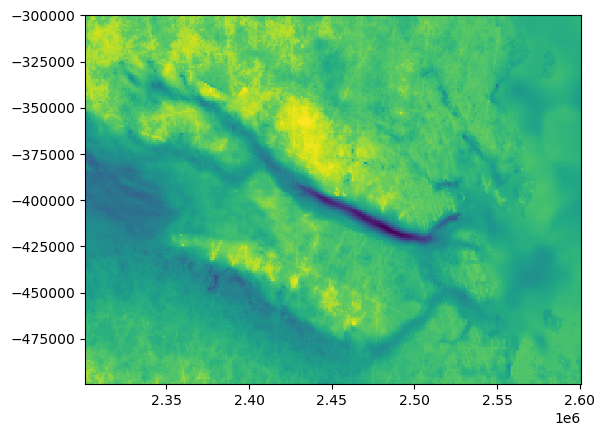

In [132]:
plt.pcolormesh(xx,yy,topo_min)

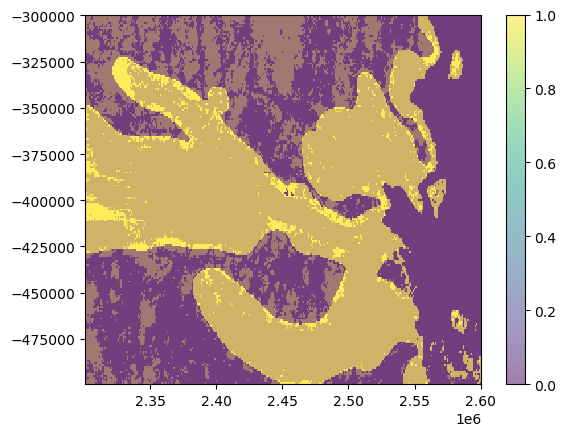

In [154]:
plt.pcolormesh(xx,yy,(topo_max-topo_min)>500,alpha=0.5)
plt.pcolormesh(xx,yy,mc_region_mask,alpha=0.5)
plt.colorbar()

(array([4.332e+03, 2.000e+00, 6.000e+00, 2.700e+01, 8.400e+01, 1.880e+02,
        4.220e+02, 7.330e+02, 9.850e+02, 1.291e+03, 1.505e+03, 1.553e+03,
        1.550e+03, 1.468e+03, 1.362e+03, 1.281e+03, 1.114e+03, 1.016e+03,
        8.660e+02, 7.890e+02, 6.440e+02, 5.320e+02, 5.430e+02, 4.770e+02,
        4.070e+02, 3.570e+02, 3.110e+02, 2.590e+02, 2.340e+02, 2.140e+02,
        1.770e+02, 1.680e+02, 1.220e+02, 1.240e+02, 8.700e+01, 7.500e+01,
        7.000e+01, 5.600e+01, 5.500e+01, 3.600e+01, 3.300e+01, 3.400e+01,
        1.800e+01, 2.900e+01, 2.000e+01, 1.500e+01, 1.300e+01, 2.300e+01,
        1.300e+01, 1.100e+01, 1.000e+01, 1.100e+01, 7.000e+00, 1.700e+01,
        1.000e+01, 6.000e+00, 4.000e+00, 4.000e+00, 6.000e+00, 7.000e+00,
        3.000e+00, 5.000e+00, 3.000e+00, 2.000e+00, 3.000e+00, 8.000e+00,
        7.000e+00, 4.000e+00, 4.000e+00, 1.000e+00, 4.000e+00, 4.000e+00,
        3.000e+00, 2.000e+00, 0.000e+00, 2.000e+00, 1.000e+00, 3.000e+00,
        2.000e+00, 1.000e+00, 1.000e+0

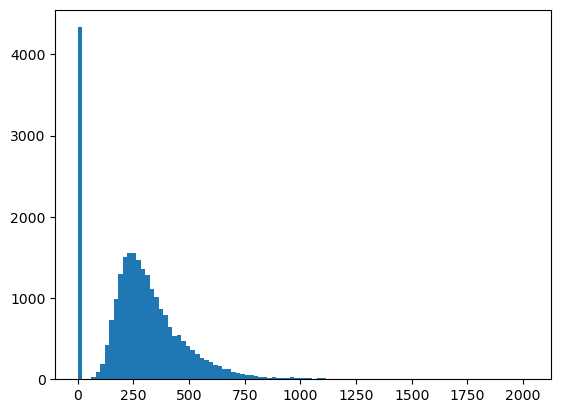

In [138]:
toporange_highvel = (topo_max-topo_min)[mc_region_mask==True]
plt.hist(toporange_highvel,bins=100)

In [151]:
np.sum((toporange_highvel)>500) / len(toporange_highvel)

0.10853102542307395

### Testing Velocity Uncertainty

In [33]:
step_range = (0,5)
nug_max = 0
range_min = (1,1)
range_max = (5,5)
model_name = 'Gaussian'
isotropic = False

In [37]:
p1 = geomc.generate_RF(x_uniq,y_uniq,step_range,nug_max,range_min,range_max,model_name=model_name,isotropic=isotropic)
p2 = geomc.generate_RF(x_uniq,y_uniq,step_range,nug_max,range_min,range_max,model_name=model_name,isotropic=isotropic)

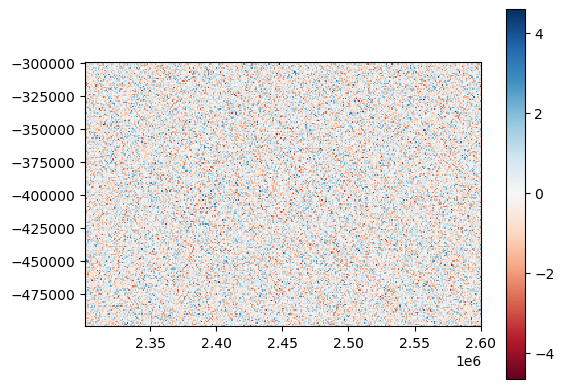

In [38]:
plt.pcolormesh(xx,yy,p1,cmap='RdBu')
plt.axis('scaled')
plt.colorbar()

In [39]:
velx_p = velx + p1
vely_p = vely + p2

In [42]:
mc_res_bm_velp = geomc.calc_mass_conservation(df_bm.bed.values.reshape(rows,cols), surf, velx_p, vely_p, dhdt, smb)
mc_res_velp = geomc.calc_mass_conservation(last_beds_all[0,0,:,:], surf, velx_p, vely_p, dhdt, smb)

(2300500.0, 2600500.0, -499500.0, -299500.0)

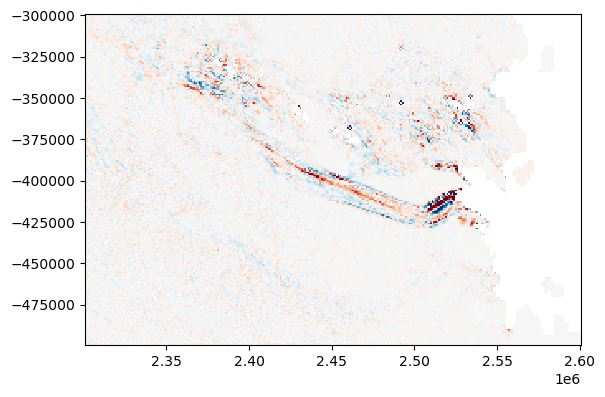

In [43]:
plt.pcolormesh(xx,yy,mc_res_bm_velp,vmax=75,vmin=-75,cmap='RdBu')
plt.axis('scaled')

(2300500.0, 2600500.0, -499500.0, -299500.0)

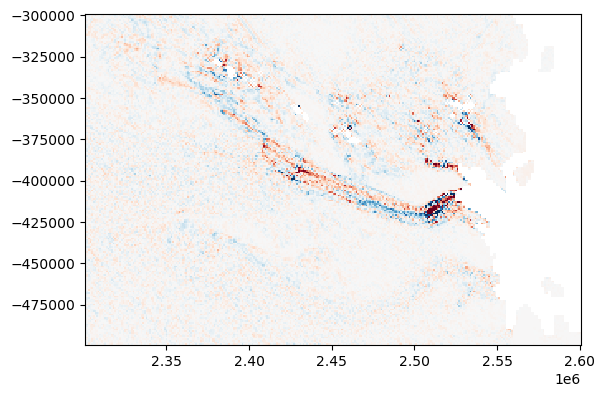

In [44]:
plt.pcolormesh(xx,yy,mc_res_velp,vmax=75,vmin=-75,cmap='RdBu')
plt.axis('scaled')

### select points

In [43]:
index_xy, actual_xy = geomc.find_example_loc(60, cond_data_mask, mc_region_mask, xx, yy)

In [44]:
np.savetxt('sampled_points_coord_38_4.txt',actual_xy)
np.savetxt('sampled_points_index_38_4.txt',index_xy)

(2300500.0, 2600500.0, -499500.0, -299500.0)

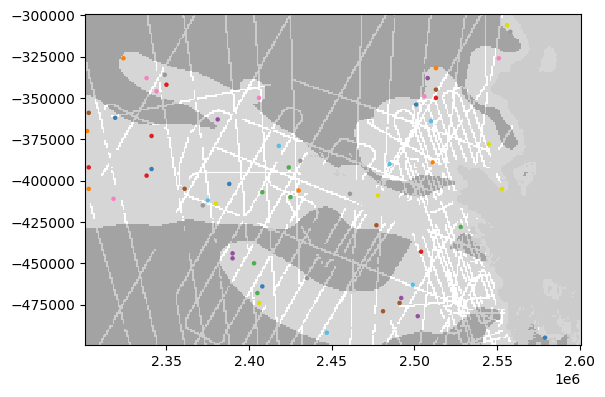

In [45]:
plt.pcolormesh(xx,yy,cond_data_mask,cmap='grey',alpha=0.2)
plt.pcolormesh(xx,yy,mc_region_mask,cmap='grey',alpha=0.2)
plt.scatter(actual_xy[:,0],actual_xy[:,1],s=5,c=color*2)
plt.axis('scaled')

In [46]:
actual_xy = np.loadtxt('sampled_points_coord_38_4.txt')
index_xy = np.loadtxt('sampled_points_index_38_4.txt')

In [47]:
sampled_values = last_beds[:,index_xy[:,0].astype('int'),index_xy[:,1].astype('int')]

Text(0.5, 1.0, 'resampled times')

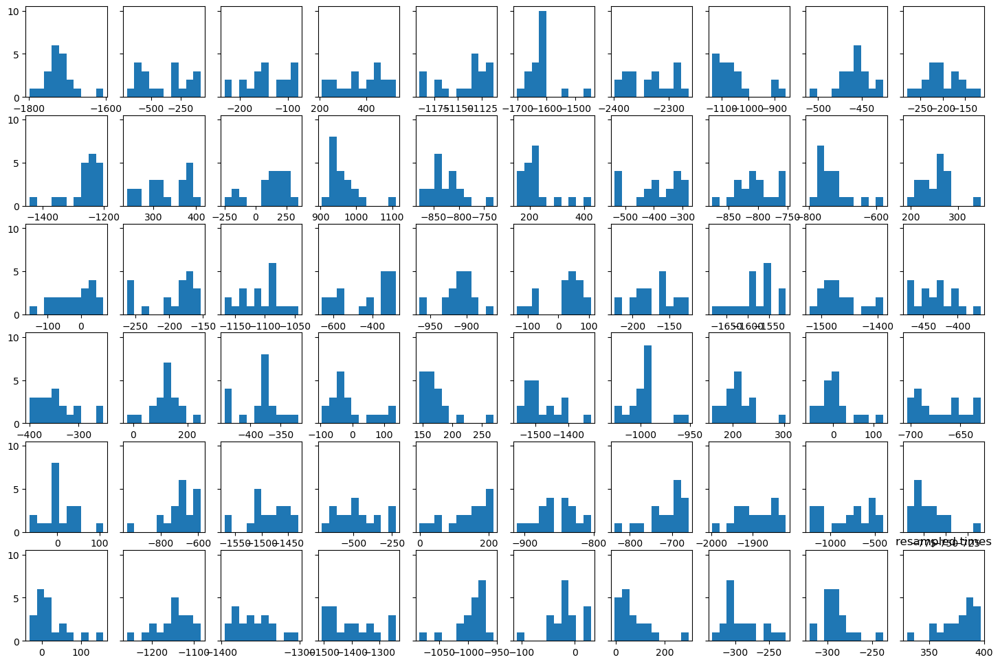

In [48]:
fig,axes = plt.subplots(6,10,sharex=False,sharey=True,figsize=(18,12))
for i,ax in enumerate(axes.flat):
    ax.hist(sampled_values[:,i])
    #ax.set_xticks(np.arange((int(min(sampled_values[:,i])/50))*50, max(sampled_values[:,i])+1, 50))
    #ax.set(xlabel='X [km]', ylabel='Y [km]')

plt.title('resampled times')

In [49]:
sampled_values_corr = np.corrcoef(sampled_values,rowvar=False)

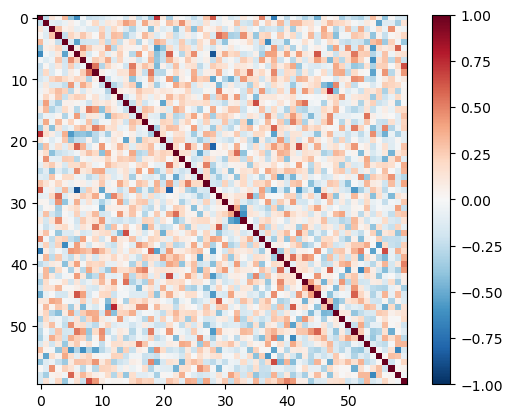

In [50]:
plt.imshow(sampled_values_corr,cmap='RdBu_r',vmax=1,vmin=-1)
plt.colorbar()

### test variogram

#### not detrended

In [83]:
subsample=100000

In [84]:
maxlag = 70000             # maximum range distance
n_lags = 70                # num of bins

In [85]:
df_bed = df.copy()
df_bed = df_bed[df_bed["bed"].isnull() == False]
data = df_bed['bed'].values.reshape(-1,1)
nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal",random_state=0,subsample=subsample).fit(data)

In [86]:
bed_max = np.nanmax(df_bed['bed'].values)
bed_min = np.nanmin(df_bed['bed'].values)
bed_max, bed_min

(1641.58, -2873.665714285714)

In [87]:
bed_bm = df_bm.bed.values.reshape(xx.shape)
exclude_out_dist1 = ~((bed_bm > bed_max)|(bed_bm < bed_min))

bed_test = last_beds[:,:,:]
exclude_out_dist2 = ~((bed_test > bed_max)|(bed_test < bed_min))
exclude_out_dist2 = ~(np.sum(exclude_out_dist2,axis=0)<exclude_out_dist2.shape[0])

bed_sgs = np.loadtxt("./38_sgs/sgs_bed_38_3.txt")
exclude_out_dist3 = ~((bed_sgs > bed_max)|(bed_sgs < bed_min))

In [88]:
exclude_out_dist = exclude_out_dist1 & exclude_out_dist2 & exclude_out_dist3

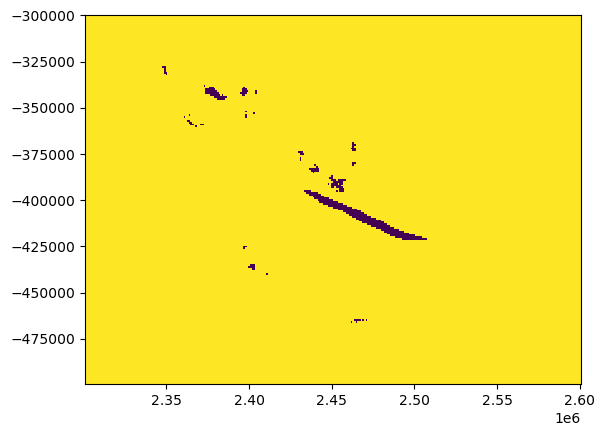

In [89]:
plt.pcolormesh(xx,yy,exclude_out_dist)

In [90]:
df_bed = df.copy()
df_bed = df_bed[(df_bed["bed"].isnull() == False)&(df_bed.bedmachine_mask==2)]
data = df_bed['bed'].values.reshape(-1,1)
coords = df_bed[['X','Y']].values
#roughness_region_mask = (df_bed['mask'].values)==1

#data = data[roughness_region_mask].reshape(-1,1)
#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
values = nst_trans_test.transform(data).T[0]
#coords_radar = coords[roughness_region_mask]
V2_radar = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
               maxlag=maxlag, normalize=False, model='spherical')
print(V2_radar.parameters)

[46230.26043365419, 1.3921516583574323, 0]


In [40]:
# bed_bm = df_bm.bed.values.reshape(xx.shape)
# data = bed_bm[mc_region_mask==1].reshape(-1,1)

# #nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
# values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
# V2_bm = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, model='spherical',samples=0.4)
# print(n, V2_bm.parameters)

In [92]:
bed_bm = df_bm.bed.values.reshape(xx.shape)
#bed_bm = bed_bm[mc_region_mask==1].reshape(-1,1)
#exclude_out_dist = ~((bed_bm > bed_max)|(bed_bm < bed_min))
#data = bed_bm[exclude_out_dist.flatten()]
data = bed_bm[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)

df_bed_variogram = df.copy()
#df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
coords = df_bed_variogram[['X','Y']].values
coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]

#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_bm = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                      model='spherical',samples=0.4)
print(V2_bm.parameters)

[60240.49767985949, 1.7680450530283585, 0]


In [94]:
# nth_iter = [1,4000,8000,9000,10000,11000] #what variogram at which interval you want to see
vlist = []
for n in range(0,last_beds.shape[0],5):
    bed_test = last_beds[n,:,:]
    #bed_test = bed_test[mc_region_mask==1].reshape(-1,1)
    #exclude_out_dist = ~((bed_test > bed_max)|(bed_test < bed_min))
    #data = bed_test[exclude_out_dist.flatten()]
    data = bed_test[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
    
    df_bed_variogram = df.copy()
    #df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
    coords = df_bed_variogram[['X','Y']].values
    #coords = coords[exclude_out_dist.flatten(),:]
    coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]
    
    #nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
    values = nst_trans_test.transform(data).T[0] # still use radar normal transformation

    V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, model='spherical',samples=0.4)
    print(n, V2_test.parameters)
    vlist.append(V2_test)

0 [60707.55160400799, 1.940551858964564, 0]
5 [61490.6201028481, 1.9263736920596004, 0]
10 [57941.943234842016, 1.8660752666096005, 0]
15 [60535.42962716875, 1.9054168262267264, 0]


In [98]:
bm_mask = df.bedmachine_mask.values.reshape(xx.shape)

In [99]:
bed_sgs = np.loadtxt("./sgs_bed_38_test1.txt")
#bed_sgs = bed_sgs[mc_region_mask==1].reshape(-1,1)
#bed_sgs = bed_sgs[bm_mask==2].reshape(-1,1)
#exclude_out_dist = ~((bed_sgs > bed_max)|(bed_sgs < bed_min))
#data = bed_sgs[exclude_out_dist.flatten()]
data = bed_sgs[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)

df_bed_variogram = df.copy()
#df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
#df_bed_variogram = df_bed_variogram[df_bed_variogram['bedmachine_mask']==2]
coords = df_bed_variogram[['X','Y']].values
#coords = coords[exclude_out_dist.flatten(),:]
coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]

#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_sgs = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                       maxlag=maxlag, normalize=False, model='spherical',samples=0.4)
print(n, V2_sgs.parameters)

15 [59083.2088208348, 1.5511515360784696, 0]


In [97]:
avg_beds = np.loadtxt("./bed_cache_38_3_40"+".txt")
avg_beds = avg_beds.reshape(np.round(avg_beds.size/(rows*cols)).astype(int), rows, cols)
avg_bed = np.mean(avg_beds, axis=0)
bed_avged_filtered = sp.ndimage.gaussian_filter(avg_bed, sigma=5)

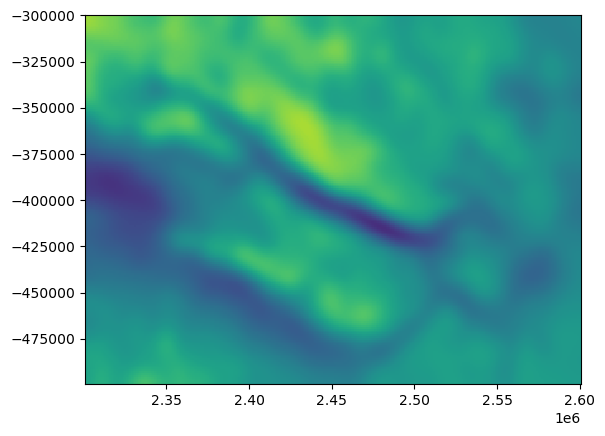

In [47]:
plt.pcolormesh(xx,yy,bed_avged_filtered,vmax=2000,vmin=-2500)

In [104]:
bed_trend = np.loadtxt("./trend_39_crf_test.txt")
#bed_trend = np.loadtxt("./38_sgs/trend_38_3.txt")
#bed_trend = bed_avged_filtered
#bed_trend = bed_trend[mc_region_mask==1].reshape(-1,1)
#bed_trend = bed_trend[bm_mask==2].reshape(-1,1)
#exclude_out_dist = ~((bed_trend > bed_max)|(bed_trend < bed_min))
#data = bed_trend[exclude_out_dist.flatten()]
data = bed_trend[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)

df_bed_variogram = df.copy()
#df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
#df_bed_variogram = df_bed_variogram[df_bed_variogram['bedmachine_mask']==2]
coords = df_bed_variogram[['X','Y']].values
#coords = coords[exclude_out_dist.flatten(),:]
coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]

#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_trend = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                       maxlag=maxlag, normalize=False, model='spherical',samples=0.4)
print(n, V2_trend.parameters)

15 [69999.99999999999, 1.5386849821809176, 0]


In [106]:
color = ['#377eb8', '#ff7f00', '#4daf4a',
          '#f781bf', '#a65628', '#984ea3',
          '#999999', '#e41a1c', '#dede00','#57bee8',
        '#377eb8', '#ff7f00', '#4daf4a',
          '#f781bf', '#a65628', '#984ea3',
          '#999999', '#e41a1c', '#dede00','#57bee8',
        '#377eb8', '#ff7f00', '#4daf4a',
          '#f781bf', '#a65628', '#984ea3',
          '#999999', '#e41a1c', '#dede00','#57bee8']

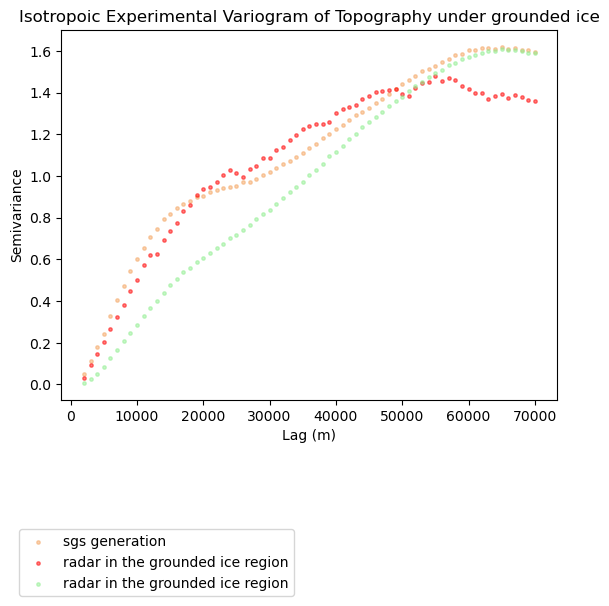

In [107]:
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatatrend = V2_trend.bins
ydatatrend = V2_trend.experimental

plt.scatter(xdatasgs, ydatasgs, s=6, c='sandybrown',alpha=0.5,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in the grounded ice region')
plt.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.5, label='radar in the grounded ice region')


plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(bbox_to_anchor=(-.1,-.55), loc='lower left')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

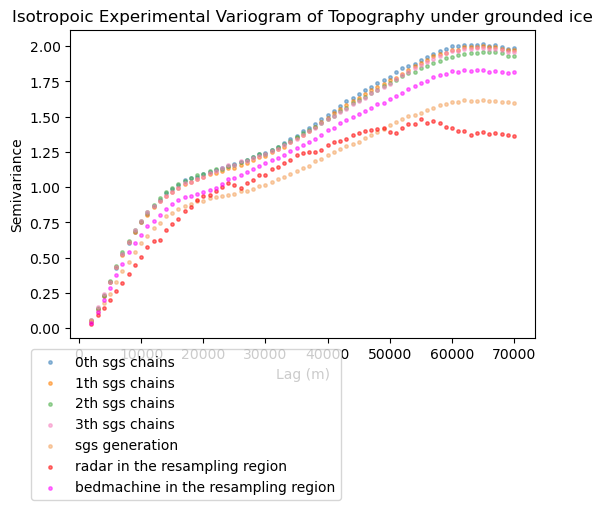

In [103]:
# extract variogram values
xdata_list = []
ydata_list = []
for i in range(len(vlist)):
    xdata_list.append(vlist[i].bins)
    ydata_list.append(vlist[i].experimental)
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental

plt.figure(figsize=(6,4))
for i in range(len(xdata_list)):
    plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.5,label=str(i)+'th sgs chains')
plt.scatter(xdatasgs, ydatasgs, s=6, c='sandybrown',alpha=0.5,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in the resampling region')
plt.scatter(xdatabm, ydatabm, s=6, c='magenta',alpha=0.5, label='bedmachine in the resampling region')


plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(bbox_to_anchor=(-.1,-.55), loc='lower left')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

#### detrended

In [148]:
maxlag = 35000             # maximum range distance
n_lags = 70                # num of bins

In [149]:
subsample=100000

In [150]:
datacoord = df[df['bed'].isnull()==False][['X','Y']].values
dataval = df[df['bed'].isnull()==False][['bed']].values
variogram_trend = sp.interpolate.RBFInterpolator(datacoord, dataval, kernel='thin_plate_spline',smoothing=5e10)(np.stack([df.X, df.Y]).T)
print(np.max(variogram_trend),np.mean(variogram_trend),np.std(variogram_trend),np.min(variogram_trend))

1144.653556154755 -120.76285415979822 497.3849861175422 -1419.9852821859527


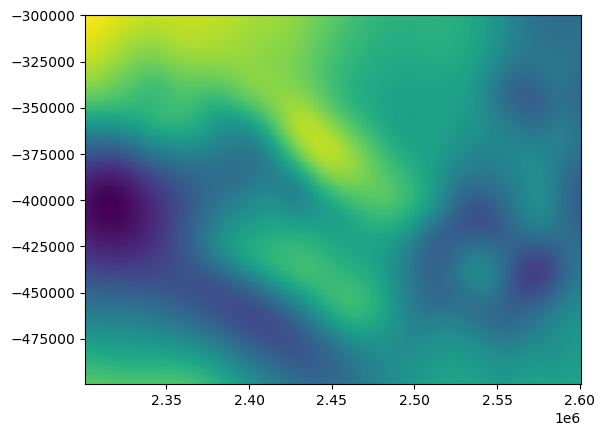

In [151]:
plt.pcolormesh(xx,yy,variogram_trend.reshape((200,300)))

In [152]:
df_bed = df.copy()
df_bed['variogram_residual'] = df_bed['bed'] - variogram_trend.flatten()
df_bed = df_bed[(df_bed["variogram_residual"].isnull() == False)]
data = df_bed['variogram_residual'].values.reshape(-1,1)
nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal",random_state=0,subsample=subsample).fit(data)

In [153]:
vr_max = np.nanmax(df_bed['variogram_residual'].values)
vr_min = np.nanmin(df_bed['variogram_residual'].values)
vr_max, vr_min

(1575.9739603246098, -2372.129495866412)

In [155]:
last_beds = last_beds_all.reshape((last_beds_all.shape[0]*last_beds_all.shape[1],last_beds_all.shape[2],last_beds_all.shape[3]))

In [156]:
first_beds = first_beds_all.reshape((first_beds_all.shape[0]*first_beds_all.shape[1],first_beds_all.shape[2],first_beds_all.shape[3]))

In [157]:
bed_bm = df_bm.bed.values.reshape(xx.shape) - variogram_trend.reshape(xx.shape)
exclude_out_dist1 = ~((bed_bm > vr_max)|(bed_bm < vr_min))

bed_test = last_beds[:,:,:] - variogram_trend.reshape(xx.shape)
exclude_out_dist2 = ~((bed_test > vr_max)|(bed_test < vr_min))
exclude_out_dist2 = ~(np.sum(exclude_out_dist2,axis=0)<exclude_out_dist2.shape[0])

bed_sgs = np.loadtxt("./57_crf/sgs_bed_57_crf.txt") - variogram_trend.reshape(xx.shape)
exclude_out_dist3 = ~((bed_sgs > vr_max)|(bed_sgs < vr_min))

In [158]:
exclude_out_dist = exclude_out_dist1 & exclude_out_dist2 & exclude_out_dist3

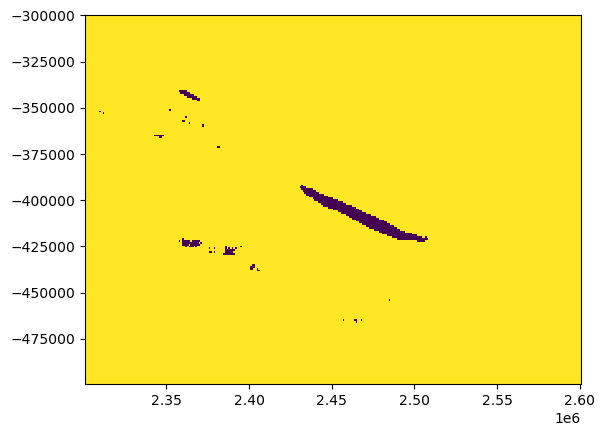

In [159]:
plt.pcolormesh(xx,yy,exclude_out_dist)

In [160]:
df_bed = df.copy()
df_bed['variogram_residual'] = df_bed['bed'] - variogram_trend.flatten()
df_bed = df_bed[(df_bed["variogram_residual"].isnull() == False)&(df_bed.bedmachine_mask==2)]
data = df_bed['variogram_residual'].values.reshape(-1,1)
coords = df_bed[['X','Y']].values
#roughness_region_mask = (df_bed['mask'].values)==1

#data = data[roughness_region_mask].reshape(-1,1)
#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
values = nst_trans_test.transform(data).T[0]
#coords_radar = coords[roughness_region_mask]
V2_radar = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
               maxlag=maxlag, normalize=False, model='spherical')
print(V2_radar.parameters)

[18677.357902569274, 1.6997741039651282, 0]


In [161]:
bed_bm = df_bm.bed.values.reshape(xx.shape) - variogram_trend.reshape(xx.shape)
data = bed_bm[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)

df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]

values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_bm = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, 
                      normalize=False, model='spherical',samples=0.6)
print(V2_bm.parameters)

[19035.50292038539, 1.5604093243924704, 0]


In [ ]:
# # nth_iter = [1,4000,8000,9000,10000,11000] #what variogram at which interval you want to see
# p_vlist = []
# for n in range(0,10,1):
#     bed_test = last_beds[n,:,:] - variogram_trend.reshape(xx.shape)
#     data = bed_test[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
    
#     df_bed_variogram = df.copy()
#     coords = df_bed_variogram[['X','Y']].values
#     coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]
    
#     values = nst_trans_test.transform(data).T[0] # still use radar normal transformation

#     V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
#                    maxlag=maxlag, normalize=False, model='spherical',samples=0.6)
#     print(n, V2_test.parameters)
#     p_vlist.append(V2_test)

In [95]:
# # nth_iter = [1,4000,8000,9000,10000,11000] #what variogram at which interval you want to see
# f_vlist = []
# for n in range(0,10,1):
#     bed_test = first_beds[n,:,:] - variogram_trend.reshape(xx.shape)
#     data = bed_test[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
    
#     df_bed_variogram = df.copy()
#     coords = df_bed_variogram[['X','Y']].values
#     coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]
    
#     values = nst_trans_test.transform(data).T[0] # still use radar normal transformation

#     V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
#                    maxlag=maxlag, normalize=False, model='spherical',samples=0.6)
#     print(n, V2_test.parameters)
#     f_vlist.append(V2_test)

0 [16216.873919451089, 1.7764954491812492, 0]
1 [15758.398691188397, 1.7841894014285518, 0]
2 [16565.334580083436, 1.8165580842329918, 0]
3 [16510.882361043692, 1.81914798553255, 0]
4 [16289.367588841294, 1.7945470551918639, 0]
5 [16355.326499354604, 1.812579108327964, 0]
6 [16250.889930259716, 1.7745187419845203, 0]
7 [16132.772659950277, 1.7896923058652392, 0]
8 [16282.935037594894, 1.803249586484827, 0]
9 [16204.283665613028, 1.77240699925642, 0]


In [120]:
# nth_iter = [1,4000,8000,9000,10000,11000] #what variogram at which interval you want to see
vlist = []
for n in range(0,last_beds.shape[0],1):
    bed_test = last_beds[n,:,:] - variogram_trend.reshape(xx.shape)
    data = bed_test[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
    
    df_bed_variogram = df.copy()
    coords = df_bed_variogram[['X','Y']].values
    coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]
    
    values = nst_trans_test.transform(data).T[0] # still use radar normal transformation

    V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, model='spherical',samples=0.6)
    print(n, V2_test.parameters)
    vlist.append(V2_test)

0 [17038.128374903205, 1.6914256452402359, 0]
1 [17055.729963585865, 1.7212299933051882, 0]
2 [17154.719130092624, 1.700158450486093, 0]
3 [16881.145979346195, 1.6999142749749143, 0]
4 [16845.48344351915, 1.6956014445528504, 0]
5 [16898.107244772873, 1.704857851198759, 0]
6 [16624.386228838364, 1.7048066770319694, 0]
7 [16765.51080040997, 1.7000242896747089, 0]
8 [16947.65619695295, 1.705974164655508, 0]
9 [17216.846752584854, 1.6831558985228792, 0]
10 [16612.743463696217, 1.7191577072648723, 0]
11 [16602.958719276106, 1.6919219904851535, 0]
12 [16931.3650209758, 1.7184219342017133, 0]
13 [16595.448336628524, 1.7040695209254069, 0]
14 [16561.73053106834, 1.7015496391351745, 0]
15 [16748.651177803065, 1.7022344853904974, 0]
16 [16411.282670794382, 1.7071462490172684, 0]
17 [16956.783839444943, 1.7392720970214957, 0]
18 [17063.0365103051, 1.7174664875844774, 0]
19 [16814.79893064925, 1.729934135387581, 0]
20 [17010.475914163562, 1.6902806352254773, 0]
21 [17109.926359907597, 1.7034776224

In [153]:
# last_beds = np.array([loaded_bed_1[-1,:,:]])
# last_beds.shape

In [154]:
# # nth_iter = [1,4000,8000,9000,10000,11000] #what variogram at which interval you want to see
# vlist = []
# for n in range(0,last_beds.shape[0],1):
#     bed_test = last_beds[n,:,:] - variogram_trend.reshape(xx.shape)
#     data = bed_test[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)
    
#     df_bed_variogram = df.copy()
#     coords = df_bed_variogram[['X','Y']].values
#     coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]
    
#     values = nst_trans_test.transform(data).T[0] # still use radar normal transformation

#     V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
#                    maxlag=maxlag, normalize=False, model='spherical',samples=0.6)
#     print(n, V2_test.parameters)
#     vlist.append(V2_test)

In [162]:
bed_sgs = np.loadtxt("./57_crf/sgs_bed_57_crf.txt") - variogram_trend.reshape(xx.shape)
data = bed_sgs[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)

df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]

values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_sgs = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                       model='spherical',samples=0.6)
print(V2_sgs.parameters)

[17635.888223575614, 1.7002651331082157, 0]


In [171]:
bed_krig = np.loadtxt("krig_est_bed_denman_noqc_vis1.txt") - variogram_trend.reshape(xx.shape)
data = bed_krig[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)

df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]

values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_krig = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                       model='spherical',samples=0.6)
print(V2_krig.parameters)

[19650.81510315717, 1.5055174496293864, 0]


In [ ]:
avg_beds = np.loadtxt("./bed_cache_38_3_40"+".txt")
avg_beds = avg_beds.reshape(np.round(avg_beds.size/(rows*cols)).astype(int), rows, cols)
avg_bed = np.mean(avg_beds, axis=0)
bed_avged_filtered = sp.ndimage.gaussian_filter(avg_bed, sigma=5)

In [ ]:
plt.pcolormesh(xx,yy,bed_avged_filtered,vmax=2000,vmin=-2500)

In [255]:
#bed_trend = bed_avged_filtered - variogram_trend.reshape(xx.shape)
bed_trend = np.loadtxt("./52_crf/trend_52_crf.txt") - variogram_trend.reshape(xx.shape)
#bed_trend = np.loadtxt("./trend_39_crf.txt") - variogram_trend.reshape(xx.shape)
data = bed_trend[(mc_region_mask==1)&(exclude_out_dist==1)].reshape(-1,1)

df_bed_variogram = df.copy()
coords = df_bed_variogram[['X','Y']].values
coords = coords[((mc_region_mask==1)&(exclude_out_dist==1)).flatten(),:]

values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_trend = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                       model='spherical',samples=0.6)
print(V2_trend.parameters)

[30581.984949461297, 0.9772863015554513, 0]


In [122]:
colorblind_palette = ['#377eb8', '#ff7f00', '#4daf4a',
                      '#f781bf', '#a65628', '#984ea3',
                      '#999999', '#e41a1c', '#dede00','#57bee8']

In [123]:
SMALL_SIZE = 8
MEDIUM_SIZE = 8.5
LARGE_SIZE = 9

In [ ]:
# mm = 1/25.4
# fig = plt.figure(figsize=(85*mm, 50*mm))
# axes = plt.axes()
   
# axes.plot(crf_mc_loss_all[3],color='black',label='meso-scale chain',lw=0.5)
# axes.plot(range(5000*40+4000+3*4000,5000*40+4000+3*4000+sgs_mc_loss_all.shape[2]),sgs_mc_loss_all[3,3,:],lw=0.5,color='blue',label='fine-scale chain')

# axes.axhline(y = mc_loss_bm, color = 'r', linestyle = '--', label='bedmachine',alpha=0.3)

# axes.set_yscale('log')
# axes.set_yticks([5*10**6,10**7,1.5*10**7,2.0*10**7,2.5*10**7])
# axes.yaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
# axes.yaxis.set_tick_params(labelsize=9)
# axes.set_ylabel('sum of squares of \n mass conservation residual',size=9)

# #axes.xaxis.set_major_formatter(matplotlib.ticker.ScalarFormatter())
# axes.ticklabel_format(axis='x', style='sci', scilimits=(0,0), useOffset=False, useMathText=False)
# axes.xaxis.set_tick_params(labelsize=9)
# axes.set_xlabel('iterations',size=9)

# #plt.ylabel('MSE of\nmass conservation residual',size=11)
# #plt.xlabel('iterations',size=11)
# axes.set_title('reduction of the residual\nthrough the MCMC chain',size=10)
# axes.legend(fontsize=9,loc='upper right')

# plt.savefig('residualReduction.png',bbox_inches='tight',dpi=600)

/scratch/local/58106237/ipykernel_3841700/3568844575.py:16: RuntimeWarning: All-NaN slice encountered
  upperlimit = np.nanmax(ydata_list,axis=0)
/scratch/local/58106237/ipykernel_3841700/3568844575.py:17: RuntimeWarning: All-NaN slice encountered
  lowerlimit = np.nanmin(ydata_list,axis=0)
/scratch/local/58106237/ipykernel_3841700/3568844575.py:18: RuntimeWarning: Mean of empty slice
  rangemean = np.nanmean(ydata_list,axis=0)


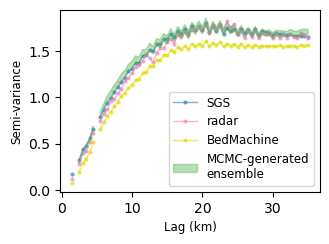

In [129]:
# extract variogram values
xdata_list = np.zeros((len(vlist),vlist[0].bins.shape[0]))
ydata_list = np.zeros((len(vlist),vlist[0].experimental.shape[0]))
for i in range(len(vlist)):
    xdata_list[i] = vlist[i].bins
    ydata_list[i] = vlist[i].experimental
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
# xdatatrend = V2_trend.bins
# ydatatrend = V2_trend.experimental

upperlimit = np.nanmax(ydata_list,axis=0)
lowerlimit = np.nanmin(ydata_list,axis=0)
rangemean = np.nanmean(ydata_list,axis=0)

mm = 1/25.4
plt.figure(figsize=(85*mm, 60*mm))
axes = plt.axes()

axes.plot(xdatasgs/1000,ydatasgs,lw=1,ls='-',marker='o',ms=2,c=colorblind_palette[0],alpha=0.6,label='SGS',zorder=1)
axes.plot(xdataradar/1000, ydataradar,lw=1,ls='-',marker='o',ms=2,c=colorblind_palette[3],alpha=0.6,label='radar',zorder=1)
axes.plot(xdatabm/1000, ydatabm,lw=1,ls='-',marker='o',ms=2,c=colorblind_palette[8],alpha=0.6,label='BedMachine',zorder=1)
axes.fill_between(xdata_list[0]/1000,upperlimit,lowerlimit,alpha=0.4,color=colorblind_palette[2],label='MCMC-generated\nensemble',zorder=2)
#axes.plot(xdatabm/1000, rangemean,lw=1,ls='-',c=colorblind_palette[8],alpha=1,label='ensemble mean',zorder=1)
# axes.scatter(xdatasgs, ydatasgs, s=3, c='blue',alpha=0.7,label='SGS')
# axes.scatter(xdataradar, ydataradar, s=3, c='red',alpha=0.5, label='Radar')
# axes.scatter(xdatabm, ydatabm, s=3, c='magenta',alpha=0.5, label='BedMachine')
#axes.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')

#axes.set_title('Experimental variograms of subglacial topography',fontsize=LARGE_SIZE)
axes.legend(loc='lower right',fontsize=MEDIUM_SIZE)
axes.set_xlabel('Lag (km)',fontsize=MEDIUM_SIZE)
axes.set_ylabel('Semi-variance',fontsize=MEDIUM_SIZE)

plt.savefig('variogram_compare.png',bbox_inches='tight',dpi=600)

/scratch/local/57413935/ipykernel_2833073/4242288386.py:24: RuntimeWarning: All-NaN slice encountered
  pupperlimit = np.nanmax(pydata_list,axis=0)
/scratch/local/57413935/ipykernel_2833073/4242288386.py:25: RuntimeWarning: All-NaN slice encountered
  plowerlimit = np.nanmin(pydata_list,axis=0)
/scratch/local/57413935/ipykernel_2833073/4242288386.py:26: RuntimeWarning: All-NaN slice encountered
  fupperlimit = np.nanmax(fydata_list,axis=0)
/scratch/local/57413935/ipykernel_2833073/4242288386.py:27: RuntimeWarning: All-NaN slice encountered
  flowerlimit = np.nanmin(fydata_list,axis=0)


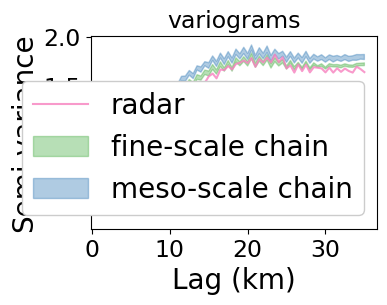

In [103]:

SMALL_SIZE = 17
MEDIUM_SIZE = 20
LARGE_SIZE = 17
# extract variogram values
pxdata_list = np.zeros((len(p_vlist),p_vlist[0].bins.shape[0]))
pydata_list = np.zeros((len(p_vlist),p_vlist[0].experimental.shape[0]))
fxdata_list = np.zeros((len(f_vlist),f_vlist[0].bins.shape[0]))
fydata_list = np.zeros((len(f_vlist),f_vlist[0].experimental.shape[0]))
for i in range(len(p_vlist)):
    pxdata_list[i] = p_vlist[i].bins
    pydata_list[i] = p_vlist[i].experimental
for i in range(len(f_vlist)):
    fxdata_list[i] = f_vlist[i].bins
    fydata_list[i] = f_vlist[i].experimental
# xdatasgs = V2_sgs.bins
# ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
# xdatabm = V2_bm.bins
# ydatabm = V2_bm.experimental
# xdatatrend = V2_trend.bins
# ydatatrend = V2_trend.experimental

pupperlimit = np.nanmax(pydata_list,axis=0)
plowerlimit = np.nanmin(pydata_list,axis=0)
fupperlimit = np.nanmax(fydata_list,axis=0)
flowerlimit = np.nanmin(fydata_list,axis=0)
#rangemean = np.nanmean(ydata_list,axis=0)

plt.figure(figsize=(3.7, 2.5))
axes = plt.axes()

#axes.plot(xdatasgs/1000,ydatasgs,lw=1,ls='-',marker='o',ms=2,c=colorblind_palette[0],alpha=0.6,label='SGS',zorder=1)
axes.plot(xdataradar/1000, ydataradar,lw=1.5,ls='-',c=colorblind_palette[3],alpha=0.8,label='radar',zorder=2)
#axes.plot(xdatabm/1000, ydatabm,lw=1,ls='-',marker='o',ms=2,c=colorblind_palette[8],alpha=0.6,label='BedMachine',zorder=1)
axes.fill_between(pxdata_list[0]/1000,pupperlimit,plowerlimit,alpha=0.4,color=colorblind_palette[2],label='fine-scale chain',zorder=1)
axes.fill_between(fxdata_list[0]/1000,fupperlimit,flowerlimit,alpha=0.4,color=colorblind_palette[0],label='meso-scale chain',zorder=1)
# axes.scatter(xdatasgs, ydatasgs, s=3, c='blue',alpha=0.7,label='SGS')
# axes.scatter(xdataradar, ydataradar, s=3, c='red',alpha=0.5, label='Radar')
# axes.scatter(xdatabm, ydatabm, s=3, c='magenta',alpha=0.5, label='BedMachine')
#axes.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')

axes.xaxis.set_tick_params(labelsize=SMALL_SIZE)
axes.yaxis.set_tick_params(labelsize=SMALL_SIZE)

axes.set_title('variograms',fontsize=LARGE_SIZE)
axes.legend(loc='lower right',fontsize=MEDIUM_SIZE,framealpha=1)
axes.set_xlabel('Lag (km)',fontsize=MEDIUM_SIZE)
axes.set_ylabel('Semi-variance',fontsize=MEDIUM_SIZE)

plt.savefig('variogram_compare_methodoverview.png',bbox_inches='tight',dpi=600)

In [158]:
# extract variogram values
xdata_list = np.zeros((len(vlist),vlist[0].bins.shape[0]))
ydata_list = np.zeros((len(vlist),vlist[0].experimental.shape[0]))
for i in range(len(vlist)):
    xdata_list[i] = vlist[i].bins
    ydata_list[i] = vlist[i].experimental
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
xdatatrend = V2_trend.bins
ydatatrend = V2_trend.experimental

upperlimit = np.nanmax(ydata_list,axis=0)
lowerlimit = np.nanmin(ydata_list,axis=0)
rangemean = np.nanmean(ydata_list,axis=0)

plt.figure(figsize=(6,4))
# for i in range(len(xdata_list)):
#     plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.3,label=str(i*5+1)+'th sgs chains')
plt.fill_between(xdata_list[0],upperlimit,lowerlimit,alpha=0.4,color='grey',label='sgs end topography range')
plt.plot(xdata_list[0],rangemean,color='grey')
plt.scatter(xdatasgs, ydatasgs, s=6, c='blue',alpha=0.7,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in grounded ice region')
plt.scatter(xdatabm, ydatabm, s=6, c='magenta',alpha=0.5, label='bedmachine in high velocity region')
plt.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')


plt.title('Experimental Subglacial Topography Variogram /n ',fontsize=18)
plt.legend(loc='lower right')
plt.xlabel('Lag (m)',fontsize=18); plt.ylabel('Semivariance',fontsize=18)  
plt.savefig('variogram_compare.png')

NameError: name 'V2_trend' is not defined

In [ ]:
# extract variogram values
xdata_list = np.zeros((len(vlist),vlist[0].bins.shape[0]))
ydata_list = np.zeros((len(vlist),vlist[0].experimental.shape[0]))
for i in range(len(vlist)):
    xdata_list[i] = vlist[i].bins
    ydata_list[i] = vlist[i].experimental
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
xdatatrend = V2_trend.bins
ydatatrend = V2_trend.experimental

upperlimit = np.nanmax(ydata_list,axis=0)
lowerlimit = np.nanmin(ydata_list,axis=0)
rangemean = np.nanmean(ydata_list,axis=0)

plt.figure(figsize=(6.7,4.2))
ax = plt.axes()
# for i in range(len(xdata_list)):
#     plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.3,label=str(i*5+1)+'th sgs chains')
ax.fill_between(xdata_list[0],upperlimit,lowerlimit,alpha=0.85,color='grey',label='Range of McMC-sampled \n topography ensemble')
ax.plot(xdata_list[0],rangemean,linewidth=1.8,color='black',label='Mean of McMC-sampled \n topography ensemble')
#ax.scatter(xdatasgs, ydatasgs, s=8, c='blue',alpha=0.7,label='SGS-generated \n topography')
ax.scatter(xdataradar, ydataradar, s=8, c='red',alpha=0.5, label='Radar')
ax.scatter(xdatabm, ydatabm, s=8, c='magenta',alpha=0.5, label='BedMachine')
#ax.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')


ax.set_title('Experimental subglacial topography variogram \n in fast-flowing region ',fontsize=18)
ax.set_xlabel('Lag (m)',fontsize=18); ax.set_ylabel('Semivariance',fontsize=18)  
ax.xaxis.set_tick_params(labelsize=16); ax.yaxis.set_tick_params(labelsize=16)
plt.legend(loc='lower right',fontsize=16,markerscale=3,bbox_to_anchor=(-.1,-.55))
plt.savefig('variogram_compare.png')

In [162]:
SMALL_SIZE = 22
MEDIUM_SIZE = 24

/scratch/local/58106237/ipykernel_3841700/1945806265.py:16: RuntimeWarning: All-NaN slice encountered
  upperlimit = np.nanmax(ydata_list,axis=0)
/scratch/local/58106237/ipykernel_3841700/1945806265.py:17: RuntimeWarning: All-NaN slice encountered
  lowerlimit = np.nanmin(ydata_list,axis=0)
/scratch/local/58106237/ipykernel_3841700/1945806265.py:18: RuntimeWarning: Mean of empty slice
  rangemean = np.nanmean(ydata_list,axis=0)


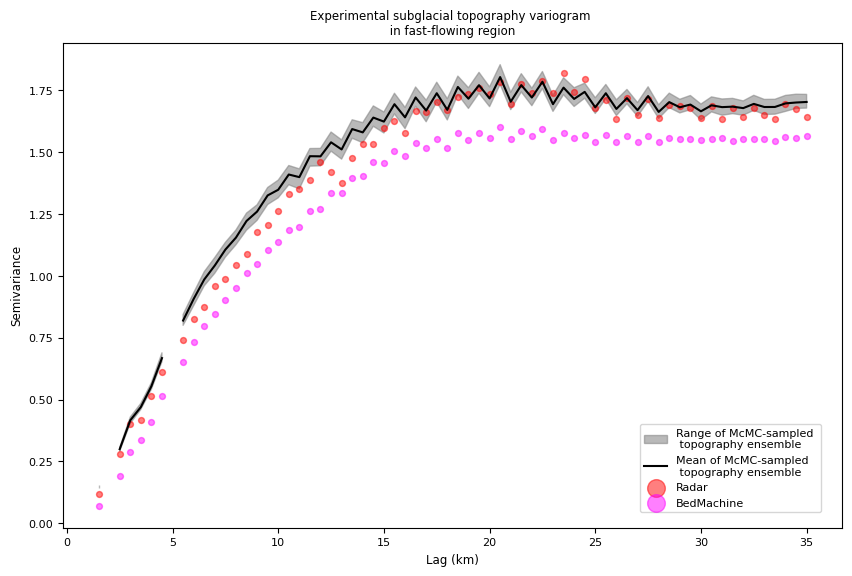

In [128]:
# extract variogram values
xdata_list = np.zeros((len(vlist),vlist[0].bins.shape[0]))
ydata_list = np.zeros((len(vlist),vlist[0].experimental.shape[0]))
for i in range(len(vlist)):
    xdata_list[i] = vlist[i].bins
    ydata_list[i] = vlist[i].experimental
#xdatasgs = V2_sgs.bins
#ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
#xdatatrend = V2_trend.bins
#ydatatrend = V2_trend.experimental

upperlimit = np.nanmax(ydata_list,axis=0)
lowerlimit = np.nanmin(ydata_list,axis=0)
rangemean = np.nanmean(ydata_list,axis=0)

plt.figure(figsize=(6.7*1.5,4.2*1.5))
ax = plt.axes()
# for i in range(len(xdata_list)):
#     plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.3,label=str(i*5+1)+'th sgs chains')
ax.fill_between(xdata_list[0]/1000,upperlimit,lowerlimit,alpha=0.55,color='grey',label='Range of McMC-sampled \n topography ensemble')
ax.plot(xdata_list[0]/1000,rangemean,linewidth=1.5,color='black',label='Mean of McMC-sampled \n topography ensemble')
#ax.scatter(xdatasgs, ydatasgs, s=8, c='blue',alpha=0.7,label='SGS-generated \n topography')
ax.scatter(xdataradar/1000, ydataradar, s=18, c='red',alpha=0.5, label='Radar')
ax.scatter(xdatabm/1000, ydatabm, s=18, c='magenta',alpha=0.5, label='BedMachine')
#ax.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')


ax.set_title('Experimental subglacial topography variogram \n in fast-flowing region ',fontsize=MEDIUM_SIZE)
ax.set_xlabel('Lag (km)',fontsize=MEDIUM_SIZE); ax.set_ylabel('Semivariance',fontsize=MEDIUM_SIZE)  
ax.xaxis.set_tick_params(labelsize=SMALL_SIZE); ax.yaxis.set_tick_params(labelsize=SMALL_SIZE)
plt.legend(loc='lower right',fontsize=SMALL_SIZE,markerscale=3,bbox_to_anchor=(0.98,0.02))
plt.savefig('variogram_compare.png',bbox_inches='tight',dpi=600)

In [ ]:
x = np.array(
      [[0, 0, 0, 0, 0],
       [0, 1, 1, 1, 0],
       [0, 1, 1, 1, 0],
       [0, 1, 1, 1, 0],
       [0, 0, 0, 0, 0]])

fil = [[-1,-1,-1],
       [-1, 8,-1],
       [-1,-1,-1]]

np.where(convolve(x,fil, mode='constant') > 1)

In [ ]:
# extract variogram values
xdata_list = np.zeros((len(vlist),vlist[0].bins.shape[0]))
ydata_list = np.zeros((len(vlist),vlist[0].experimental.shape[0]))
for i in range(len(vlist)):
    xdata_list[i] = vlist[i].bins
    ydata_list[i] = vlist[i].experimental
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
#xdatatrend = V2_trend.bins
#ydatatrend = V2_trend.experimental

upperlimit = np.nanmax(ydata_list,axis=0)
lowerlimit = np.nanmin(ydata_list,axis=0)

plt.figure(figsize=(6,4))
# for i in range(len(xdata_list)):
#     plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.3,label=str(i*5+1)+'th sgs chains')
plt.fill_between(xdata_list[0],upperlimit,lowerlimit,alpha=0.6,color='grey',label='sgs end topography range')
plt.scatter(xdatasgs, ydatasgs, s=6, c='blue',alpha=0.7,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in grounded ice region')
plt.scatter(xdatabm, ydatabm, s=6, c='magenta',alpha=0.5, label='bedmachine in high velocity region')
#plt.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')


plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(loc='lower right')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

In [ ]:
# extract variogram values
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
xdatatrend = V2_trend.bins
ydatatrend = V2_trend.experimental

plt.figure(figsize=(6,4))
plt.scatter(xdatasgs, ydatasgs, s=6, c='blue',alpha=0.8,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in the resampling region')
plt.scatter(xdatabm, ydatabm, s=6, c='magenta',alpha=0.5, label='bedmachine in the resampling region')
plt.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trenc')


plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(bbox_to_anchor=(-.1,-.55), loc='lower left')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

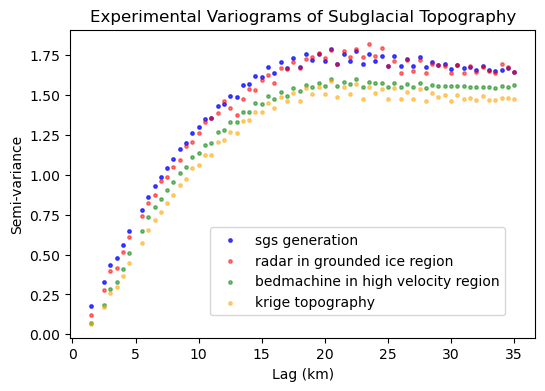

In [181]:
# extract variogram values
# xdata_list = np.zeros((len(vlist),vlist[0].bins.shape[0]))
# ydata_list = np.zeros((len(vlist),vlist[0].experimental.shape[0]))
# for i in range(len(vlist)):
#     xdata_list[i] = vlist[i].bins
#     ydata_list[i] = vlist[i].experimental
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
# xdatatrend = V2_trend.bins
# ydatatrend = V2_trend.experimental
xdatakrig = V2_krig.bins
ydatakrig = V2_krig.experimental

# upperlimit = np.nanmax(ydata_list,axis=0)
# lowerlimit = np.nanmin(ydata_list,axis=0)

plt.figure(figsize=(6,4))
# for i in range(len(xdata_list)):
# #     plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.3,label=str(i*5+1)+'th sgs chains')
# plt.fill_between(xdata_list[0],upperlimit,lowerlimit,alpha=0.6,color='grey',label='sgs end topography range')
plt.scatter(xdatasgs/1000, ydatasgs, s=6, c='blue',alpha=0.7,label='sgs generation')
plt.scatter(xdataradar/1000, ydataradar, s=6, c='red',alpha=0.5, label='radar in grounded ice region')
plt.scatter(xdatabm/1000, ydatabm, s=6, c='green',alpha=0.5, label='bedmachine in high velocity region')
plt.scatter(xdatakrig/1000,ydatakrig,s=6,c='orange',alpha=0.5, label='krige topography')
# plt.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')


plt.title('Experimental Variograms of Subglacial Topography')
plt.legend(bbox_to_anchor=(.95,.05), loc='lower right')
plt.xlabel('Lag (km)'); plt.ylabel('Semi-variance')  
plt.savefig('prospectus_variograms.png')

In [240]:
# extract variogram values
xdata_list = np.zeros((len(vlist),vlist[0].bins.shape[0]))
ydata_list = []
for i in range(len(vlist)):
    xdata_list.append(vlist[i].bins)
    ydata_list.append(vlist[i].experimental)
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental
xdatatrend = V2_trend.bins
ydatatrend = V2_trend.experimental

upperlimit = np.nanmax(ydata_list)

plt.figure(figsize=(6,4))
for i in range(len(xdata_list)):
    plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.3,label=str(i*5+1)+'th sgs chains')
plt.scatter(xdatasgs, ydatasgs, s=6, c='blue',alpha=0.7,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in grounded ice region')
plt.scatter(xdatabm, ydatabm, s=6, c='magenta',alpha=0.5, label='bedmachine in high velocity region')
plt.scatter(xdatatrend, ydatatrend, s=6, c='lightgreen',alpha=0.8, label='crf trend')


plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(bbox_to_anchor=(-.25,-.55), loc='lower left')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

AttributeError: 'numpy.ndarray' object has no attribute 'append'

In [484]:
bed_bm = df_bm.bed.values.reshape(xx.shape) - variogram_trend.reshape(xx.shape)
bed_bm = bed_bm[mc_region_mask==1].reshape(-1,1)
exclude_out_dist = ~((bed_bm > vr_max)|(bed_bm < vr_min))
data = bed_bm[exclude_out_dist.flatten()]

df_bed_variogram = df.copy()
df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
coords = df_bed_variogram[['X','Y']].values
coords = coords[exclude_out_dist.flatten(),:]

#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_bm = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, 
                      normalize=False, model='spherical',samples=0.6,estimator='dowd')
print(V2_bm.parameters)

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


[27236.68299596402, 1.7955915284613548, 0]


In [440]:
# nth_iter = [1,4000,8000,9000,10000,11000] #what variogram at which interval you want to see
vlist = []
for n in range(0,last_beds.shape[0],5):
    bed_test = last_beds[n,:,:] - variogram_trend.reshape(xx.shape)
    bed_test = bed_test[mc_region_mask==1].reshape(-1,1)
    exclude_out_dist = ~((bed_test > vr_max)|(bed_test < vr_min))
    data = bed_test[exclude_out_dist.flatten()]
    
    df_bed_variogram = df.copy()
    df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
    coords = df_bed_variogram[['X','Y']].values
    coords = coords[exclude_out_dist.flatten(),:]
    
    #nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
    values = nst_trans_test.transform(data).T[0] # still use radar normal transformation

    V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, model='spherical',samples=0.6,estimator='dowd')
    print(n, V2_test.parameters)
    vlist.append(V2_test)

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


0 [25563.690403533696, 2.224138400720655, 0]


/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


5 [25847.187015889536, 2.202564493556449, 0]


/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


10 [25550.15339321791, 2.1948973474339253, 0]


/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


15 [25406.9200715079, 2.21657253121098, 0]


In [441]:
bed_sgs = np.loadtxt("./38_sgs/sgs_bed_38_3.txt") - variogram_trend.reshape(xx.shape)
bed_sgs = bed_sgs[mc_region_mask==1].reshape(-1,1)
exclude_out_dist = ~((bed_sgs > vr_max)|(bed_sgs < vr_min))
data = bed_sgs[exclude_out_dist.flatten()]

df_bed_variogram = df.copy()
df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
coords = df_bed_variogram[['X','Y']].values
coords = coords[exclude_out_dist.flatten(),:]

#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal", subsample=100000, random_state=0).fit(data)
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
V2_sgs = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, maxlag=maxlag, normalize=False, 
                       model='spherical',samples=0.6,estimator='dowd')
print(V2_sgs.parameters)

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


[21798.86737554241, 2.1638080530334873, 0]


In [442]:
color = ['#377eb8', '#ff7f00', '#4daf4a',
          '#f781bf', '#a65628', '#984ea3',
          '#999999', '#e41a1c', '#dede00','#57bee8',
        '#377eb8', '#ff7f00', '#4daf4a',
          '#f781bf', '#a65628', '#984ea3',
          '#999999', '#e41a1c', '#dede00','#57bee8',
        '#377eb8', '#ff7f00', '#4daf4a',
          '#f781bf', '#a65628', '#984ea3',
          '#999999', '#e41a1c', '#dede00','#57bee8']

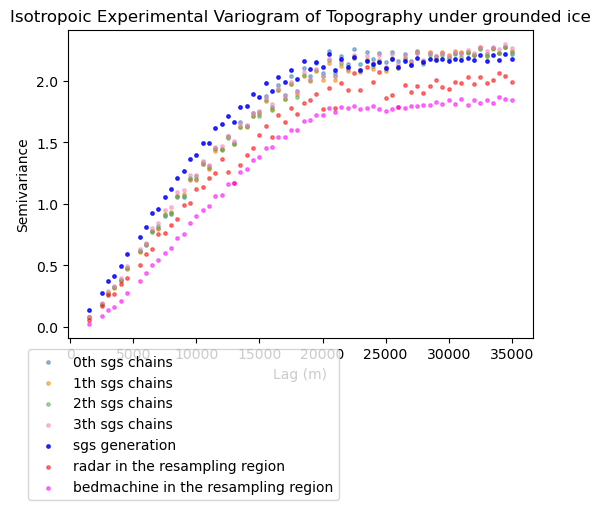

In [443]:
# extract variogram values
xdata_list = []
ydata_list = []
for i in range(len(vlist)):
    xdata_list.append(vlist[i].bins)
    ydata_list.append(vlist[i].experimental)
xdatasgs = V2_sgs.bins
ydatasgs = V2_sgs.experimental
xdataradar = V2_radar.bins
ydataradar = V2_radar.experimental
xdatabm = V2_bm.bins
ydatabm = V2_bm.experimental

plt.figure(figsize=(6,4))
for i in range(len(xdata_list)):
    plt.scatter(xdata_list[i],ydata_list[i],s=6,c=color[i],alpha=0.5,label=str(i)+'th sgs chains')
plt.scatter(xdatasgs, ydatasgs, s=6, c='blue',alpha=0.8,label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red',alpha=0.5, label='radar in the resampling region')
plt.scatter(xdatabm, ydatabm, s=6, c='magenta',alpha=0.5, label='bedmachine in the resampling region')


plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(bbox_to_anchor=(-.1,-.55), loc='lower left')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

#### average bed test

In [187]:
avg_beds = np.loadtxt("./bed_cache_38_3_40"+".txt")
avg_beds = avg_beds.reshape(np.round(avg_beds.size/(rows*cols)).astype(int), rows, cols)
avg_bed = np.mean(avg_beds, axis=0)

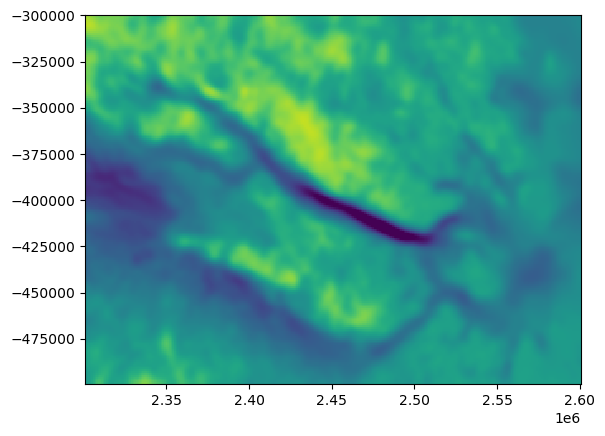

In [189]:
bed_avged_filtered = sp.ndimage.gaussian_filter(avg_bed, sigma=2)
plt.pcolormesh(xx,yy,bed_avged_filtered,vmax=2000,vmin=-2500)

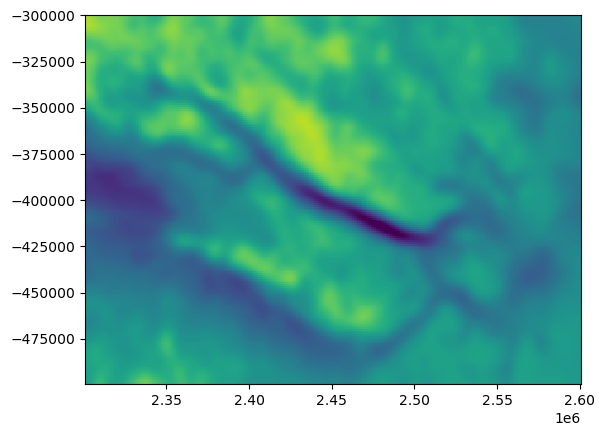

In [190]:
bed_avged_filtered = sp.ndimage.gaussian_filter(avg_bed, sigma=3)
plt.pcolormesh(xx,yy,bed_avged_filtered,vmax=2000,vmin=-2500)

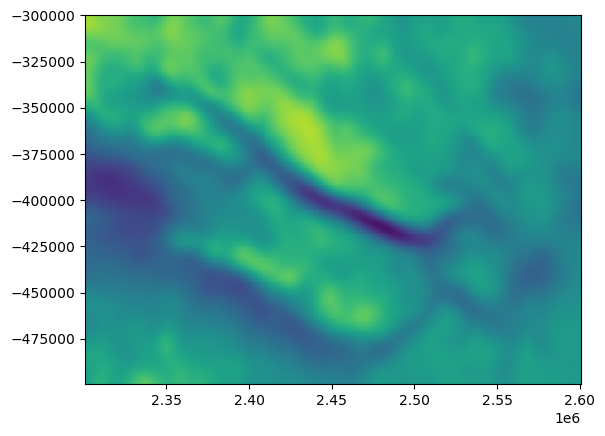

In [191]:
bed_avged_filtered = sp.ndimage.gaussian_filter(avg_bed, sigma=4)
plt.pcolormesh(xx,yy,bed_avged_filtered,vmax=2000,vmin=-2500)

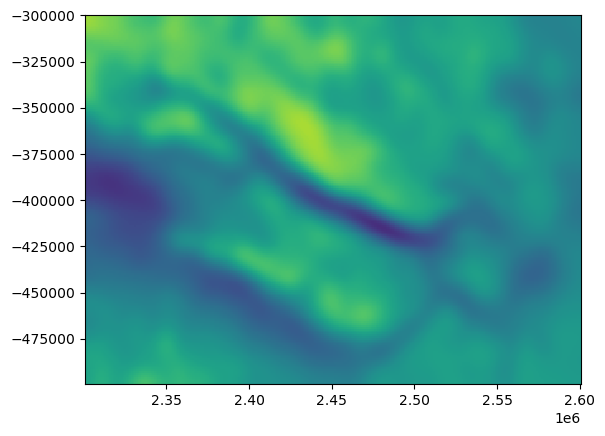

In [192]:
bed_avged_filtered = sp.ndimage.gaussian_filter(avg_bed, sigma=5)
plt.pcolormesh(xx,yy,bed_avged_filtered,vmax=2000,vmin=-2500)

#### variogram for all topography = res + trend

In [398]:
loaded_bed.shape

(400, 100, 100)

In [135]:
nth_iter = [1,0] #what variogram at which interval you want to see
vlist = []
for n in nth_iter:
    bed_test = loaded_bed[n-1]
    
    #everything in the resampling area
    resample_mask = df['mask'].values
    data = bed_test.reshape(-1,1) #normalize by all data
    
    nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data)
    values = nst_trans_test.transform(data).T[0]
    values = values[resample_mask == 1] #after normalization, cut resampling area out
    
    df_bed_variogram = df.copy()
    df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
    coords = df_bed_variogram[['X','Y']].values
    
    maxlag = 30000             # maximum range distance
    n_lags = 70                # num of bins

    V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, samples=0.5, estimator='dowd')
    print(n, V2_test.parameters)
    vlist.append(V2_test)

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


1 [23642.735868778876, 1.020498834144408, 0]


/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


0 [29999.999999999996, 0.9723593468423681, 0]


In [88]:
nth_iter = [1,301,900] #what variogram at which interval you want to see
vlist = []
for n in nth_iter:
    bed_test = loaded_bed[n-1]
    
    #everything in the resampling area
    resample_mask = df['mask'].values
    data = bed_test.reshape(-1,1) #normalize by all data
    
    nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data)
    values = nst_trans_test.transform(data).T[0]
    values = values[resample_mask == 1] #after normalization, cut resampling area out
    
    df_bed_variogram = df.copy()
    df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
    coords = df_bed_variogram[['X','Y']].values
    
    maxlag = 30000             # maximum range distance
    n_lags = 70                # num of bins

    V2_test = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, samples=0.5)
    print(n, V2_test.parameters)
    vlist.append(V2_test)

1 [20982.590326417594, 0.5645607465713377, 0]
301 [26686.006085183155, 0.5816980875760613, 0]
900 [27286.597493706977, 0.5653135727507186, 0]


In [449]:
df_bm = pd.read_csv('Aurora_bedmachine_data.csv')
df_bm = df_bm[(df_bm['x']>2200000) & (df_bm['x']<=2300000) & (df_bm['y']>-980000) & (df_bm['y']<=-880000)]
df_bm.index = pd.RangeIndex(len(df_bm.index))
df_bm.index = range(len(df_bm.index))

In [450]:
data_bm = df_bm['bed'].values.reshape(-1,1)
nst_trans_bm = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data_bm)

In [451]:
# compute experimental (isotropic) variogram, variogram should only contain roughness of the grounded ice topogrpahy
df_bm_variogram = df_bm[df['mask']==1]
coords = df_bm_variogram[['x','y']].values
data_bm = df_bm_variogram['bed'].values.reshape(-1,1)
values = nst_trans_bm.transform(data_bm).T[0]

maxlag = 30000             # maximum range distance
n_lags = 70                # num of bins

V1_bm_bm = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, samples=0.5, estimator='dowd')
V1_bm_bm.parameters

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


[29999.999999999996, 0.7865221956430106, 0]

In [117]:
# # compute experimental (isotropic) variogram that only contain roughness of the grounded ice topogrpahy in the mask
# df_bm_variogram = df_bm[df_bm['mask']==1]
# coords = df_bm_variogram[['x','y']].values
# data_bm = df_bm_variogram['bed'].values.reshape(-1,1)
# values = nst_trans_bm.transform(data_bm).T[0]

# maxlag = 70000             # maximum range distance
# n_lags = 70                # num of bins

# V2_bm_bm = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
#                    maxlag=maxlag, normalize=False)

# V2_bm_bm.parameters

In [452]:
# compute the variogram of all topography under grounded ice
df_variogram = df[df["bed"].isnull() == False].copy()
data = df_variogram['bed'].values.reshape(-1,1)
nst_trans_radar = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data)
df_variogram['vario_test']=nst_trans_radar.transform(data)

In [453]:
# compute experimental (isotropic) variogram, variogram should only contain roughness of the grounded ice topogrpahy
df_variogram = df_variogram[(df_variogram['bedmachine_mask']==2) & (df_variogram['vario_test'].isnull()==False)]
coords = df_variogram[['X','Y']].values
values = df_variogram['vario_test'].values
maxlag = 60000             # maximum range distance
n_lags = 70                # num of bins
V1_radar1 = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False)
V1_radar1.parameters

[56524.65174221307, 1.0954963155378696, 0]

In [454]:
# compute the variogram of all topography under grounded ice
df_variogram = df[df["bed"].isnull() == False].copy()
data = df_variogram['bed'].values.reshape(-1,1)
nst_trans_radar = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data)
df_variogram['vario_test']=nst_trans_radar.transform(data)

In [455]:
# compute experimental (isotropic) variogram, variogram should only contain roughness of the grounded ice topogrpahy
df_variogram = df_variogram[(df_variogram['mask']==1) & (df_variogram['vario_test'].isnull()==False)]
coords = df_variogram[['X','Y']].values
values = df_variogram['vario_test'].values
maxlag = 30000             # maximum range distance
n_lags = 70                # num of bins
V1_radar = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
                   maxlag=maxlag, normalize=False, samples=0.5, estimator='dowd')
V1_radar.parameters

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


[29999.999999999996, 1.1221246948013743, 0]

In [98]:
# use exponential variogram model
V1_radar.model = 'exponential' 
V2 = V1_radar
V2.model = 'gaussian' 
V3 = V1_radar
V3.model = 'spherical'
print(V1_radar.parameters, V2.parameters, V3.parameters)

[56221.51617219254, 0.9866852543841803, 0] [56221.51617219254, 0.9866852543841803, 0] [56221.51617219254, 0.9866852543841803, 0]


In [105]:
xdata = V1_radar.bins
ydata = V1_radar.experimental

In [107]:
# evaluate models
xi =np.linspace(0, xdata[-1], 100) 

y_exp = [skg.models.exponential(h, V1_radar.parameters[0], V1_radar.parameters[1], V1_radar.parameters[2]) for h in xi]
y_gauss = [skg.models.gaussian(h, V2.parameters[0], V2.parameters[1], V2.parameters[2]) for h in xi]
y_sph = [skg.models.spherical(h, V3.parameters[0], V3.parameters[1], V3.parameters[2]) for h in xi]

In [458]:
bed_test = np.loadtxt('aurora_nonresidual_sim_28.txt')
resample_mask = df['mask'].values
data = bed_test.reshape(-1,1)

nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data)
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
values = values[resample_mask == 1]

df_bed_variogram = df.copy()
df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
coords = df_bed_variogram[['X','Y']].values

maxlag = 30000             # maximum range distance
n_lags = 70                # num of bins

V1_sgs = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
               maxlag=maxlag, normalize=False, samples=0.5, estimator='dowd')
print(V1_sgs.parameters)

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


[29999.999999999996, 0.9165701835499074, 0]


In [459]:
resample_mask = df['mask'].values

In [460]:
bed_test = np.loadtxt('tottenzoom_simnonres1.txt')
resample_mask = df['mask'].values
data = bed_test.flatten()

#nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data)
#values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
values = data[resample_mask == 1]

df_bed_variogram = df.copy()
df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
coords = df_bed_variogram[['X','Y']].values

maxlag = 30000             # maximum range distance
n_lags = 70                # num of bins

V1_sgs = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
               maxlag=maxlag, normalize=False, samples=0.5, estimator='dowd')
print(V1_sgs.parameters)

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


[29999.999999999996, 1.1281921381479914, 0]


In [461]:
data

array([ 0.26179431,  0.00889049, -0.15805359, ...,  1.66108748,
        1.56468822,  1.61951816])

In [462]:
bed_test.shape

(10000,)

In [464]:
bed_test = np.loadtxt('tottenzoom_ok_est.txt')
resample_mask = df['mask'].values
data = bed_test.reshape(-1,1)

nst_trans_test = QuantileTransformer(n_quantiles=500, output_distribution="normal").fit(data)
values = nst_trans_test.transform(data).T[0] # still use radar normal transformation
values = values[resample_mask == 1]

df_bed_variogram = df.copy()
df_bed_variogram = df_bed_variogram[df_bed_variogram['mask']==1]
coords = df_bed_variogram[['X','Y']].values

maxlag = 30000             # maximum range distance
n_lags = 70                # num of bins

V1_ok = skg.Variogram(coords, values, bin_func='even', n_lags=n_lags, 
               maxlag=maxlag, normalize=False, samples=0.5, estimator='dowd')
print(V1_ok.parameters)

/blue/emackie/niyashao/conda/envs/GStatsSim/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1215: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


[29999.999999999996, 0.8431960524552763, 0]


In [465]:
CB_color = ['#377eb8', '#ff7f00', '#4daf4a',
                  '#f781bf', '#a65628', '#984ea3',
                  '#999999', '#e41a1c', '#dede00']

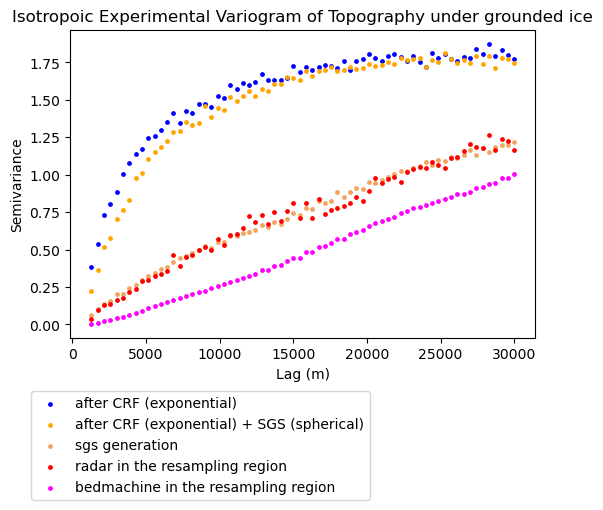

In [466]:
# extract variogram values
xdata0 = vlist[0].bins
ydata0 = vlist[0].experimental
xdata1 = vlist[1].bins
ydata1 = vlist[1].experimental
# xdata2 = vlist[2].bins
# ydata2 = vlist[2].experimental
#xdata3 = vlist[3].bins
#ydata3 = vlist[3].experimental
#xdata4 = vlist[4].bins
#ydata4 = vlist[4].experimental
#xdata5 = vlist[5].bins
#ydata5 = vlist[5].experimental
#xdata6 = vlist[6].bins
#ydata6 = vlist[6].experimental
#xdata7 = vlist[7].bins
#ydata7 = vlist[7].experimental
xdatasgs = V1_sgs.bins
ydatasgs = V1_sgs.experimental
#xdatasgs = vlist[0].bins
#ydatasgs = vlist[0].experimental
#xdataradar1 = V1_radar1.bins
#ydataradar1 = V1_radar1.experimental
xdataradar = V1_radar.bins
ydataradar = V1_radar.experimental
xdatabm = V1_bm_bm.bins
ydatabm = V1_bm_bm.experimental
#xdataok = V1_ok.bins
#ydataok = V1_ok.experimental

plt.figure(figsize=(6,4))
plt.scatter(xdata0, ydata0, s=6, c='blue', label='after CRF (exponential)')
plt.scatter(xdata1, ydata1, s=6, c='orange', label='after CRF (exponential) + SGS (spherical)')
#plt.scatter(xdata2, ydata2, s=6, c='lightgreen', label='8000th iter CRF (exponential)')
#plt.scatter(xdata3, ydata3, s=6, c='green', label='4000th iter CRF (exponential)')
#plt.scatter(xdata4, ydata4, s=6, c='cyan', label='10000th iter CRF')
#plt.scatter(xdata5, ydata5, s=6, c='lightblue', label='8000 iter CRF (exponential) + 40000 iter SGS (spherical)')
#plt.scatter(xdata6, ydata6, s=6, c='purple', label='14000th iter CRF')
#plt.scatter(xdata7, ydata7, s=6, c='magenta', label='16000th iter CRF')
plt.scatter(xdatasgs, ydatasgs, s=6, c='sandybrown', label='sgs generation')
plt.scatter(xdataradar, ydataradar, s=6, c='red', label='radar in the resampling region') # radar is exactly same to sgs
#plt.scatter(xdataradar1, ydataradar1, s=6, c='purple', label='radar in the over all domain') # radar is exactly same to sgs
plt.scatter(xdatabm, ydatabm, s=6, c='magenta', label='bedmachine in the resampling region') # radar is exactly same to sgs


plt.title('Isotropoic Experimental Variogram of Topography under grounded ice')
plt.legend(bbox_to_anchor=(-.1,-.55), loc='lower left')
plt.xlabel('Lag (m)'); plt.ylabel('Semivariance')  
plt.show()

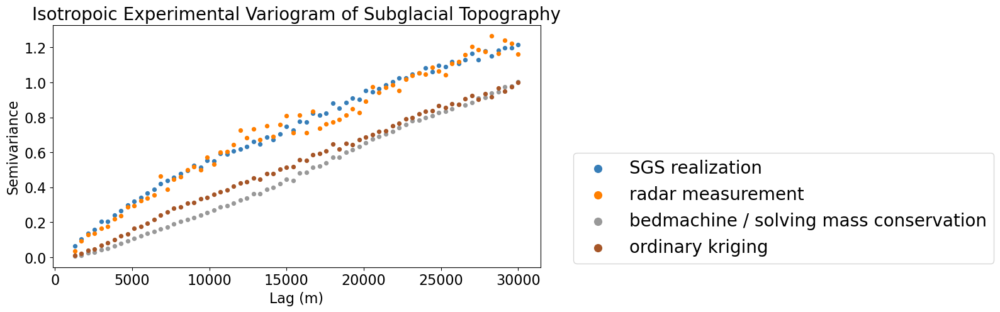

In [471]:
# # extract variogram values
# xdata0 = vlist[0].bins
# ydata0 = vlist[0].experimental
# xdata1 = vlist[1].bins
# ydata1 = vlist[1].experimental
# xdata2 = vlist[2].bins
# ydata2 = vlist[2].experimental
#xdata3 = vlist[3].bins
#ydata3 = vlist[3].experimental
#xdata4 = vlist[4].bins
#ydata4 = vlist[4].experimental
#xdata5 = vlist[5].bins
#ydata5 = vlist[5].experimental
#xdata6 = vlist[6].bins
#ydata6 = vlist[6].experimental
#xdata7 = vlist[7].bins
#ydata7 = vlist[7].experimental
xdatasgs = V1_sgs.bins
ydatasgs = V1_sgs.experimental
#xdatasgs = vlist[0].bins
#ydatasgs = vlist[0].experimental
#xdataradar1 = V1_radar1.bins
#ydataradar1 = V1_radar1.experimental
xdataradar = V1_radar.bins
ydataradar = V1_radar.experimental
xdatabm = V1_bm_bm.bins
ydatabm = V1_bm_bm.experimental
xdataok = V1_ok.bins
ydataok = V1_ok.experimental

plt.figure(figsize=(10,5))
#plt.scatter(xdata0, ydata0, s=6, c='blue', label='after CRF (exponential)')
#plt.scatter(xdata1, ydata1, s=6, c='orange', label='after CRF (exponential) + SGS (spherical)')
#plt.scatter(xdata2, ydata2, s=6, c='lightgreen', label='8000th iter CRF (exponential)')
#plt.scatter(xdata3, ydata3, s=6, c='green', label='4000th iter CRF (exponential)')
#plt.scatter(xdata4, ydata4, s=6, c='cyan', label='10000th iter CRF')
#plt.scatter(xdata5, ydata5, s=6, c='lightblue', label='8000 iter CRF (exponential) + 40000 iter SGS (spherical)')
#plt.scatter(xdata6, ydata6, s=6, c='purple', label='14000th iter CRF')
#plt.scatter(xdata7, ydata7, s=6, c='magenta', label='16000th iter CRF')
plt.scatter(xdatasgs, ydatasgs, s=18, c=CB_color[0], label='SGS realization')
plt.scatter(xdataradar, ydataradar, s=18, c=CB_color[1], label='radar measurement') # radar is exactly same to sgs
#plt.scatter(xdataradar1, ydataradar1, s=6, c='purple', label='radar in the over all domain') # radar is exactly same to sgs
plt.scatter(xdatabm, ydatabm, s=18, c=CB_color[6], label='bedmachine / solving mass conservation') # radar is exactly same to sgs
plt.scatter(xdataok, ydataok, s=18, c=CB_color[4], label='ordinary kriging') # radar is exactly same to sgs

plt.title('Isotropoic Experimental Variogram of Subglacial Topography', fontsize=20)
plt.legend(bbox_to_anchor=(1.05,-.02), loc='lower left', fontsize=20, markerscale=2)
plt.xlabel('Lag (m)', fontsize=16); plt.ylabel('Semivariance', fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('tottenzoom_variogram_nonres_compare.png', bbox_inches='tight')

### Revised Multivariate R

In [87]:
p = np.sum(np.logical_and(cond_mask==0,resampling_mask==1))
num_chains = 4
file_postfix_allchain = [['_13_1','_13_2'],['_16_3','_16_4'],['_16_5','_16_6'],['_16_7','_16_8']]
n_iter_allchain = [[1000,1000],[1000,1000],[1000,1000],[1000,1000]]

chains = np.zeros([num_chains, p, np.sum(n_iter_allchain[0])])

for idx_chain in range(num_chains):
    
    n_iter_list = n_iter_allchain[idx_chain]
    file_postfix_list = file_postfix_allchain[idx_chain]
    loaded_bed = np.zeros((np.sum(n_iter_list), rows, cols))
    
    for i in range(len(n_iter_list)):
        file_postfix = file_postfix_list[i]
        loaded_bed_temp = np.loadtxt("bed_cache"+file_postfix+".txt")
        loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
        loaded_bed[int(np.sum(n_iter_list[:i])):int(np.sum(n_iter_list[:i+1])),:,:] = loaded_bed_temp

    chains[idx_chain] = np.array([loaded_bed[k,:,:][np.logical_and(cond_mask==0,resampling_mask==1)] 
                              for k in range(loaded_bed.shape[0])]).T

In [88]:
#chains.shape = (number of chains, number of parameter, number of iterations in each chains)

def revised_R_multivariate(chains):
    num_chains = chains.shape[0]
    p=chains.shape[1]
    n_iters=chains.shape[2]

    batch_size = int(np.sqrt(n_iters)) # b=square root(num_iters) or b=cubic root(num_iters)
    num_batch = int(n_iters / batch_size) # round down

    batch_size_d3 = int(batch_size/3) # b/3
    num_batch_d3 = int(n_iters / batch_size_d3) # round down

    W = np.zeros([p, p])
    T = np.zeros([p, p])
    Td3 = np.zeros([p, p]) #T_(d/3)

    overall_mean_val = np.mean(chains,axis=(0,2)) #mean of every parameters

    for idx_chain in range(num_chains):
        chain = chains[idx_chain]

        cov = np.cov(chain)
        W = W + cov

        chain_t = chain[:,chain.shape[1] - batch_size * num_batch:] #discard the first few iterations for calculation of T, such that the length of chain is dividable by batch size
        batch_mean = np.array([np.mean(chain_t[:,k*batch_size:(k+1)*batch_size], axis=1) for k in range(num_batch)]).T
        bcov = np.matmul(batch_mean - overall_mean_val[:,None], np.transpose(batch_mean - overall_mean_val[:,None]))
        T = T+bcov

        chain_td3 = chain[:,chain.shape[1] - batch_size_d3 * num_batch_d3:]
        batch_mean = np.array([np.mean(chain_td3[:,k*batch_size_d3:(k+1)*batch_size_d3], axis=1) for k in range(num_batch_d3)]).T
        bcov = np.matmul(batch_mean - overall_mean_val[:,None], np.transpose(batch_mean - overall_mean_val[:,None]))
        Td3 = Td3+bcov

    Td3 = Td3 * (batch_size_d3/(num_batch_d3*num_chains-1))
    T = T * (batch_size/(num_batch*num_chains-1))
    W = W / num_chains
    
    TL = 2*T - Td3
    SIGMA = ((n_iters-1)/n_iters) * W + (TL / n_iters)
    (signTL, logabsdetTL) = np.linalg.slogdet(TL)
    (signS, logabsdetS) = np.linalg.slogdet(SIGMA)
    det = np.exp((logabsdetTL - logabsdetS)/p) #* np.power(signTL*signS, 1/p)
    mvPSRF = np.sqrt(((n_iters-1)/n_iters) + (det/n_iters))
    
    imaginary = signTL*signS
    #if imaginary is -1 (aka one of the determinant is neg), then
    #det is an imaginary number, and result contain imaginary part
    
    return mvPSRF, imaginary 

In [89]:
num_chains = chains.shape[0]
p=chains.shape[1]
n_iters=chains.shape[2]

batch_size = int(np.sqrt(n_iters)) # b=square root(num_iters) or b=cubic root(num_iters)
num_batch = int(n_iters / batch_size) # round down

batch_size_d3 = int(batch_size/3) # b/3
num_batch_d3 = int(n_iters / batch_size_d3) # round down

W = np.zeros([p, p])
T = np.zeros([p, p])
Td3 = np.zeros([p, p]) #T_(d/3)

overall_mean_val = np.mean(chains,axis=(0,2)) #mean of every parameters

for idx_chain in range(num_chains):
    chain = chains[idx_chain]

    cov = np.cov(chain)
    W = W + cov

    chain_t = chain[:,chain.shape[1] - batch_size * num_batch:] #discard the first few iterations for calculation of T, such that the length of chain is dividable by batch size
    batch_mean = np.array([np.mean(chain_t[:,k*batch_size:(k+1)*batch_size], axis=1) for k in range(num_batch)]).T
    bcov = np.matmul(batch_mean - overall_mean_val[:,None], np.transpose(batch_mean - overall_mean_val[:,None]))
    T = T+bcov

    chain_td3 = chain[:,chain.shape[1] - batch_size_d3 * num_batch_d3:]
    batch_mean = np.array([np.mean(chain_td3[:,k*batch_size_d3:(k+1)*batch_size_d3], axis=1) for k in range(num_batch_d3)]).T
    bcov = np.matmul(batch_mean - overall_mean_val[:,None], np.transpose(batch_mean - overall_mean_val[:,None]))
    Td3 = Td3+bcov

Td3 = Td3 * (batch_size_d3/(num_batch_d3*num_chains-1))
T = T * (batch_size/(num_batch*num_chains-1))
W = W / num_chains

TL = 2*T - Td3
SIGMA = ((n_iters-1)/n_iters) * W + (TL / n_iters)
(signTL, logabsdetTL) = np.linalg.slogdet(TL)
(signS, logabsdetS) = np.linalg.slogdet(SIGMA)
det = np.exp((logabsdetTL - logabsdetS)/p) #* np.power(signTL*signS, 1/p)
mvPSRF = np.sqrt(((n_iters-1)/n_iters) + (det/n_iters))

imaginary = signTL*signS

In [90]:
np.linalg.slogdet(TL)

(-1.0, -25467.929408929096)

In [91]:
np.linalg.matrix_rank(TL)

712

In [92]:
np.linalg.slogdet(SIGMA)

(1.0, -17813.982783843403)

In [93]:
np.linalg.matrix_rank(SIGMA)

1335

In [94]:
TL.shape

(2481, 2481)

In [95]:
mvPSRF

0.9997614037604259

In [66]:
revised_R_multivariate(chains)

NameError: name 'num_iters' is not defined

In [508]:
#arr = np.array([np.transpose([[1,2,3],[8,6,8],[3,1,2]]),np.transpose([[7,8,9],[10,11,12],[3,1,2]])])
arr = np.array([[[1,2,3],[8,6,8]]])
arr_mean = np.mean(arr[0],axis=1)
np.sum(np.array([np.outer((arr[0,:,k] - arr_mean),(arr[0,:,k] - arr_mean)) for k in range(arr.shape[2])]),axis=0)

array([[2.        , 0.        ],
       [0.        , 2.66666667]])

In [525]:
np.cov(arr[0])

array([[1.        , 0.        ],
       [0.        , 1.33333333]])

In [561]:
np.array(np.matmul((arr[0]-arr_mean[:,None]),np.transpose(arr[0]-arr_mean[:,None])))

array([[2.        , 0.        ],
       [0.        , 2.66666667]])

In [ ]:
# cite(Revisiting the Gelman-Rubin Diagnostic)

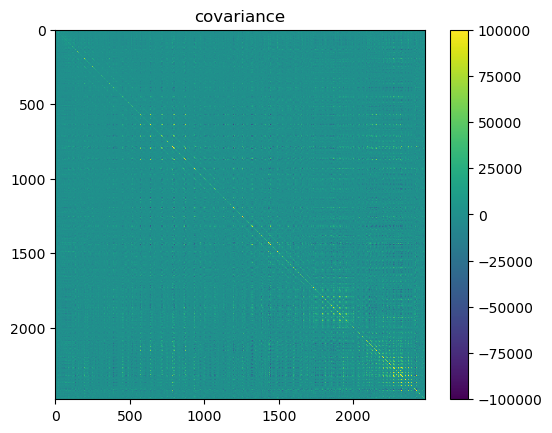

In [197]:
c = plt.imshow(W, interpolation ='nearest', origin ='upper', vmax=100000, vmin=-100000) 
plt.colorbar(c) 
plt.title('covariance') 
plt.show() 

### check untranformed random fields

In [12]:
trend = np.loadtxt('59_crf/trend_59_crf.txt')
df['residual']=df['bed'].values-trend.flatten()

range, sill, and nugget for gaussian variogram is  [8816.809598311293, 0.953742517101954, 0]
for exponential variogram is  [13283.786723510086, 1.0021400232675977, 0]
for spherical variogram is  [10231.133893248034, 0.9626210927349484, 0]


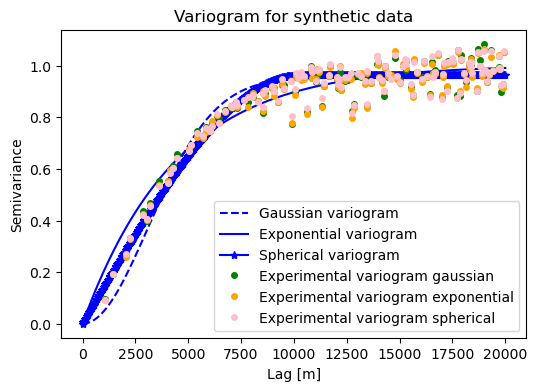

In [15]:
df_bed = df.copy()
df_bed = df_bed[df_bed["residual"].isnull() == False]
data = df_bed['residual'].values.reshape(-1,1)
coords = df_bed[['X','Y']].values
roughness_region_mask = (df_bed['bedmachine_mask'].values)==2

loaded_bed_temp = np.loadtxt("./59_crf/bed_cache_59_crf_42forsample.txt")
loaded_bed_temp = loaded_bed_temp.reshape(np.round(loaded_bed_temp.size/(rows*cols)).astype(int), rows, cols)
data_for_trans = (loaded_bed_temp[0,:,:] - trend).reshape(-1,1)

nst_trans, Nbed_detrend, varios, fig = geomc.fit_variogram(data, coords, roughness_region_mask, 
                                                           maxlag=20000, n_lags=500, samples=0.9,
                                                          data_for_trans=data_for_trans)

In [19]:
last_beds_all.shape

(4, 10, 200, 300)

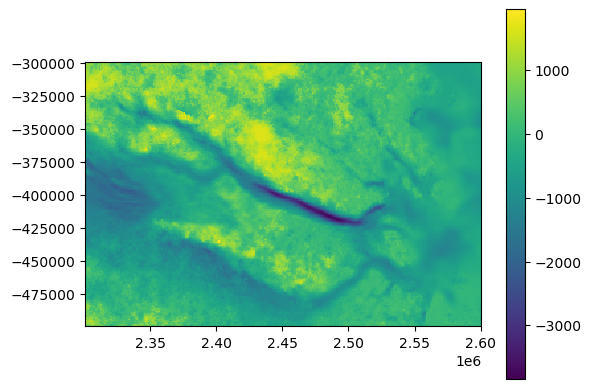

In [27]:
plt.pcolormesh(xx,yy,last_beds_all[3,0,:,:])
plt.axis('scaled')
plt.colorbar()

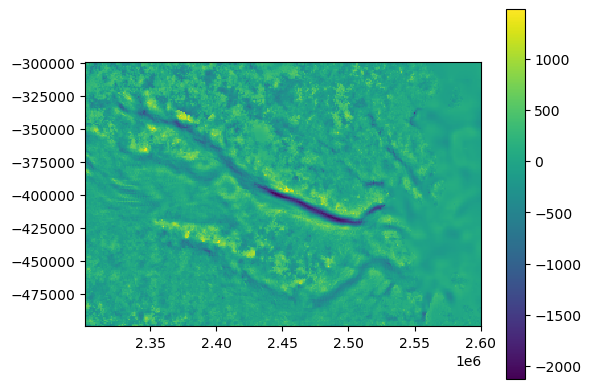

In [23]:
plt.pcolormesh(xx,yy,last_beds_all[3,0,:,:] - trend)
plt.axis('scaled')
plt.colorbar()

In [28]:
topo_mean = np.mean(trend)
topo_std = np.std(trend)

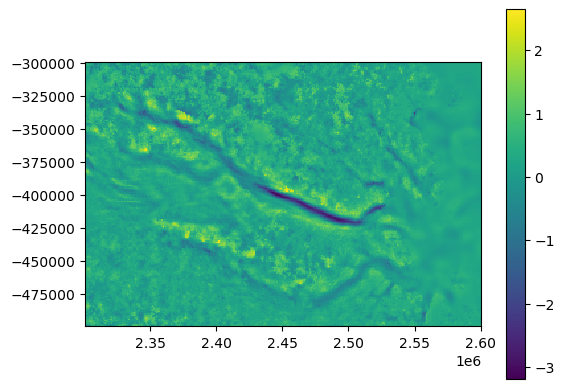

In [30]:
plt.pcolormesh(xx,yy,(last_beds_all[3,0,:,:] - trend - topo_mean) / topo_std)
plt.axis('scaled')
plt.colorbar()

In [24]:
simulated_rf = nst_trans.transform((last_beds_all[3,0,:,:] - trend).reshape(-1,1))

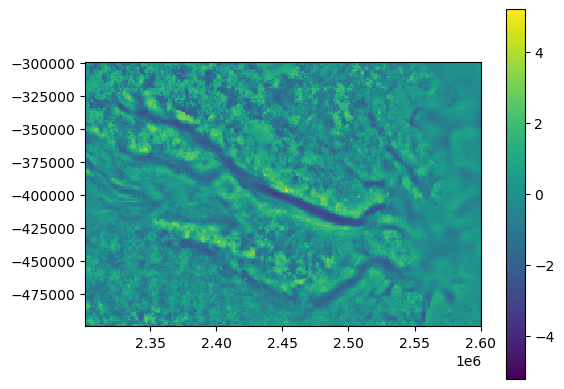

In [25]:
plt.pcolormesh(xx,yy,simulated_rf.reshape(rows,cols))
plt.axis('scaled')
plt.colorbar()

In [33]:
last_beds_all_untransformed = np.zeros(last_beds_all.shape)
for i in range(last_beds_all.shape[0]):
    for j in range(last_beds_all.shape[1]):
        tb = nst_trans.transform((last_beds_all[i,j,:,:]- trend).reshape(-1,1))
        last_beds_all_untransformed[i,j,:,:] = tb.reshape((rows,cols))

In [37]:
fil = [[-1,-1,-1],
       [-1, 8,-1],
       [-1,-1,-1]]
mc_region_mask_edge = sp.ndimage.convolve(mc_region_mask, fil, mode='constant') > 0
mc_region_mask_edge = np.where(mc_region_mask_edge,1,np.nan)

In [38]:
cmap = plt.get_cmap('magma')
new_cmap = matplotlib.colors.LinearSegmentedColormap.from_list('magma',cmap(np.linspace(0.3, 1, 256)))

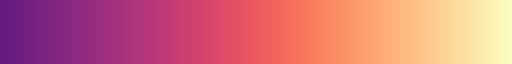

In [39]:
new_cmap

In [40]:
N = 128
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(1/256, 1, N)
vals1[:, 1] = np.linspace(133/256, 1, N)
vals1[:, 2] = np.linspace(113/256, 1, N)

vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(1,166/256, N)
vals2[:, 1] = np.linspace(1,97/256, N)
vals2[:, 2] = np.linspace(1,26/256, N)

cmp_gnbr = ListedColormap(np.vstack([vals1,vals2]))

In [41]:
SMALL_SIZE = 9
MEDIUM_SIZE = 10

In [42]:
list_start_x = [2430000, 2340000, 2510000, 2301000, 2430000]
list_start_y = [-395000, -325000, -415000, -405000, -408000]
list_end_x = [2510000, 2430000, 2530000, 2350000, 2510000]
list_end_y = [-425000, -387000, -402000, -410000, -432000]

In [47]:
def plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all, surf, bm_bed, cond_data, mc_region_mask_edge, label=False):
    
    SMALL_SIZE = 9
    MEDIUM_SIZE = 10
    
    distance = np.sqrt((end_loc[1]-start_loc[1])**2 + (end_loc[0]-start_loc[0])**2)
    num_pt = int(distance/1000)*2
    profile_coords = vd.profile_coordinates(start_loc, end_loc, num_pt, extra_coords=None)

    coords = np.array([xx.flatten(),yy.flatten()]).T
    pred_coords = np.array([profile_coords[0][0],profile_coords[0][1]]).T
    
    last_beds = last_beds_all.reshape((last_beds_all.shape[0]*last_beds_all.shape[1],last_beds_all.shape[2],last_beds_all.shape[3]))
    
    bed_profile_list = []
    for i in range(last_beds.shape[0]):
        bed_profile = sp.interpolate.griddata(coords, last_beds[i,:,:].flatten(), pred_coords)
        bed_profile_list.append(bed_profile)
    surf_profile = sp.interpolate.griddata(coords, surf.flatten(), pred_coords)
    bm_profile = sp.interpolate.griddata(coords, bm_bed.flatten(), pred_coords)
    
    #cond_data = df.bed.values.reshape(xx.shape)
    cond_data_mask = ~np.isnan(cond_data)

    profile_coords_x = profile_coords[0][0]
    profile_coords_y = profile_coords[0][1]
    radar_data_loc_x = []
    radar_data_loc_y = []
    radar_vals = []
    radar_dist_along_profile = []

    for i in range(profile_coords[0][0].shape[0]):
        x = profile_coords_x[i]
        y = profile_coords_y[i]
        x = np.round(x/1000)*1000
        y = np.round(y/1000)*1000

        x_index = np.where(xx == x)[1][0]
        y_index = np.where(yy == y)[0][0]
        if cond_data_mask[y_index,x_index]:
            radar_data_loc_x.append(x)
            radar_data_loc_y.append(y)
            radar_vals.append(cond_data[y_index,x_index])
            radar_dist_along_profile.append(profile_coords[1][i])

    unique_index = np.unique(radar_vals, axis=0, return_index=True)[1]
    radar_vals = np.array(radar_vals)[unique_index]
    radar_dist_along_profile = np.array(radar_dist_along_profile)[unique_index]
    radar_data_loc_x = np.array(radar_data_loc_x)[unique_index]
    radar_data_loc_y = np.array(radar_data_loc_y)[unique_index]
    
    mm = 1/25.4

    fig = plt.figure(figsize=(180*mm, 55*mm))
    gs = fig.add_gridspec(1,2,width_ratios=[2,1])
    ax1 = fig.add_subplot(gs[0, 0],anchor='N')
    ax2 = fig.add_subplot(gs[0, 1],anchor='N')

    #f_mean = ax2.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all[:,:,:,:],axis=(0,1)),cmap='gist_earth',vmax=2000,vmin=-2500)
    ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')
    ax2.plot((start_loc[0]/1000, end_loc[0]/1000), (start_loc[1]/1000,end_loc[1]/1000), c='white')
    #ax2.scatter(radar_data_loc_x/1000, radar_data_loc_y/1000, s=5,c='r',zorder=3)
    #ax2.set_title('ensemble mean',fontsize=MEDIUM_SIZE)
    ax2.set_xticks([2400,2500,2600])
    ax2.set_xticklabels([])
    ax2.set_yticks([-300,-350,-400,-450])
    ax2.set_yticklabels([])
    #ax2.tick_params(axis='both', labelsize=SMALL_SIZE)
    ax2.axis('scaled')
        
    #crosssection_mean = np.mean(np.array(bed_profile_list),axis=0)
    #ax1.fill_between(profile_coords[1]/1000, crosssection_mean, np.min(np.array(bed_profile_list)), color='burlywood', zorder=1)
    #ax1.fill_between(profile_coords[1]/1000, surf_profile, crosssection_mean, color='lightblue')

    mcmc_bed_colorlist = ['red','blue','cyan','magenta']
    for i in range(last_beds_all.shape[0]):
        color = mcmc_bed_colorlist[i]
        for j in range(last_beds_all.shape[1]):
            ax1.plot(profile_coords[1]/1000,bed_profile_list[i*last_beds_all.shape[1]+j],alpha=0.5,lw=0.15,color='black',zorder=2)
            
    ax1.plot(profile_coords[1]/1000,bed_profile_list[0],alpha=0.5,color='black',zorder=2,lw=0.15,label='MCMC-generated ensemble')
    #ax1.plot(profile_coords[1]/1000,surf_profile,color='orange',label='surface',lw=2)
    #ax1.plot(profile_coords[1]/1000,bm_profile,color='green',label='BedMachine',lw=2)
    #ax1.scatter(radar_dist_along_profile/1000, radar_vals,s=20,marker='o',facecolors='r', edgecolors='r',zorder=2,label='radar measurements')
    ax1.set_ylabel('Bed elevation (m)',fontsize=SMALL_SIZE)
    ax1.set_xlabel('Distance along profile (km)',fontsize=SMALL_SIZE)
    ax1.tick_params(axis='both', labelsize=SMALL_SIZE)
    #ax1.set_title('cross section',fontsize=MEDIUM_SIZE)
    
    #make label
    #if label:
    #    ax1.legend(fontsize=MEDIUM_SIZE,bbox_to_anchor=(0.05,0.98),loc='upper left',framealpha=0.7)
    
    plt.tight_layout(pad=0.05,h_pad=0, w_pad=0.4)

    return profile_coords, [bed_profile_list, surf_profile, bm_profile], [radar_dist_along_profile, radar_vals, radar_data_loc_x, radar_data_loc_y], fig

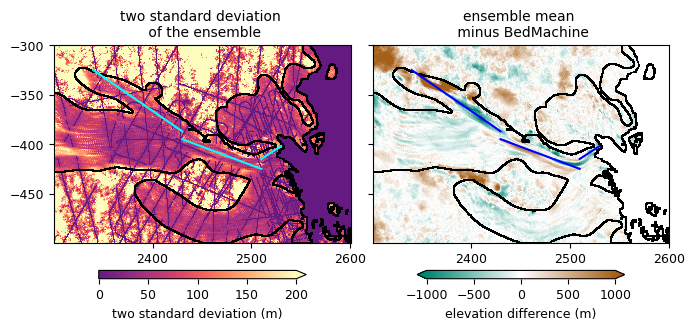

In [57]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 85*mm))

gs = fig.add_gridspec(1,2,width_ratios=[1,1])
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])

#############################ax1###################################

f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all_untransformed[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=200)
cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='max')
cbar1.set_label(label='two standard deviation (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE) 
ax1.set_title('two standard deviation \n of the ensemble',fontsize=MEDIUM_SIZE)
ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax1.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='aqua', lw=1.5)

ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.set_xticks([2400,2500,2600])
ax1.set_yticks([-300,-350,-400,-450])
ax1.axis('scaled')

#############################ax2###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_diff = ax2.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all_untransformed[:,:,:,:],axis=(0,1)) - bm_bed,cmap=cmp_gnbr,vmax=1000,vmin=-1000)
cbar2 = plt.colorbar(f_diff, ax = ax2,aspect=25,orientation='horizontal',location='bottom', pad=0.06,shrink=0.7,extend='both')
cbar2.set_label(label='elevation difference (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
ax2.set_title('ensemble mean \n minus BedMachine',fontsize=MEDIUM_SIZE)
ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax2.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='blue', lw=1.5)

ax2.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.set_xticks([2400,2500,2600])
ax2.set_yticks([-300,-350,-400,-450])
ax2.set_yticklabels([])
ax2.axis('scaled')

plt.tight_layout(w_pad=0.1,h_pad=0.5)
plt.savefig('crosssection_sum.png',bbox_inches='tight',dpi=300)

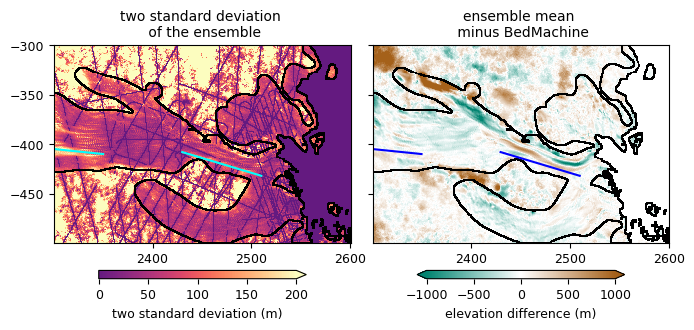

In [56]:
#############################layout###################################

#Plot data
#fig, axs = plt.subplots(2,1,figsize=(16,9), gridspec_kw={'height_ratios': [1, 2]})
mm = 1/25.4
fig = plt.figure(figsize=(179*mm, 85*mm))

gs = fig.add_gridspec(1,2,width_ratios=[1,1])
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])

#############################ax1###################################

f_std = ax1.pcolormesh(xx/1000, yy/1000, np.std(last_beds_all_untransformed[:,:,:,:],axis=(0,1)),cmap=new_cmap,vmax=200)
cbar1 = plt.colorbar(f_std,ax=ax1,aspect=25,orientation='horizontal',location='bottom',pad=0.06,shrink=0.7,extend='max')
cbar1.set_label(label='two standard deviation (m)',size=SMALL_SIZE)
cbar1.ax.tick_params(axis='both',labelsize=SMALL_SIZE) 
ax1.set_title('two standard deviation \n of the ensemble',fontsize=MEDIUM_SIZE)
ax1.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3,5,1):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax1.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='aqua', lw=1.5)

ax1.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax1.set_xticks([2400,2500,2600])
ax1.set_yticks([-300,-350,-400,-450])
ax1.axis('scaled')

#############################ax2###################################

bm_bed = df_bm.bed.values.reshape(xx.shape)
f_diff = ax2.pcolormesh(xx/1000, yy/1000, np.mean(last_beds_all_untransformed[:,:,:,:],axis=(0,1)) - bm_bed,cmap=cmp_gnbr,vmax=1000,vmin=-1000)
cbar2 = plt.colorbar(f_diff, ax = ax2,aspect=25,orientation='horizontal',location='bottom', pad=0.06,shrink=0.7,extend='both')
cbar2.set_label(label='elevation difference (m)',size=SMALL_SIZE)
cbar2.ax.tick_params(axis='both',labelsize=SMALL_SIZE)
ax2.set_title('ensemble mean \n minus BedMachine',fontsize=MEDIUM_SIZE)
ax2.pcolormesh(xx/1000,yy/1000,mc_region_mask_edge,cmap='grey')

for i in range(3,5,1):
    sx = list_start_x[i]
    sy = list_start_y[i]
    ex = list_end_x[i]
    ey = list_end_y[i]
    
    ax2.plot((sx/1000, ex/1000), (sy/1000,ey/1000), c='blue', lw=1.5)

ax2.xaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.yaxis.set_tick_params(labelsize=SMALL_SIZE)
ax2.set_xticks([2400,2500,2600])
ax2.set_yticks([-300,-350,-400,-450])
ax2.set_yticklabels([])
ax2.axis('scaled')

plt.tight_layout(w_pad=0.1,h_pad=0.5)
plt.savefig('crosssection_sum.png',bbox_inches='tight',dpi=300)

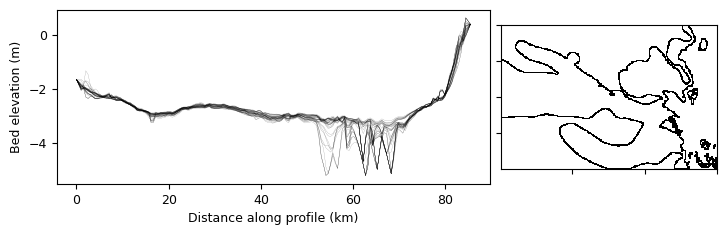

In [48]:
start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all_untransformed, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge,label=True)
fig.savefig('crosssection1.png',dpi=300,bbox_inches='tight')

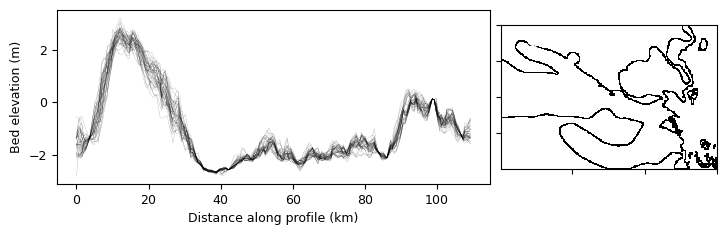

In [49]:
start_loc = (2340000,-325000)
end_loc = (2430000,-387000)
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all_untransformed, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection2.png',dpi=300,bbox_inches='tight')

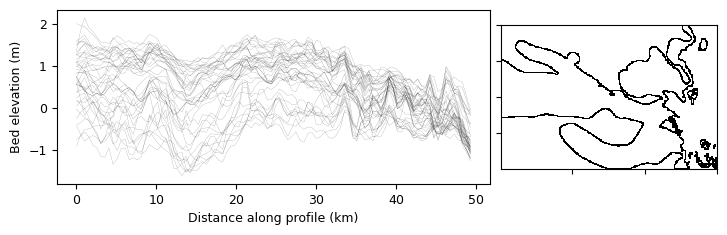

In [50]:
start_loc = [2301000,-405000]
end_loc = [2350000,-410000]
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all_untransformed, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge, label=True)
fig.savefig('crosssection3.png',dpi=300,bbox_inches='tight')

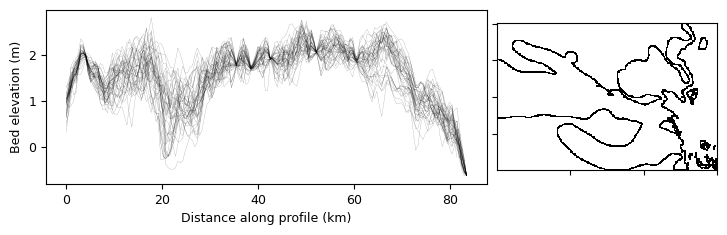

In [51]:
start_loc = [2430000,-408000]
end_loc = [2510000,-432000]
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all_untransformed, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection4.png',dpi=300,bbox_inches='tight')

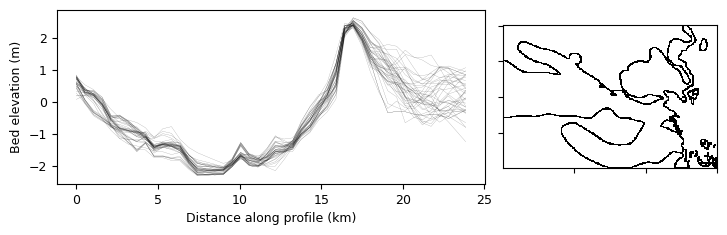

In [52]:
start_loc = [2510000,-415000]
end_loc = [2530000,-402000]
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all_untransformed, 
            surf, df_bm.bed.values.reshape(xx.shape), df.bed.values.reshape(xx.shape), mc_region_mask_edge)
fig.savefig('crosssection5.png',dpi=300,bbox_inches='tight')

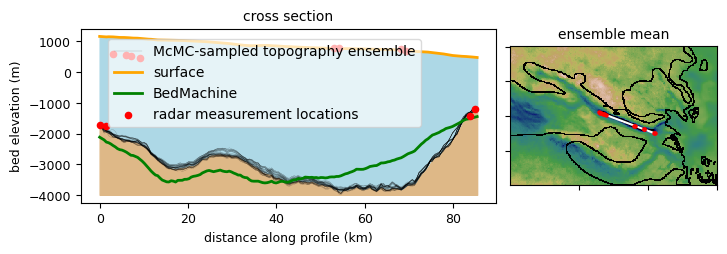

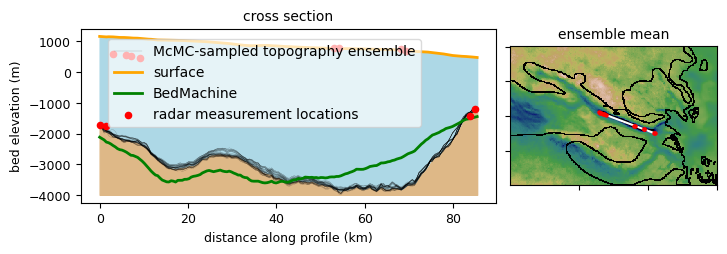

In [140]:
start_loc = (2430000,-395000)
end_loc = (2510000,-425000)
profile_coords, profile_list, radar_list, fig = plot_crosssection_2(start_loc, end_loc, xx, yy, last_beds_all_untransformed, 
            surf, df_bm.bed.values.reshape(xx.shape), df_up.bed.values.reshape(xx.shape), mc_region_mask_edge,label=True)